In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperatures
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperatures
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperatures
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['solar_activity'], axis=1)

n_vars = df_trimmed.shape[1]-1

X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df) 
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-20 23:58:29,516] A new study created in memory with name: no-name-edc4dbe3-ce3a-4939-8eb1-74d52f719b6c
[I 2025-05-21 00:06:38,075] Trial 0 finished with value: 0.05546450093388557 and parameters: {'lr': 0.5518789984363179, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.11258131714297814}. Best is trial 0 with value: 0.05546450093388557.


Cross Validation Accuracies:
[0.04179703816771507, 0.05275905504822731, 0.05931121110916138, 0.0717114806175232, 0.05174371972680092]
Mean Cross Validation Accuracy:
0.05546450093388557
Standard Deviation of Cross Validation Accuracy:
0.009866354105838495


[I 2025-05-21 00:15:27,921] Trial 1 finished with value: 0.06295196637511254 and parameters: {'lr': 0.004413720236141473, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.22667916044585434}. Best is trial 0 with value: 0.05546450093388557.


Cross Validation Accuracies:
[0.05628979578614235, 0.05209871754050255, 0.06267836689949036, 0.08403293788433075, 0.059660013765096664]
Mean Cross Validation Accuracy:
0.06295196637511254
Standard Deviation of Cross Validation Accuracy:
0.011113025651501246


[I 2025-05-21 00:23:15,393] Trial 2 finished with value: 0.05153346359729767 and parameters: {'lr': 0.07384448092839656, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.26127642493496606}. Best is trial 2 with value: 0.05153346359729767.


Cross Validation Accuracies:
[0.04252738505601883, 0.0457686185836792, 0.056778017431497574, 0.06364627182483673, 0.04894702509045601]
Mean Cross Validation Accuracy:
0.05153346359729767
Standard Deviation of Cross Validation Accuracy:
0.007684504160313237


[I 2025-05-21 00:34:57,602] Trial 3 finished with value: 0.06821324303746223 and parameters: {'lr': 0.005876902938400359, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.13914866740955026}. Best is trial 2 with value: 0.05153346359729767.


Cross Validation Accuracies:
[0.06460151821374893, 0.05490526184439659, 0.06281474232673645, 0.08054409921169281, 0.07820059359073639]
Mean Cross Validation Accuracy:
0.06821324303746223
Standard Deviation of Cross Validation Accuracy:
0.009706574211579165


[I 2025-05-21 00:42:02,480] Trial 4 finished with value: 0.05617077946662903 and parameters: {'lr': 0.0012875612057850882, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.4763374469393947}. Best is trial 2 with value: 0.05153346359729767.


Cross Validation Accuracies:
[0.04903716966509819, 0.05057113990187645, 0.060583457350730896, 0.06311052292585373, 0.057551607489585876]
Mean Cross Validation Accuracy:
0.05617077946662903
Standard Deviation of Cross Validation Accuracy:
0.005509678819555928


[I 2025-05-21 00:49:10,222] Trial 5 finished with value: 0.3279962301254272 and parameters: {'lr': 0.01595807887257437, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.35667845752308847}. Best is trial 2 with value: 0.05153346359729767.


Cross Validation Accuracies:
[0.33614832162857056, 0.29754015803337097, 0.3370852470397949, 0.3502837121486664, 0.3189237117767334]
Mean Cross Validation Accuracy:
0.3279962301254272
Standard Deviation of Cross Validation Accuracy:
0.018197151402048653


[I 2025-05-21 00:58:04,279] Trial 6 finished with value: 0.6672236561775208 and parameters: {'lr': 0.4176400357250939, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13681808969616407}. Best is trial 2 with value: 0.05153346359729767.


Cross Validation Accuracies:
[0.48834866285324097, 0.5513358116149902, 0.5928149223327637, 0.9039112329483032, 0.7997076511383057]
Mean Cross Validation Accuracy:
0.6672236561775208
Standard Deviation of Cross Validation Accuracy:
0.1578201085697793


[I 2025-05-21 01:08:41,683] Trial 7 finished with value: 0.050855860114097595 and parameters: {'lr': 0.030352053102970206, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.36776069420791446}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.04338105767965317, 0.043859295547008514, 0.05687088146805763, 0.06233687698841095, 0.04783118888735771]
Mean Cross Validation Accuracy:
0.050855860114097595
Standard Deviation of Cross Validation Accuracy:
0.007509559954646532


[I 2025-05-21 01:15:27,891] Trial 8 finished with value: 0.07601092159748077 and parameters: {'lr': 0.11248297275463415, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.44210273417241186}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.0645236000418663, 0.08350156992673874, 0.06902534514665604, 0.08802815526723862, 0.07497593760490417]
Mean Cross Validation Accuracy:
0.07601092159748077
Standard Deviation of Cross Validation Accuracy:
0.008744732634031398


[I 2025-05-21 01:21:19,903] Trial 9 finished with value: 0.3221215844154358 and parameters: {'lr': 0.017064681723606676, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.46403044948305383}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.277052104473114, 0.32566651701927185, 0.33738580346107483, 0.31574156880378723, 0.35476192831993103]
Mean Cross Validation Accuracy:
0.3221215844154358
Standard Deviation of Cross Validation Accuracy:
0.02601121912528874


[I 2025-05-21 01:31:41,736] Trial 10 finished with value: 0.46244009733200075 and parameters: {'lr': 0.08786782211969547, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.3533077073445875}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.43609288334846497, 0.5326026678085327, 0.4559714198112488, 0.3928699791431427, 0.4946635365486145]
Mean Cross Validation Accuracy:
0.46244009733200075
Standard Deviation of Cross Validation Accuracy:
0.04803573076199528


[I 2025-05-21 01:40:38,524] Trial 11 finished with value: 0.05234026089310646 and parameters: {'lr': 0.07028175594742758, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.2659786910690122}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.04348636791110039, 0.04590046405792236, 0.060470517724752426, 0.06215545907616615, 0.04968849569559097]
Mean Cross Validation Accuracy:
0.05234026089310646
Standard Deviation of Cross Validation Accuracy:
0.0076070158984884746


[I 2025-05-21 01:49:42,273] Trial 12 finished with value: 0.05239376202225685 and parameters: {'lr': 0.03794947763357871, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.34782046406487155}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.043493401259183884, 0.04706139862537384, 0.05774190276861191, 0.06375133246183395, 0.04992077499628067]
Mean Cross Validation Accuracy:
0.05239376202225685
Standard Deviation of Cross Validation Accuracy:
0.007366996697063083


[I 2025-05-21 01:55:57,703] Trial 13 finished with value: 0.05094001740217209 and parameters: {'lr': 0.27922163325808397, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.20910043225221703}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.04208924621343613, 0.04473491758108139, 0.05632966384291649, 0.062259916216135025, 0.04928634315729141]
Mean Cross Validation Accuracy:
0.05094001740217209
Standard Deviation of Cross Validation Accuracy:
0.007439925414247489


[I 2025-05-21 02:04:20,148] Trial 14 finished with value: 0.05359750464558601 and parameters: {'lr': 0.24406189010612328, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.22233787004808542}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.044731657952070236, 0.049071405082941055, 0.057139802724123, 0.06553646922111511, 0.051508188247680664]
Mean Cross Validation Accuracy:
0.05359750464558601
Standard Deviation of Cross Validation Accuracy:
0.007190838736439599


[I 2025-05-21 02:13:29,402] Trial 15 finished with value: 0.05649444833397865 and parameters: {'lr': 0.8671648768472249, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.418732069314958}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.051982581615448, 0.054199349135160446, 0.05851932615041733, 0.06696897745132446, 0.05080200731754303]
Mean Cross Validation Accuracy:
0.05649444833397865
Standard Deviation of Cross Validation Accuracy:
0.005862494294162338


[I 2025-05-21 02:23:35,826] Trial 16 finished with value: 0.054681087285280226 and parameters: {'lr': 0.2458898961016869, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.18804537334296048}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.046008285135030746, 0.04916977509856224, 0.06270837038755417, 0.06681087613105774, 0.04870812967419624]
Mean Cross Validation Accuracy:
0.054681087285280226
Standard Deviation of Cross Validation Accuracy:
0.008400444431431538


[I 2025-05-21 02:33:14,024] Trial 17 finished with value: 0.05265631452202797 and parameters: {'lr': 0.029424127048802262, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.31026651902920893}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.04713711515069008, 0.04593338072299957, 0.057296767830848694, 0.06300303339958191, 0.04991127550601959]
Mean Cross Validation Accuracy:
0.05265631452202797
Standard Deviation of Cross Validation Accuracy:
0.006508195421291212


[I 2025-05-21 02:41:12,974] Trial 18 finished with value: 0.05115128457546234 and parameters: {'lr': 0.007833397468318942, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.401775486849688}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.042820584028959274, 0.04508340731263161, 0.05653437599539757, 0.06260842084884644, 0.04870963469147682]
Mean Cross Validation Accuracy:
0.05115128457546234
Standard Deviation of Cross Validation Accuracy:
0.007381395600433905


[I 2025-05-21 02:47:09,023] Trial 19 finished with value: 13.685708236694335 and parameters: {'lr': 0.16365389290958912, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.29575252518211675}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[12.846256256103516, 16.82706642150879, 10.07559585571289, 12.26413345336914, 16.415489196777344]
Mean Cross Validation Accuracy:
13.685708236694335
Standard Deviation of Cross Validation Accuracy:
2.572092581185674


[I 2025-05-21 02:53:57,688] Trial 20 finished with value: 0.5036359369754791 and parameters: {'lr': 0.0015107720253403675, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.18465335631124052}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.5028360486030579, 0.5075955986976624, 0.507061243057251, 0.4913659989833832, 0.5093207955360413]
Mean Cross Validation Accuracy:
0.5036359369754791
Standard Deviation of Cross Validation Accuracy:
0.006494928164341113


[I 2025-05-21 03:01:10,103] Trial 21 finished with value: 0.05113359987735748 and parameters: {'lr': 0.006862856409169233, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3992992937840002}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.042784418910741806, 0.04544306546449661, 0.056254222989082336, 0.0626053586602211, 0.04858093336224556]
Mean Cross Validation Accuracy:
0.05113359987735748
Standard Deviation of Cross Validation Accuracy:
0.007299714263985463


[I 2025-05-21 03:08:15,799] Trial 22 finished with value: 0.2171670287847519 and parameters: {'lr': 0.0028204953364634722, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.38936010479432986}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.21957620978355408, 0.23192334175109863, 0.27722182869911194, 0.21083340048789978, 0.14628036320209503]
Mean Cross Validation Accuracy:
0.2171670287847519
Standard Deviation of Cross Validation Accuracy:
0.042178587276080495


[I 2025-05-21 03:14:52,929] Trial 23 finished with value: 0.05105367377400398 and parameters: {'lr': 0.011737381034553965, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3116622002871407}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.04275411367416382, 0.04487450420856476, 0.05621074512600899, 0.06266443431377411, 0.04876457154750824]
Mean Cross Validation Accuracy:
0.05105367377400398
Standard Deviation of Cross Validation Accuracy:
0.007398783259620609


[I 2025-05-21 03:23:30,678] Trial 24 finished with value: 0.050433243811130526 and parameters: {'lr': 0.03737837945167207, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3191410752056673}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04197392612695694, 0.04376792162656784, 0.05629090964794159, 0.0628327801823616, 0.047300681471824646]
Mean Cross Validation Accuracy:
0.050433243811130526
Standard Deviation of Cross Validation Accuracy:
0.007922881718070247


[I 2025-05-21 03:30:01,667] Trial 25 finished with value: 0.05603054165840149 and parameters: {'lr': 0.03456152873165979, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.2585780195685582}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.057018741965293884, 0.04416492581367493, 0.05694517120718956, 0.07101186364889145, 0.051012005656957626]
Mean Cross Validation Accuracy:
0.05603054165840149
Standard Deviation of Cross Validation Accuracy:
0.008856993153584469


[I 2025-05-21 03:36:16,375] Trial 26 finished with value: 0.05239826291799545 and parameters: {'lr': 0.04865309432939573, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.32791065581275564}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04497269168496132, 0.046052929013967514, 0.057531293481588364, 0.06368124485015869, 0.049753155559301376]
Mean Cross Validation Accuracy:
0.05239826291799545
Standard Deviation of Cross Validation Accuracy:
0.007156153261044499


[I 2025-05-21 03:42:45,367] Trial 27 finished with value: 0.2556251049041748 and parameters: {'lr': 0.020491677052135424, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.3735210971000368}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.2600573003292084, 0.30796539783477783, 0.19412164390087128, 0.27299365401268005, 0.2429875284433365]
Mean Cross Validation Accuracy:
0.2556251049041748
Standard Deviation of Cross Validation Accuracy:
0.03742512838366755


[I 2025-05-21 03:50:00,354] Trial 28 finished with value: 12.936040115356445 and parameters: {'lr': 0.14077946412068093, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.21445793558322876}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[12.998711585998535, 11.102079391479492, 13.013484954833984, 13.481223106384277, 14.084701538085938]
Mean Cross Validation Accuracy:
12.936040115356445
Standard Deviation of Cross Validation Accuracy:
0.9989979890760959


[I 2025-05-21 04:00:48,689] Trial 29 finished with value: 0.865675151348114 and parameters: {'lr': 0.4923659234953605, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.278884665993987}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[1.1777524948120117, 0.8111864328384399, 0.8576177954673767, 0.7318400740623474, 0.7499789595603943]
Mean Cross Validation Accuracy:
0.865675151348114
Standard Deviation of Cross Validation Accuracy:
0.16231059511835133


[I 2025-05-21 04:06:39,894] Trial 30 finished with value: 0.06011151224374771 and parameters: {'lr': 0.8913280459189977, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.10445092365265951}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.054114580154418945, 0.0564575232565403, 0.07269149273633957, 0.06462011486291885, 0.05267385020852089]
Mean Cross Validation Accuracy:
0.06011151224374771
Standard Deviation of Cross Validation Accuracy:
0.007526181678972374


[I 2025-05-21 04:12:23,182] Trial 31 finished with value: 0.051236022263765335 and parameters: {'lr': 0.011557343604094938, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.32051724296164474}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04292907193303108, 0.045117128640413284, 0.05657083913683891, 0.0627562403678894, 0.04880683124065399]
Mean Cross Validation Accuracy:
0.051236022263765335
Standard Deviation of Cross Validation Accuracy:
0.0073962551096317325


[I 2025-05-21 04:19:47,753] Trial 32 finished with value: 0.05097685009241104 and parameters: {'lr': 0.0095385003264528, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.28994253863647335}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04219742491841316, 0.04527978226542473, 0.05614681541919708, 0.06278140097856522, 0.04847882688045502]
Mean Cross Validation Accuracy:
0.05097685009241104
Standard Deviation of Cross Validation Accuracy:
0.007508008674509567


[I 2025-05-21 04:27:28,333] Trial 33 finished with value: 0.23777825832366944 and parameters: {'lr': 0.0030896959743057124, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.23803265787471073}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.28539595007896423, 0.23161959648132324, 0.20908251404762268, 0.22832046449184418, 0.23447276651859283]
Mean Cross Validation Accuracy:
0.23777825832366944
Standard Deviation of Cross Validation Accuracy:
0.025413364844450063


[I 2025-05-21 04:33:23,469] Trial 34 finished with value: 0.05170042961835861 and parameters: {'lr': 0.056255122667120135, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.19297290001644948}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.044717561453580856, 0.04581223800778389, 0.058837100863456726, 0.06171673908829689, 0.0474185086786747]
Mean Cross Validation Accuracy:
0.05170042961835861
Standard Deviation of Cross Validation Accuracy:
0.007113713896993585


[I 2025-05-21 04:40:54,243] Trial 35 finished with value: 0.09719895720481872 and parameters: {'lr': 0.026851508780970874, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.29553058573228763}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.10696279257535934, 0.10745514184236526, 0.09815008193254471, 0.09443674236536026, 0.07899002730846405]
Mean Cross Validation Accuracy:
0.09719895720481872
Standard Deviation of Cross Validation Accuracy:
0.010398282564922355


[I 2025-05-21 04:49:05,733] Trial 36 finished with value: 0.054420842230319975 and parameters: {'lr': 0.00422678405058702, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.33432759603977763}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.042580388486385345, 0.048417266458272934, 0.06158832460641861, 0.06859588623046875, 0.050922345370054245]
Mean Cross Validation Accuracy:
0.054420842230319975
Standard Deviation of Cross Validation Accuracy:
0.009389179125057667


[I 2025-05-21 04:56:25,551] Trial 37 finished with value: 0.338869971036911 and parameters: {'lr': 0.01339216626520026, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.13730024026272397}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.3290025293827057, 0.37988826632499695, 0.34728649258613586, 0.2618075907230377, 0.37636497616767883]
Mean Cross Validation Accuracy:
0.338869971036911
Standard Deviation of Cross Validation Accuracy:
0.04288400787595459


[I 2025-05-21 05:02:48,206] Trial 38 finished with value: 0.051319868117570874 and parameters: {'lr': 0.008402507930684108, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.1592156725806386}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04412821680307388, 0.04591507092118263, 0.05583491548895836, 0.06272458285093307, 0.047996554523706436]
Mean Cross Validation Accuracy:
0.051319868117570874
Standard Deviation of Cross Validation Accuracy:
0.006963178376600711


[I 2025-05-21 05:09:44,972] Trial 39 finished with value: 4.464042472839355 and parameters: {'lr': 0.3561587967331019, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.24102577035518802}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[3.8061842918395996, 3.7161710262298584, 7.22193717956543, 3.0477259159088135, 4.528193950653076]
Mean Cross Validation Accuracy:
4.464042472839355
Standard Deviation of Cross Validation Accuracy:
1.4565809487900805


[I 2025-05-21 05:17:52,059] Trial 40 finished with value: 0.2193756192922592 and parameters: {'lr': 0.018530258819673306, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.376845674125124}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.15742753446102142, 0.22182832658290863, 0.2610197067260742, 0.2949206531047821, 0.1616818755865097]
Mean Cross Validation Accuracy:
0.2193756192922592
Standard Deviation of Cross Validation Accuracy:
0.05406187418509833


[I 2025-05-21 05:24:45,890] Trial 41 finished with value: 0.051099643856287 and parameters: {'lr': 0.010701493236760323, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2832441001653555}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04258056357502937, 0.04533354565501213, 0.056613001972436905, 0.06231224909424782, 0.048658858984708786]
Mean Cross Validation Accuracy:
0.051099643856287
Standard Deviation of Cross Validation Accuracy:
0.007319831719839538


[I 2025-05-21 05:31:44,977] Trial 42 finished with value: 0.05092206969857216 and parameters: {'lr': 0.022090198510389212, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3630621300172976}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.042396385222673416, 0.0451434887945652, 0.055324241518974304, 0.06285689771175385, 0.04888933524489403]
Mean Cross Validation Accuracy:
0.05092206969857216
Standard Deviation of Cross Validation Accuracy:
0.007376049604584745


[I 2025-05-21 05:39:55,886] Trial 43 finished with value: 0.05108741894364357 and parameters: {'lr': 0.04698871241939184, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.4224695598594986}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.041999250650405884, 0.045658741146326065, 0.05774053558707237, 0.06098966300487518, 0.049048904329538345]
Mean Cross Validation Accuracy:
0.05108741894364357
Standard Deviation of Cross Validation Accuracy:
0.007190817559978635


[I 2025-05-21 05:46:56,756] Trial 44 finished with value: 0.053218836337327956 and parameters: {'lr': 0.09215277613390052, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3663843927868293}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.0400368757545948, 0.051879800856113434, 0.05823000892996788, 0.0642792209982872, 0.05166827514767647]
Mean Cross Validation Accuracy:
0.053218836337327956
Standard Deviation of Cross Validation Accuracy:
0.008067283315083752


[I 2025-05-21 05:53:21,467] Trial 45 finished with value: 0.05201904475688934 and parameters: {'lr': 0.02297008874253552, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3410585929484522}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.045044202357530594, 0.046952053904533386, 0.056252703070640564, 0.061662718653678894, 0.05018354579806328]
Mean Cross Validation Accuracy:
0.05201904475688934
Standard Deviation of Cross Validation Accuracy:
0.006141924587078842


[I 2025-05-21 05:59:35,390] Trial 46 finished with value: 0.05249976813793182 and parameters: {'lr': 0.06493513378267732, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.4964974580825686}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04537615552544594, 0.04741161689162254, 0.05724387988448143, 0.06288251280784607, 0.04958467558026314]
Mean Cross Validation Accuracy:
0.05249976813793182
Standard Deviation of Cross Validation Accuracy:
0.0065641585526592


[I 2025-05-21 06:07:50,610] Trial 47 finished with value: 0.05112811103463173 and parameters: {'lr': 0.005455018434692666, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.3565985070287006}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04280805587768555, 0.04518680274486542, 0.05635102093219757, 0.062447622418403625, 0.048847053200006485]
Mean Cross Validation Accuracy:
0.05112811103463173
Standard Deviation of Cross Validation Accuracy:
0.0072819751801143995


[I 2025-05-21 06:15:29,356] Trial 48 finished with value: 0.05169562548398972 and parameters: {'lr': 0.03889566831059792, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.4214732739710132}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.042489007115364075, 0.046687159687280655, 0.057426486164331436, 0.06299926340579987, 0.048876211047172546]
Mean Cross Validation Accuracy:
0.05169562548398972
Standard Deviation of Cross Validation Accuracy:
0.007462045880235847


[I 2025-05-21 06:23:18,429] Trial 49 finished with value: 0.05285592973232269 and parameters: {'lr': 0.016981895241232864, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.4438108507062478}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04457526654005051, 0.048116330057382584, 0.05804203450679779, 0.06365872919559479, 0.049887288361787796]
Mean Cross Validation Accuracy:
0.05285592973232269
Standard Deviation of Cross Validation Accuracy:
0.006977709918660998


[I 2025-05-21 06:29:27,045] Trial 50 finished with value: 0.05340316072106362 and parameters: {'lr': 0.12057941880153704, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.2651169766334324}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04419638589024544, 0.04933646693825722, 0.061027754098176956, 0.0654960498213768, 0.04695914685726166]
Mean Cross Validation Accuracy:
0.05340316072106362
Standard Deviation of Cross Validation Accuracy:
0.008333071543484661


[I 2025-05-21 06:35:16,652] Trial 51 finished with value: 0.051240439713001254 and parameters: {'lr': 0.01004549203238462, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3067555338060908}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.042615655809640884, 0.04553423821926117, 0.05661793798208237, 0.06259912252426147, 0.04883524402976036]
Mean Cross Validation Accuracy:
0.051240439713001254
Standard Deviation of Cross Validation Accuracy:
0.007357577889255337


[I 2025-05-21 06:41:22,748] Trial 52 finished with value: 0.05096243694424629 and parameters: {'lr': 0.027573042364715406, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3162312744312893}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04214823246002197, 0.044599439948797226, 0.05706311762332916, 0.062480974942445755, 0.048520419746637344]
Mean Cross Validation Accuracy:
0.05096243694424629
Standard Deviation of Cross Validation Accuracy:
0.00766859050688367


[I 2025-05-21 06:49:19,258] Trial 53 finished with value: 0.051341093331575396 and parameters: {'lr': 0.02477359031305221, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3441932424074565}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.043414413928985596, 0.04564081132411957, 0.05623679980635643, 0.062824547290802, 0.04858889430761337]
Mean Cross Validation Accuracy:
0.051341093331575396
Standard Deviation of Cross Validation Accuracy:
0.0071935765444506635


[I 2025-05-21 06:58:06,232] Trial 54 finished with value: 0.05121971145272255 and parameters: {'lr': 0.015379729779705772, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2833257703259192}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04249849170446396, 0.04576468840241432, 0.05624258518218994, 0.0627611055970192, 0.04883168637752533]
Mean Cross Validation Accuracy:
0.05121971145272255
Standard Deviation of Cross Validation Accuracy:
0.007347824894929914


[I 2025-05-21 07:05:59,660] Trial 55 finished with value: 0.05128016993403435 and parameters: {'lr': 0.0307492805784045, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.3845306509682807}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.042034585028886795, 0.04528464004397392, 0.05743503198027611, 0.06247277557849884, 0.04917381703853607]
Mean Cross Validation Accuracy:
0.05128016993403435
Standard Deviation of Cross Validation Accuracy:
0.00760290325260081


[I 2025-05-21 07:12:29,916] Trial 56 finished with value: 2.644948196411133 and parameters: {'lr': 0.25937971792586495, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.32138688319762154}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[3.320505380630493, 2.7698447704315186, 2.167811632156372, 1.799710750579834, 3.1668684482574463]
Mean Cross Validation Accuracy:
2.644948196411133
Standard Deviation of Cross Validation Accuracy:
0.5807689821992899


[I 2025-05-21 07:18:22,548] Trial 57 finished with value: 0.052229438722133634 and parameters: {'lr': 0.0444508808801289, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.35704570013287423}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.0442282110452652, 0.04556960240006447, 0.057934001088142395, 0.06356009095907211, 0.04985528811812401]
Mean Cross Validation Accuracy:
0.052229438722133634
Standard Deviation of Cross Validation Accuracy:
0.007415326926932877


[I 2025-05-21 07:24:44,346] Trial 58 finished with value: 0.05296849980950356 and parameters: {'lr': 0.661852450644778, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.20444262170493663}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.0413963608443737, 0.048999249935150146, 0.060257479548454285, 0.06086944043636322, 0.05331996828317642]
Mean Cross Validation Accuracy:
0.05296849980950356
Standard Deviation of Cross Validation Accuracy:
0.007284874237834349


[I 2025-05-21 07:33:22,229] Trial 59 finished with value: 0.03162175677716732 and parameters: {'lr': 0.0010081360098625786, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.16166304459917463}. Best is trial 59 with value: 0.03162175677716732.


Cross Validation Accuracies:
[0.025342129170894623, 0.028123361989855766, 0.036764610558748245, 0.0402519665658474, 0.02762671560049057]
Mean Cross Validation Accuracy:
0.03162175677716732
Standard Deviation of Cross Validation Accuracy:
0.005806243346261749


[I 2025-05-21 07:41:33,253] Trial 60 finished with value: 0.029260244965553284 and parameters: {'lr': 0.0014456919220217819, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12504411327251702}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.02325894683599472, 0.028573455289006233, 0.029662830755114555, 0.036719199270009995, 0.028086792677640915]
Mean Cross Validation Accuracy:
0.029260244965553284
Standard Deviation of Cross Validation Accuracy:
0.004328101759561377


[I 2025-05-21 07:51:22,444] Trial 61 finished with value: 0.031133480742573737 and parameters: {'lr': 0.001067798177206867, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1685431613078528}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.02414175122976303, 0.027311241254210472, 0.03181565925478935, 0.0400848425924778, 0.032313909381628036]
Mean Cross Validation Accuracy:
0.031133480742573737
Standard Deviation of Cross Validation Accuracy:
0.005394060706908254


[I 2025-05-21 08:01:59,222] Trial 62 finished with value: 0.031190507113933563 and parameters: {'lr': 0.0011588932623188201, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1540630669087759}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.0220344178378582, 0.032669104635715485, 0.033528830856084824, 0.04024628549814224, 0.027473896741867065]
Mean Cross Validation Accuracy:
0.031190507113933563
Standard Deviation of Cross Validation Accuracy:
0.006120593013550952


[I 2025-05-21 08:09:32,170] Trial 63 finished with value: 0.03168450929224491 and parameters: {'lr': 0.0010392242112079652, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12454500075815758}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.03000032715499401, 0.028964512050151825, 0.03053515963256359, 0.03895038366317749, 0.02997216396033764]
Mean Cross Validation Accuracy:
0.03168450929224491
Standard Deviation of Cross Validation Accuracy:
0.0036682670573042558


[I 2025-05-21 08:16:15,420] Trial 64 finished with value: 0.03201966919004917 and parameters: {'lr': 0.0011757500141731589, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.15575159996323068}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.02284727618098259, 0.03316603600978851, 0.03321830928325653, 0.04221706464886665, 0.02864965982735157]
Mean Cross Validation Accuracy:
0.03201966919004917
Standard Deviation of Cross Validation Accuracy:
0.006359678069201268


[I 2025-05-21 08:23:02,034] Trial 65 finished with value: 0.032786577567458154 and parameters: {'lr': 0.0010473926851456879, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12205117002033503}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.03113696724176407, 0.03241925686597824, 0.031324371695518494, 0.040431637316942215, 0.028620654717087746]
Mean Cross Validation Accuracy:
0.032786577567458154
Standard Deviation of Cross Validation Accuracy:
0.004019851651609215


[I 2025-05-21 08:29:41,133] Trial 66 finished with value: 0.03042711056768894 and parameters: {'lr': 0.0010797902469965972, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12243755397579002}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.02333221584558487, 0.03001600317656994, 0.02983683906495571, 0.03962460905313492, 0.029325885698199272]
Mean Cross Validation Accuracy:
0.03042711056768894
Standard Deviation of Cross Validation Accuracy:
0.005228032812725556


[I 2025-05-21 08:36:03,461] Trial 67 finished with value: 0.030605563521385194 and parameters: {'lr': 0.0017350090286919104, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.15909871709510826}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.0274607315659523, 0.02778857760131359, 0.030639730393886566, 0.03871239349246025, 0.028426384553313255]
Mean Cross Validation Accuracy:
0.030605563521385194
Standard Deviation of Cross Validation Accuracy:
0.004202286478377645


[I 2025-05-21 08:43:32,964] Trial 68 finished with value: 0.03140632249414921 and parameters: {'lr': 0.0018725374026875323, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.16512358729124063}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.028671858832240105, 0.028435228392481804, 0.03229883685708046, 0.039219025522470474, 0.028406662866473198]
Mean Cross Validation Accuracy:
0.03140632249414921
Standard Deviation of Cross Validation Accuracy:
0.004174627170369887


[I 2025-05-21 08:51:47,454] Trial 69 finished with value: 0.032672460004687306 and parameters: {'lr': 0.0016353779482484248, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.16770466024346486}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.024078290909528732, 0.025248972699046135, 0.035535864531993866, 0.04445652663707733, 0.03404264524579048]
Mean Cross Validation Accuracy:
0.032672460004687306
Standard Deviation of Cross Validation Accuracy:
0.007455315227295745


[I 2025-05-21 08:57:38,889] Trial 70 finished with value: 0.03461599498987198 and parameters: {'lr': 0.0019724583608950277, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.17448626207800527}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.026592759415507317, 0.035906288772821426, 0.0328991562128067, 0.04699406400322914, 0.030687706544995308]
Mean Cross Validation Accuracy:
0.03461599498987198
Standard Deviation of Cross Validation Accuracy:
0.0068939501756262785


[I 2025-05-21 09:02:50,807] Trial 71 finished with value: 0.030809585750102998 and parameters: {'lr': 0.002100296063102598, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.11370444825690766}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.022425634786486626, 0.028082815930247307, 0.031545668840408325, 0.04168954864144325, 0.030304260551929474]
Mean Cross Validation Accuracy:
0.030809585750102998
Standard Deviation of Cross Validation Accuracy:
0.006275295559565036


[I 2025-05-21 09:08:33,143] Trial 72 finished with value: 0.03466539904475212 and parameters: {'lr': 0.0020009976077075935, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.148139605207636}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.03469192236661911, 0.02977314032614231, 0.04342718422412872, 0.03846796602010727, 0.02696678228676319]
Mean Cross Validation Accuracy:
0.03466539904475212
Standard Deviation of Cross Validation Accuracy:
0.00590647092559355


[I 2025-05-21 09:15:19,619] Trial 73 finished with value: 0.030646011233329773 and parameters: {'lr': 0.0014124647642694197, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.10083681741207912}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.03232090547680855, 0.02502293698489666, 0.029525626450777054, 0.03916589170694351, 0.02719469554722309]
Mean Cross Validation Accuracy:
0.030646011233329773
Standard Deviation of Cross Validation Accuracy:
0.004902640921810129


[I 2025-05-21 09:20:40,842] Trial 74 finished with value: 0.034846014156937596 and parameters: {'lr': 0.002764729794322568, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.10150221193962597}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.028483696281909943, 0.04073607176542282, 0.03449300304055214, 0.04060898348689079, 0.0299083162099123]
Mean Cross Validation Accuracy:
0.034846014156937596
Standard Deviation of Cross Validation Accuracy:
0.005155369254214519


[I 2025-05-21 09:25:52,163] Trial 75 finished with value: 0.02892891988158226 and parameters: {'lr': 0.0014335369627198127, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.11945020126222661}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.022303422912955284, 0.02493550069630146, 0.032134152948856354, 0.038703713566064835, 0.026567809283733368]
Mean Cross Validation Accuracy:
0.02892891988158226
Standard Deviation of Cross Validation Accuracy:
0.00585217157499122


[I 2025-05-21 09:31:03,764] Trial 76 finished with value: 0.030369213223457335 and parameters: {'lr': 0.0014240495166765639, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12415609467460002}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.027717797085642815, 0.028413953259587288, 0.03190543130040169, 0.038478996604681015, 0.025329887866973877]
Mean Cross Validation Accuracy:
0.030369213223457335
Standard Deviation of Cross Validation Accuracy:
0.004568947396960833


[I 2025-05-21 09:36:15,684] Trial 77 finished with value: 0.029854414984583855 and parameters: {'lr': 0.0014514274355296986, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12108118976581857}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02303067408502102, 0.034363023936748505, 0.028448235243558884, 0.03741256520152092, 0.026017576456069946]
Mean Cross Validation Accuracy:
0.029854414984583855
Standard Deviation of Cross Validation Accuracy:
0.0053050033102279865


[I 2025-05-21 09:41:27,852] Trial 78 finished with value: 0.03201723769307137 and parameters: {'lr': 0.0014040797142500852, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.11841954208706566}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02816920168697834, 0.025751693174242973, 0.037561219185590744, 0.040598124265670776, 0.028005950152873993]
Mean Cross Validation Accuracy:
0.03201723769307137
Standard Deviation of Cross Validation Accuracy:
0.0059079980046199375


[I 2025-05-21 09:46:28,989] Trial 79 finished with value: 0.032908587530255315 and parameters: {'lr': 0.002388710975650464, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1286239246111367}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.03212607651948929, 0.030795199796557426, 0.0338512547314167, 0.04099028557538986, 0.02678012102842331]
Mean Cross Validation Accuracy:
0.032908587530255315
Standard Deviation of Cross Validation Accuracy:
0.00466560387525278


[I 2025-05-21 09:51:55,785] Trial 80 finished with value: 0.05031934678554535 and parameters: {'lr': 0.0035406972192590885, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.10939349472866161}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.04446573555469513, 0.04695839062333107, 0.05472157895565033, 0.06378120929002762, 0.0416698195040226]
Mean Cross Validation Accuracy:
0.05031934678554535
Standard Deviation of Cross Validation Accuracy:
0.008012196991202364


[I 2025-05-21 09:57:05,373] Trial 81 finished with value: 0.03193980008363724 and parameters: {'lr': 0.0014320780508007155, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.14365111183292004}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.032898396253585815, 0.02951870672404766, 0.030420958995819092, 0.03906174749135971, 0.02779919095337391]
Mean Cross Validation Accuracy:
0.03193980008363724
Standard Deviation of Cross Validation Accuracy:
0.003923117555488704


[I 2025-05-21 10:02:15,780] Trial 82 finished with value: 0.03343916572630405 and parameters: {'lr': 0.0017057659585646404, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.11328401961848387}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.024391889572143555, 0.03144478425383568, 0.03314967080950737, 0.04933687672019005, 0.02887260727584362]
Mean Cross Validation Accuracy:
0.03343916572630405
Standard Deviation of Cross Validation Accuracy:
0.008479448584675923


[I 2025-05-21 10:07:26,919] Trial 83 finished with value: 0.03425704278051853 and parameters: {'lr': 0.002354097518445903, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.13383244171750003}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02517281286418438, 0.031373441219329834, 0.033678848296403885, 0.04526451602578163, 0.03579559549689293]
Mean Cross Validation Accuracy:
0.03425704278051853
Standard Deviation of Cross Validation Accuracy:
0.006552927768627041


[I 2025-05-21 10:12:36,538] Trial 84 finished with value: 0.02999826371669769 and parameters: {'lr': 0.0013049039363096555, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.13759497728681921}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.023713409900665283, 0.027078473940491676, 0.029414169490337372, 0.0387149304151535, 0.03107033483684063]
Mean Cross Validation Accuracy:
0.02999826371669769
Standard Deviation of Cross Validation Accuracy:
0.005009897019101587


[I 2025-05-21 10:17:47,033] Trial 85 finished with value: 0.03054726906120777 and parameters: {'lr': 0.0013109789341707522, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.13961133070533752}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.024029918015003204, 0.02852562628686428, 0.03126577287912369, 0.04213156923651695, 0.02678345888853073]
Mean Cross Validation Accuracy:
0.03054726906120777
Standard Deviation of Cross Validation Accuracy:
0.00625206253120511


[I 2025-05-21 10:23:00,602] Trial 86 finished with value: 0.030713951960206032 and parameters: {'lr': 0.001314654133939153, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.13792560145207922}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.025950850918889046, 0.02884274534881115, 0.0317588709294796, 0.04018622636795044, 0.026831066235899925]
Mean Cross Validation Accuracy:
0.030713951960206032
Standard Deviation of Cross Validation Accuracy:
0.005139672856676784


[I 2025-05-21 10:28:05,029] Trial 87 finished with value: 0.03065322935581207 and parameters: {'lr': 0.001662950296556859, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.14501002360532605}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02340702898800373, 0.03184694051742554, 0.032874107360839844, 0.0383719801902771, 0.026766089722514153]
Mean Cross Validation Accuracy:
0.03065322935581207
Standard Deviation of Cross Validation Accuracy:
0.0051682421420500895


[I 2025-05-21 10:33:14,163] Trial 88 finished with value: 0.050107187032699584 and parameters: {'lr': 0.003462971556877114, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1287865139748109}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.042926568537950516, 0.04637341573834419, 0.05679396539926529, 0.05567555129528046, 0.04876643419265747]
Mean Cross Validation Accuracy:
0.050107187032699584
Standard Deviation of Cross Validation Accuracy:
0.005348263899773919


[I 2025-05-21 10:38:28,991] Trial 89 finished with value: 0.033667571097612384 and parameters: {'lr': 0.0024461159775788555, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1063249990870765}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.03146393224596977, 0.03494224697351456, 0.03285109996795654, 0.04061031714081764, 0.02847025915980339]
Mean Cross Validation Accuracy:
0.033667571097612384
Standard Deviation of Cross Validation Accuracy:
0.004058601283249474


[I 2025-05-21 10:43:55,756] Trial 90 finished with value: 0.029549747705459595 and parameters: {'lr': 0.001271431467856402, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.10084369024337858}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.023859180510044098, 0.029573284089565277, 0.03011026792228222, 0.0399525947868824, 0.02425341121852398]
Mean Cross Validation Accuracy:
0.029549747705459595
Standard Deviation of Cross Validation Accuracy:
0.0058132211288182585


[I 2025-05-21 10:49:25,155] Trial 91 finished with value: 0.029419084638357164 and parameters: {'lr': 0.0013409266193940578, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12071864285915174}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.023622654378414154, 0.02649390511214733, 0.031147025525569916, 0.03874342888593674, 0.027088409289717674]
Mean Cross Validation Accuracy:
0.029419084638357164
Standard Deviation of Cross Validation Accuracy:
0.005244358911378356


[I 2025-05-21 10:54:39,373] Trial 92 finished with value: 0.030808959901332856 and parameters: {'lr': 0.0012095156889940885, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1793174142790444}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02496487647294998, 0.026357805356383324, 0.034914419054985046, 0.03897649049758911, 0.028831208124756813]
Mean Cross Validation Accuracy:
0.030808959901332856
Standard Deviation of Cross Validation Accuracy:
0.0053186641347947984


[I 2025-05-21 11:00:48,613] Trial 93 finished with value: 0.031932439655065536 and parameters: {'lr': 0.001567848903435735, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12155220698527078}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.023414356634020805, 0.0286096204072237, 0.0338822565972805, 0.03867406025528908, 0.035081904381513596]
Mean Cross Validation Accuracy:
0.031932439655065536
Standard Deviation of Cross Validation Accuracy:
0.005343579859904523


[I 2025-05-21 11:04:04,809] Trial 94 finished with value: 0.031487008556723595 and parameters: {'lr': 0.0013115192442512966, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.13391844906109687}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02491820603609085, 0.026160912588238716, 0.032814960926771164, 0.03969361260533333, 0.033847350627183914]
Mean Cross Validation Accuracy:
0.031487008556723595
Standard Deviation of Cross Validation Accuracy:
0.005407392847166544


[I 2025-05-21 11:07:02,842] Trial 95 finished with value: 0.032438061013817784 and parameters: {'lr': 0.0018525512849797308, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.15059023338345903}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.027263779193162918, 0.03230118378996849, 0.03521191328763962, 0.03789953887462616, 0.02951388992369175]
Mean Cross Validation Accuracy:
0.032438061013817784
Standard Deviation of Cross Validation Accuracy:
0.0038174520601936468


[I 2025-05-21 11:09:59,695] Trial 96 finished with value: 0.031310655921697614 and parameters: {'lr': 0.002181899540733276, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1146858690681445}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02332657389342785, 0.028056340292096138, 0.03653864935040474, 0.04088951647281647, 0.02774219959974289]
Mean Cross Validation Accuracy:
0.031310655921697614
Standard Deviation of Cross Validation Accuracy:
0.0064211603518568704


[I 2025-05-21 11:12:57,487] Trial 97 finished with value: 0.04084825962781906 and parameters: {'lr': 0.002953436549079501, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1300544246112823}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.027050267904996872, 0.04193327948451042, 0.04002484306693077, 0.05480251461267471, 0.04043039306998253]
Mean Cross Validation Accuracy:
0.04084825962781906
Standard Deviation of Cross Validation Accuracy:
0.00879926932361723


[I 2025-05-21 11:16:37,394] Trial 98 finished with value: 0.06413637325167656 and parameters: {'lr': 0.0012363466182173377, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.19301048888324718}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.05323684588074684, 0.06007181107997894, 0.06406768411397934, 0.07914011180400848, 0.06416541337966919]
Mean Cross Validation Accuracy:
0.06413637325167656
Standard Deviation of Cross Validation Accuracy:
0.008490442799178897


[I 2025-05-21 11:18:33,688] Trial 99 finished with value: 0.030597278103232383 and parameters: {'lr': 0.0015481657515323084, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.14143320432450543}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.025968216359615326, 0.027736078947782516, 0.02975679188966751, 0.040491312742233276, 0.02903399057686329]
Mean Cross Validation Accuracy:
0.030597278103232383
Standard Deviation of Cross Validation Accuracy:
0.005111885750609248
Number of finished trials: 100
Best trial: {'lr': 0.0014335369627198127, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.11945020126222661}
Best hyperparameters:  {'lr': 0.0014335369627198127, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.11945020126222661}
Fold 1:
Epoch 1/100
84/84 [==============================] - 9s 57ms/step - loss: 0.1242 - val_loss: 0.0927
Epoch 2/100
84/84 [==============================] - 4s 44ms/step - loss: 0.0804 - val_loss: 0.0692
Epoch 3/100
84/84 [==============================] - 4s 44ms/step - loss: 0.0703 - val_loss: 0.0659
Epoch 4/100
84/84 [==============================] - 4s

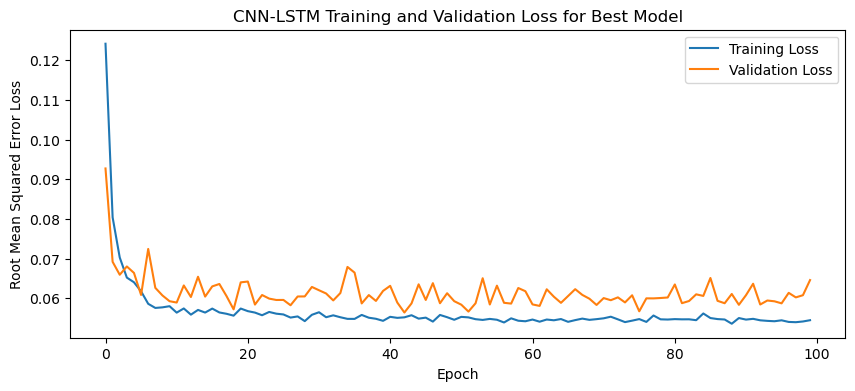

1/1 - 1s - loss: 0.0378 - 1s/epoch - 1s/step
Test Loss: 0.03779962658882141
1/1 [==============================] - 0s 32ms/step


NameError: name 'series' is not defined

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

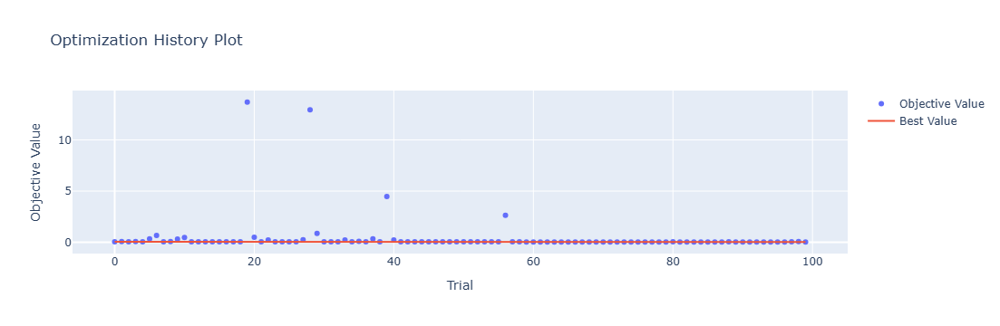

In [4]:
optuna.visualization.plot_optimization_history(study)

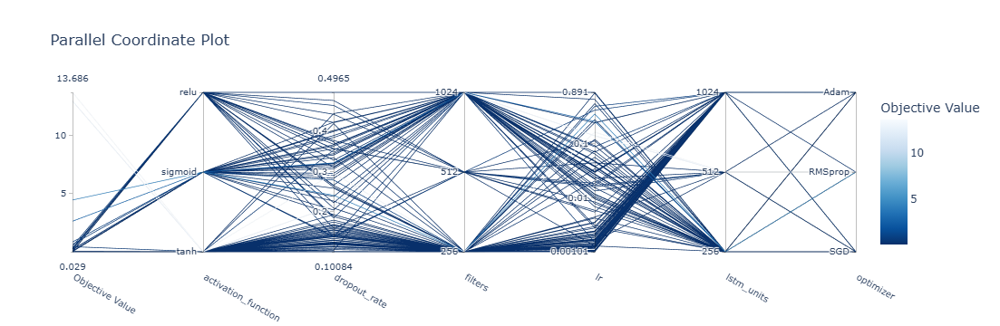

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

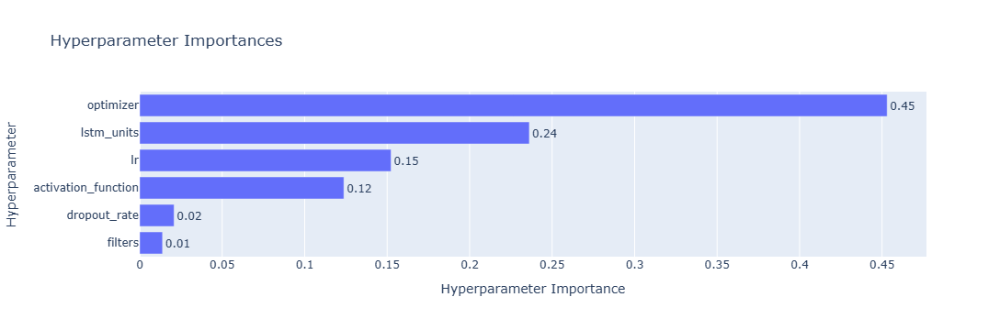

In [6]:
optuna.visualization.plot_param_importances(study)

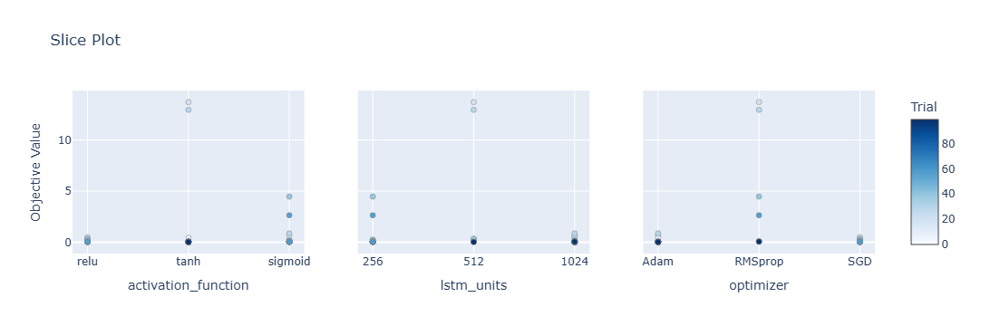

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

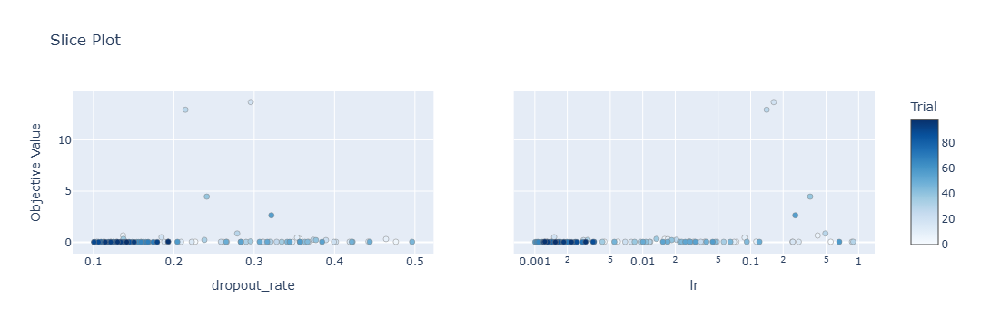

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[12.21  8.17 15.68 ... 23.86 20.59 15.82]
 [14.52 12.85 16.77 ... 26.49 23.17 21.15]
 [ 8.91  6.23 11.39 ... 22.62 16.72 14.05]
 ...
 [ 7.87  5.76 10.62 ... 21.07 15.24 12.04]
 [ 6.49  2.73  9.77 ... 21.93 16.5  11.44]
 [ 5.29  1.27  5.84 ... 22.11 15.37  9.87]]
Epoch 1/100
84/84 [==============================] - 24s 116ms/step - loss: 0.1207 - accuracy: 0.2738 - mae: 0.0997 - rmse: 0.1207 - mape: inf - pearson: 0.6591 - val_loss: 0.0822 - val_accuracy: 0.4000 - val_mae: 0.0665 - val_rmse: 0.0822 - val_mape: 13.7967 - val_pearson: 0.7627
Epoch 2/100
84/84 [==============================] - 5s 62ms/step - loss: 0.0738 - accuracy: 0.4524 - mae: 0.0595 - rmse: 0.0738 - mape: inf - pearson: 0.7999 - val_loss: 0.0682 - val_accuracy: 0.0000e+00 - val_mae: 0.0542 - val_rmse: 0.0682 - val_mape: 11.9147 - val_pearson: 0.8142
Epoch 3/100
84/84 [==============================] - 6s 74ms/step - loss: 0.0703 - accuracy: 0.5119 - mae: 0.0560 - rmse: 0.0703 - mape: inf - pearson: 0.8201 - val_loss:

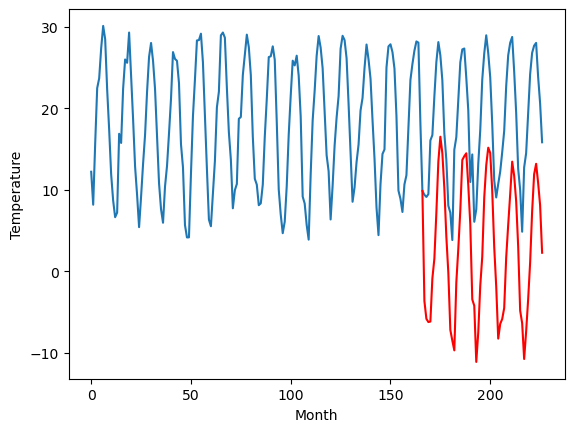

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.39		3.29		-0.10
2.49		1.11		-1.38
2.11		0.71		-1.40
2.86		0.77		-2.09
8.69		6.06		-2.63
9.18		8.47		-0.71
11.95		14.11		2.16
15.70		20.39		4.69
16.18		23.42		7.24
16.81		21.40		4.59
13.83		17.11		3.28
11.20		11.19		-0.01
7.78		6.73		-1.05
0.57		-0.25		-0.82
1.23		-1.57		-2.80
1.14		-2.76		-3.90
6.20		5.55		-0.65
7.60		9.72		2.12
11.62		14.40		2.78
15.10		20.57		5.47
16.32		21.04		4.72
16.66		21.39		4.73
14.53		17.45		2.92
11.90		12.69		0.79
6.39		3.48		-2.91
6.15		2.71		-3.44
-0.53		-4.18		-3.65
2.24		-0.55		-2.79
6.10		5.16		-0.94
9.07		8.71		-0.36
13.38		15.98		2.60
17.07		19.93		2.86
17.21		22.08		4.87
16.66		21.42		4.76
15.64		16.79		1.15
10.04		9.89		-0.15
7.35		5.06		-2.29
3.50		-1.32		-4.82
4.29		0.48		-3.81
5.39		1.09		-4.30
6.98		2.44		-4.54
9.13		8.62		-0.51
12.31		12.61		0.30
15.39		16.36		0.97
17.22		20.37		3.15
18.81		18.62		-0.19
15.43		15.50		0.07
10.32		10.00		-0.32
5.08		2.

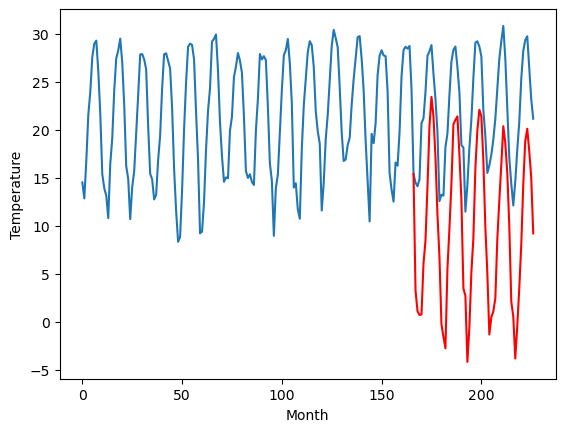

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.93		5.60		0.67
4.82		3.42		-1.40
4.20		3.02		-1.18
4.82		3.08		-1.74
11.07		8.37		-2.70
10.83		10.78		-0.05
14.52		16.42		1.90
18.24		22.70		4.46
20.61		25.73		5.12
19.85		23.71		3.86
16.46		19.42		2.96
12.74		13.50		0.76
7.81		9.04		1.23
0.81		2.06		1.25
1.63		0.74		-0.89
2.49		-0.45		-2.94
8.47		7.86		-0.61
10.11		12.03		1.92
14.09		16.71		2.62
18.23		22.88		4.65
19.99		23.35		3.36
20.27		23.70		3.43
16.70		19.76		3.06
12.82		15.00		2.18
4.46		5.79		1.33
6.64		5.02		-1.62
0.63		-1.87		-2.50
4.58		1.76		-2.82
8.08		7.47		-0.61
10.82		11.02		0.20
16.58		18.29		1.71
20.36		22.24		1.88
21.28		24.39		3.11
20.05		23.73		3.68
16.93		19.10		2.17
9.79		12.20		2.41
7.31		7.37		0.06
2.79		0.99		-1.80
4.74		2.79		-1.95
7.52		3.40		-4.12
7.50		4.75		-2.75
10.57		10.93		0.36
13.98		14.92		0.94
17.30		18.67		1.37
20.40		22.68		2.28
20.01		20.93		0.92
16.56		17.81		1.25
10.58		12.31		1.73
5.49		4.42		-1.

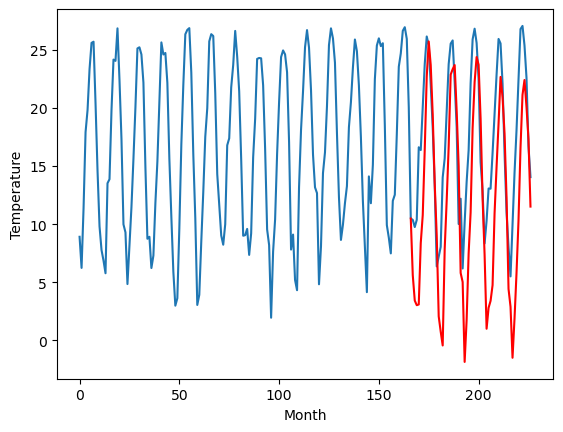

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.13		-0.01		-1.14
1.11		-2.19		-3.30
1.15		-2.59		-3.74
1.15		-2.53		-3.68
8.07		2.76		-5.31
8.15		5.17		-2.98
11.04		10.81		-0.23
13.95		17.09		3.14
14.92		20.12		5.20
15.26		18.10		2.84
12.93		13.81		0.88
8.87		7.89		-0.98
6.03		3.43		-2.60
-1.43		-3.55		-2.12
-1.34		-4.87		-3.53
-2.91		-6.06		-3.15
5.00		2.25		-2.75
6.79		6.42		-0.37
10.76		11.10		0.34
14.04		17.27		3.23
14.67		17.74		3.07
14.72		18.09		3.37
12.21		14.15		1.94
9.90		9.39		-0.51
1.81		0.18		-1.63
4.58		-0.59		-5.17
-2.77		-7.48		-4.71
-0.33		-3.85		-3.52
3.46		1.86		-1.60
8.25		5.41		-2.84
12.77		12.68		-0.09
15.20		16.63		1.43
15.18		18.78		3.60
13.99		18.12		4.13
12.75		13.49		0.74
7.13		6.59		-0.54
3.02		1.76		-1.26
0.84		-4.62		-5.46
2.28		-2.82		-5.10
2.69		-2.21		-4.90
6.21		-0.86		-7.07
7.63		5.32		-2.31
12.06		9.31		-2.75
15.81		13.06		-2.75
16.93		17.07		0.14
18.46		15.32		-3.14
15.02		12.20		-2.82
8.77		6.70		-2.

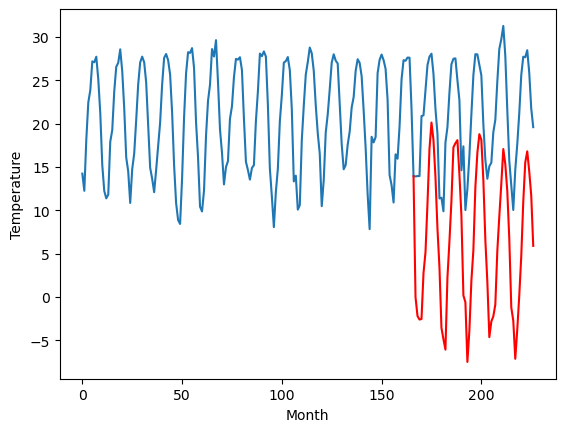

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.34		5.31		-2.03
5.29		3.13		-2.16
6.03		2.73		-3.30
5.36		2.79		-2.57
13.11		8.08		-5.03
13.36		10.49		-2.87
18.34		16.13		-2.21
22.54		22.41		-0.13
24.15		25.44		1.29
24.64		23.42		-1.22
18.93		19.13		0.20
14.05		13.21		-0.84
11.53		8.75		-2.78
5.06		1.77		-3.29
4.18		0.45		-3.73
1.09		-0.74		-1.83
10.99		7.57		-3.42
12.92		11.74		-1.18
16.78		16.42		-0.36
21.98		22.59		0.61
22.41		23.06		0.65
23.17		23.41		0.24
21.16		19.47		-1.69
16.81		14.71		-2.10
9.24		5.50		-3.74
11.57		4.73		-6.84
3.12		-2.16		-5.28
2.89		1.47		-1.42
9.38		7.18		-2.20
15.42		10.73		-4.69
20.13		18.00		-2.13
24.47		21.95		-2.52
26.83		24.10		-2.73
24.47		23.44		-1.03
21.52		18.81		-2.71
15.60		11.91		-3.69
8.67		7.08		-1.59
5.94		0.70		-5.24
6.91		2.50		-4.41
7.04		3.11		-3.93
11.76		4.46		-7.30
13.26		10.64		-2.62
18.79		14.63		-4.16
23.34		18.38		-4.96
26.33		22.39		-3.94
28.07		20.64		-7.43
23.59		17.52		-6.07
15.

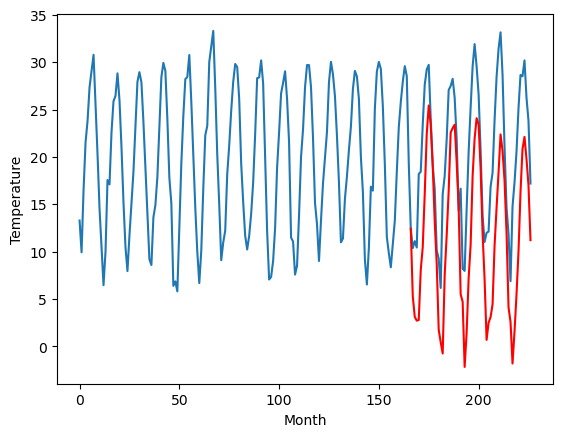

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.63		4.38		-0.25
4.06		2.20		-1.86
3.53		1.80		-1.73
3.22		1.86		-1.36
6.81		7.15		0.34
8.78		9.56		0.78
12.47		15.20		2.73
16.82		21.48		4.66
20.56		24.51		3.95
19.71		22.49		2.78
16.68		18.20		1.52
12.59		12.28		-0.31
8.47		7.82		-0.65
1.72		0.84		-0.88
-0.06		-0.48		-0.42
0.59		-1.67		-2.26
5.49		6.64		1.15
8.86		10.81		1.95
12.37		15.49		3.12
16.94		21.66		4.72
18.93		22.13		3.20
19.41		22.48		3.07
16.40		18.54		2.14
12.80		13.78		0.98
4.63		4.57		-0.06
5.68		3.80		-1.88
-0.70		-3.09		-2.39
2.91		0.54		-2.37
6.83		6.25		-0.58
9.70		9.80		0.10
14.33		17.07		2.74
17.90		21.02		3.12
20.04		23.17		3.13
19.19		22.51		3.32
16.54		17.88		1.34
9.98		10.98		1.00
8.29		6.15		-2.14
1.77		-0.23		-2.00
3.46		1.57		-1.89
4.95		2.18		-2.77
5.86		3.53		-2.33
10.54		9.71		-0.83
12.06		13.70		1.64
15.88		17.45		1.57
19.71		21.46		1.75
19.23		19.71		0.48
15.71		16.59		0.88
11.36		11.09		-0.27
5.92		3.20		-

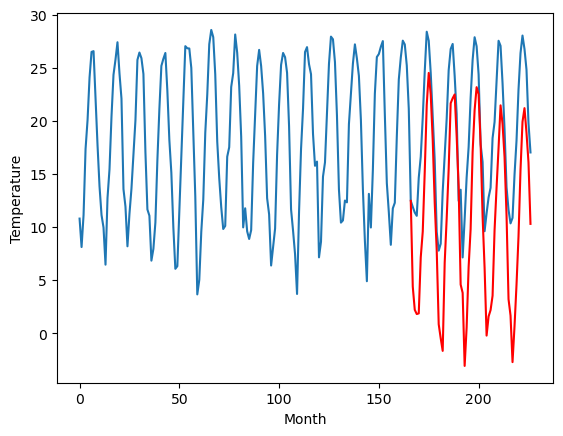

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.68		1.87		1.19
0.32		-0.31		-0.63
-0.15		-0.71		-0.56
0.96		-0.65		-1.61
6.38		4.64		-1.74
7.62		7.05		-0.57
9.96		12.69		2.73
15.21		18.97		3.76
18.28		22.00		3.72
17.25		19.98		2.73
13.36		15.69		2.33
9.36		9.77		0.41
5.18		5.31		0.13
-1.75		-1.67		0.08
-2.33		-2.99		-0.66
-1.69		-4.18		-2.49
5.29		4.13		-1.16
6.32		8.30		1.98
10.03		12.98		2.95
14.36		19.15		4.79
15.98		19.62		3.64
15.92		19.97		4.05
11.87		16.03		4.16
8.64		11.27		2.63
-0.01		2.06		2.07
1.93		1.29		-0.64
-4.72		-5.60		-0.88
-0.74		-1.97		-1.23
3.60		3.74		0.14
6.52		7.29		0.77
11.59		14.56		2.97
15.50		18.51		3.01
16.60		20.66		4.06
15.31		20.00		4.69
12.25		15.37		3.12
5.31		8.47		3.16
3.08		3.64		0.56
-3.43		-2.74		0.69
-0.24		-0.94		-0.70
2.76		-0.33		-3.09
3.24		1.02		-2.22
6.80		7.20		0.40
9.49		11.19		1.70
12.84		14.94		2.10
16.55		18.95		2.40
15.86		17.20		1.34
12.35		14.08		1.73
7.14		8.58		1.44
1.27		0.69		-0.5

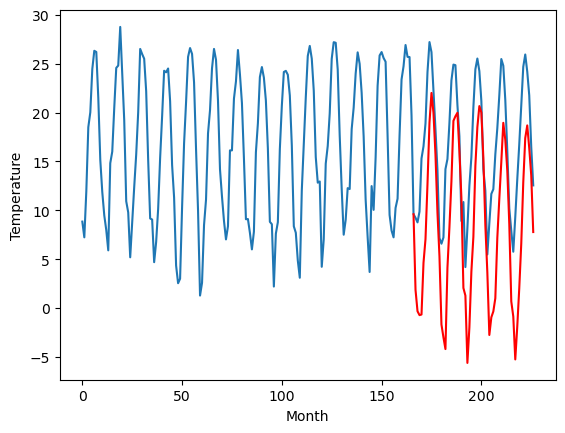

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.37		-0.07		1.30
-1.74		-2.25		-0.51
-1.86		-2.65		-0.79
-0.82		-2.59		-1.77
4.76		2.70		-2.06
5.66		5.11		-0.55
8.78		10.75		1.97
14.30		17.03		2.73
17.56		20.06		2.50
16.19		18.04		1.85
11.32		13.75		2.43
7.48		7.83		0.35
3.25		3.37		0.12
-3.68		-3.61		0.07
-4.62		-4.93		-0.31
-4.00		-6.12		-2.12
2.52		2.19		-0.33
6.15		6.36		0.21
9.17		11.04		1.87
13.96		17.21		3.25
16.08		17.68		1.60
16.03		18.03		2.00
11.52		14.09		2.57
7.67		9.33		1.66
-1.83		0.12		1.95
0.23		-0.65		-0.88
-6.95		-7.54		-0.59
-2.71		-3.91		-1.20
2.13		1.80		-0.33
5.45		5.35		-0.10
10.43		12.62		2.19
14.43		16.57		2.14
16.30		18.72		2.42
14.62		18.06		3.44
10.92		13.43		2.51
3.73		6.53		2.80
1.53		1.70		0.17
-5.64		-4.68		0.96
-2.47		-2.88		-0.41
0.50		-2.27		-2.77
1.18		-0.92		-2.10
5.80		5.26		-0.54
8.09		9.25		1.16
11.84		13.00		1.16
15.98		17.01		1.03
14.84		15.26		0.42
11.08		12.14		1.06
5.69		6.64		0.95
-0.76		-1.

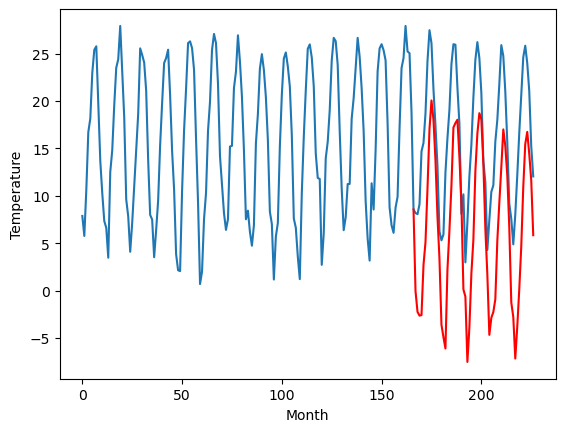

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		-1.05		-0.10
-1.11		-3.23		-2.12
-2.30		-3.63		-1.33
-1.80		-3.57		-1.77
4.77		1.72		-3.05
7.05		4.13		-2.92
11.93		9.77		-2.16
17.86		16.05		-1.81
20.60		19.08		-1.52
17.59		17.06		-0.53
14.03		12.77		-1.26
6.77		6.85		0.08
3.91		2.39		-1.52
-2.80		-4.59		-1.79
-3.59		-5.91		-2.32
-7.86		-7.10		0.76
4.61		1.21		-3.40
7.21		5.38		-1.83
11.90		10.06		-1.84
18.09		16.23		-1.86
18.66		16.70		-1.96
18.60		17.05		-1.55
14.86		13.11		-1.75
10.90		8.35		-2.55
0.86		-0.86		-1.72
2.66		-1.63		-4.29
-5.85		-8.52		-2.67
-3.81		-4.89		-1.08
3.41		0.82		-2.59
7.36		4.37		-2.99
14.20		11.64		-2.56
18.72		15.59		-3.13
21.05		17.74		-3.31
18.17		17.08		-1.09
14.53		12.45		-2.08
7.97		5.55		-2.42
2.00		0.72		-1.28
-3.29		-5.66		-2.37
-0.73		-3.86		-3.13
0.88		-3.25		-4.13
2.70		-1.90		-4.60
8.48		4.28		-4.20
14.07		8.27		-5.80
17.94		12.02		-5.92
19.43		16.03		-3.40
18.17		14.28		-3.89
15.00		11.16		-3

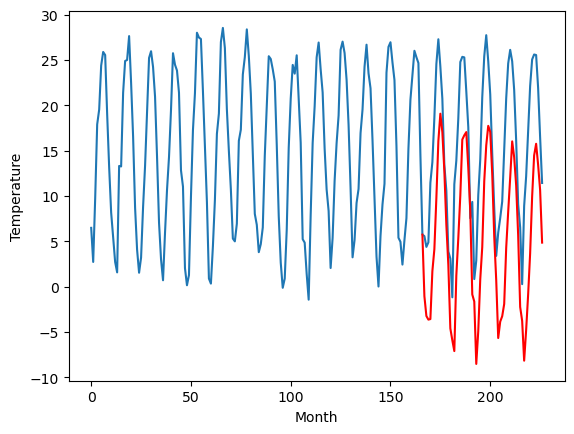

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.56		-2.43		2.13
-4.38		-4.61		-0.23
-5.66		-5.01		0.65
-6.53		-4.95		1.58
0.66		0.34		-0.32
2.32		2.75		0.43
7.41		8.39		0.98
14.39		14.67		0.28
17.02		17.70		0.68
14.64		15.68		1.04
10.97		11.39		0.42
4.58		5.47		0.89
0.90		1.01		0.11
-6.61		-5.97		0.64
-8.20		-7.29		0.91
-10.37		-8.48		1.89
0.38		-0.17		-0.55
3.44		4.00		0.56
7.91		8.68		0.77
14.39		14.85		0.46
15.40		15.32		-0.08
16.00		15.67		-0.33
12.14		11.73		-0.41
7.67		6.97		-0.70
-2.99		-2.24		0.75
-1.76		-3.01		-1.25
-10.73		-9.90		0.83
-7.15		-6.27		0.88
-0.17		-0.56		-0.39
2.56		2.99		0.43
10.73		10.26		-0.47
14.63		14.21		-0.42
16.66		16.36		-0.30
14.75		15.70		0.95
11.02		11.07		0.05
3.98		4.17		0.19
-1.04		-0.66		0.38
-6.75		-7.04		-0.29
-4.86		-5.24		-0.38
-2.82		-4.63		-1.81
-2.48		-3.28		-0.80
3.80		2.90		-0.90
8.76		6.89		-1.87
12.60		10.64		-1.96
15.43		14.65		-0.78
14.63		12.90		-1.73
12.02		9.78		-2.24
5.44		4.28		-

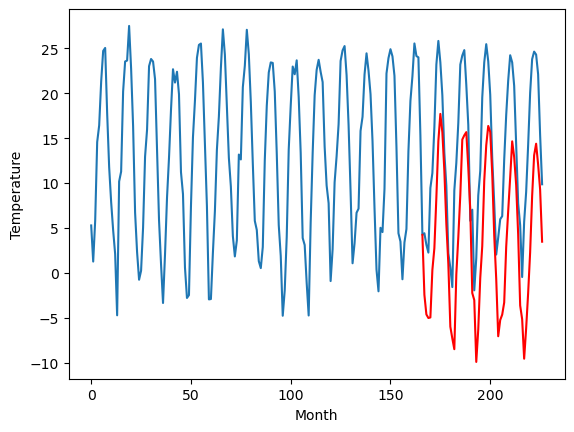

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.06		-3.63		1.43
-5.73		-5.81		-0.08
-6.76		-6.21		0.55
-8.22		-6.15		2.07
-2.08		-0.86		1.22
0.57		1.55		0.98
7.00		7.19		0.19
14.96		13.47		-1.49
18.12		16.50		-1.62
15.43		14.48		-0.95
10.60		10.19		-0.41
3.85		4.27		0.42
0.37		-0.19		-0.56
-6.66		-7.17		-0.51
-8.27		-8.49		-0.22
-12.58		-9.68		2.90
-0.85		-1.37		-0.52
3.12		2.80		-0.32
8.27		7.48		-0.79
15.58		13.65		-1.93
16.17		14.12		-2.05
16.88		14.47		-2.41
12.83		10.53		-2.30
8.48		5.77		-2.71
-2.38		-3.44		-1.06
-3.28		-4.21		-0.93
-12.23		-11.10		1.13
-8.99		-7.47		1.52
-2.08		-1.76		0.32
1.53		1.79		0.26
10.85		9.06		-1.79
15.61		13.01		-2.60
16.72		15.16		-1.56
15.60		14.50		-1.10
11.76		9.87		-1.89
4.52		2.97		-1.55
-0.51		-1.86		-1.35
-6.69		-8.24		-1.55
-5.56		-6.44		-0.88
-5.15		-5.83		-0.68
-3.29		-4.48		-1.19
3.56		1.70		-1.86
8.58		5.69		-2.89
14.09		9.44		-4.65
16.55		13.45		-3.10
14.74		11.70		-3.04
12.36		8.58		-3.7

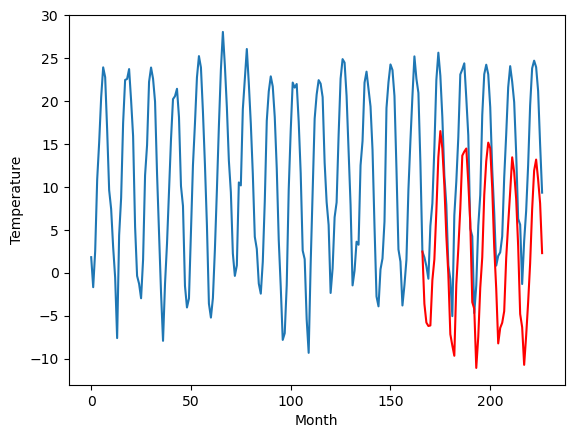

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.98  -3.627945
1                 1    3.39   3.292055
2                 2    4.93   5.602054
3                 3    1.13  -0.007945
4                 4    7.34   5.312055
5                 5    4.63   4.382054
6                 6    0.68   1.872054
7                 7   -1.37  -0.067945
8                 8   -0.95  -1.047945
9                 9   -4.56  -2.427944
10               10   -5.06  -3.627944


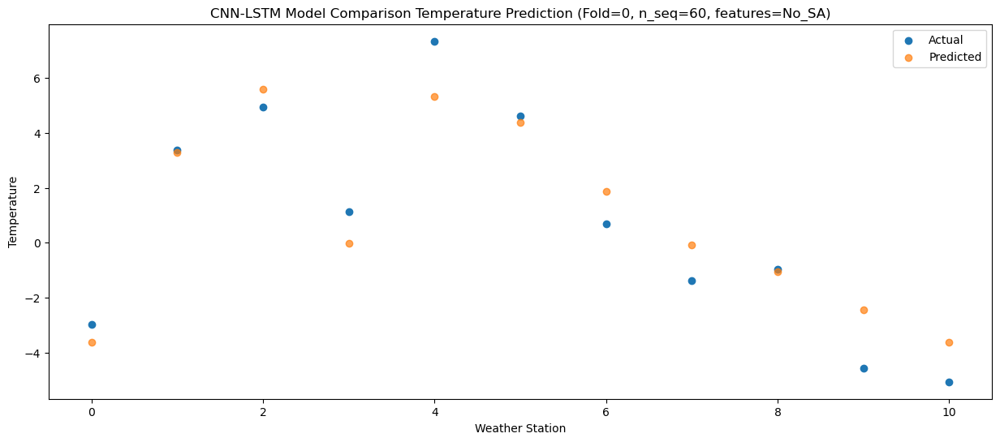

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.45  -5.813407
1                 1    2.49   1.106593
2                 2    4.82   3.416591
3                 3    1.11  -2.193407
4                 4    5.29   3.126593
5                 5    4.06   2.196591
6                 6    0.32  -0.313409
7                 7   -1.74  -2.253409
8                 8   -1.11  -3.233409
9                 9   -4.38  -4.613409
10               10   -5.73  -5.813408


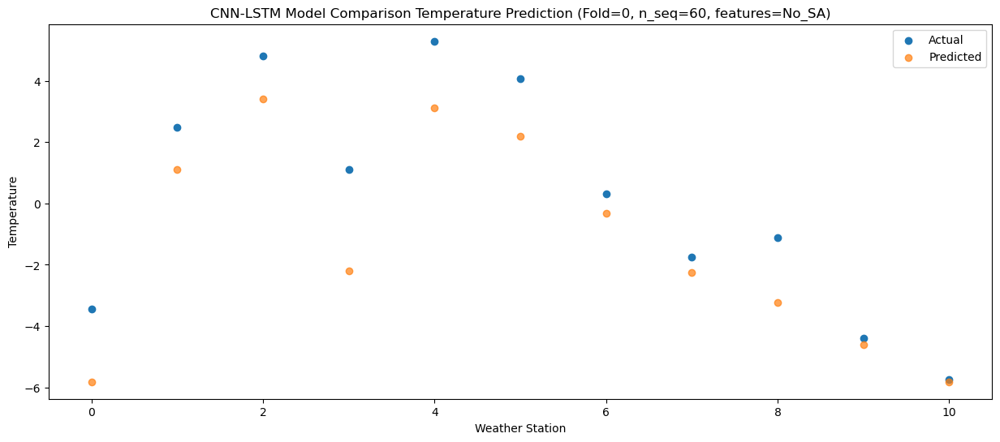

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.72  -6.210816
1                 1    2.11   0.709184
2                 2    4.20   3.019182
3                 3    1.15  -2.590817
4                 4    6.03   2.729184
5                 5    3.53   1.799182
6                 6   -0.15  -0.710818
7                 7   -1.86  -2.650818
8                 8   -2.30  -3.630818
9                 9   -5.66  -5.010817
10               10   -6.76  -6.210816


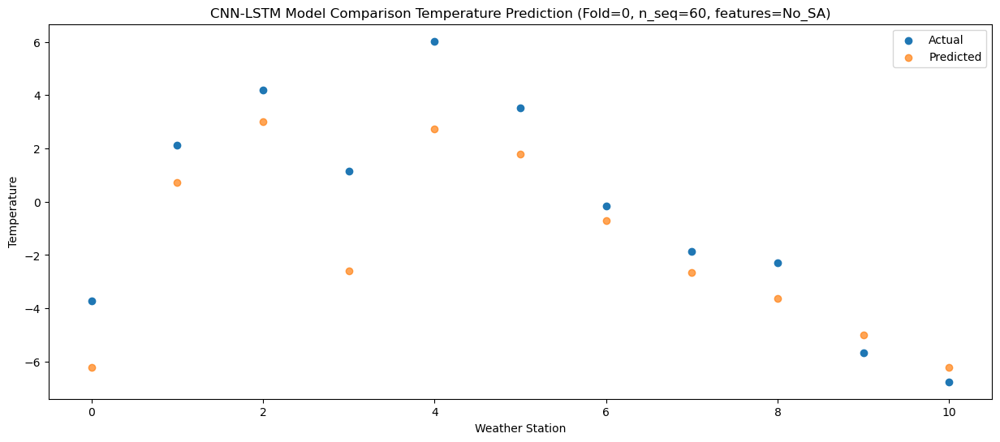

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.37  -6.149191
1                 1    2.86   0.770809
2                 2    4.82   3.080807
3                 3    1.15  -2.529194
4                 4    5.36   2.790809
5                 5    3.22   1.860807
6                 6    0.96  -0.649193
7                 7   -0.82  -2.589195
8                 8   -1.80  -3.569195
9                 9   -6.53  -4.949196
10               10   -8.22  -6.149195


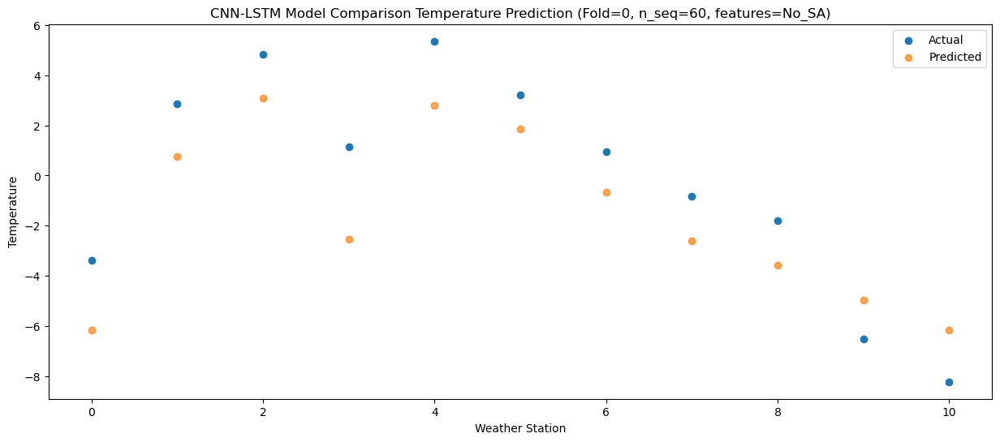

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.21  -0.864663
1                 1    8.69   6.055337
2                 2   11.07   8.365335
3                 3    8.07   2.755334
4                 4   13.11   8.075337
5                 5    6.81   7.145338
6                 6    6.38   4.635338
7                 7    4.76   2.695331
8                 8    4.77   1.715331
9                 9    0.66   0.335330
10               10   -2.08  -0.864667


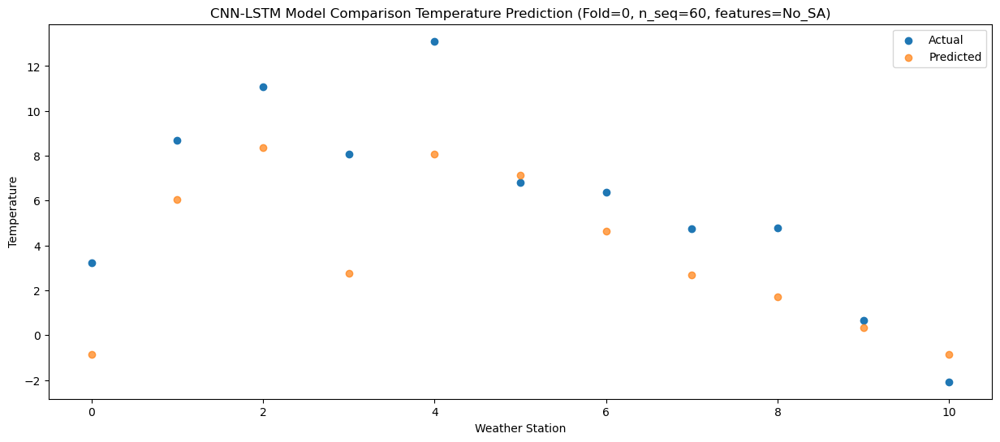

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.86   1.551662
1                 1    9.18   8.471662
2                 2   10.83  10.781660
3                 3    8.15   5.171659
4                 4   13.36  10.491662
5                 5    8.78   9.561663
6                 6    7.62   7.051663
7                 7    5.66   5.111654
8                 8    7.05   4.131656
9                 9    2.32   2.751655
10               10    0.57   1.551658


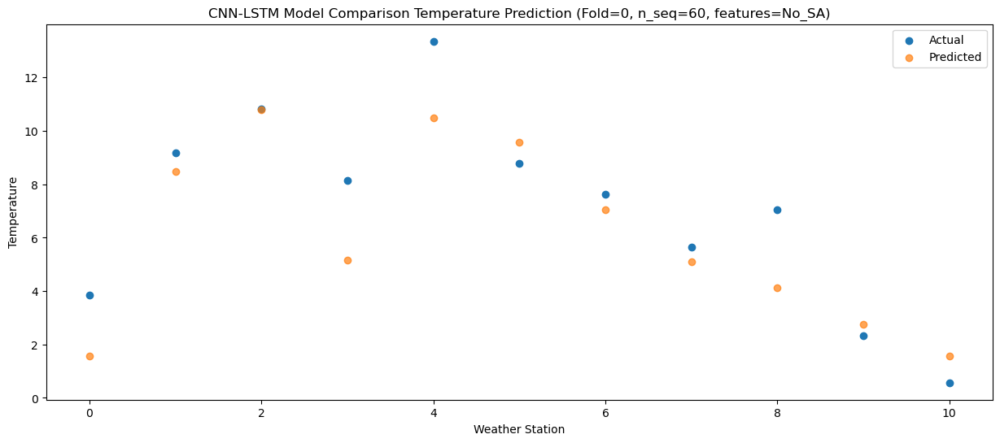

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.59   7.188890
1                 1   11.95  14.108888
2                 2   14.52  16.418890
3                 3   11.04  10.808883
4                 4   18.34  16.128890
5                 5   12.47  15.198892
6                 6    9.96  12.688892
7                 7    8.78  10.748884
8                 8   11.93   9.768884
9                 9    7.41   8.388887
10               10    7.00   7.188888


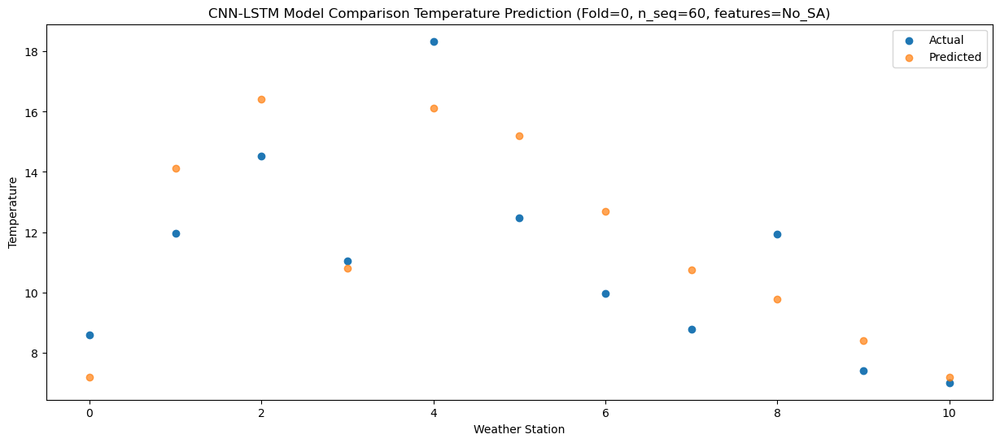

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.81  13.472516
1                 1   15.70  20.392514
2                 2   18.24  22.702517
3                 3   13.95  17.092511
4                 4   22.54  22.412518
5                 5   16.82  21.482519
6                 6   15.21  18.972521
7                 7   14.30  17.032513
8                 8   17.86  16.052512
9                 9   14.39  14.672514
10               10   14.96  13.472515


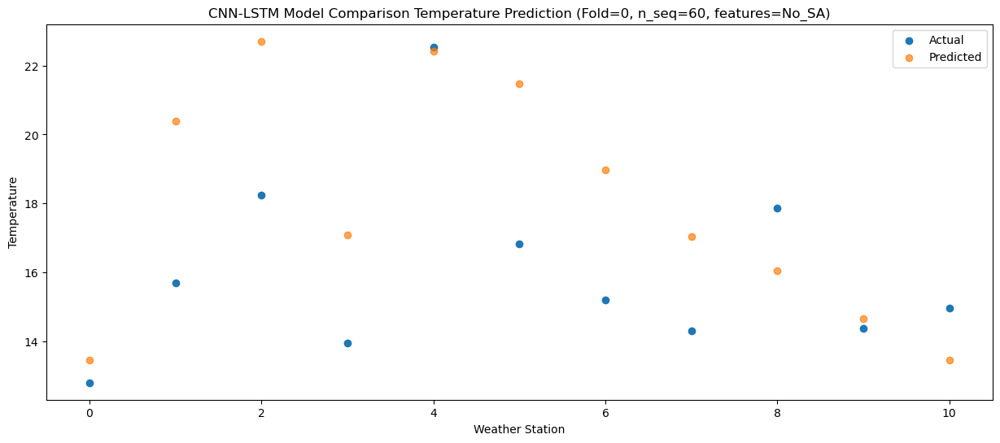

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.26  16.500495
1                 1   16.18  23.420493
2                 2   20.61  25.730496
3                 3   14.92  20.120490
4                 4   24.15  25.440499
5                 5   20.56  24.510498
6                 6   18.28  22.000500
7                 7   17.56  20.060494
8                 8   20.60  19.080493
9                 9   17.02  17.700495
10               10   18.12  16.500498


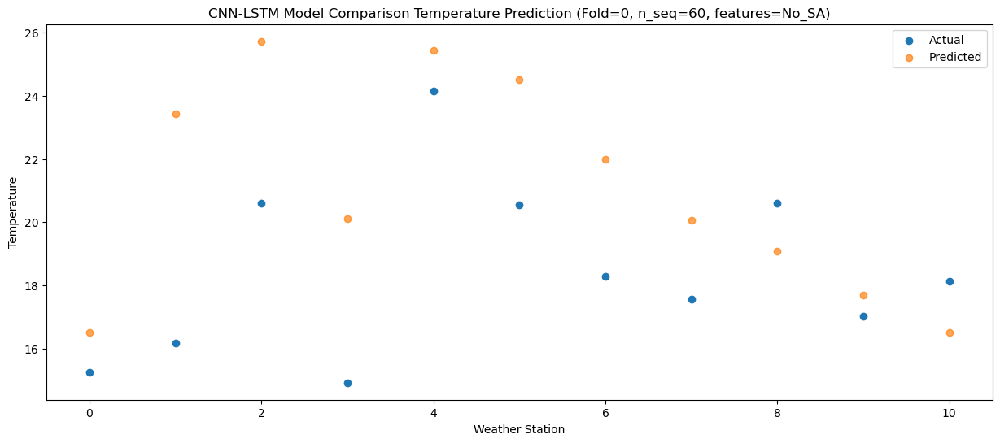

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.63  14.475831
1                 1   16.81  21.395831
2                 2   19.85  23.705832
3                 3   15.26  18.095828
4                 4   24.64  23.415836
5                 5   19.71  22.485835
6                 6   17.25  19.975837
7                 7   16.19  18.035831
8                 8   17.59  17.055831
9                 9   14.64  15.675830
10               10   15.43  14.475834


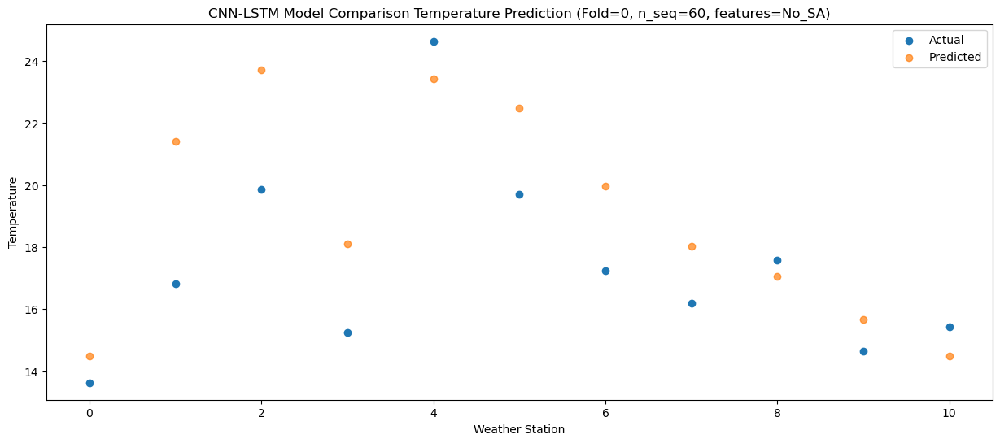

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.57  10.194463
1                 1   13.83  17.114463
2                 2   16.46  19.424464
3                 3   12.93  13.814460
4                 4   18.93  19.134467
5                 5   16.68  18.204466
6                 6   13.36  15.694467
7                 7   11.32  13.754463
8                 8   14.03  12.774463
9                 9   10.97  11.394462
10               10   10.60  10.194466


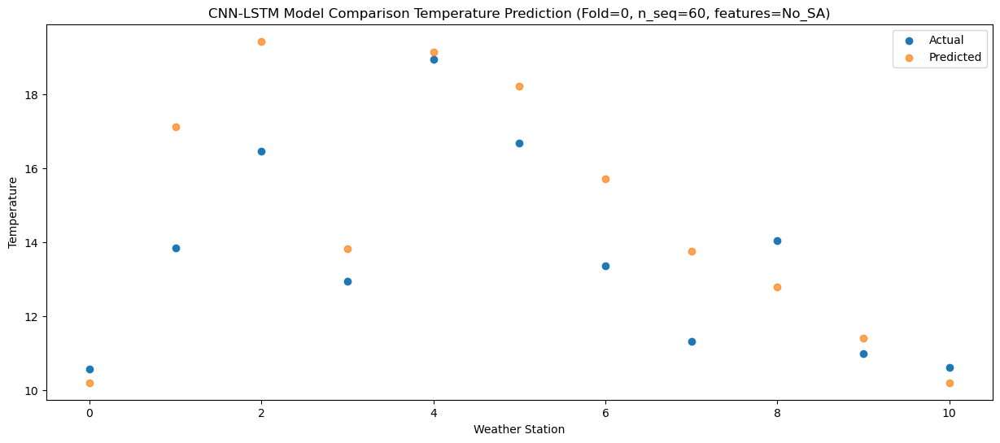

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.07   4.266087
1                 1   11.20  11.186087
2                 2   12.74  13.496088
3                 3    8.87   7.886084
4                 4   14.05  13.206091
5                 5   12.59  12.276090
6                 6    9.36   9.766092
7                 7    7.48   7.826088
8                 8    6.77   6.846088
9                 9    4.58   5.466087
10               10    3.85   4.266090


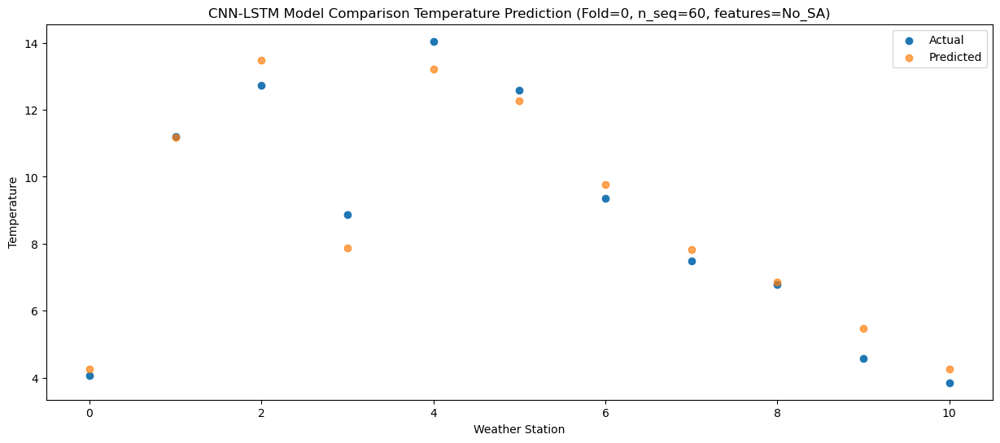

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    0.83  -0.192358
1                 1    7.78   6.727642
2                 2    7.81   9.037642
3                 3    6.03   3.427639
4                 4   11.53   8.747647
5                 5    8.47   7.817644
6                 6    5.18   5.307647
7                 7    3.25   3.367642
8                 8    3.91   2.387642
9                 9    0.90   1.007640
10               10    0.37  -0.192357


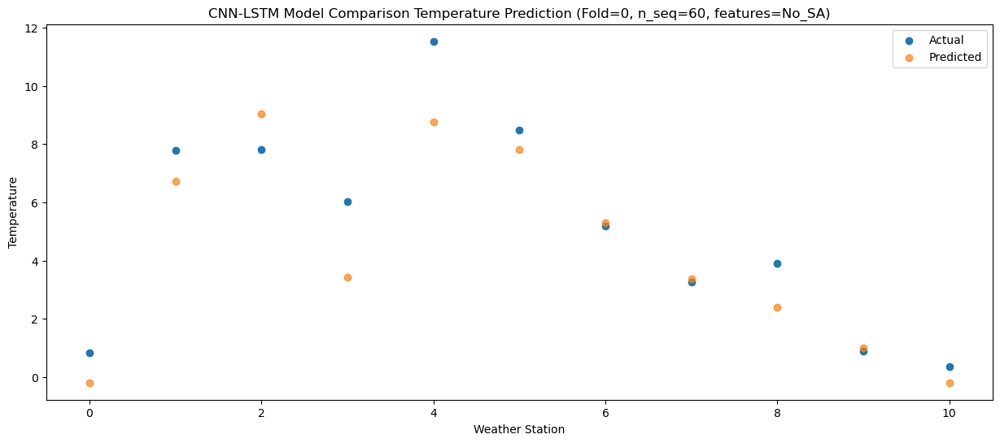

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.79  -7.170814
1                 1    0.57  -0.250813
2                 2    0.81   2.059189
3                 3   -1.43  -3.550816
4                 4    5.06   1.769191
5                 5    1.72   0.839190
6                 6   -1.75  -1.670807
7                 7   -3.68  -3.610811
8                 8   -2.80  -4.590812
9                 9   -6.61  -5.970815
10               10   -6.66  -7.170811


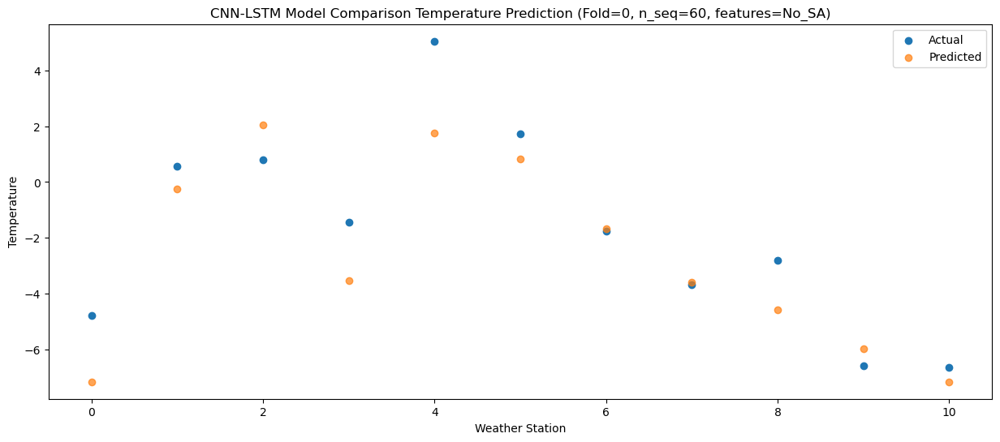

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -5.65  -8.485441
1                 1    1.23  -1.565441
2                 2    1.63   0.744560
3                 3   -1.34  -4.865443
4                 4    4.18   0.454564
5                 5   -0.06  -0.475438
6                 6   -2.33  -2.985435
7                 7   -4.62  -4.925440
8                 8   -3.59  -5.905440
9                 9   -8.20  -7.285443
10               10   -8.27  -8.485440


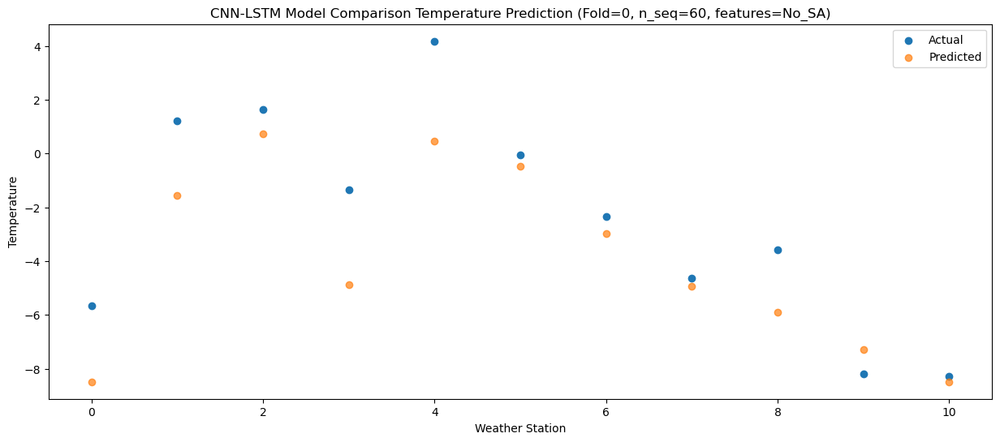

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.00  -9.680130
1                 1    1.14  -2.760130
2                 2    2.49  -0.450128
3                 3   -2.91  -6.060131
4                 4    1.09  -0.740122
5                 5    0.59  -1.670127
6                 6   -1.69  -4.180123
7                 7   -4.00  -6.120128
8                 8   -7.86  -7.100128
9                 9  -10.37  -8.480133
10               10  -12.58  -9.680130


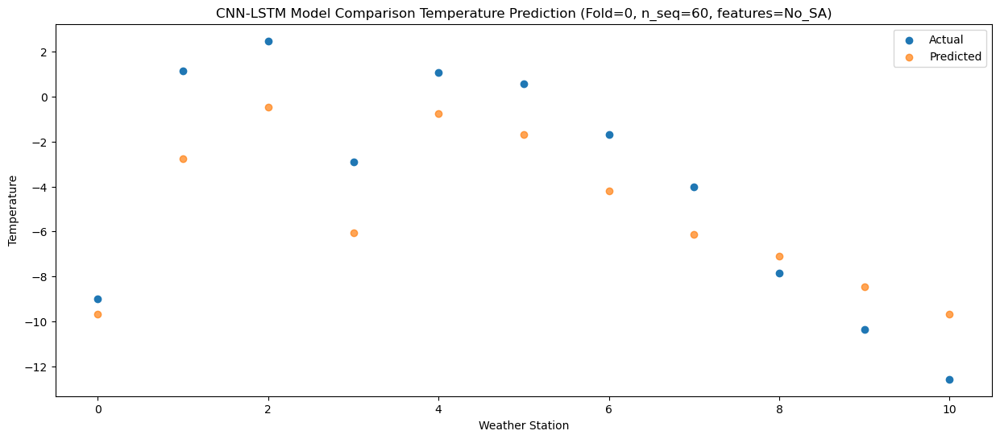

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.07  -1.372439
1                 1    6.20   5.547561
2                 2    8.47   7.857567
3                 3    5.00   2.247560
4                 4   10.99   7.567569
5                 5    5.49   6.637567
6                 6    5.29   4.127571
7                 7    2.52   2.187567
8                 8    4.61   1.207566
9                 9    0.38  -0.172443
10               10   -0.85  -1.372439


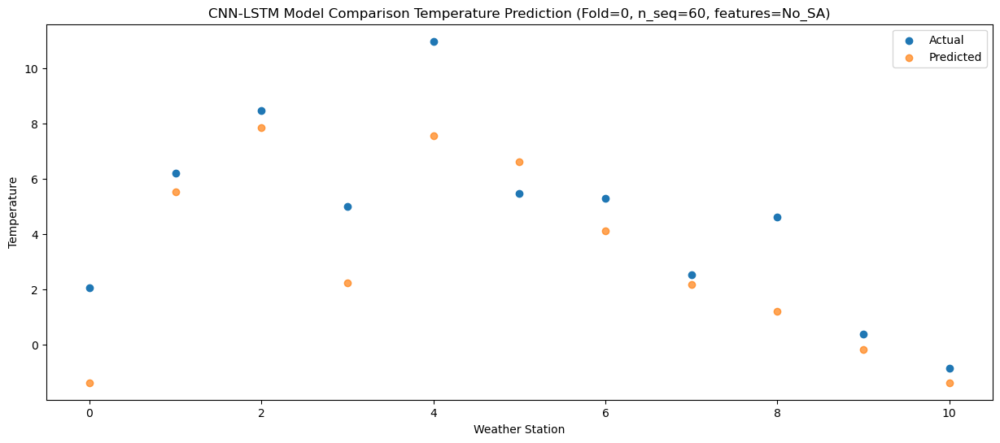

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.60   2.796986
1                 1    7.60   9.716986
2                 2   10.11  12.026990
3                 3    6.79   6.416986
4                 4   12.92  11.736996
5                 5    8.86  10.806992
6                 6    6.32   8.296994
7                 7    6.15   6.356990
8                 8    7.21   5.376990
9                 9    3.44   3.996978
10               10    3.12   2.796982


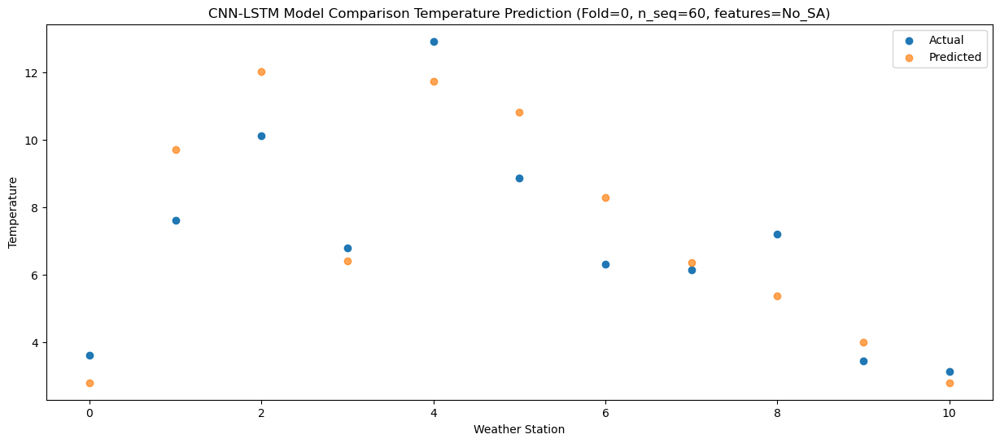

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.10   7.475148
1                 1   11.62  14.395148
2                 2   14.09  16.705152
3                 3   10.76  11.095149
4                 4   16.78  16.415158
5                 5   12.37  15.485155
6                 6   10.03  12.975157
7                 7    9.17  11.035152
8                 8   11.90  10.055152
9                 9    7.91   8.675137
10               10    8.27   7.475143


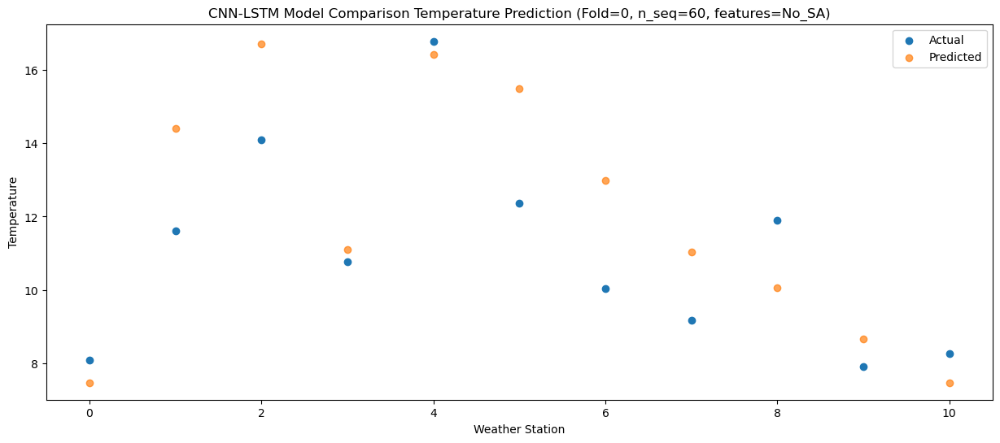

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.77  13.646500
1                 1   15.10  20.566500
2                 2   18.23  22.876500
3                 3   14.04  17.266501
4                 4   21.98  22.586508
5                 5   16.94  21.656503
6                 6   14.36  19.146505
7                 7   13.96  17.206502
8                 8   18.09  16.226502
9                 9   14.39  14.846487
10               10   15.58  13.646491


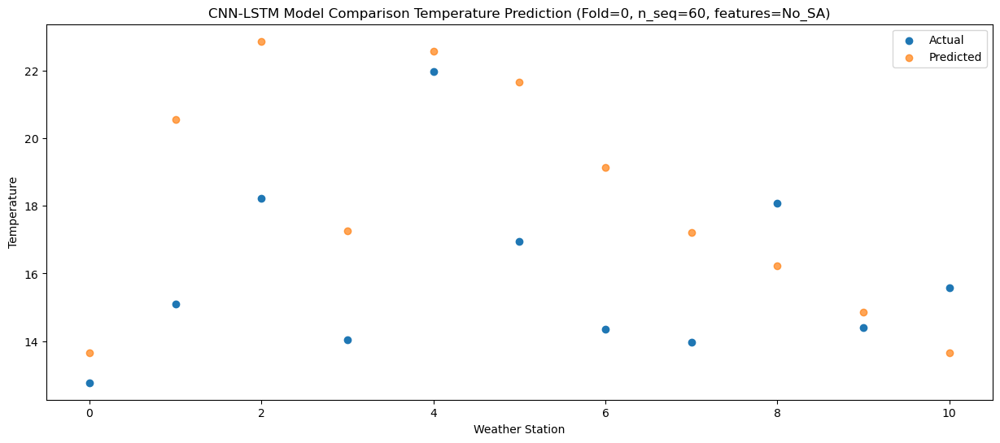

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.36  14.116822
1                 1   16.32  21.036820
2                 2   19.99  23.346823
3                 3   14.67  17.736821
4                 4   22.41  23.056828
5                 5   18.93  22.126825
6                 6   15.98  19.616825
7                 7   16.08  17.676822
8                 8   18.66  16.696824
9                 9   15.40  15.316811
10               10   16.17  14.116815


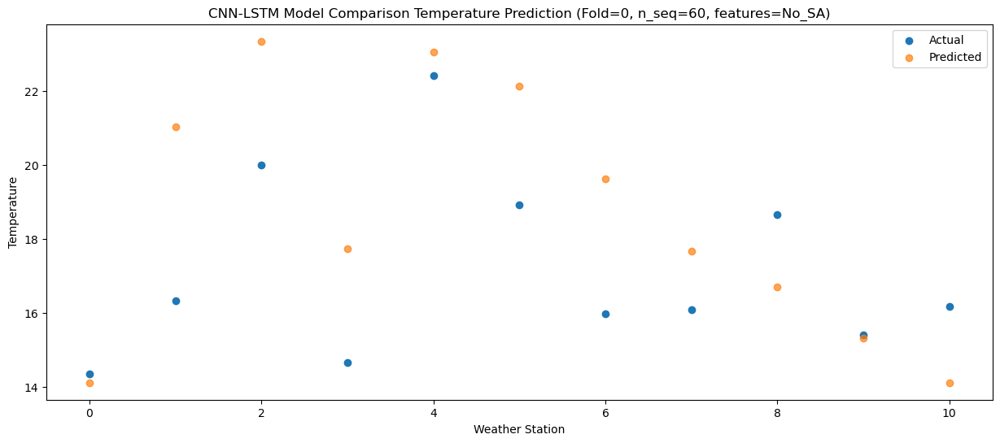

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.47  14.471795
1                 1   16.66  21.391793
2                 2   20.27  23.701798
3                 3   14.72  18.091794
4                 4   23.17  23.411799
5                 5   19.41  22.481800
6                 6   15.92  19.971800
7                 7   16.03  18.031796
8                 8   18.60  17.051797
9                 9   16.00  15.671786
10               10   16.88  14.471790


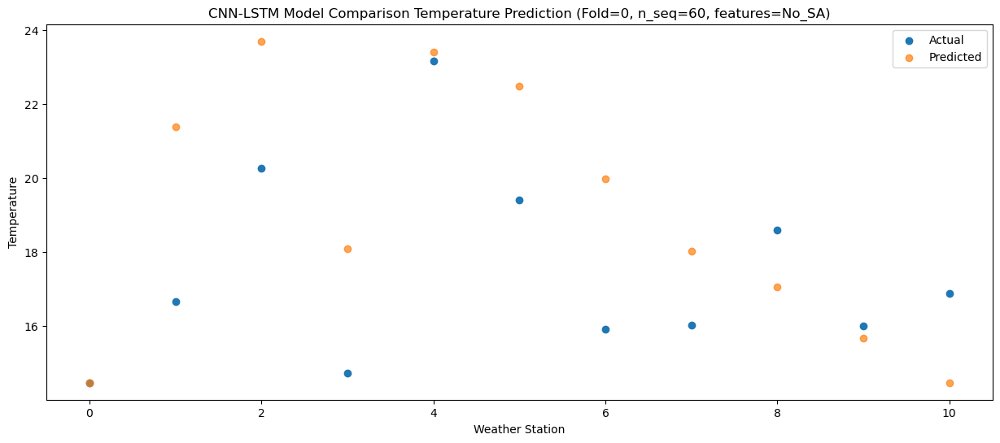

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.89  10.531658
1                 1   14.53  17.451657
2                 2   16.70  19.761661
3                 3   12.21  14.151658
4                 4   21.16  19.471664
5                 5   16.40  18.541663
6                 6   11.87  16.031663
7                 7   11.52  14.091659
8                 8   14.86  13.111659
9                 9   12.14  11.731650
10               10   12.83  10.531654


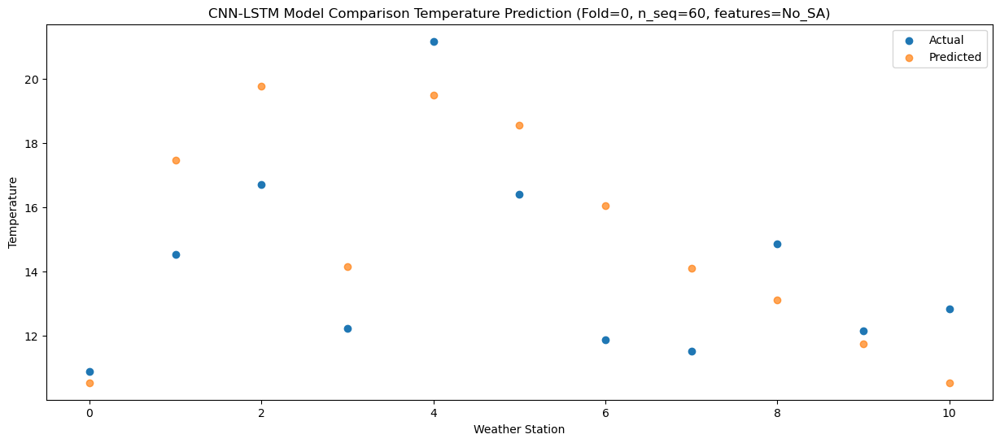

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.87   5.774310
1                 1   11.90  12.694309
2                 2   12.82  15.004312
3                 3    9.90   9.394310
4                 4   16.81  14.714316
5                 5   12.80  13.784315
6                 6    8.64  11.274314
7                 7    7.67   9.334310
8                 8   10.90   8.354311
9                 9    7.67   6.974300
10               10    8.48   5.774304


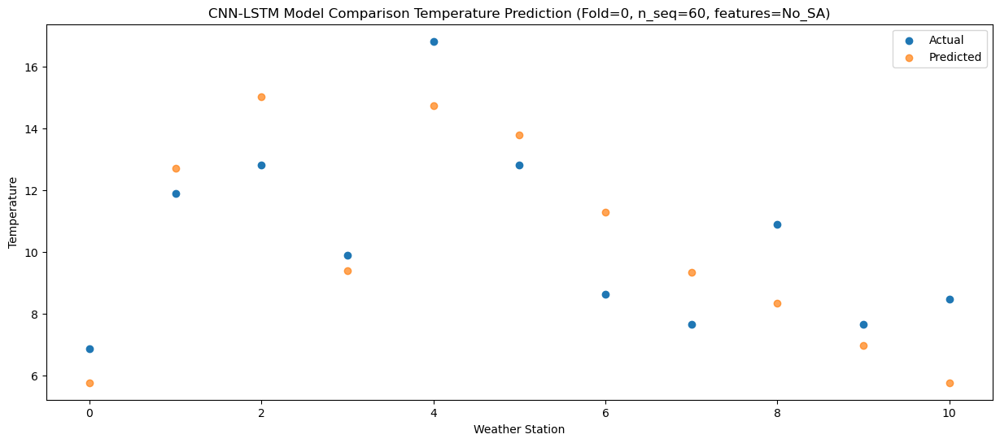

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.89  -3.435512
1                 1    6.39   3.484488
2                 2    4.46   5.794490
3                 3    1.81   0.184490
4                 4    9.24   5.504498
5                 5    4.63   4.574493
6                 6   -0.01   2.064493
7                 7   -1.83   0.124488
8                 8    0.86  -0.855511
9                 9   -2.99  -2.235523
10               10   -2.38  -3.435519


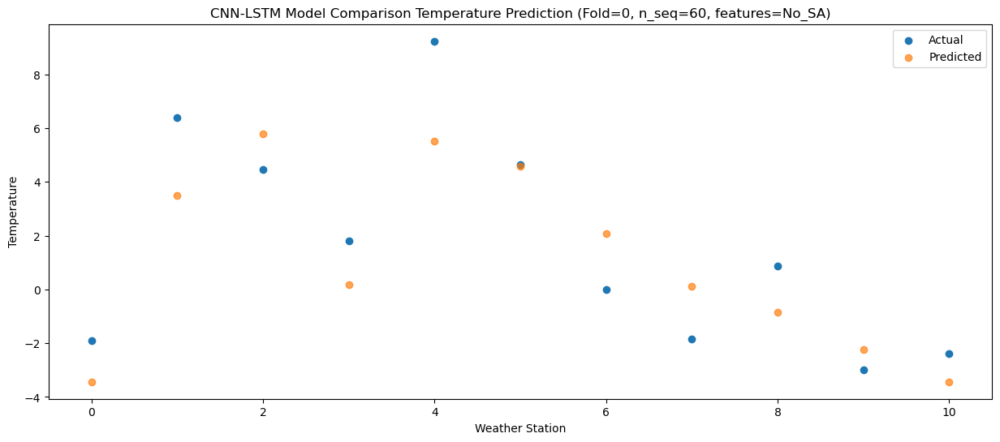

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.49  -4.214378
1                 1    6.15   2.705624
2                 2    6.64   5.015625
3                 3    4.58  -0.594374
4                 4   11.57   4.725636
5                 5    5.68   3.795627
6                 6    1.93   1.285627
7                 7    0.23  -0.654375
8                 8    2.66  -1.634377
9                 9   -1.76  -3.014386
10               10   -3.28  -4.214383


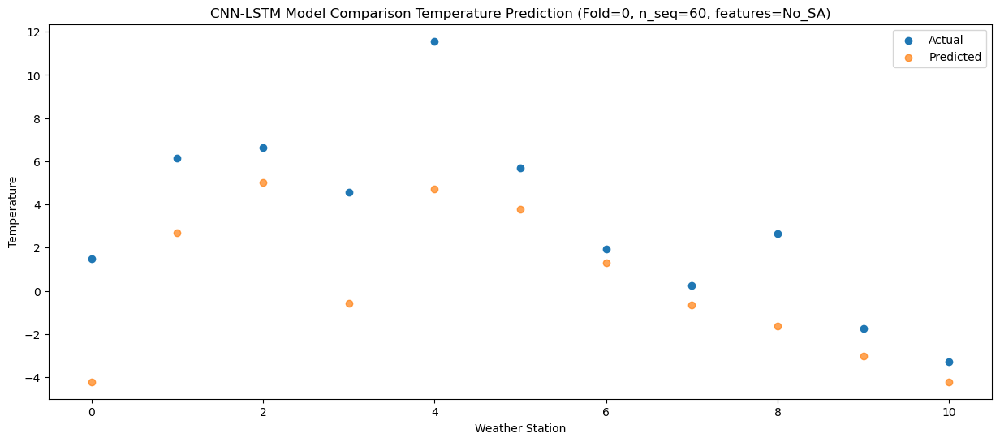

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -6.76 -11.096714
1                 1   -0.53  -4.176712
2                 2    0.63  -1.866711
3                 3   -2.77  -7.476710
4                 4    3.12  -2.156701
5                 5   -0.70  -3.086709
6                 6   -4.72  -5.596709
7                 7   -6.95  -7.536712
8                 8   -5.85  -8.516714
9                 9  -10.73  -9.896723
10               10  -12.23 -11.096719


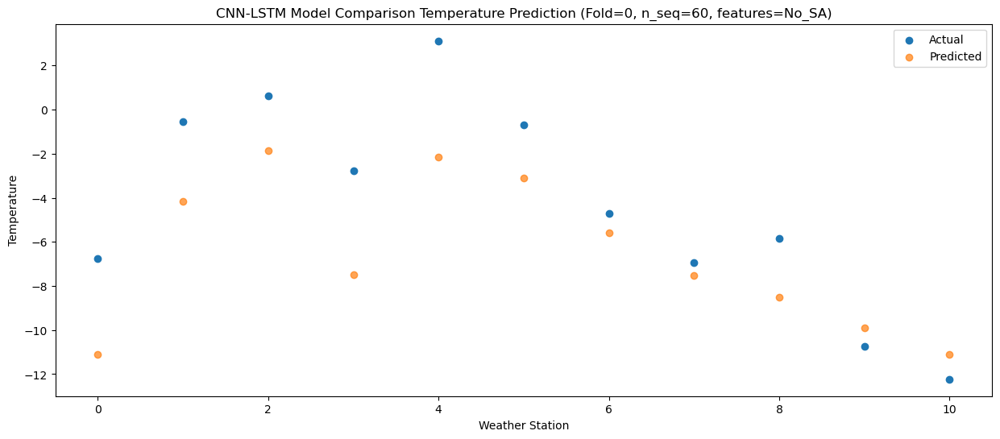

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -5.24  -7.470282
1                 1    2.24  -0.550280
2                 2    4.58   1.759720
3                 3   -0.33  -3.850278
4                 4    2.89   1.469731
5                 5    2.91   0.539723
6                 6   -0.74  -1.970277
7                 7   -2.71  -3.910281
8                 8   -3.81  -4.890282
9                 9   -7.15  -6.270291
10               10   -8.99  -7.470287


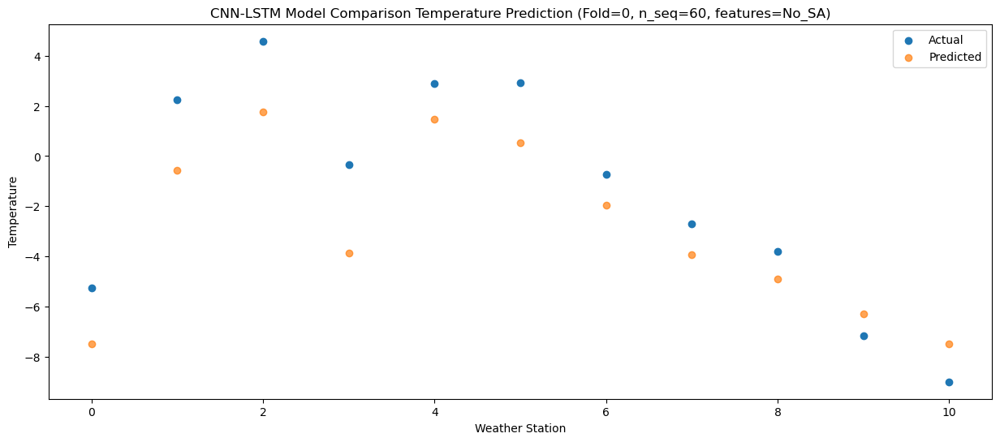

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.34  -1.760626
1                 1    6.10   5.159376
2                 2    8.08   7.469376
3                 3    3.46   1.859377
4                 4    9.38   7.179387
5                 5    6.83   6.249378
6                 6    3.60   3.739378
7                 7    2.13   1.799375
8                 8    3.41   0.819374
9                 9   -0.17  -0.560639
10               10   -2.08  -1.760633


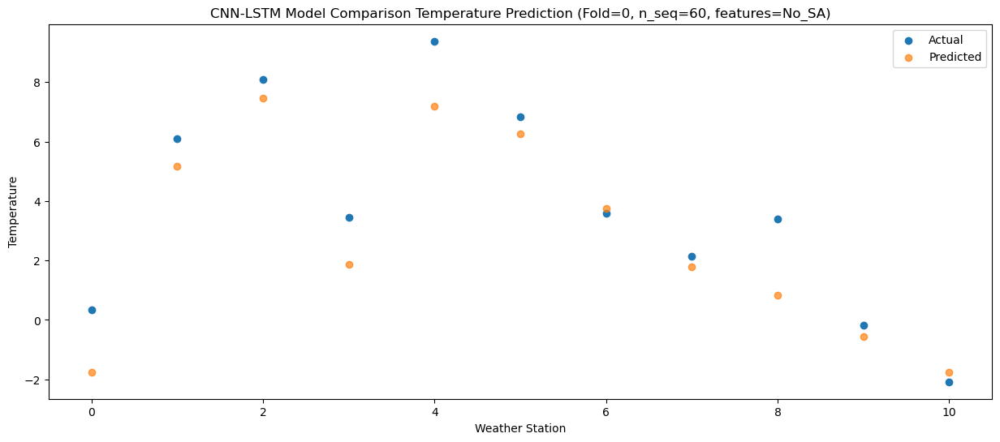

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.47   1.793666
1                 1    9.07   8.713666
2                 2   10.82  11.023668
3                 3    8.25   5.413668
4                 4   15.42  10.733678
5                 5    9.70   9.803670
6                 6    6.52   7.293670
7                 7    5.45   5.353669
8                 8    7.36   4.373668
9                 9    2.56   2.993651
10               10    1.53   1.793659


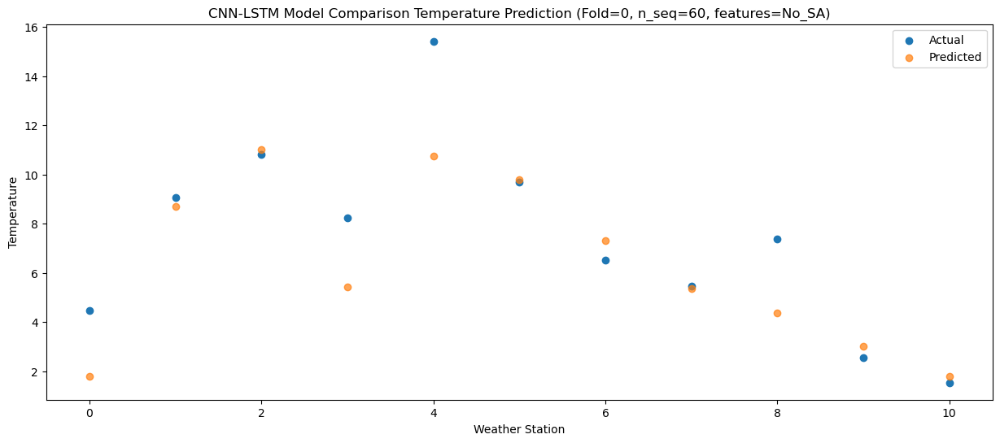

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.66   9.060252
1                 1   13.38  15.980250
2                 2   16.58  18.290253
3                 3   12.77  12.680252
4                 4   20.13  18.000263
5                 5   14.33  17.070255
6                 6   11.59  14.560255
7                 7   10.43  12.620254
8                 8   14.20  11.640253
9                 9   10.73  10.260236
10               10   10.85   9.060244


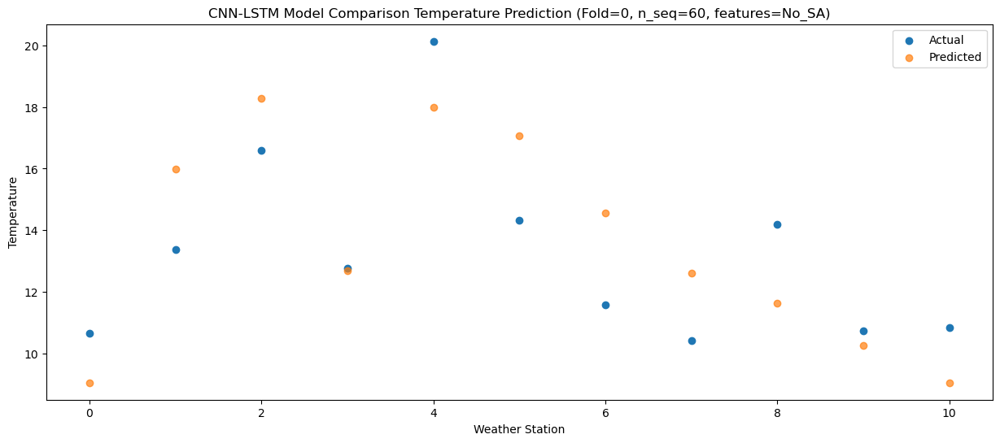

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.87  13.005276
1                 1   17.07  19.925272
2                 2   20.36  22.235277
3                 3   15.20  16.625276
4                 4   24.47  21.945287
5                 5   17.90  21.015281
6                 6   15.50  18.505281
7                 7   14.43  16.565278
8                 8   18.72  15.585276
9                 9   14.63  14.205256
10               10   15.61  13.005264


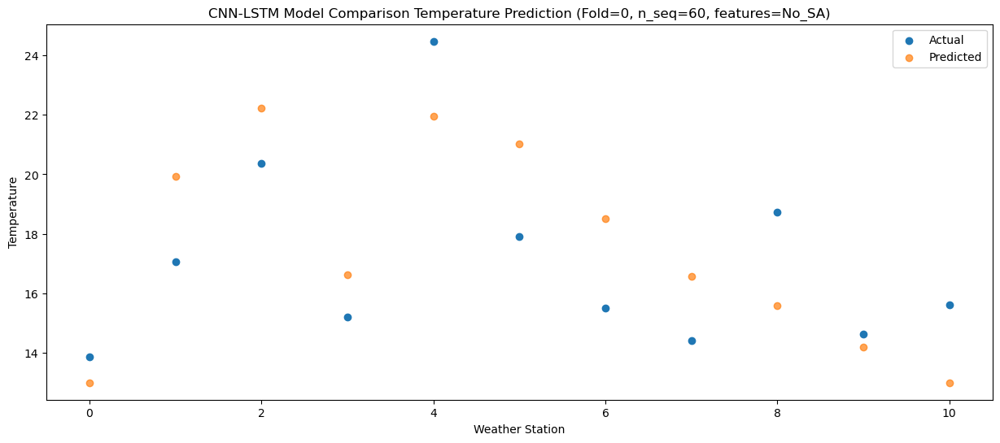

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   16.09  15.159818
1                 1   17.21  22.079814
2                 2   21.28  24.389818
3                 3   15.18  18.779820
4                 4   26.83  24.099833
5                 5   20.04  23.169823
6                 6   16.60  20.659823
7                 7   16.30  18.719819
8                 8   21.05  17.739818
9                 9   16.66  16.359798
10               10   16.72  15.159805


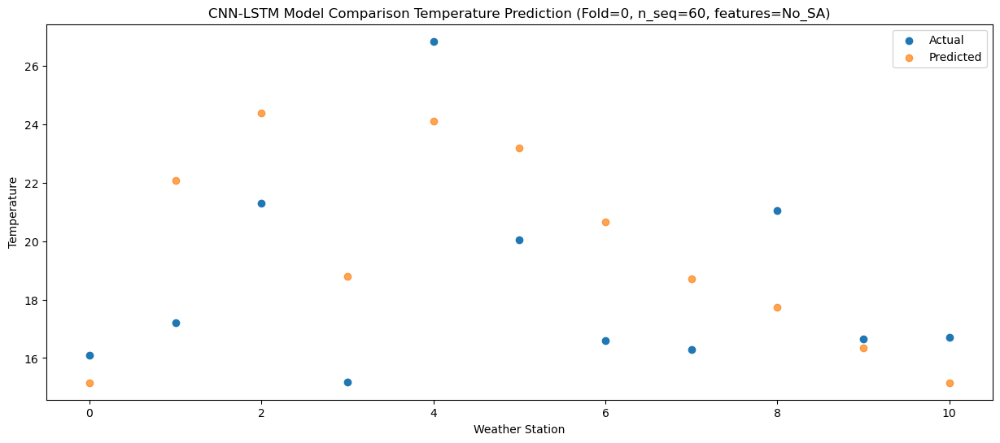

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.91  14.499792
1                 1   16.66  21.419788
2                 2   20.05  23.729792
3                 3   13.99  18.119794
4                 4   24.47  23.439807
5                 5   19.19  22.509797
6                 6   15.31  19.999797
7                 7   14.62  18.059791
8                 8   18.17  17.079792
9                 9   14.75  15.699772
10               10   15.60  14.499779


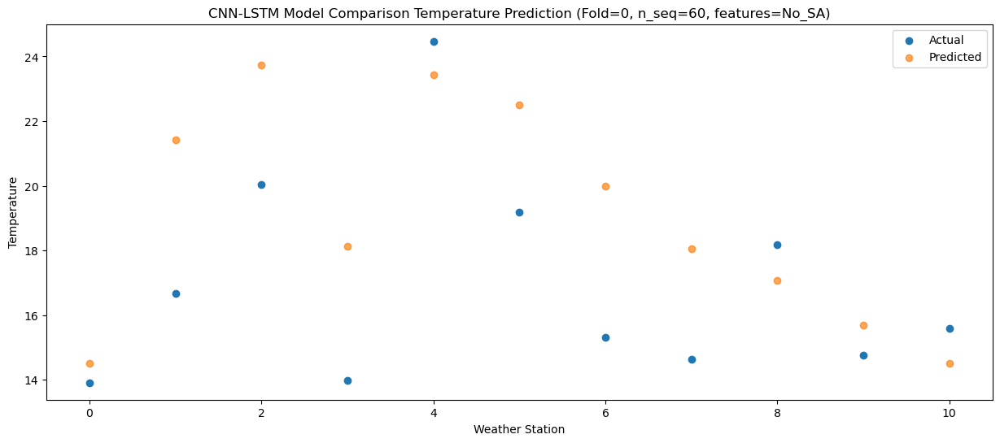

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.94   9.865876
1                 1   15.64  16.785872
2                 2   16.93  19.095875
3                 3   12.75  13.485878
4                 4   21.52  18.805891
5                 5   16.54  17.875880
6                 6   12.25  15.365879
7                 7   10.92  13.425875
8                 8   14.53  12.445875
9                 9   11.02  11.065854
10               10   11.76   9.865863


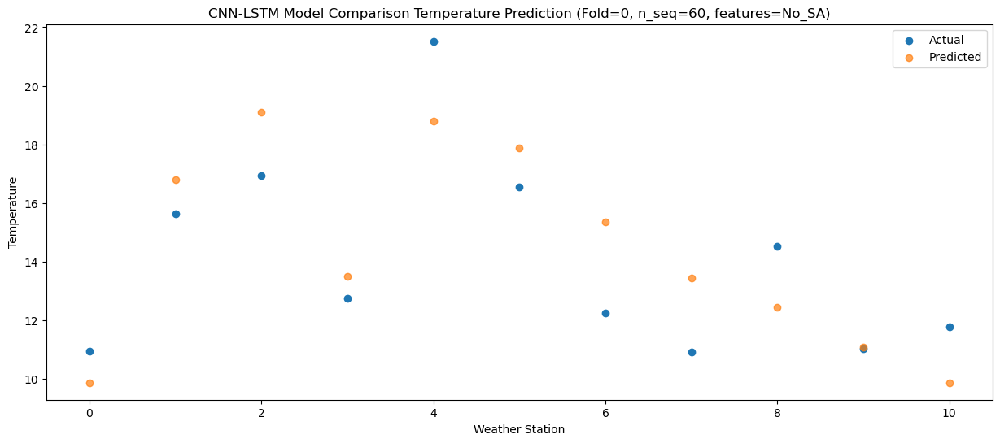

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.26   2.971921
1                 1   10.04   9.891918
2                 2    9.79  12.201923
3                 3    7.13   6.591923
4                 4   15.60  11.911936
5                 5    9.98  10.981928
6                 6    5.31   8.471927
7                 7    3.73   6.531923
8                 8    7.97   5.551922
9                 9    3.98   4.171902
10               10    4.52   2.971911


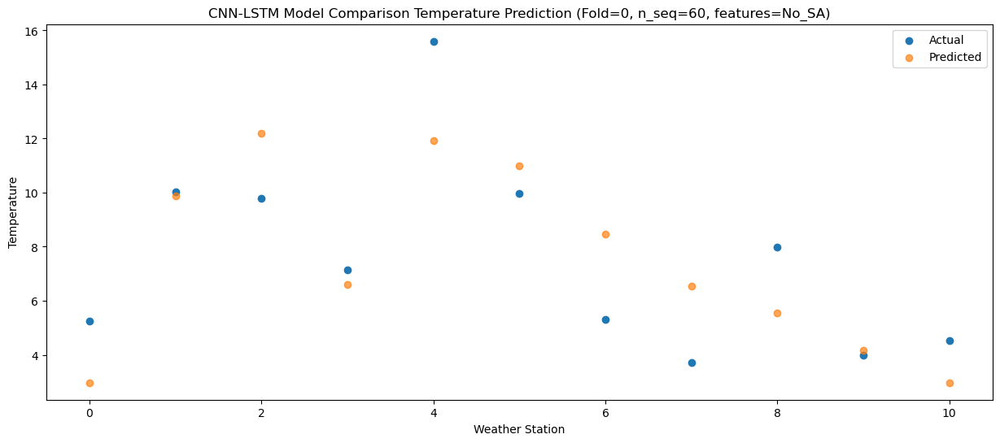

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -1.855978
1                 1    7.35   5.064019
2                 2    7.31   7.374024
3                 3    3.02   1.764024
4                 4    8.67   7.084037
5                 5    8.29   6.154029
6                 6    3.08   3.644028
7                 7    1.53   1.704025
8                 8    2.00   0.724024
9                 9   -1.04  -0.655994
10               10   -0.51  -1.855986


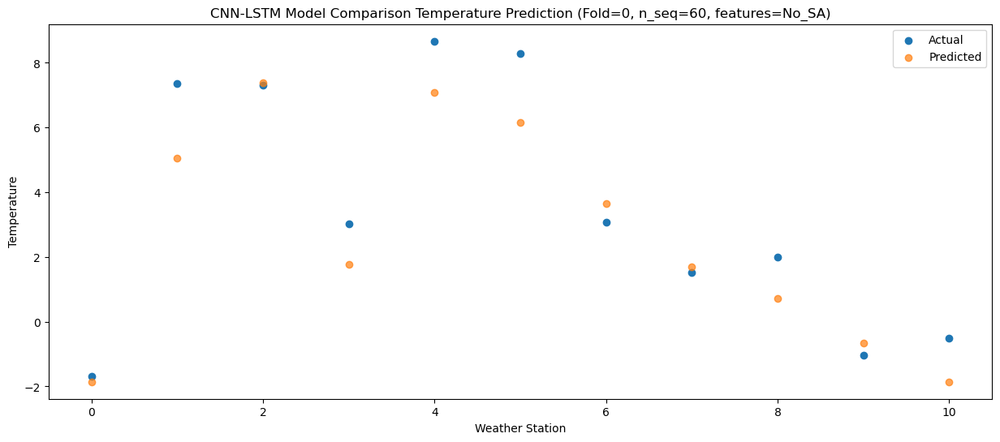

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.78  -8.240204
1                 1    3.50  -1.320207
2                 2    2.79   0.989798
3                 3    0.84  -4.620202
4                 4    5.94   0.699809
5                 5    1.77  -0.230197
6                 6   -3.43  -2.740199
7                 7   -5.64  -4.680201
8                 8   -3.29  -5.660201
9                 9   -6.75  -7.040219
10               10   -6.69  -8.240211


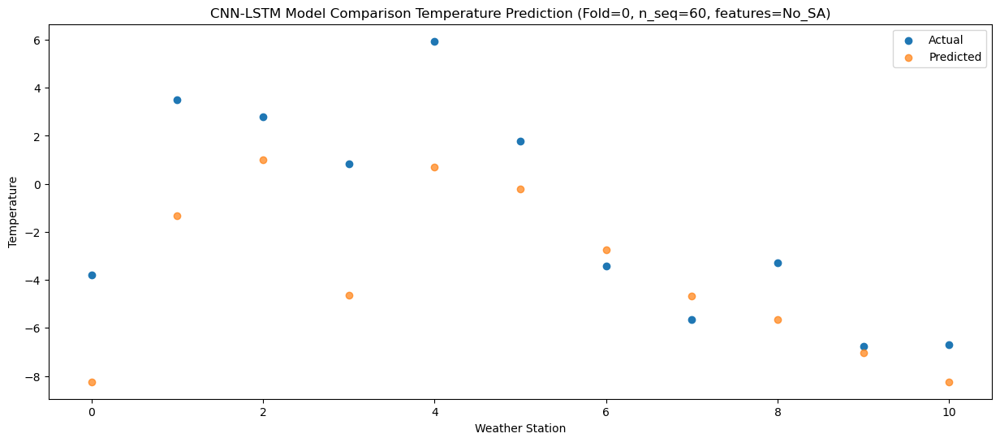

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.14  -6.435938
1                 1    4.29   0.484059
2                 2    4.74   2.794066
3                 3    2.28  -2.815936
4                 4    6.91   2.504075
5                 5    3.46   1.574072
6                 6   -0.24  -0.935930
7                 7   -2.47  -2.875933
8                 8   -0.73  -3.855933
9                 9   -4.86  -5.235953
10               10   -5.56  -6.435945


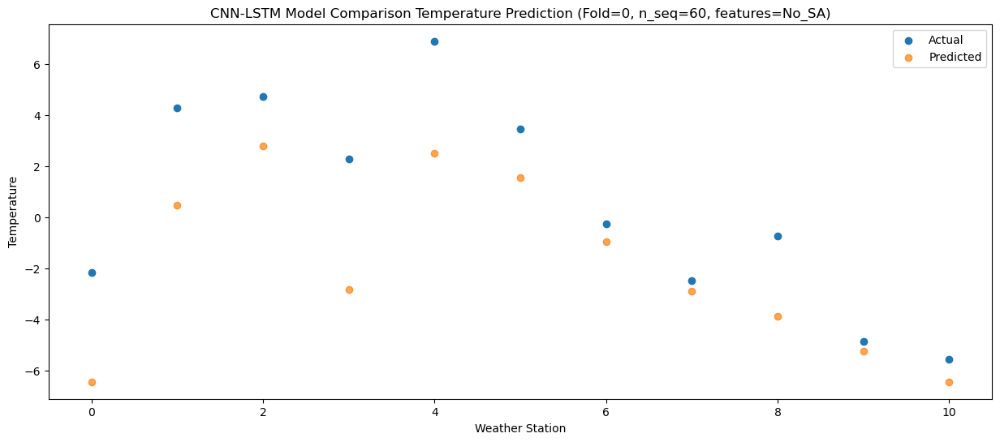

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.61  -5.834020
1                 1    5.39   1.085977
2                 2    7.52   3.395982
3                 3    2.69  -2.214020
4                 4    7.04   3.105993
5                 5    4.95   2.175987
6                 6    2.76  -0.334014
7                 7    0.50  -2.274017
8                 8    0.88  -3.254017
9                 9   -2.82  -4.634035
10               10   -5.15  -5.834027


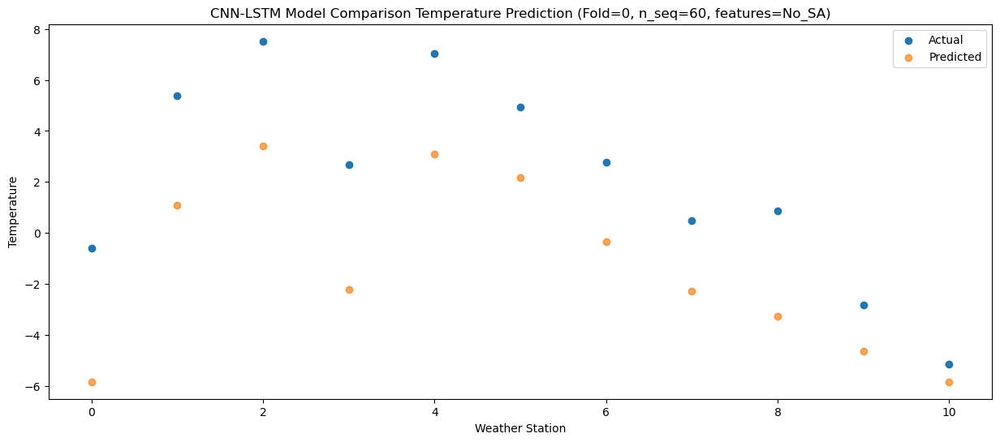

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.76  -4.484572
1                 1    6.98   2.435425
2                 2    7.50   4.745430
3                 3    6.21  -0.864572
4                 4   11.76   4.455439
5                 5    5.86   3.525435
6                 6    3.24   1.015433
7                 7    1.18  -0.924571
8                 8    2.70  -1.904571
9                 9   -2.48  -3.284585
10               10   -3.29  -4.484577


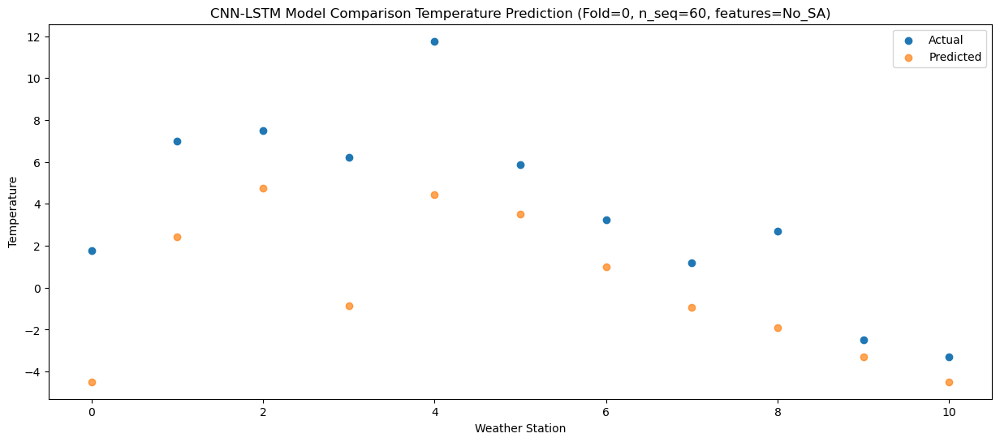

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.38   1.700449
1                 1    9.13   8.620446
2                 2   10.57  10.930453
3                 3    7.63   5.320449
4                 4   13.26  10.640460
5                 5   10.54   9.710456
6                 6    6.80   7.200456
7                 7    5.80   5.260452
8                 8    8.48   4.280451
9                 9    3.80   2.900436
10               10    3.56   1.700444


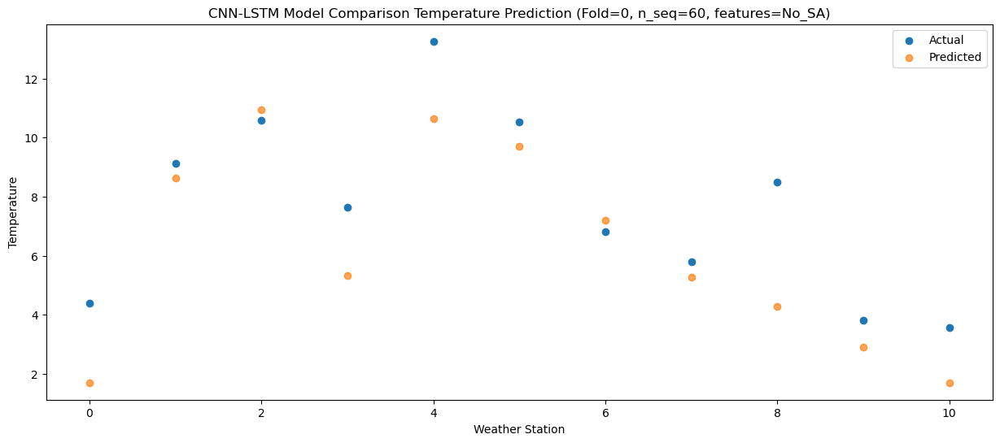

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    9.85   5.691540
1                 1   12.31  12.611538
2                 2   13.98  14.921545
3                 3   12.06   9.311541
4                 4   18.79  14.631552
5                 5   12.06  13.701548
6                 6    9.49  11.191548
7                 7    8.09   9.251545
8                 8   14.07   8.271547
9                 9    8.76   6.891530
10               10    8.58   5.691537


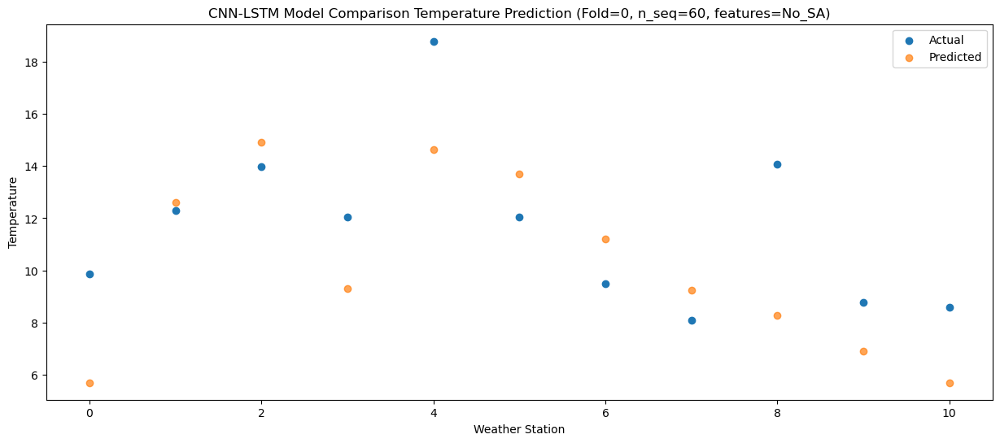

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   13.63   9.441556
1                 1   15.39  16.361553
2                 2   17.30  18.671563
3                 3   15.81  13.061555
4                 4   23.34  18.381569
5                 5   15.88  17.451564
6                 6   12.84  14.941564
7                 7   11.84  13.001561
8                 8   17.94  12.021563
9                 9   12.60  10.641544
10               10   14.09   9.441553


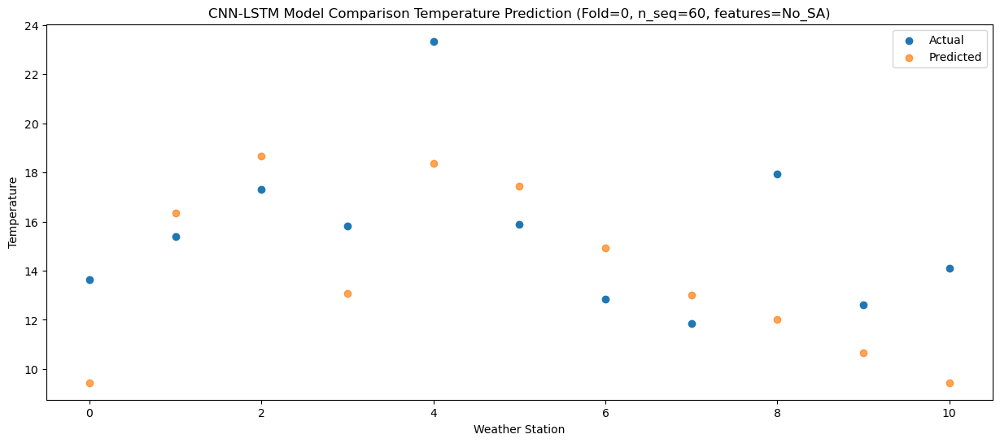

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.17  13.446821
1                 1   17.22  20.366820
2                 2   20.40  22.676829
3                 3   16.93  17.066821
4                 4   26.33  22.386834
5                 5   19.71  21.456831
6                 6   16.55  18.946831
7                 7   15.98  17.006828
8                 8   19.43  16.026830
9                 9   15.43  14.646809
10               10   16.55  13.446820


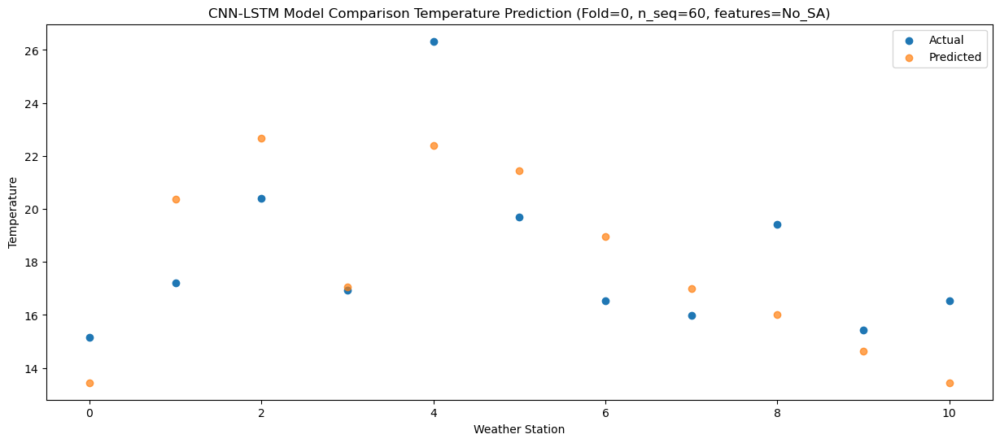

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.89  11.703843
1                 1   18.81  18.623842
2                 2   20.01  20.933853
3                 3   18.46  15.323844
4                 4   28.07  20.643857
5                 5   19.23  19.713853
6                 6   15.86  17.203853
7                 7   14.84  15.263850
8                 8   18.17  14.283851
9                 9   14.63  12.903832
10               10   14.74  11.703844


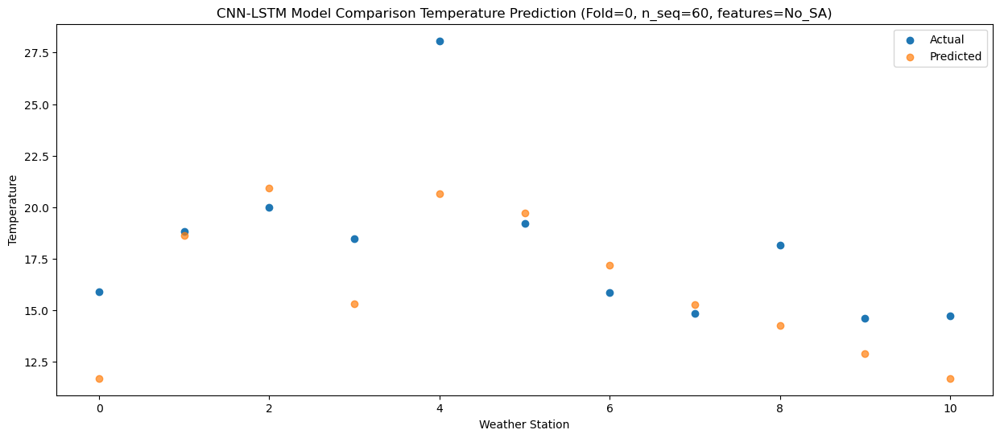

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.66   8.580647
1                 1   15.43  15.500646
2                 2   16.56  17.810657
3                 3   15.02  12.200648
4                 4   23.59  17.520663
5                 5   15.71  16.590657
6                 6   12.35  14.080657
7                 7   11.08  12.140656
8                 8   15.00  11.160656
9                 9   12.02   9.780638
10               10   12.36   8.580650


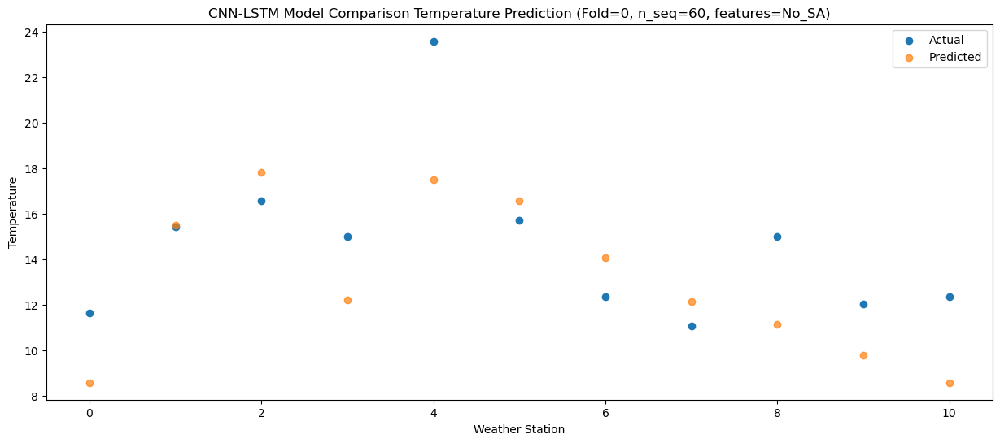

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.60   3.080296
1                 1   10.32  10.000293
2                 2   10.58  12.310307
3                 3    8.77   6.700297
4                 4   15.93  12.020310
5                 5   11.36  11.090306
6                 6    7.14   8.580306
7                 7    5.69   6.640304
8                 8    9.40   5.660304
9                 9    5.44   4.280288
10               10    6.40   3.080299


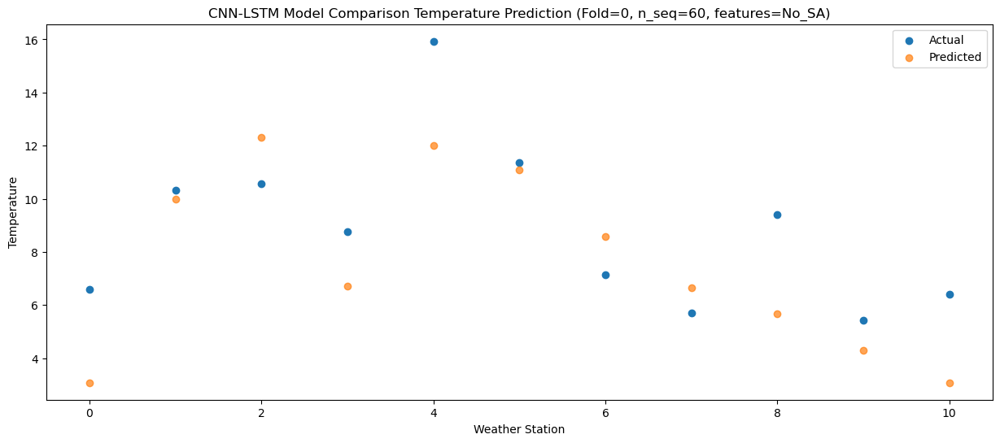

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -4.812726
1                 1    5.08   2.107271
2                 2    5.49   4.417285
3                 3    2.91  -1.192725
4                 4    9.57   4.127287
5                 5    5.92   3.197285
6                 6    1.27   0.687285
7                 7   -0.76  -1.252717
8                 8    2.41  -2.232717
9                 9   -1.06  -3.612733
10               10   -1.24  -4.812722


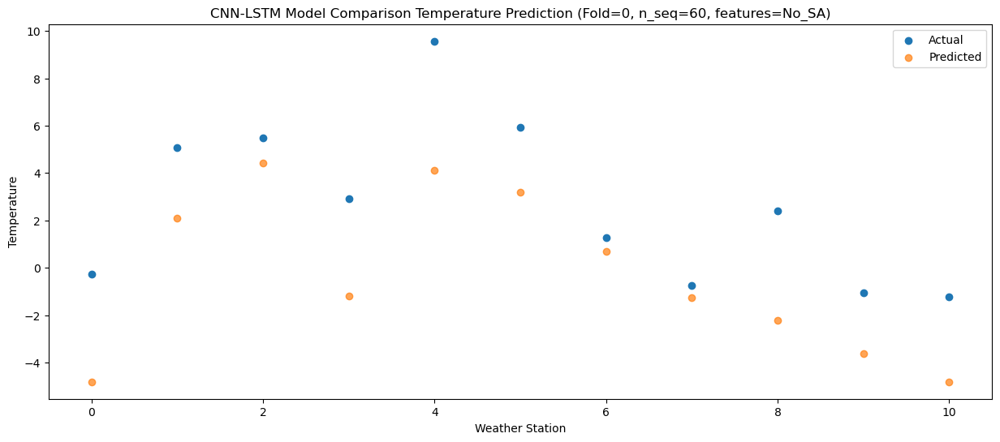

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -6.350173
1                 1    2.38   0.569823
2                 2    2.46   2.879838
3                 3    0.12  -2.730172
4                 4    6.78   2.589841
5                 5    3.78   1.659837
6                 6   -1.02  -0.850163
7                 7   -2.35  -2.790165
8                 8   -0.15  -3.770165
9                 9   -3.49  -5.150182
10               10   -1.92  -6.350170


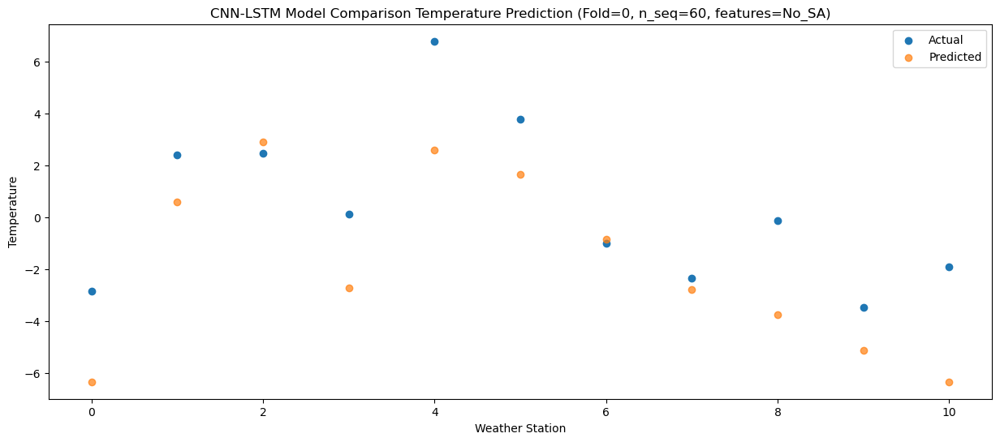

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -7.98 -10.739186
1                 1    0.11  -3.819191
2                 2   -0.05  -1.509176
3                 3   -2.76  -7.119186
4                 4    1.80  -1.799174
5                 5    2.51  -2.729178
6                 6   -3.15  -5.239177
7                 7   -5.05  -7.179180
8                 8   -6.41  -8.159179
9                 9   -9.25  -9.539195
10               10   -8.84 -10.739183


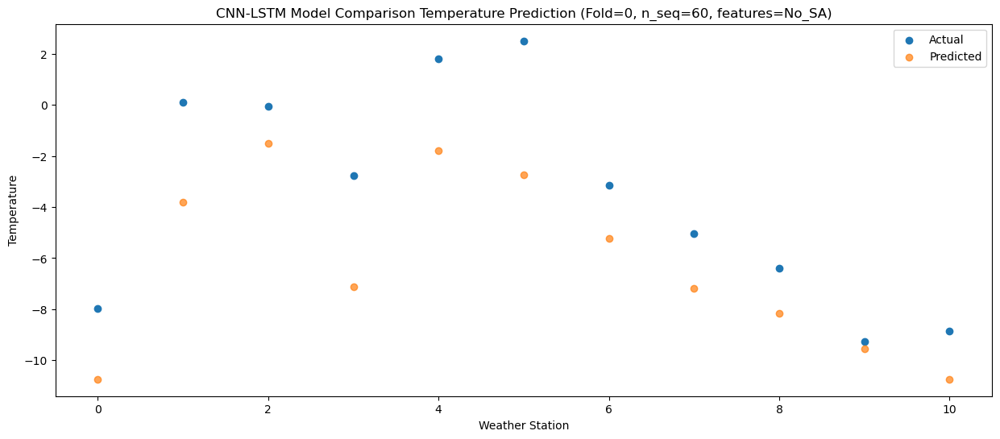

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.10  -7.356244
1                 1    2.61  -0.436249
2                 2    4.46   1.873766
3                 3    1.89  -3.736244
4                 4    9.67   1.583768
5                 5    3.03   0.653765
6                 6    0.41  -1.856235
7                 7   -1.91  -3.796236
8                 8    2.21  -4.776237
9                 9   -3.11  -6.156253
10               10   -3.83  -7.356239


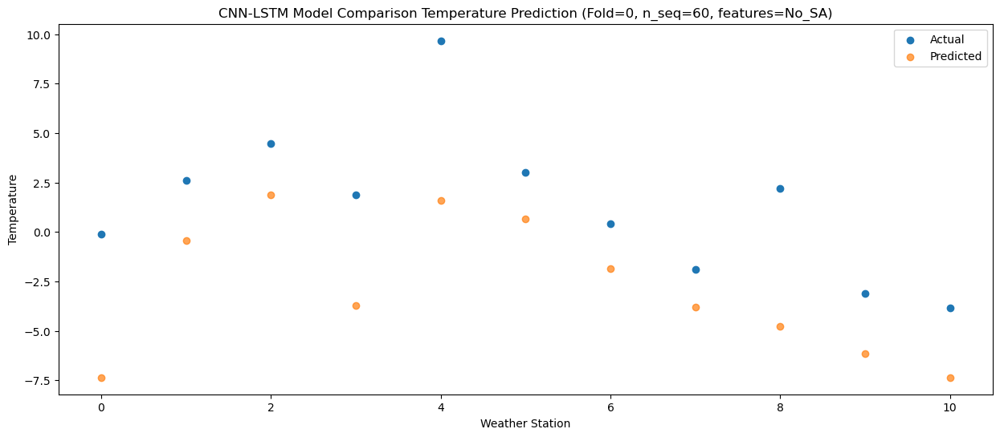

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.65  -3.441403
1                 1    5.91   3.478593
2                 2    8.84   5.788607
3                 3    4.83   0.178598
4                 4   12.22   5.498612
5                 5    7.08   4.568606
6                 6    4.25   2.058607
7                 7    2.24   0.118607
8                 8    5.49  -0.861396
9                 9    0.21  -2.241411
10               10   -0.33  -3.441398


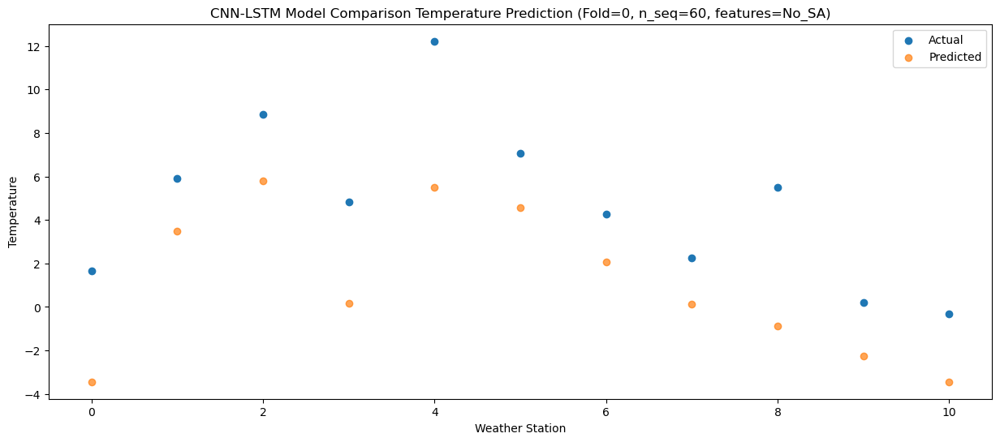

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.42   1.096613
1                 1    8.79   8.016612
2                 2   12.53  10.326623
3                 3    8.40   4.716617
4                 4   15.49  10.036633
5                 5   10.30   9.106622
6                 6    7.84   6.596623
7                 7    6.72   4.656623
8                 8   10.37   3.676620
9                 9    5.43   2.296605
10               10    5.01   1.096618


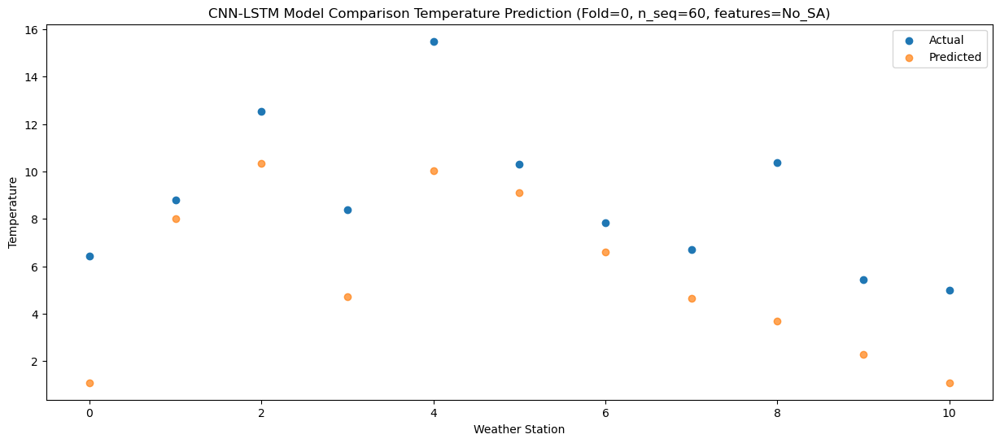

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.33   7.342986
1                 1   13.28  14.262983
2                 2   17.01  16.572994
3                 3   12.79  10.962988
4                 4   20.07  16.283003
5                 5   15.11  15.352992
6                 6   11.84  12.842993
7                 7   10.68  10.902995
8                 8   15.44   9.922988
9                 9   11.23   8.542977
10               10   11.98   7.342990


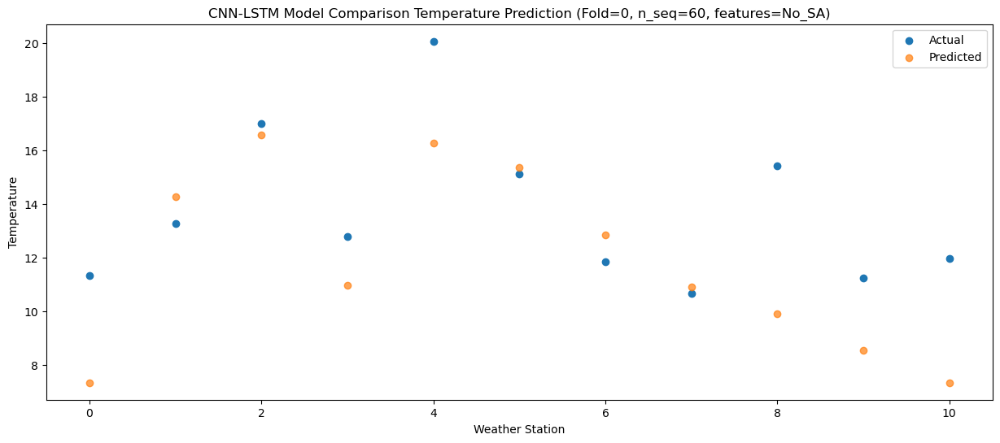

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.94  11.894613
1                 1   16.21  18.814610
2                 2   21.25  21.124619
3                 3   14.91  15.514613
4                 4   23.57  20.834627
5                 5   18.54  19.904617
6                 6   15.75  17.394618
7                 7   14.70  15.454622
8                 8   18.37  14.474616
9                 9   14.99  13.094604
10               10   16.30  11.894617


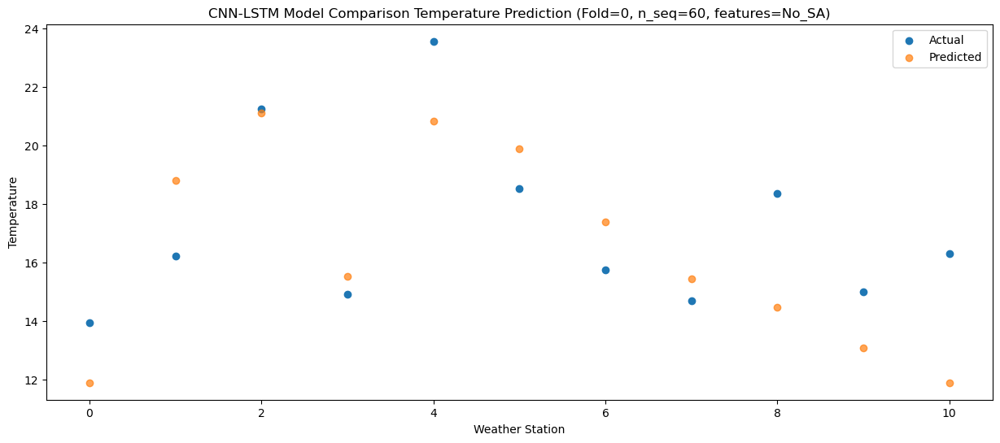

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.82  13.182091
1                 1   17.34  20.102088
2                 2   21.52  22.412099
3                 3   14.85  16.802089
4                 4   23.43  22.122107
5                 5   20.20  21.192095
6                 6   17.01  18.682098
7                 7   15.92  16.742102
8                 8   18.92  15.762095
9                 9   15.83  14.382084
10               10   17.19  13.182097


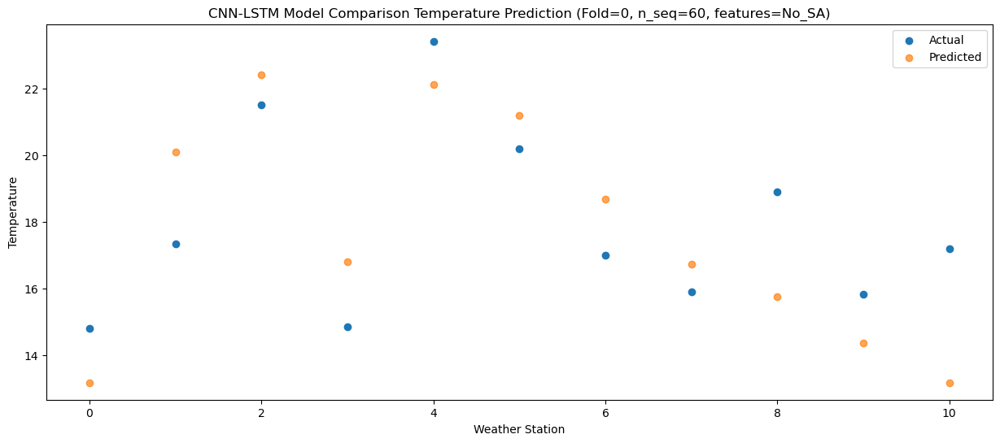

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   15.16  10.865030
1                 1   17.73  17.785028
2                 2   19.84  20.095038
3                 3   15.66  14.485029
4                 4   25.11  19.805048
5                 5   18.93  18.875035
6                 6   15.26  16.365037
7                 7   14.08  14.425042
8                 8   18.86  13.445034
9                 9   15.50  12.065024
10               10   16.44  10.865038


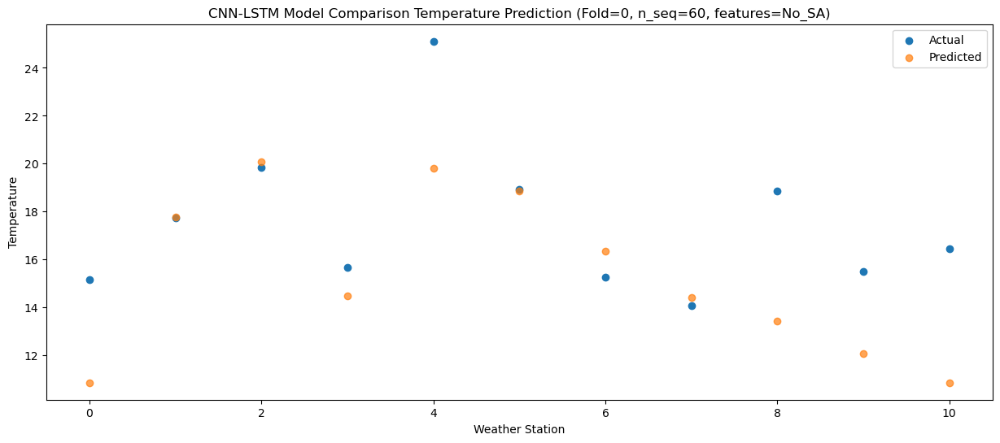

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.02   8.087557
1                 1   14.49  15.007555
2                 2   17.07  17.317565
3                 3   13.07  11.707557
4                 4   21.19  17.027575
5                 5   16.99  16.097562
6                 6   12.83  13.587565
7                 7   11.15  11.647570
8                 8   15.24  10.667562
9                 9   13.31   9.287550
10               10   13.66   8.087565


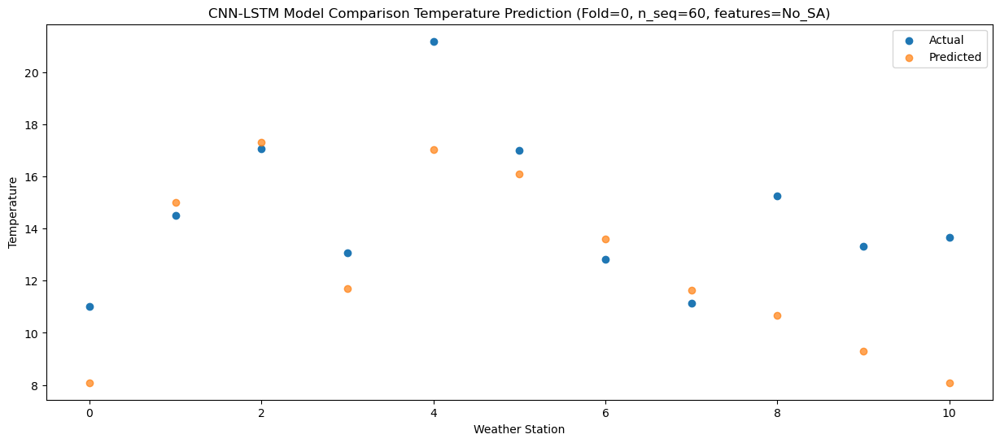

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    7.75   2.281628
1                 1   11.17   9.201626
2                 2   11.17  11.511637
3                 3    8.93   5.901630
4                 4   18.74  11.221645
5                 5   11.96  10.291633
6                 6    7.56   7.781636
7                 7    5.32   5.841642
8                 8    9.81   4.861633
9                 9    6.57   3.481622
10               10    7.43   2.281636


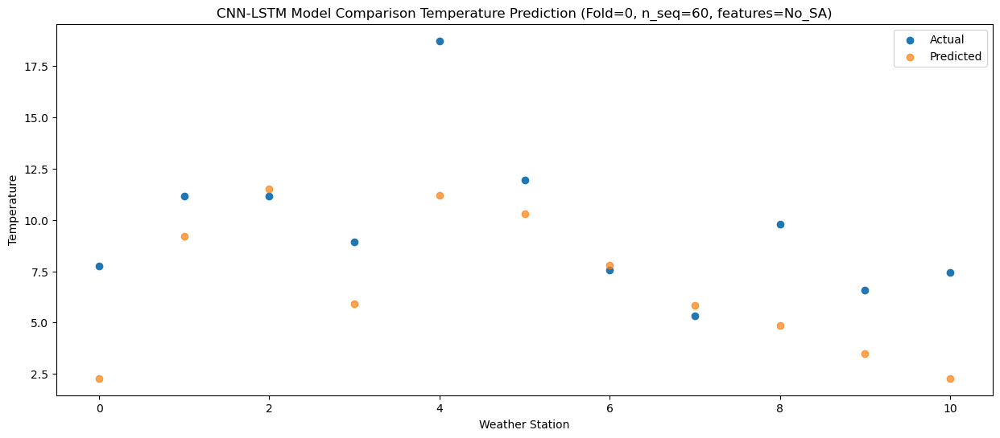

f, t:
[[-2.980e+00  3.390e+00  4.930e+00  1.130e+00  7.340e+00  4.630e+00
   6.800e-01 -1.370e+00 -9.500e-01 -4.560e+00 -5.060e+00]
 [-3.450e+00  2.490e+00  4.820e+00  1.110e+00  5.290e+00  4.060e+00
   3.200e-01 -1.740e+00 -1.110e+00 -4.380e+00 -5.730e+00]
 [-3.720e+00  2.110e+00  4.200e+00  1.150e+00  6.030e+00  3.530e+00
  -1.500e-01 -1.860e+00 -2.300e+00 -5.660e+00 -6.760e+00]
 [-3.370e+00  2.860e+00  4.820e+00  1.150e+00  5.360e+00  3.220e+00
   9.600e-01 -8.200e-01 -1.800e+00 -6.530e+00 -8.220e+00]
 [ 3.210e+00  8.690e+00  1.107e+01  8.070e+00  1.311e+01  6.810e+00
   6.380e+00  4.760e+00  4.770e+00  6.600e-01 -2.080e+00]
 [ 3.860e+00  9.180e+00  1.083e+01  8.150e+00  1.336e+01  8.780e+00
   7.620e+00  5.660e+00  7.050e+00  2.320e+00  5.700e-01]
 [ 8.590e+00  1.195e+01  1.452e+01  1.104e+01  1.834e+01  1.247e+01
   9.960e+00  8.780e+00  1.193e+01  7.410e+00  7.000e+00]
 [ 1.281e+01  1.570e+01  1.824e+01  1.395e+01  2.254e+01  1.682e+01
   1.521e+01  1.430e+01  1.786e+01  1.439e+0

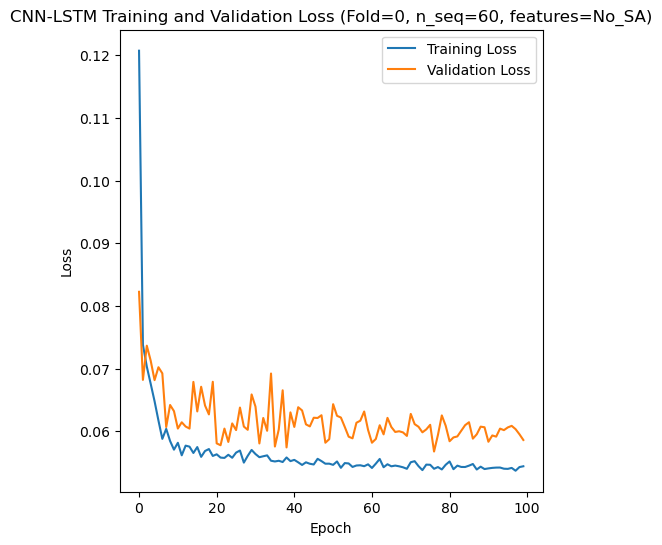

[[12.2  10.03 13.86 ... 24.46 19.58 17.03]
 [ 8.35  6.22 11.74 ... 22.47 18.02 13.98]
 [10.82  7.37 13.36 ... 24.57 19.57 16.15]
 ...
 [ 7.69  4.56 11.66 ... 25.3  19.83 13.28]
 [ 8.93  6.7  14.14 ... 25.37 21.51 12.55]
 [ 7.96  5.46 11.14 ... 25.13 20.28 10.63]]
Epoch 1/100
84/84 [==============================] - 34s 175ms/step - loss: 0.1218 - accuracy: 0.3095 - mae: 0.1003 - rmse: 0.1218 - mape: inf - pearson: 0.6472 - val_loss: 0.0722 - val_accuracy: 0.6000 - val_mae: 0.0582 - val_rmse: 0.0722 - val_mape: 13.3811 - val_pearson: 0.7912
Epoch 2/100
84/84 [==============================] - 8s 101ms/step - loss: 0.0747 - accuracy: 0.4405 - mae: 0.0598 - rmse: 0.0747 - mape: inf - pearson: 0.7950 - val_loss: 0.0651 - val_accuracy: 0.6000 - val_mae: 0.0521 - val_rmse: 0.0651 - val_mape: 11.6619 - val_pearson: 0.8251
Epoch 3/100
84/84 [==============================] - 5s 63ms/step - loss: 0.0785 - accuracy: 0.3690 - mae: 0.0633 - rmse: 0.0785 - mape: inf - pearson: 0.7896 - val_loss: 0.

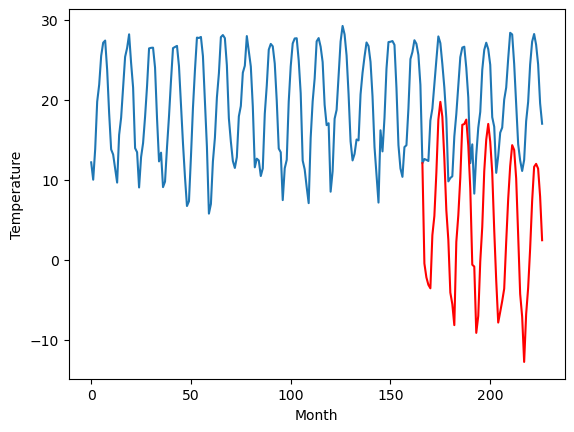

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.52		3.79		0.27
2.61		2.06		-0.55
1.50		1.13		-0.37
1.59		0.69		-0.90
7.59		7.34		-0.25
8.81		9.73		0.92
12.16		15.14		2.98
16.51		21.78		5.27
19.88		24.00		4.12
18.47		22.15		3.68
14.93		16.93		2.00
11.21		10.44		-0.77
7.11		6.75		-0.36
0.22		0.16		-0.06
0.02		-1.30		-1.32
0.68		-3.92		-4.60
7.45		6.49		-0.96
9.59		9.81		0.22
13.32		14.54		1.22
17.46		21.14		3.68
18.84		21.23		2.39
19.11		21.78		2.67
15.37		18.54		3.17
11.59		13.17		1.58
3.93		3.64		-0.29
5.56		3.41		-2.15
-1.17		-4.88		-3.71
3.06		-2.76		-5.82
6.63		4.05		-2.58
9.63		8.37		-1.26
15.51		15.34		-0.17
19.48		19.29		-0.19
19.98		21.25		1.27
18.52		19.03		0.51
15.43		15.16		-0.27
9.09		7.96		-1.13
6.09		1.67		-4.42
0.28		-3.59		-3.87
2.47		-2.26		-4.73
5.84		-0.91		-6.75
6.61		0.64		-5.97
9.88		6.48		-3.40
13.16		11.86		-1.30
16.35		15.96		-0.39
19.95		18.59		-1.36
19.41		17.99		-1.42
15.90		14.43		-1.47
10.89		7.33		-3.56
5.27

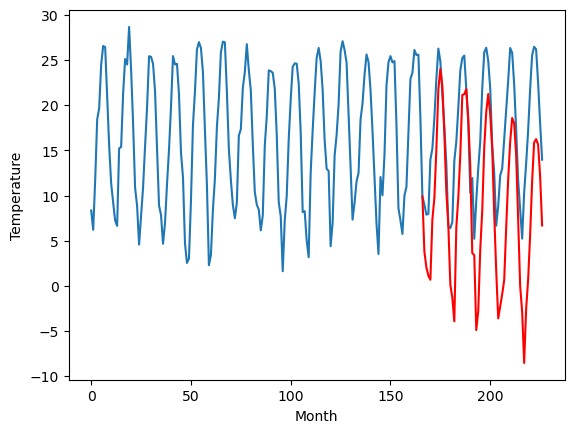

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.48		-0.06		1.42
-1.05		-1.79		-0.74
-1.58		-2.72		-1.14
-1.30		-3.16		-1.86
5.80		3.49		-2.31
4.83		5.88		1.05
8.98		11.29		2.31
13.21		17.93		4.72
14.68		20.15		5.47
14.67		18.30		3.63
11.87		13.08		1.21
7.52		6.59		-0.93
2.72		2.90		0.18
-4.34		-3.69		0.65
-3.92		-5.15		-1.23
-3.43		-7.77		-4.34
3.63		2.64		-0.99
5.03		5.96		0.93
9.15		10.69		1.54
13.03		17.29		4.26
13.80		17.38		3.58
14.46		17.93		3.47
11.44		14.69		3.25
7.66		9.32		1.66
-0.08		-0.21		-0.13
2.52		-0.44		-2.96
-4.37		-8.73		-4.36
-1.02		-6.61		-5.59
2.98		0.20		-2.78
6.57		4.52		-2.05
11.93		11.49		-0.44
14.90		15.44		0.54
15.61		17.40		1.79
14.00		15.18		1.18
11.61		11.31		-0.30
4.92		4.11		-0.81
1.60		-2.18		-3.78
-1.56		-7.44		-5.88
-0.56		-6.11		-5.55
2.03		-4.76		-6.79
3.46		-3.21		-6.67
6.15		2.63		-3.52
9.39		8.01		-1.38
13.14		12.11		-1.03
15.51		14.74		-0.77
15.95		14.14		-1.81
12.99		10.58		-2.41
6.95		3.48		-3

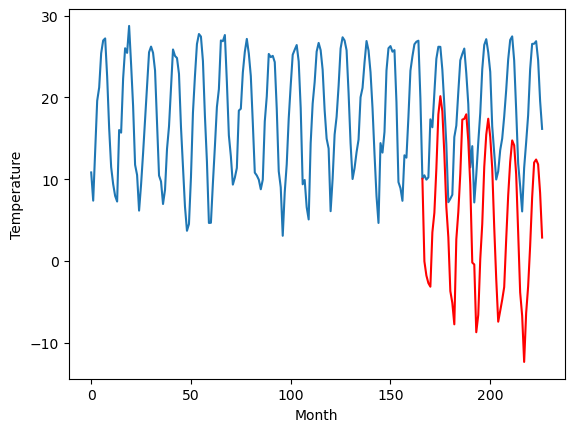

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		2.41		-1.64
2.63		0.68		-1.95
3.38		-0.25		-3.63
2.85		-0.69		-3.54
10.49		5.96		-4.53
10.37		8.35		-2.02
14.12		13.76		-0.36
16.90		20.40		3.50
18.55		22.62		4.07
18.79		20.77		1.98
15.38		15.55		0.17
10.84		9.06		-1.78
7.94		5.37		-2.57
1.76		-1.22		-2.98
1.66		-2.68		-4.34
0.07		-5.30		-5.37
7.44		5.11		-2.33
9.78		8.43		-1.35
13.67		13.16		-0.51
17.56		19.76		2.20
17.44		19.85		2.41
18.41		20.40		1.99
15.40		17.16		1.76
12.71		11.79		-0.92
5.55		2.26		-3.29
8.92		2.03		-6.89
0.87		-6.26		-7.13
0.40		-4.14		-4.54
6.24		2.67		-3.57
12.24		6.99		-5.25
16.67		13.96		-2.71
19.67		17.91		-1.76
20.61		19.87		-0.74
18.97		17.65		-1.32
16.20		13.78		-2.42
10.64		6.58		-4.06
5.59		0.29		-5.30
3.50		-4.97		-8.47
4.21		-3.64		-7.85
5.21		-2.29		-7.50
9.04		-0.74		-9.78
9.88		5.10		-4.78
14.47		10.48		-3.99
18.62		14.58		-4.04
20.34		17.21		-3.13
22.31		16.61		-5.70
19.23		13.05		-6.18
11.97		5.

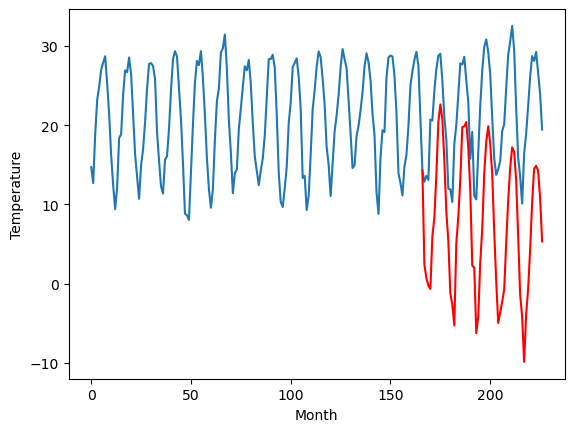

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.11		6.30		-1.81
6.22		4.57		-1.65
7.03		3.64		-3.39
6.65		3.20		-3.45
14.69		9.85		-4.84
14.43		12.24		-2.19
18.23		17.65		-0.58
21.26		24.29		3.03
23.30		26.51		3.21
23.54		24.66		1.12
19.96		19.44		-0.52
15.02		12.95		-2.07
11.92		9.26		-2.66
5.56		2.67		-2.89
5.55		1.21		-4.34
3.85		-1.41		-5.26
11.46		9.00		-2.46
13.76		12.32		-1.44
17.88		17.05		-0.83
21.35		23.65		2.30
21.44		23.74		2.30
22.41		24.29		1.88
18.83		21.05		2.22
15.79		15.68		-0.11
8.24		6.15		-2.09
12.12		5.92		-6.20
3.64		-2.37		-6.01
3.33		-0.25		-3.58
9.11		6.56		-2.55
15.38		10.88		-4.50
20.00		17.85		-2.15
23.37		21.80		-1.57
24.46		23.76		-0.70
22.45		21.54		-0.91
19.27		17.67		-1.60
13.88		10.47		-3.41
8.88		4.18		-4.70
6.86		-1.08		-7.94
7.34		0.25		-7.09
8.52		1.60		-6.92
12.34		3.15		-9.19
13.30		8.99		-4.31
17.94		14.37		-3.57
22.83		18.47		-4.36
24.78		21.10		-3.68
26.21		20.50		-5.71
22.36		16.94		-5.42
14.9

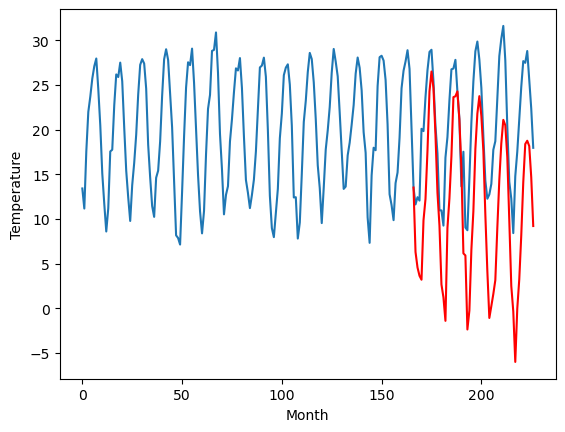

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.80		5.01		-2.79
5.77		3.28		-2.49
5.11		2.35		-2.76
4.59		1.91		-2.68
11.94		8.56		-3.38
14.73		10.95		-3.78
19.92		16.36		-3.56
22.64		23.00		0.36
25.34		25.22		-0.12
25.19		23.37		-1.82
17.66		18.15		0.49
14.82		11.66		-3.16
11.10		7.97		-3.13
4.35		1.38		-2.97
2.84		-0.08		-2.92
3.22		-2.70		-5.92
10.56		7.71		-2.85
12.83		11.03		-1.80
18.42		15.76		-2.66
22.69		22.36		-0.33
22.03		22.45		0.42
21.44		23.00		1.56
21.08		19.76		-1.32
16.76		14.39		-2.37
10.29		4.86		-5.43
10.55		4.63		-5.92
3.23		-3.66		-6.89
3.12		-1.54		-4.66
10.07		5.27		-4.80
16.98		9.59		-7.39
22.38		16.56		-5.82
24.44		20.51		-3.93
25.36		22.47		-2.89
22.51		20.25		-2.26
19.46		16.38		-3.08
13.38		9.18		-4.20
6.42		2.89		-3.53
5.30		-2.37		-7.67
5.76		-1.04		-6.80
5.90		0.31		-5.59
10.96		1.86		-9.10
14.12		7.70		-6.42
18.73		13.08		-5.65
25.42		17.18		-8.24
26.52		19.81		-6.71
25.71		19.21		-6.50
23.43		15.65		-7.78

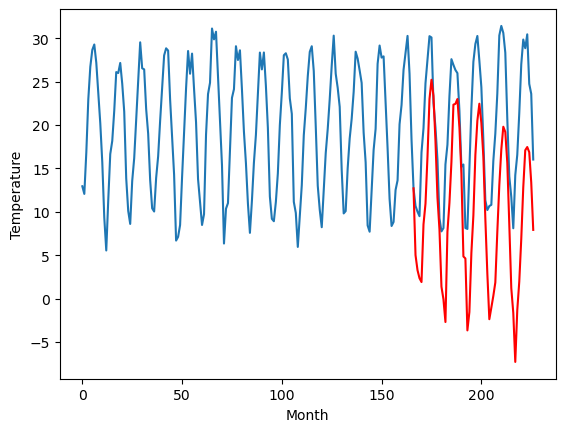

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.88		4.54		0.66
3.15		2.81		-0.34
2.34		1.88		-0.46
2.41		1.44		-0.97
8.08		8.09		0.01
9.71		10.48		0.77
12.49		15.89		3.40
17.16		22.53		5.37
20.34		24.75		4.41
18.71		22.90		4.19
15.29		17.68		2.39
11.80		11.19		-0.61
7.65		7.50		-0.15
0.44		0.91		0.47
0.24		-0.55		-0.79
1.02		-3.17		-4.19
7.30		7.24		-0.06
9.87		10.56		0.69
13.64		15.29		1.65
17.65		21.89		4.24
19.01		21.98		2.97
19.27		22.53		3.26
15.94		19.29		3.35
11.99		13.92		1.93
4.39		4.39		0.00
5.91		4.16		-1.75
-0.48		-4.13		-3.65
3.33		-2.01		-5.34
7.17		4.80		-2.37
9.93		9.12		-0.81
15.85		16.09		0.24
19.43		20.04		0.61
20.17		22.00		1.83
18.67		19.78		1.11
15.78		15.91		0.13
9.44		8.71		-0.73
6.55		2.42		-4.13
0.54		-2.84		-3.38
2.67		-1.51		-4.18
6.26		-0.16		-6.42
6.93		1.39		-5.54
10.19		7.23		-2.96
13.19		12.61		-0.58
16.47		16.71		0.24
19.92		19.34		-0.58
19.50		18.74		-0.76
16.33		15.18		-1.15
11.32		8.08		-3.24
5.63		0.

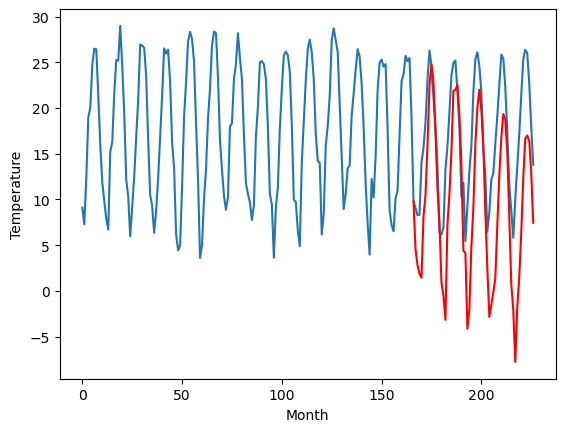

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.92		0.71		-0.21
0.30		-1.02		-1.32
-0.55		-1.95		-1.40
0.13		-2.39		-2.52
7.05		4.26		-2.79
8.19		6.65		-1.54
12.69		12.06		-0.63
18.25		18.70		0.45
20.79		20.92		0.13
18.77		19.07		0.30
15.47		13.85		-1.62
8.70		7.36		-1.34
5.03		3.67		-1.36
-1.57		-2.92		-1.35
-1.88		-4.38		-2.50
-4.88		-7.00		-2.12
6.44		3.41		-3.03
8.15		6.73		-1.42
12.81		11.45		-1.36
18.89		18.06		-0.83
19.88		18.15		-1.73
21.10		18.70		-2.40
17.39		15.46		-1.93
12.19		10.09		-2.10
2.89		0.56		-2.33
5.30		0.33		-4.97
-3.53		-7.96		-4.43
-1.48		-5.84		-4.36
4.47		0.97		-3.50
9.66		5.29		-4.37
15.13		12.26		-2.87
19.19		16.21		-2.98
23.32		18.17		-5.15
20.45		15.95		-4.50
16.61		12.08		-4.53
9.94		4.88		-5.06
3.34		-1.42		-4.76
-0.40		-6.67		-6.27
0.79		-5.34		-6.13
2.29		-3.99		-6.28
5.12		-2.44		-7.56
9.52		3.40		-6.12
14.87		8.78		-6.09
18.68		12.88		-5.80
20.98		15.51		-5.47
21.48		14.91		-6.57
17.86		11.35		-6.51
1

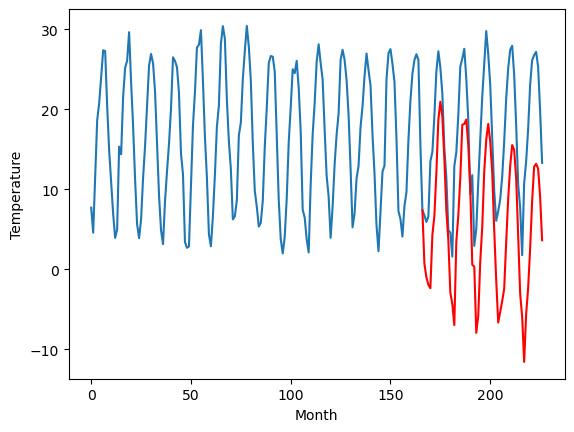

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.44		-0.72		-1.16
-1.41		-2.45		-1.04
-1.23		-3.38		-2.15
-1.74		-3.82		-2.08
6.09		2.83		-3.26
7.47		5.22		-2.25
13.58		10.63		-2.95
18.69		17.27		-1.42
21.23		19.49		-1.74
20.30		17.64		-2.66
13.65		12.42		-1.23
7.47		5.93		-1.54
4.59		2.24		-2.35
-2.09		-4.35		-2.26
-2.44		-5.81		-3.37
-7.22		-8.43		-1.21
5.34		1.98		-3.36
7.14		5.30		-1.84
11.95		10.02		-1.93
17.98		16.63		-1.35
19.49		16.72		-2.77
19.88		17.27		-2.61
17.37		14.03		-3.34
11.12		8.66		-2.46
3.37		-0.87		-4.24
2.56		-1.10		-3.66
-5.06		-9.39		-4.33
-4.08		-7.27		-3.19
3.17		-0.46		-3.63
10.28		3.86		-6.42
15.64		10.83		-4.81
19.93		14.78		-5.15
24.08		16.74		-7.34
21.41		14.52		-6.89
17.58		10.65		-6.93
9.35		3.45		-5.90
1.50		-2.85		-4.35
-2.13		-8.10		-5.97
-1.27		-6.77		-5.50
-0.90		-5.42		-4.52
3.53		-3.87		-7.40
7.86		1.97		-5.89
13.55		7.35		-6.20
18.48		11.45		-7.03
21.36		14.08		-7.28
23.17		13.48		-9.69
18.53		9.9

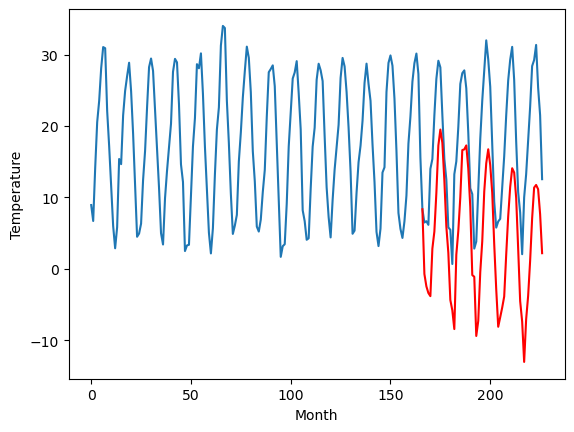

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.68		0.52		-4.16
3.32		-1.21		-4.53
2.87		-2.14		-5.01
1.63		-2.58		-4.21
9.59		4.07		-5.52
11.90		6.46		-5.44
18.43		11.87		-6.56
24.81		18.51		-6.30
26.39		20.73		-5.66
25.16		18.88		-6.28
18.41		13.66		-4.75
11.81		7.17		-4.64
8.63		3.48		-5.15
1.36		-3.11		-4.47
1.47		-4.57		-6.04
-2.90		-7.19		-4.29
7.81		3.22		-4.59
11.57		6.54		-5.03
16.12		11.26		-4.86
23.23		17.87		-5.36
23.90		17.96		-5.94
23.75		18.51		-5.24
21.80		15.27		-6.53
14.36		9.90		-4.46
8.11		0.37		-7.74
6.50		0.14		-6.36
-0.42		-8.15		-7.73
-0.36		-6.03		-5.67
6.57		0.78		-5.79
13.05		5.10		-7.95
18.50		12.07		-6.43
23.07		16.02		-7.05
26.67		17.98		-8.69
23.84		15.76		-8.08
21.43		11.89		-9.54
12.89		4.69		-8.20
3.90		-1.61		-5.51
1.55		-6.86		-8.41
1.83		-5.53		-7.36
2.98		-4.18		-7.16
6.71		-2.63		-9.34
12.06		3.21		-8.85
17.17		8.59		-8.58
20.40		12.69		-7.71
25.02		15.32		-9.70
25.42		14.72		-10.70
21.90		11.16		-

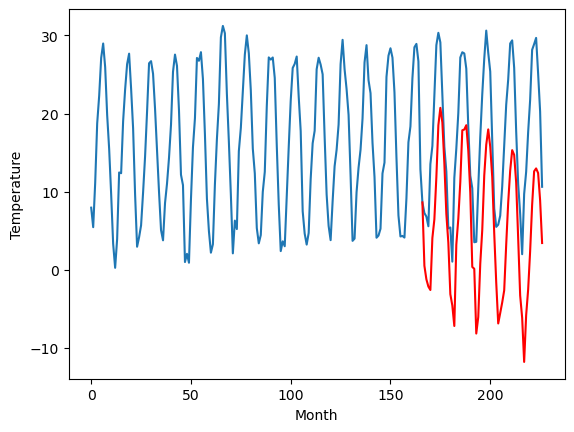

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.56		-0.45		1.11
-4.37		-2.18		2.19
-4.03		-3.11		0.92
-3.29		-3.55		-0.26
1.03		3.10		2.07
2.66		5.49		2.83
8.12		10.90		2.78
15.44		17.54		2.10
19.31		19.76		0.45
17.12		17.91		0.79
12.59		12.69		0.10
7.05		6.20		-0.85
2.85		2.51		-0.34
-4.16		-4.08		0.08
-6.00		-5.54		0.46
-6.96		-8.16		-1.20
0.26		2.25		1.99
4.91		5.57		0.66
9.45		10.29		0.84
15.54		16.90		1.36
17.77		16.99		-0.78
17.55		17.54		-0.01
13.85		14.30		0.45
9.43		8.93		-0.50
0.11		-0.60		-0.71
-0.66		-0.83		-0.17
-7.68		-9.12		-1.44
-3.78		-7.00		-3.22
0.78		-0.19		-0.97
4.13		4.13		-0.00
11.11		11.10		-0.01
15.50		15.05		-0.45
19.44		17.01		-2.43
18.90		14.79		-4.11
13.99		10.92		-3.07
5.89		3.72		-2.17
2.38		-2.58		-4.96
-4.77		-7.83		-3.06
-1.81		-6.50		-4.69
-2.13		-5.15		-3.02
-1.01		-3.60		-2.59
6.21		2.24		-3.97
8.77		7.62		-1.15
13.14		11.72		-1.42
18.28		14.35		-3.93
16.54		13.75		-2.79
13.35		10.19		-3.16
8.00		3.

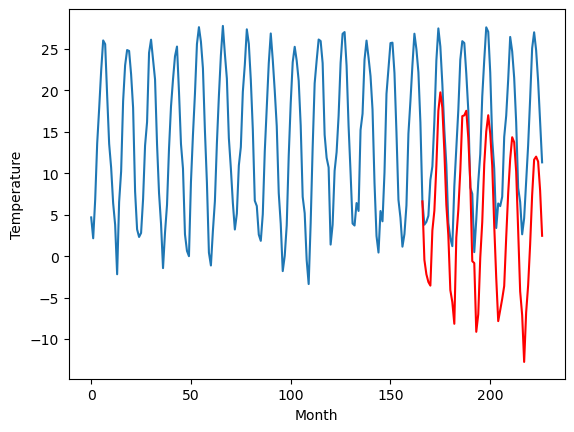

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.84  -0.447102
1                 1    3.52   3.792897
2                 2   -1.48  -0.057103
3                 3    4.05   2.412896
4                 4    8.11   6.302897
5                 5    7.80   5.012896
6                 6    3.88   4.542896
7                 7    0.92   0.712896
8                 8    0.44  -0.717104
9                 9    4.68   0.522896
10               10   -1.56  -0.447103


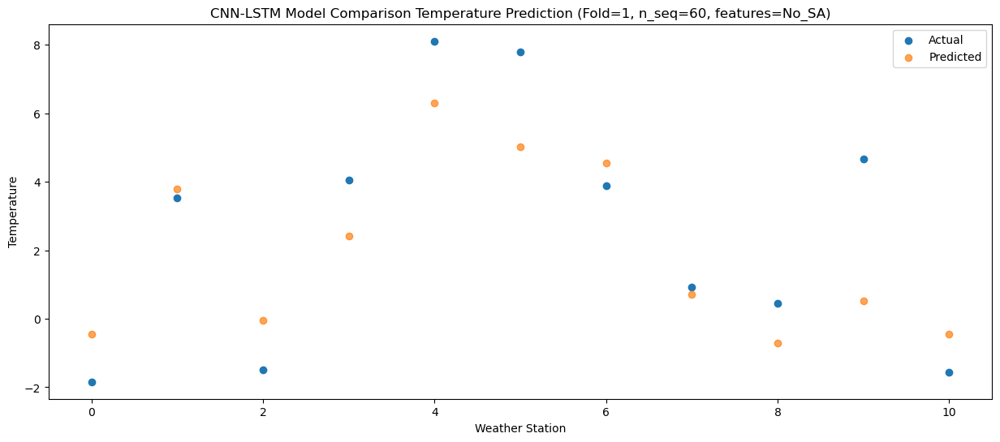

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.31  -2.182218
1                 1    2.61   2.057777
2                 2   -1.05  -1.792221
3                 3    2.63   0.677778
4                 4    6.22   4.567778
5                 5    5.77   3.277774
6                 6    3.15   2.807776
7                 7    0.30  -1.022233
8                 8   -1.41  -2.452235
9                 9    3.32  -1.212231
10               10   -4.37  -2.182231


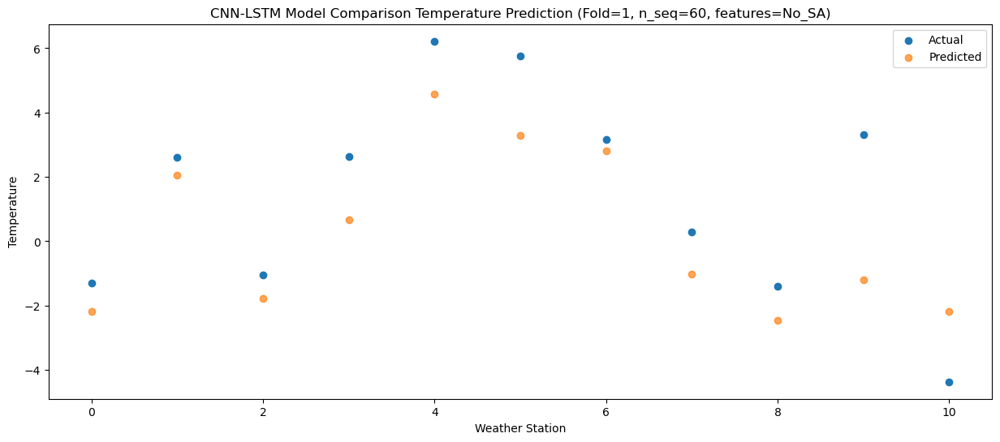

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -3.111215
1                 1    1.50   1.128770
2                 2   -1.58  -2.721224
3                 3    3.38  -0.251225
4                 4    7.03   3.638771
5                 5    5.11   2.348769
6                 6    2.34   1.878771
7                 7   -0.55  -1.951261
8                 8   -1.23  -3.381269
9                 9    2.87  -2.141259
10               10   -4.03  -3.111256


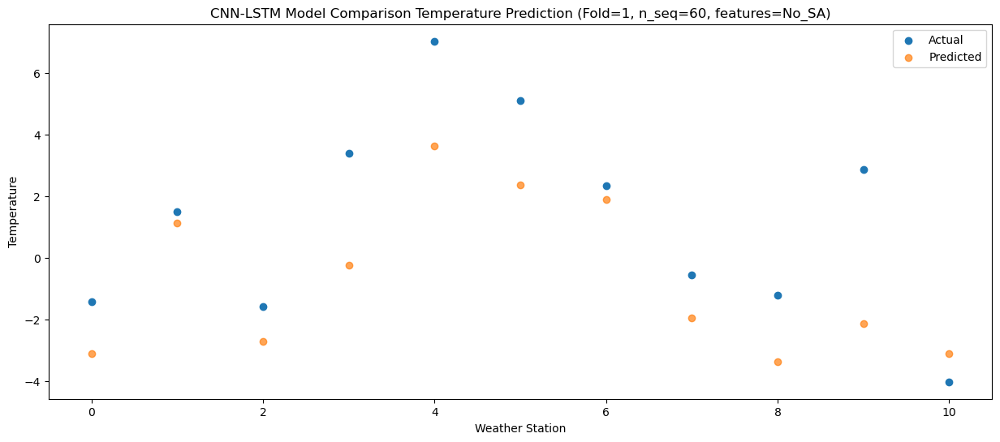

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.56  -3.549901
1                 1    1.59   0.690075
2                 2   -1.30  -3.159914
3                 3    2.85  -0.689921
4                 4    6.65   3.200073
5                 5    4.59   1.910067
6                 6    2.41   1.440076
7                 7    0.13  -2.389981
8                 8   -1.74  -3.819995
9                 9    1.63  -2.579976
10               10   -3.29  -3.549970


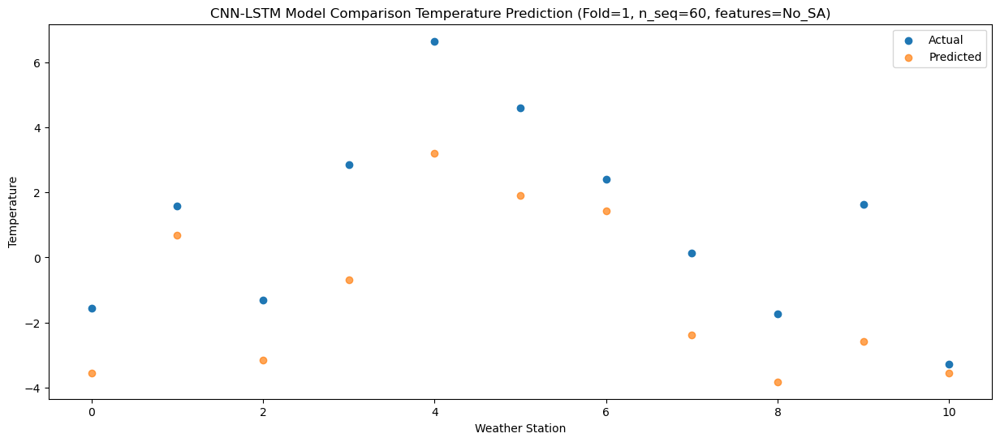

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.50   3.101597
1                 1    7.59   7.341570
2                 2    5.80   3.491580
3                 3   10.49   5.961573
4                 4   14.69   9.851571
5                 5   11.94   8.561566
6                 6    8.08   8.091571
7                 7    7.05   4.261506
8                 8    6.09   2.831488
9                 9    9.59   4.071515
10               10    1.03   3.101517


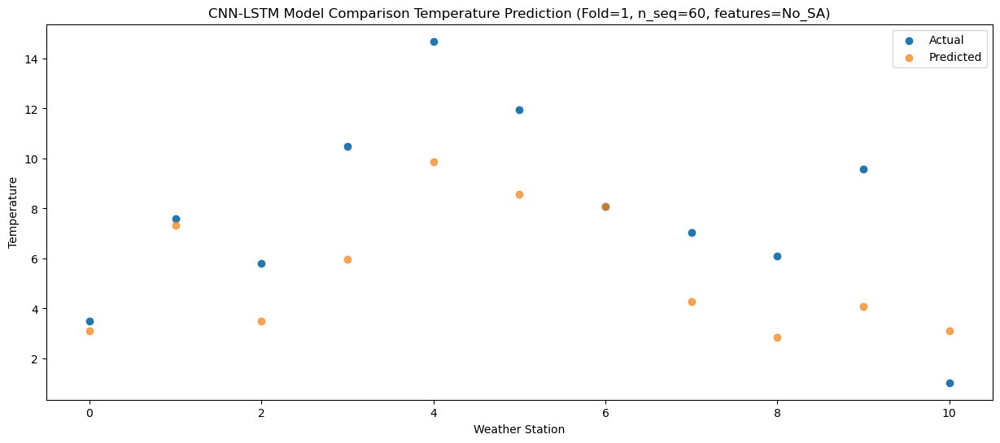

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.99   5.489939
1                 1    8.81   9.729908
2                 2    4.83   5.879919
3                 3   10.37   8.349908
4                 4   14.43  12.239906
5                 5   14.73  10.949898
6                 6    9.71  10.479909
7                 7    8.19   6.649825
8                 8    7.47   5.219802
9                 9   11.90   6.459830
10               10    2.66   5.489838


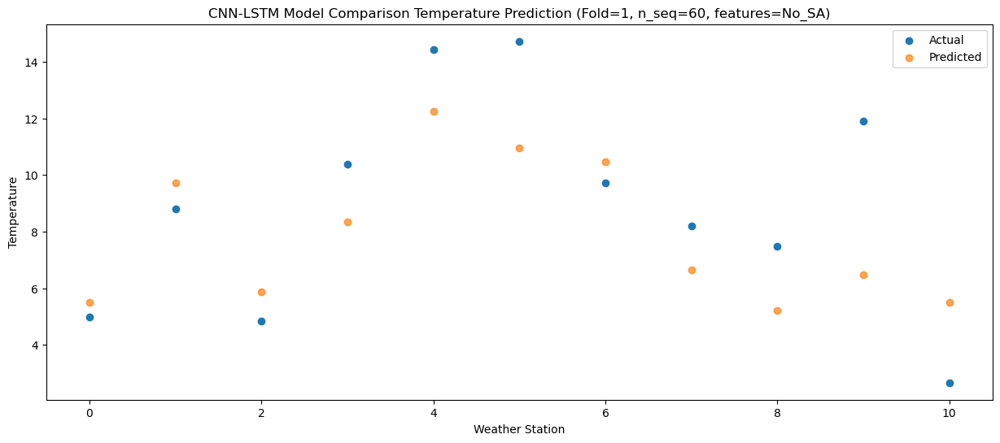

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.07  10.900913
1                 1   12.16  15.140884
2                 2    8.98  11.290895
3                 3   14.12  13.760886
4                 4   18.23  17.650884
5                 5   19.92  16.360878
6                 6   12.49  15.890885
7                 7   12.69  12.060809
8                 8   13.58  10.630790
9                 9   18.43  11.870814
10               10    8.12  10.900817


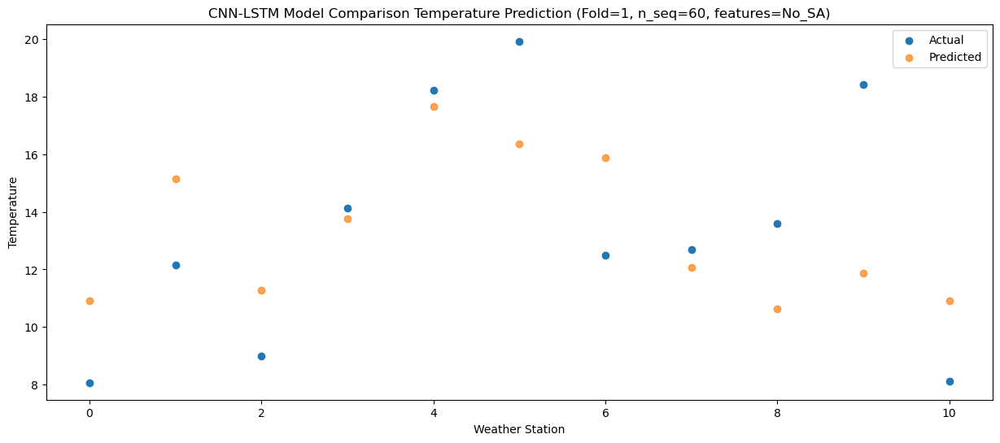

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   11.07  17.537301
1                 1   16.51  21.777268
2                 2   13.21  17.927280
3                 3   16.90  20.397270
4                 4   21.26  24.287269
5                 5   22.64  22.997262
6                 6   17.16  22.527271
7                 7   18.25  18.697175
8                 8   18.69  17.267155
9                 9   24.81  18.507182
10               10   15.44  17.537186


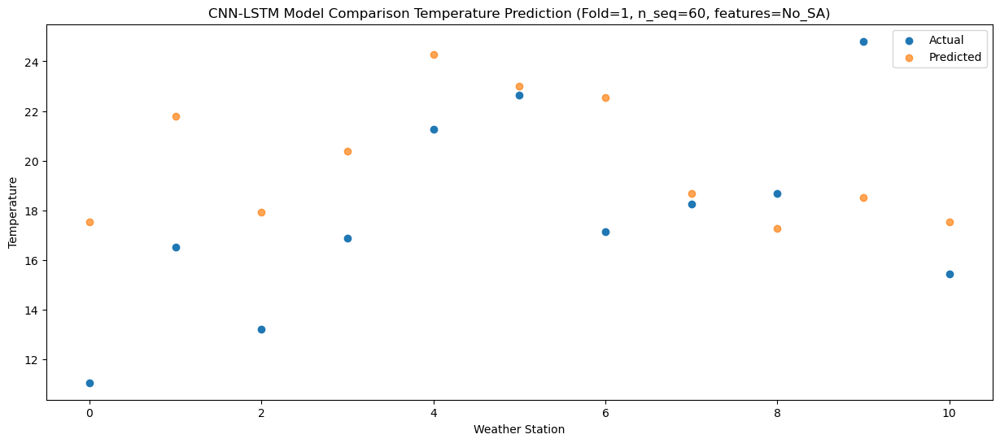

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.02  19.764495
1                 1   19.88  24.004456
2                 2   14.68  20.154475
3                 3   18.55  22.624458
4                 4   23.30  26.514456
5                 5   25.34  25.224440
6                 6   20.34  24.754459
7                 7   20.79  20.924322
8                 8   21.23  19.494296
9                 9   26.39  20.734333
10               10   19.31  19.764341


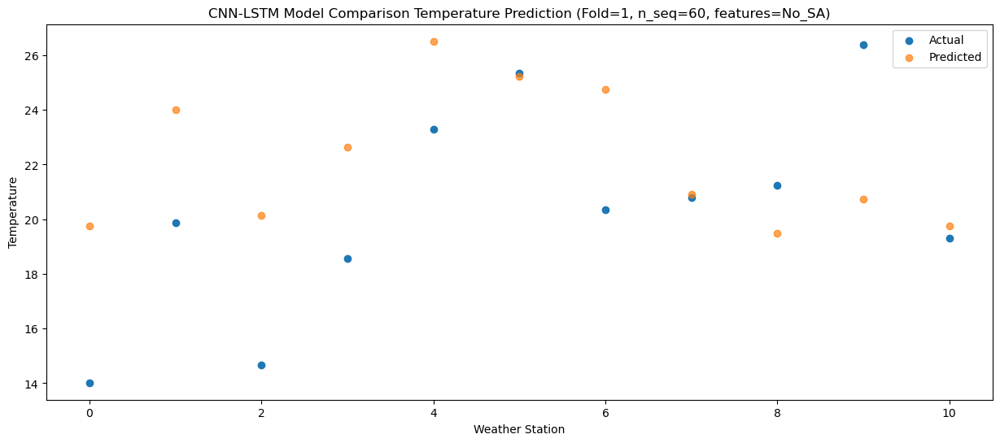

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.18  17.909245
1                 1   18.47  22.149206
2                 2   14.67  18.299226
3                 3   18.79  20.769208
4                 4   23.54  24.659208
5                 5   25.19  23.369186
6                 6   18.71  22.899209
7                 7   18.77  19.069065
8                 8   20.30  17.639034
9                 9   25.16  18.879077
10               10   17.12  17.909083


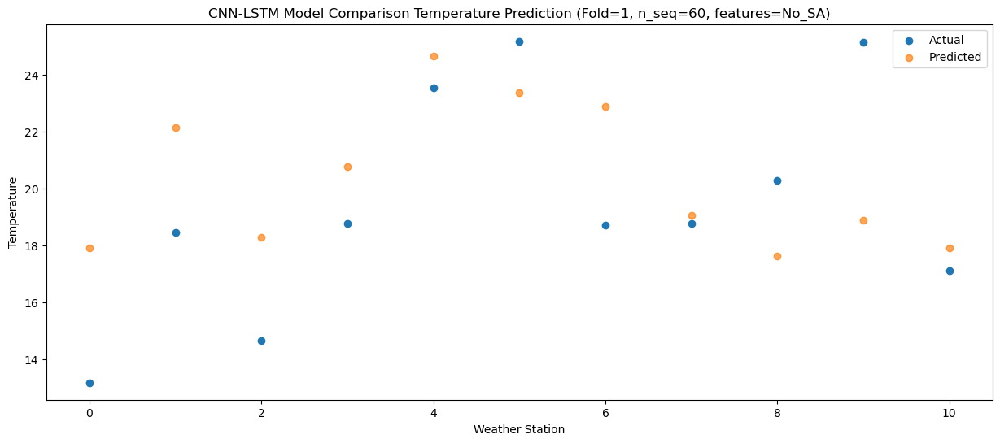

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.56  12.686559
1                 1   14.93  16.926517
2                 2   11.87  13.076540
3                 3   15.38  15.546518
4                 4   19.96  19.436518
5                 5   17.66  18.146493
6                 6   15.29  17.676519
7                 7   15.47  13.846357
8                 8   13.65  12.416324
9                 9   18.41  13.656371
10               10   12.59  12.686376


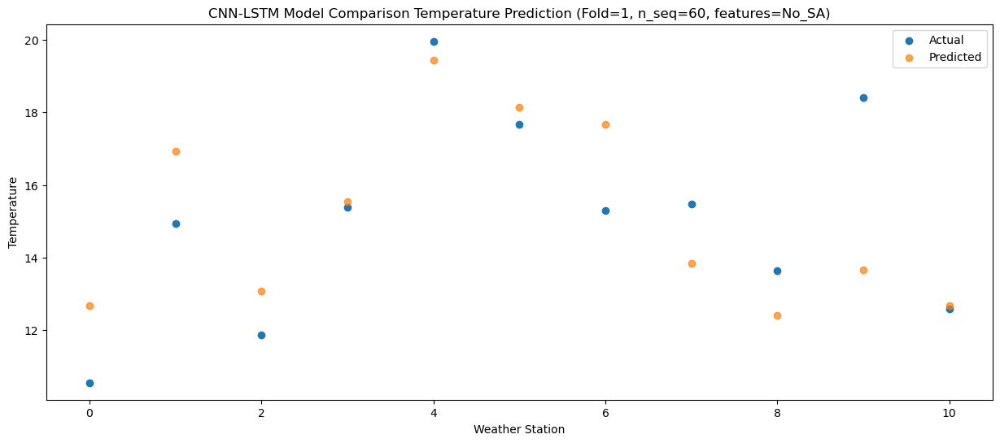

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   6.197623
1                 1   11.21  10.437576
2                 2    7.52   6.587600
3                 3   10.84   9.057576
4                 4   15.02  12.947575
5                 5   14.82  11.657549
6                 6   11.80  11.187581
7                 7    8.70   7.357401
8                 8    7.47   5.927366
9                 9   11.81   7.167413
10               10    7.05   6.197422


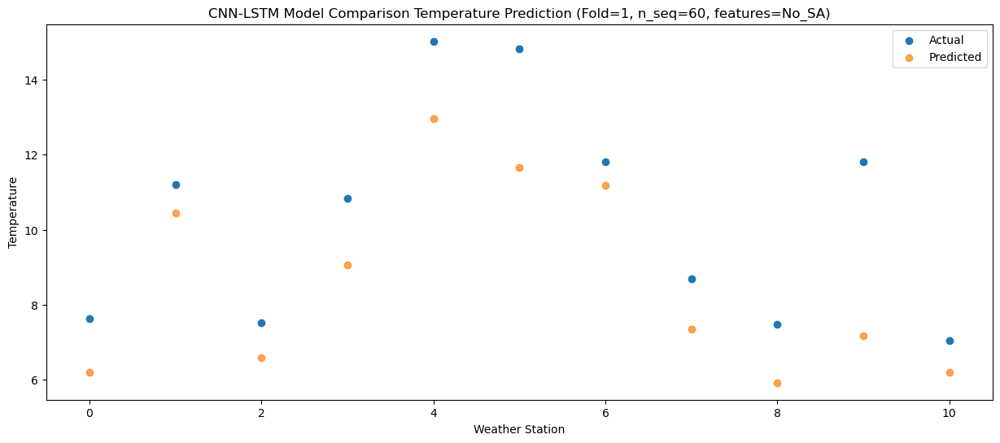

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    3.73   2.509154
1                 1    7.11   6.749112
2                 2    2.72   2.899135
3                 3    7.94   5.369111
4                 4   11.92   9.259110
5                 5   11.10   7.969088
6                 6    7.65   7.499116
7                 7    5.03   3.668955
8                 8    4.59   2.238923
9                 9    8.63   3.478966
10               10    2.85   2.508972


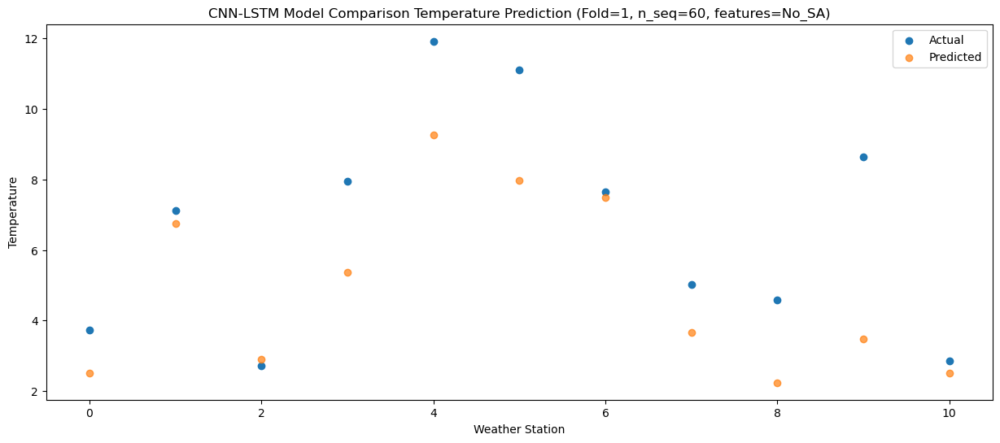

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.11  -4.083859
1                 1    0.22   0.156100
2                 2   -4.34  -3.693877
3                 3    1.76  -1.223901
4                 4    5.56   2.666099
5                 5    4.35   1.376076
6                 6    0.44   0.906105
7                 7   -1.57  -2.924053
8                 8   -2.09  -4.354084
9                 9    1.36  -3.114042
10               10   -4.16  -4.084037


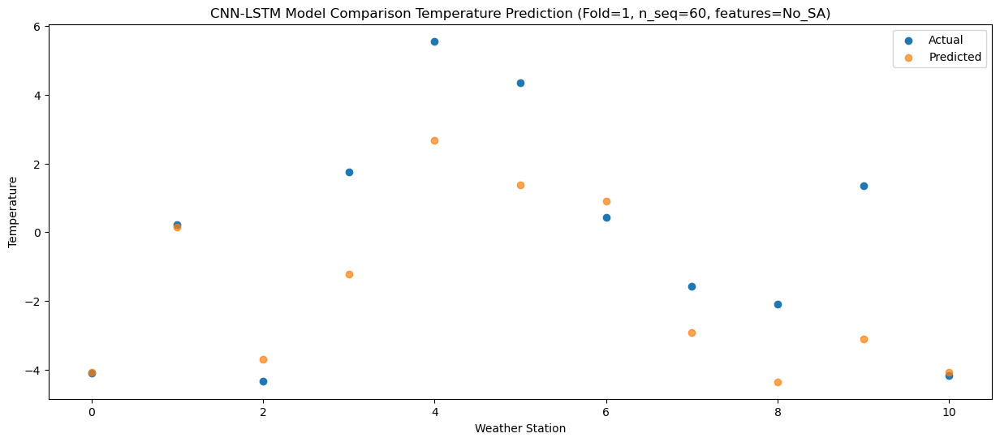

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.69  -5.535845
1                 1    0.02  -1.295896
2                 2   -3.92  -5.145872
3                 3    1.66  -2.675897
4                 4    5.55   1.214101
5                 5    2.84  -0.075925
6                 6    0.24  -0.545890
7                 7   -1.88  -4.376082
8                 8   -2.44  -5.806113
9                 9    1.47  -4.566066
10               10   -6.00  -5.536059


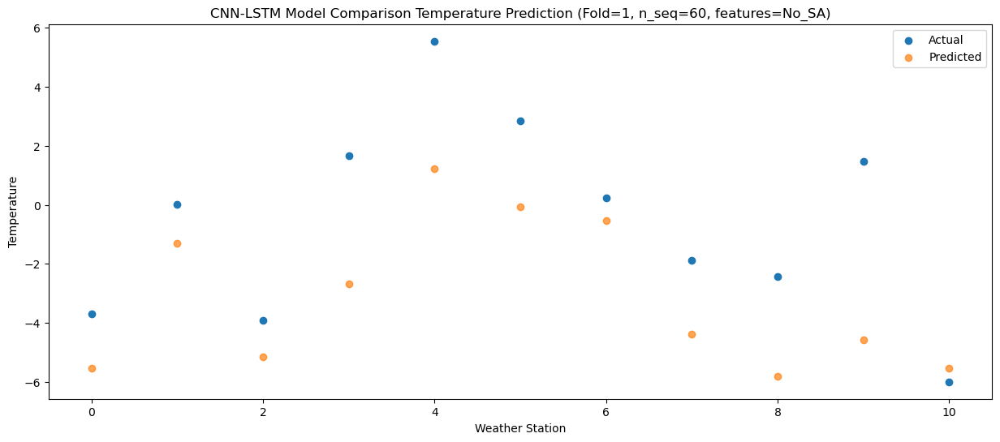

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -8.155285
1                 1    0.68  -3.915336
2                 2   -3.43  -7.765313
3                 3    0.07  -5.295337
4                 4    3.85  -1.405338
5                 5    3.22  -2.695367
6                 6    1.02  -3.165329
7                 7   -4.88  -6.995523
8                 8   -7.22  -8.425552
9                 9   -2.90  -7.185509
10               10   -6.96  -8.155500


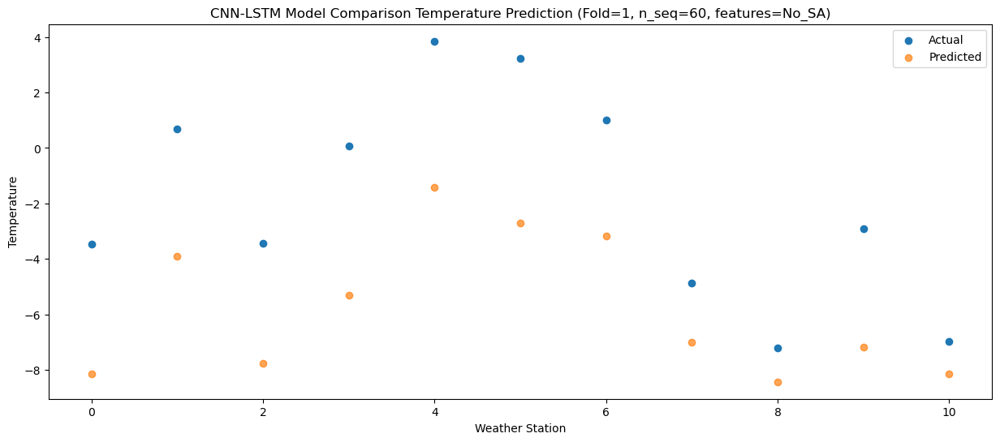

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.51   2.250969
1                 1    7.45   6.490930
2                 2    3.63   2.640948
3                 3    7.44   5.110929
4                 4   11.46   9.000932
5                 5   10.56   7.710905
6                 6    7.30   7.240936
7                 7    6.44   3.410768
8                 8    5.34   1.980743
9                 9    7.81   3.220776
10               10    0.26   2.250793


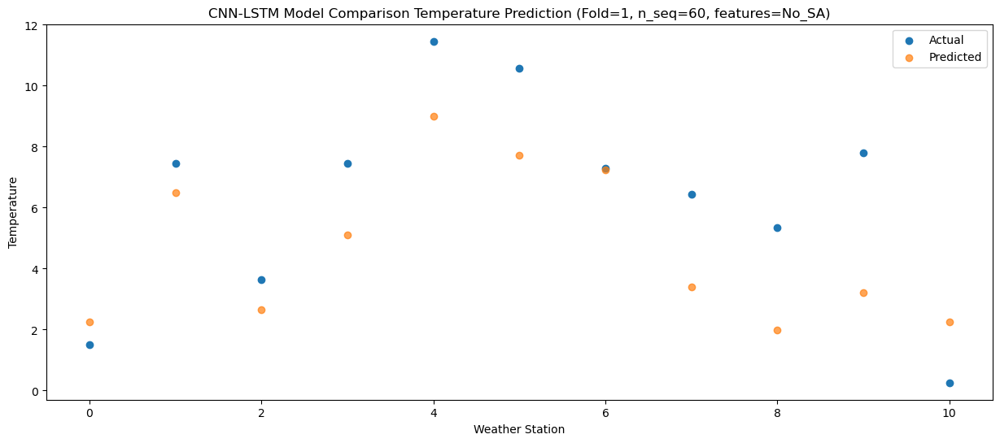

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.32   5.572137
1                 1    9.59   9.812092
2                 2    5.03   5.962112
3                 3    9.78   8.432091
4                 4   13.76  12.322096
5                 5   12.83  11.032068
6                 6    9.87  10.562098
7                 7    8.15   6.731919
8                 8    7.14   5.301892
9                 9   11.57   6.541929
10               10    4.91   5.571949


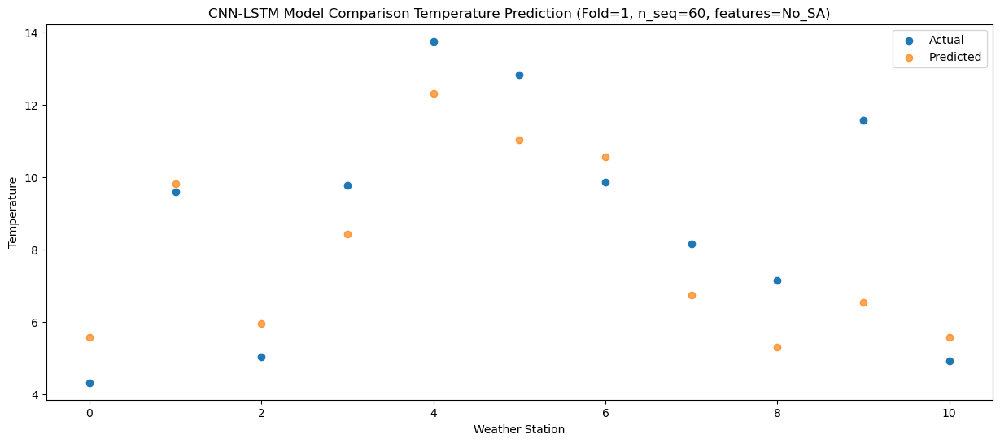

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.93  10.295078
1                 1   13.32  14.535038
2                 2    9.15  10.685057
3                 3   13.67  13.155035
4                 4   17.88  17.045042
5                 5   18.42  15.755018
6                 6   13.64  15.285045
7                 7   12.81  11.454863
8                 8   11.95  10.024840
9                 9   16.12  11.264877
10               10    9.45  10.294899


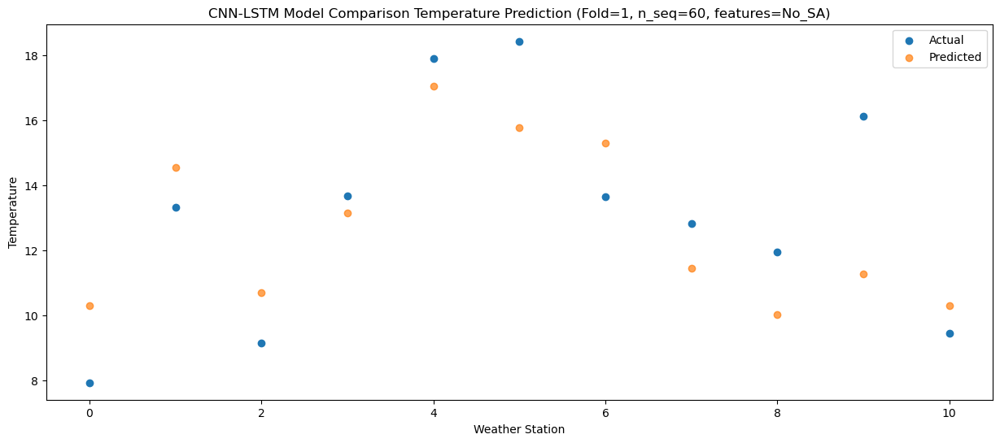

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.42  16.895311
1                 1   17.46  21.135274
2                 2   13.03  17.285298
3                 3   17.56  19.755271
4                 4   21.35  23.645282
5                 5   22.69  22.355253
6                 6   17.65  21.885280
7                 7   18.89  18.055110
8                 8   17.98  16.625093
9                 9   23.23  17.865128
10               10   15.54  16.895149


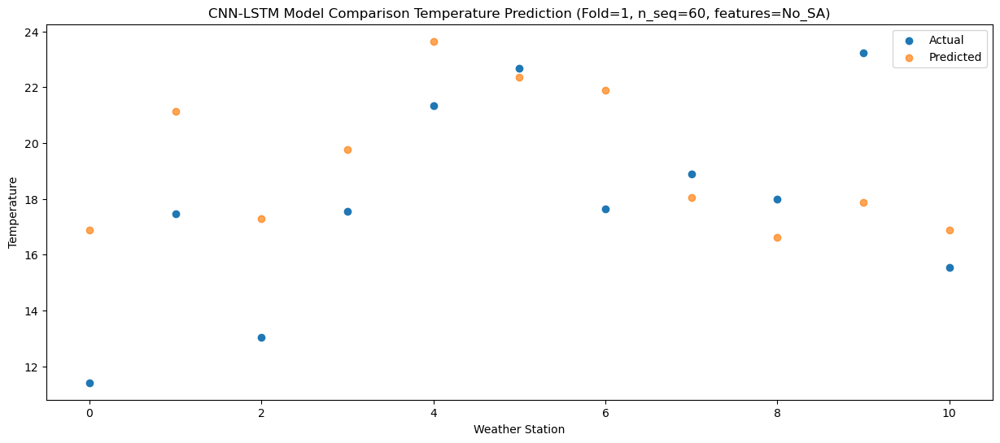

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.62  16.991084
1                 1   18.84  21.231050
2                 2   13.80  17.381073
3                 3   17.44  19.851043
4                 4   21.44  23.741057
5                 5   22.03  22.451028
6                 6   19.01  21.981056
7                 7   19.88  18.150887
8                 8   19.49  16.720873
9                 9   23.90  17.960904
10               10   17.77  16.990929


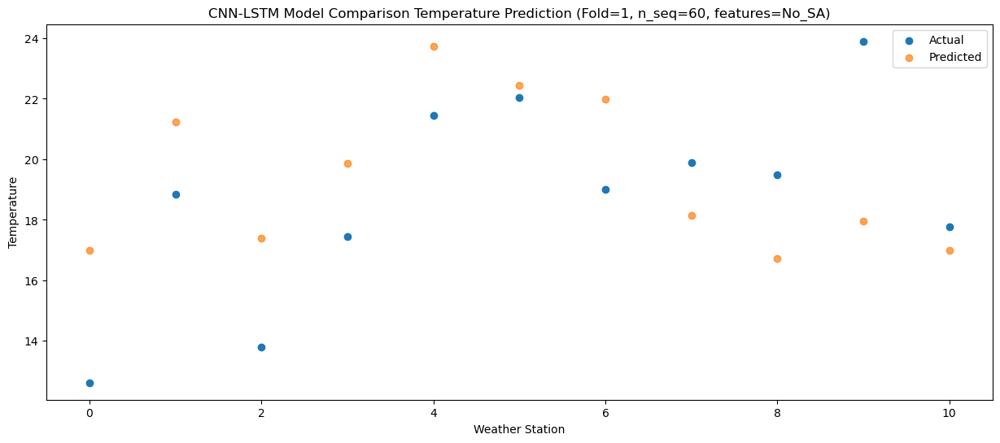

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.73  17.544304
1                 1   19.11  21.784270
2                 2   14.46  17.934291
3                 3   18.41  20.404263
4                 4   22.41  24.294279
5                 5   21.44  23.004248
6                 6   19.27  22.534275
7                 7   21.10  18.704111
8                 8   19.88  17.274103
9                 9   23.75  18.514130
10               10   17.55  17.544157


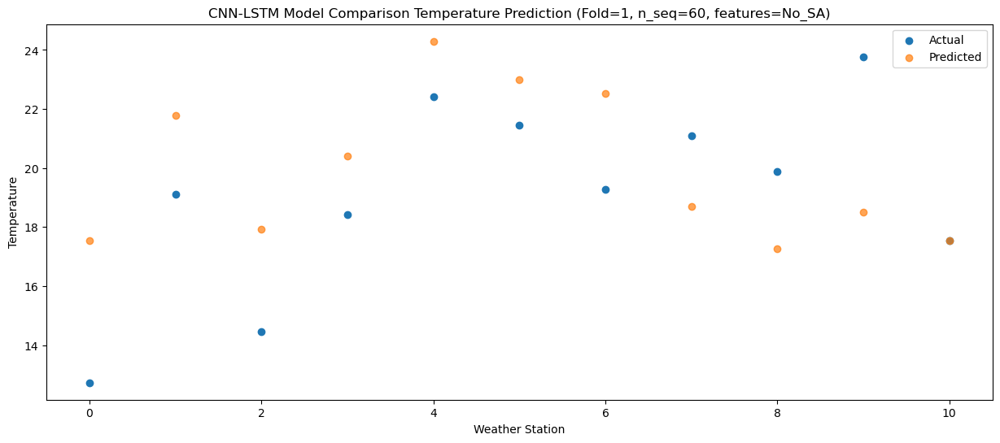

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.08  14.300929
1                 1   15.37  18.540895
2                 2   11.44  14.690913
3                 3   15.40  17.160886
4                 4   18.83  21.050900
5                 5   21.08  19.760868
6                 6   15.94  19.290898
7                 7   17.39  15.460719
8                 8   17.37  14.030710
9                 9   21.80  15.270739
10               10   13.85  14.300770


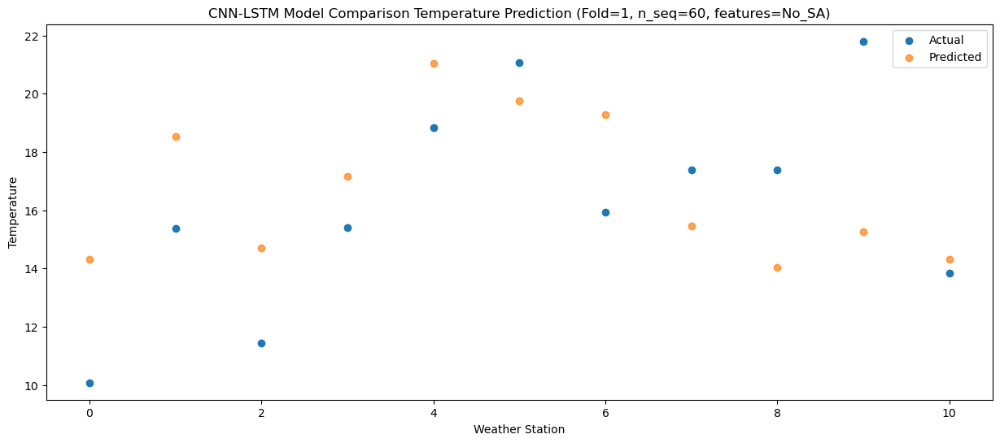

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.38   8.933364
1                 1   11.59  13.173328
2                 2    7.66   9.323348
3                 3   12.71  11.793319
4                 4   15.79  15.683334
5                 5   16.76  14.393299
6                 6   11.99  13.923330
7                 7   12.19  10.093144
8                 8   11.12   8.663134
9                 9   14.36   9.903165
10               10    9.43   8.933194


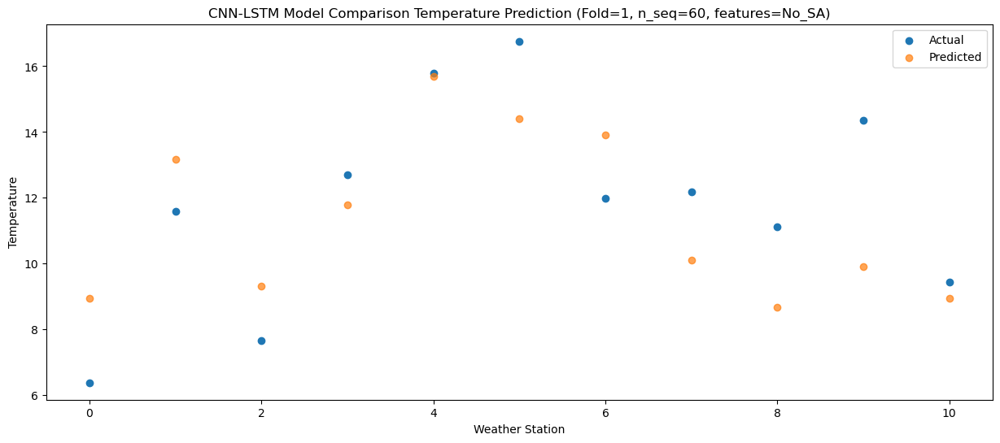

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.83  -0.599216
1                 1    3.93   3.640741
2                 2   -0.08  -0.209237
3                 3    5.55   2.260732
4                 4    8.24   6.150747
5                 5   10.29   4.860708
6                 6    4.39   4.390743
7                 7    2.89   0.560531
8                 8    3.37  -0.869482
9                 9    8.11   0.370555
10               10    0.11  -0.599415


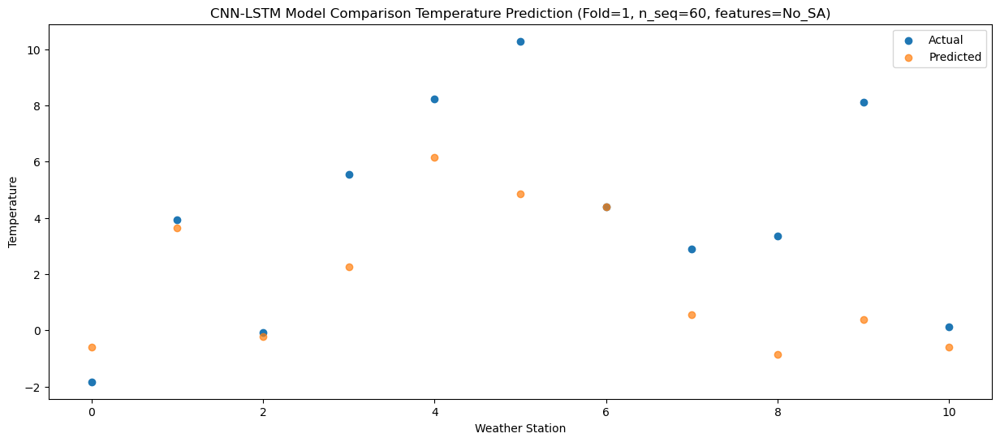

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.52  -0.832048
1                 1    5.56   3.407907
2                 2    2.52  -0.442070
3                 3    8.92   2.027895
4                 4   12.12   5.917910
5                 5   10.55   4.627869
6                 6    5.91   4.157909
7                 7    5.30   0.327681
8                 8    2.56  -1.102334
9                 9    6.50   0.137704
10               10   -0.66  -0.832262


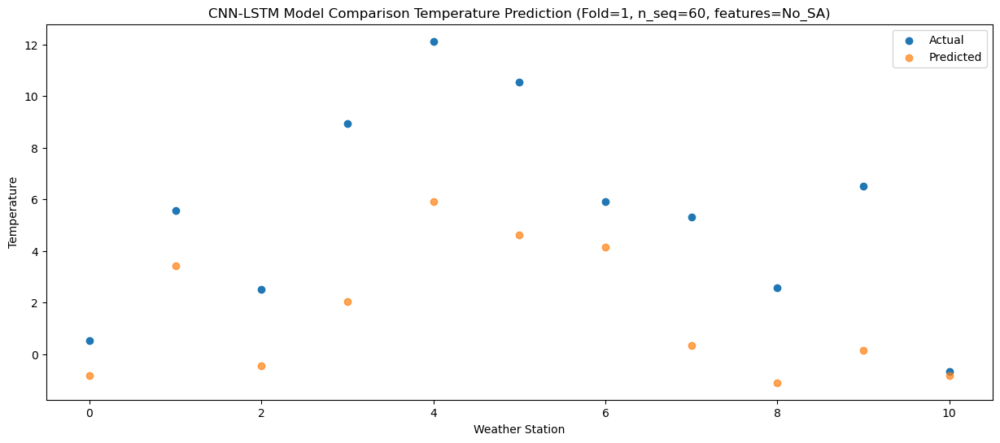

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.64  -9.121994
1                 1   -1.17  -4.882039
2                 2   -4.37  -8.732017
3                 3    0.87  -6.262052
4                 4    3.64  -2.372035
5                 5    3.23  -3.662077
6                 6   -0.48  -4.132038
7                 7   -3.53  -7.962266
8                 8   -5.06  -9.392283
9                 9   -0.42  -8.152243
10               10   -7.68  -9.122210


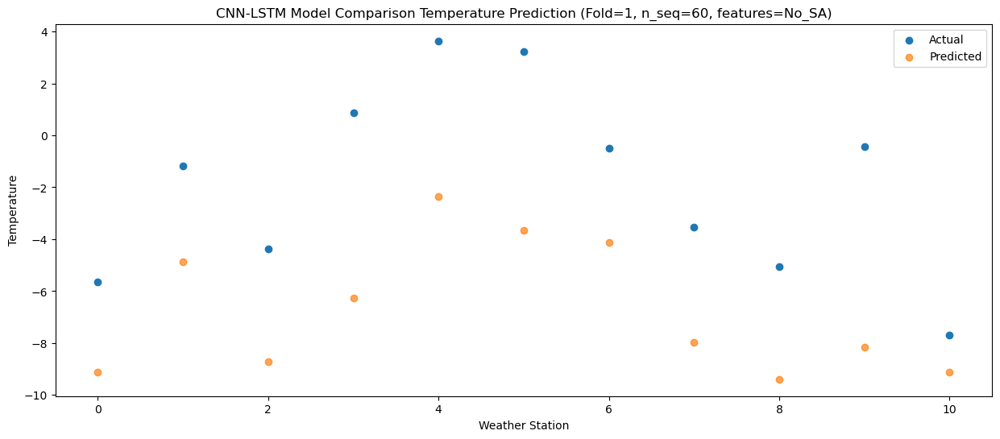

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.80  -7.003149
1                 1    3.06  -2.763194
2                 2   -1.02  -6.613172
3                 3    0.40  -4.143207
4                 4    3.33  -0.253192
5                 5    3.12  -1.543236
6                 6    3.33  -2.013197
7                 7   -1.48  -5.843417
8                 8   -4.08  -7.273434
9                 9   -0.36  -6.033394
10               10   -3.78  -7.003363


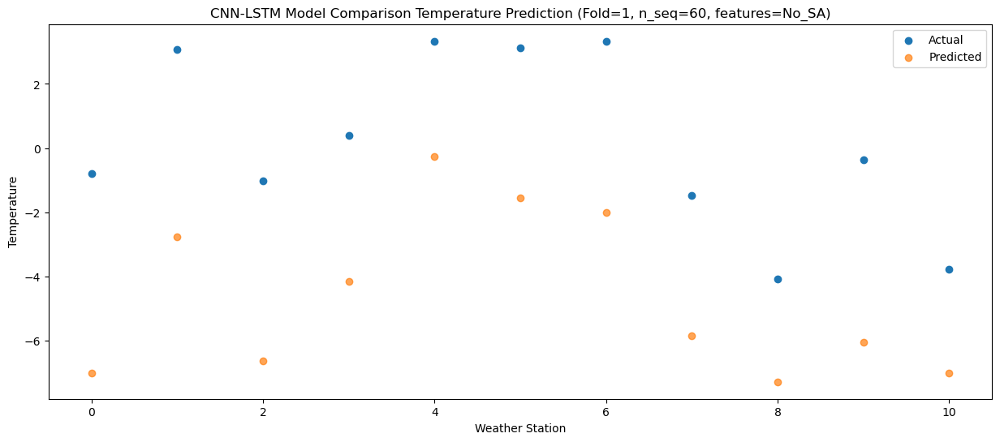

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.59  -0.189731
1                 1    6.63   4.050223
2                 2    2.98   0.200242
3                 3    6.24   2.670210
4                 4    9.11   6.560222
5                 5   10.07   5.270174
6                 6    7.17   4.800221
7                 7    4.47   0.969984
8                 8    3.17  -0.460036
9                 9    6.57   0.780007
10               10    0.78  -0.189957


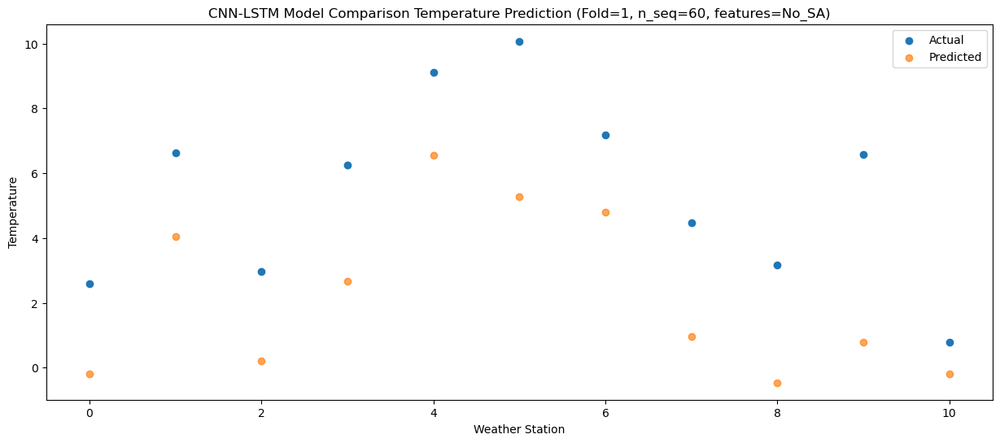

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.58   4.128742
1                 1    9.63   8.368691
2                 2    6.57   4.518713
3                 3   12.24   6.988678
4                 4   15.38  10.878690
5                 5   16.98   9.588638
6                 6    9.93   9.118688
7                 7    9.66   5.288424
8                 8   10.28   3.858400
9                 9   13.05   5.098447
10               10    4.13   4.128490


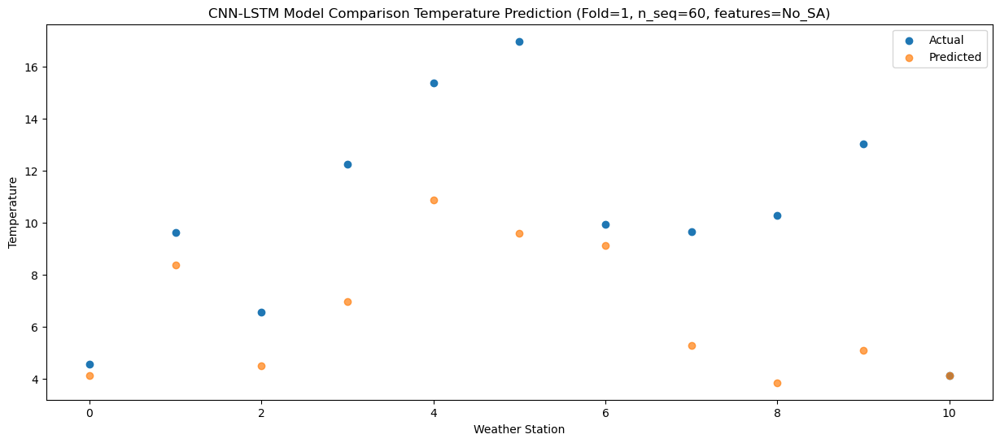

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.83  11.100077
1                 1   15.51  15.340020
2                 2   11.93  11.490048
3                 3   16.67  13.960007
4                 4   20.00  17.850011
5                 5   22.38  16.559961
6                 6   15.85  16.090018
7                 7   15.13  12.259732
8                 8   15.64  10.829708
9                 9   18.50  12.069757
10               10   11.11  11.099801


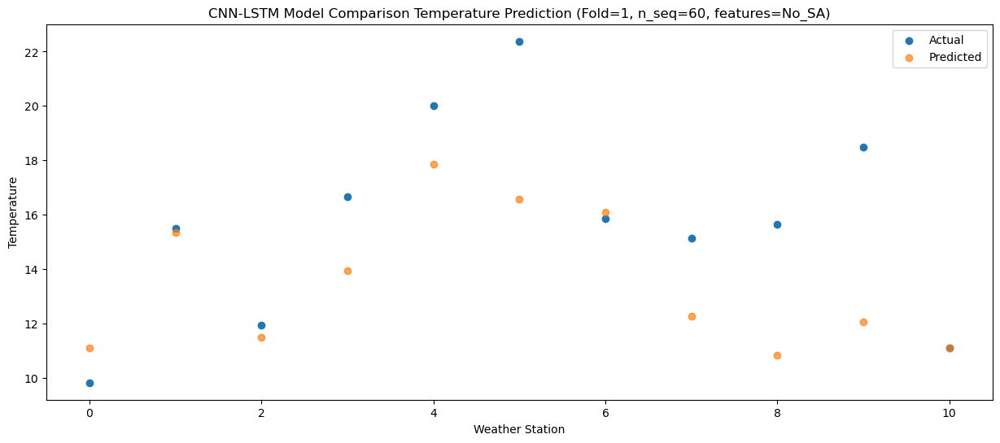

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.33  15.048952
1                 1   19.48  19.288897
2                 2   14.90  15.438923
3                 3   19.67  17.908882
4                 4   23.37  21.798886
5                 5   24.44  20.508836
6                 6   19.43  20.038897
7                 7   19.19  16.208599
8                 8   19.93  14.778577
9                 9   23.07  16.018627
10               10   15.50  15.048671


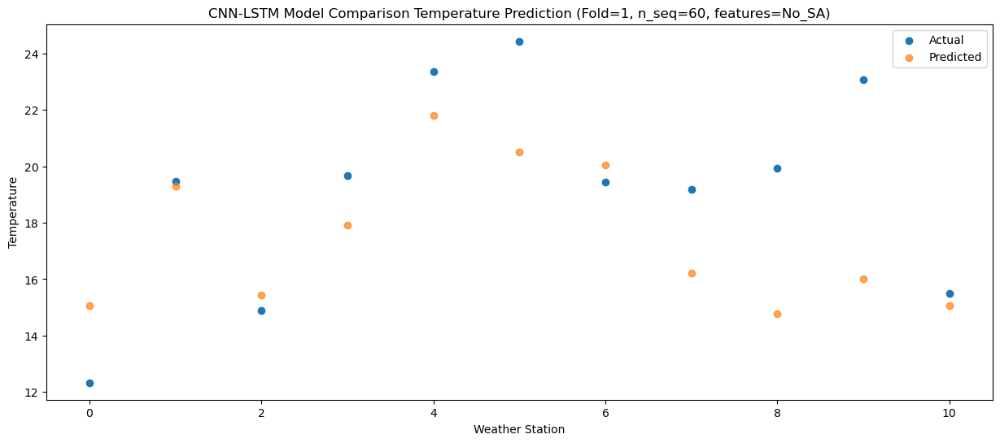

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.23  17.005414
1                 1   19.98  21.245363
2                 2   15.61  17.395388
3                 3   20.61  19.865350
4                 4   24.46  23.755352
5                 5   25.36  22.465304
6                 6   20.17  21.995363
7                 7   23.32  18.165077
8                 8   24.08  16.735055
9                 9   26.67  17.975104
10               10   19.44  17.005146


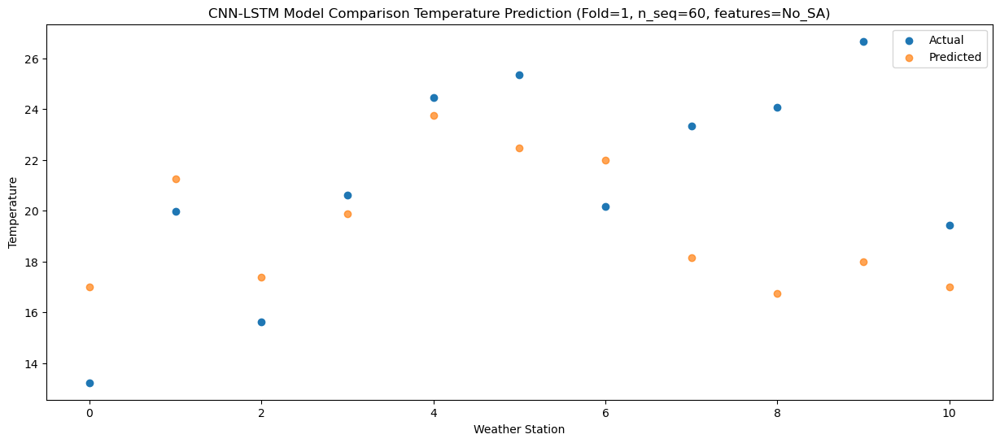

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.43  14.787568
1                 1   18.52  19.027515
2                 2   14.00  15.177537
3                 3   18.97  17.647499
4                 4   22.45  21.537500
5                 5   22.51  20.247448
6                 6   18.67  19.777514
7                 7   20.45  15.947200
8                 8   21.41  14.517174
9                 9   23.84  15.757227
10               10   18.90  14.787273


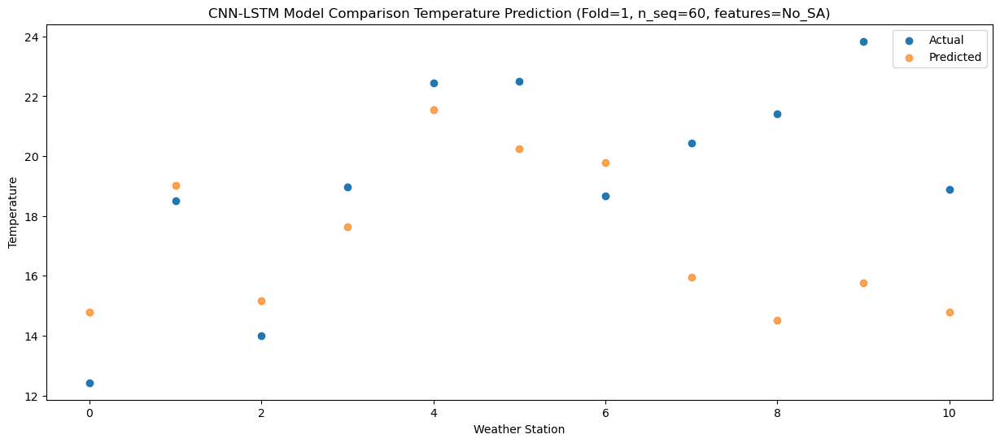

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.47  10.915866
1                 1   15.43  15.155815
2                 2   11.61  11.305836
3                 3   16.20  13.775798
4                 4   19.27  17.665797
5                 5   19.46  16.375746
6                 6   15.78  15.905817
7                 7   16.61  12.075496
8                 8   17.58  10.645472
9                 9   21.43  11.885527
10               10   13.99  10.915568


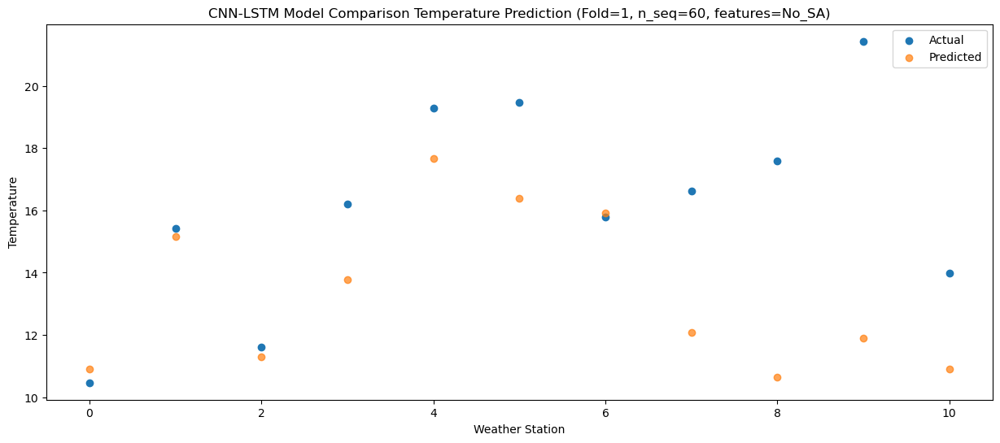

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.92   3.718135
1                 1    9.09   7.958080
2                 2    4.92   4.108104
3                 3   10.64   6.578066
4                 4   13.88  10.468065
5                 5   13.38   9.178014
6                 6    9.44   8.708082
7                 7    9.94   4.877766
8                 8    9.35   3.447740
9                 9   12.89   4.687794
10               10    5.89   3.717833


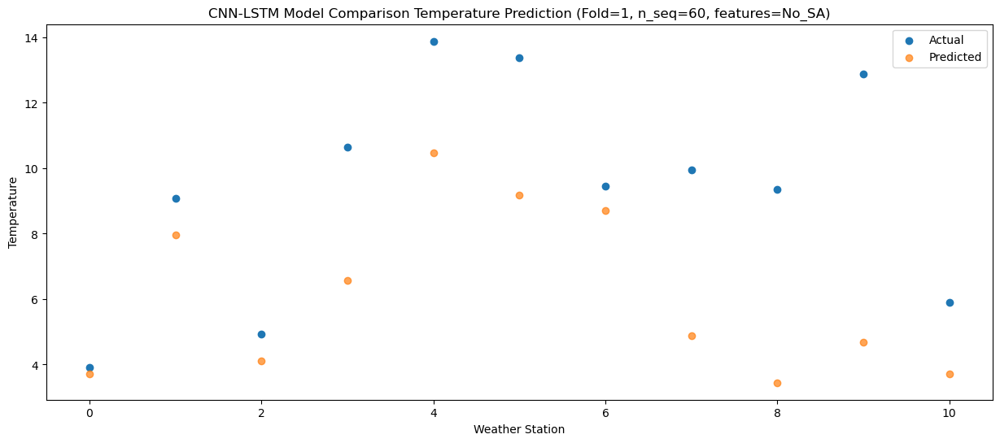

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.72  -2.574747
1                 1    6.09   1.665201
2                 2    1.60  -2.184777
3                 3    5.59   0.285187
4                 4    8.88   4.175187
5                 5    6.42   2.885133
6                 6    6.55   2.415203
7                 7    3.34  -1.415113
8                 8    1.50  -2.845137
9                 9    3.90  -1.605085
10               10    2.38  -2.575045


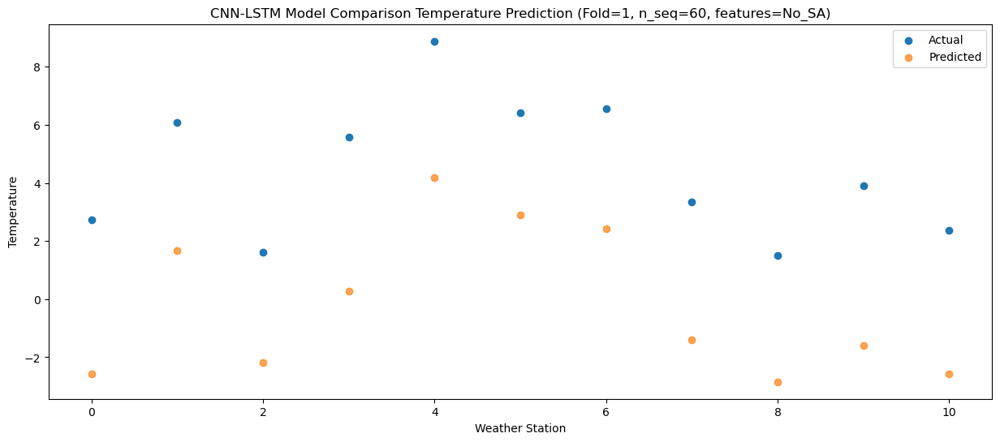

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.04  -7.831713
1                 1    0.28  -3.591763
2                 2   -1.56  -7.441741
3                 3    3.50  -4.971777
4                 4    6.86  -1.081775
5                 5    5.30  -2.371828
6                 6    0.54  -2.841761
7                 7   -0.40  -6.672077
8                 8   -2.13  -8.102099
9                 9    1.55  -6.862046
10               10   -4.77  -7.832009


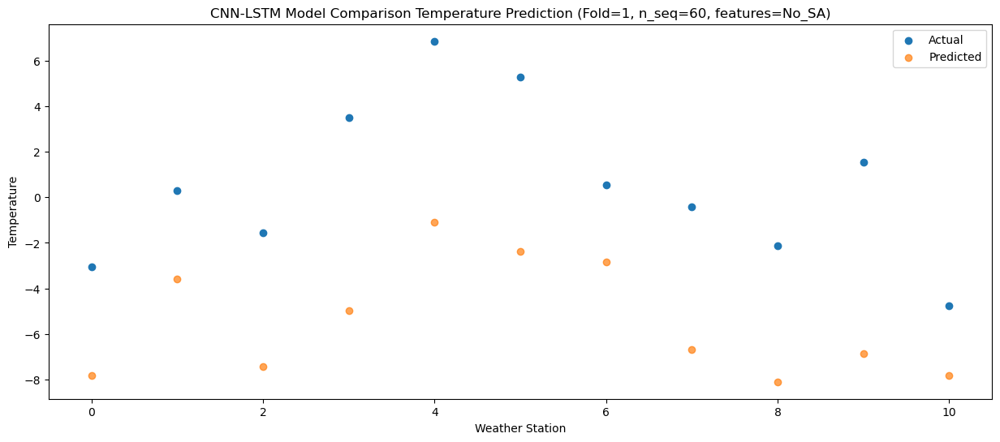

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.93  -6.500482
1                 1    2.47  -2.260530
2                 2   -0.56  -6.110506
3                 3    4.21  -3.640544
4                 4    7.34   0.249458
5                 5    5.76  -1.040595
6                 6    2.67  -1.510527
7                 7    0.79  -5.340841
8                 8   -1.27  -6.770858
9                 9    1.83  -5.530808
10               10   -1.81  -6.500773


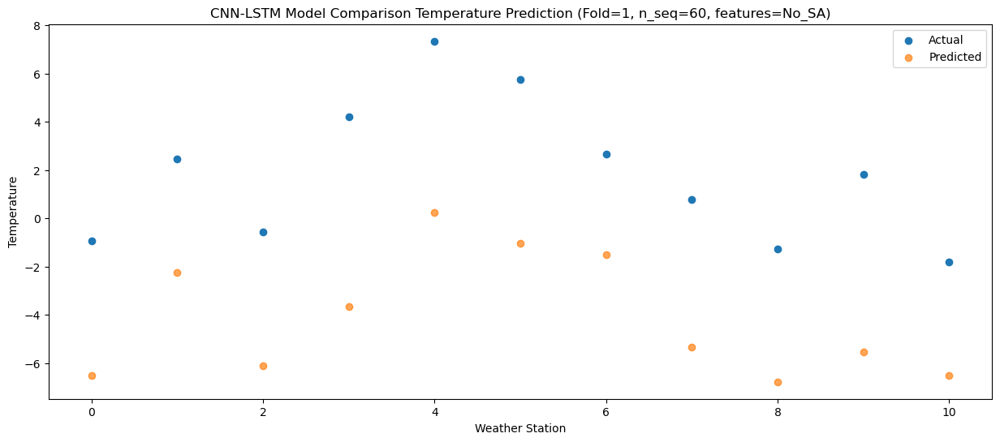

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.98  -5.145228
1                 1    5.84  -0.905268
2                 2    2.03  -4.755246
3                 3    5.21  -2.285286
4                 4    8.52   1.604716
5                 5    5.90   0.314669
6                 6    6.26  -0.155266
7                 7    2.29  -3.985557
8                 8   -0.90  -5.415569
9                 9    2.98  -4.175524
10               10   -2.13  -5.145493


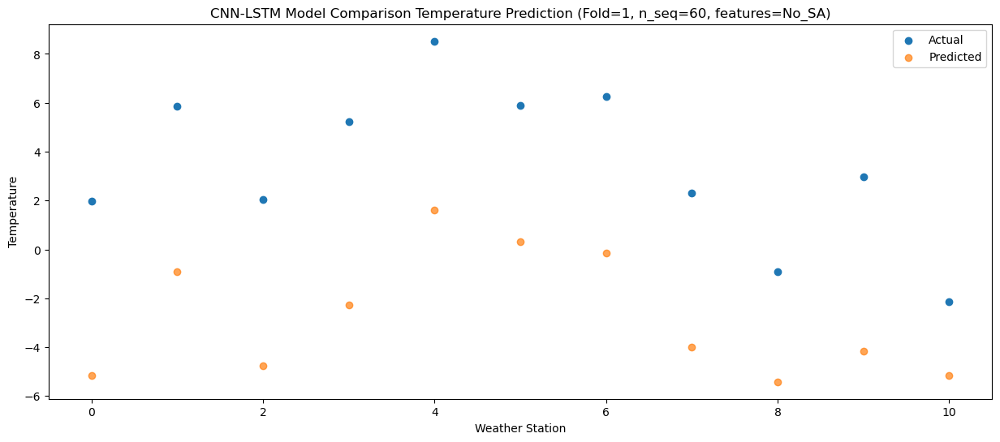

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.62  -3.596029
1                 1    6.61   0.643933
2                 2    3.46  -3.206047
3                 3    9.04  -0.736085
4                 4   12.34   3.153919
5                 5   10.96   1.863872
6                 6    6.93   1.393937
7                 7    5.12  -2.436338
8                 8    3.53  -3.866350
9                 9    6.71  -2.626309
10               10   -1.01  -3.596282


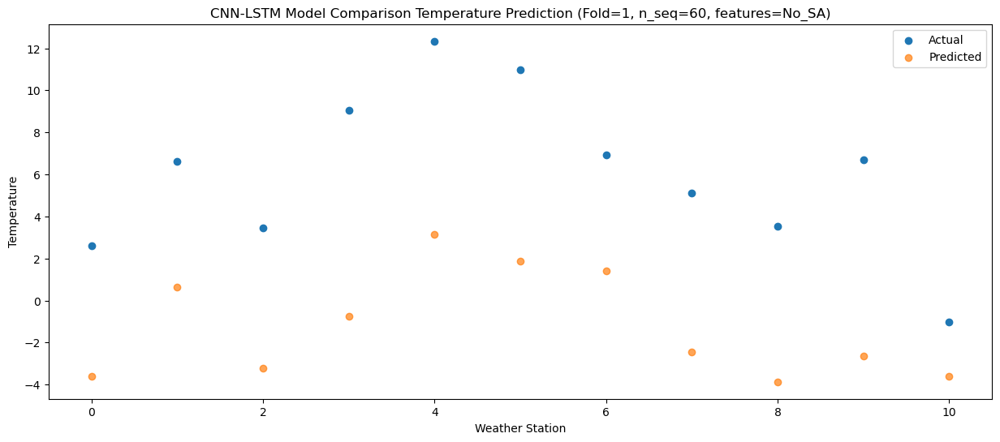

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    6.12   2.238152
1                 1    9.88   6.478117
2                 2    6.15   2.628137
3                 3    9.88   5.098097
4                 4   13.30   8.988098
5                 5   14.12   7.698053
6                 6   10.19   7.228118
7                 7    9.52   3.397843
8                 8    7.86   1.967829
9                 9   12.06   3.207872
10               10    6.21   2.237902


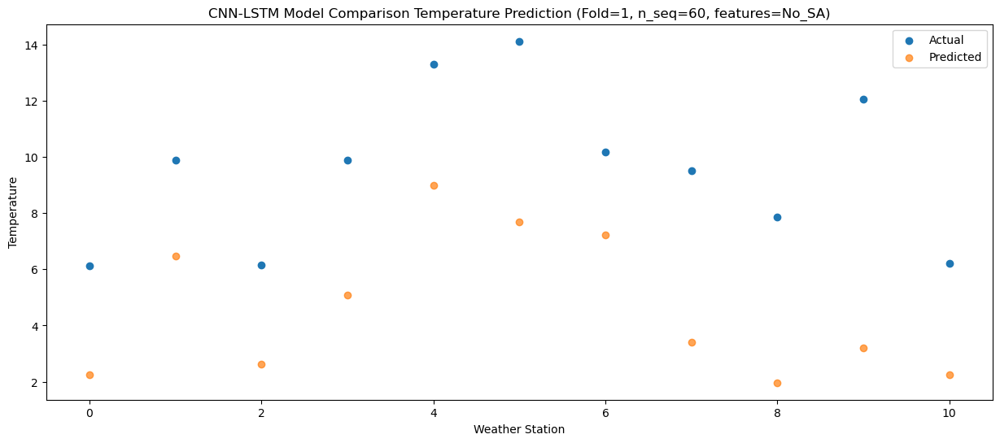

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.62   7.622680
1                 1   13.16  11.862644
2                 2    9.39   8.012665
3                 3   14.47  10.482626
4                 4   17.94  14.372626
5                 5   18.73  13.082581
6                 6   13.19  12.612646
7                 7   14.87   8.782365
8                 8   13.55   7.352353
9                 9   17.17   8.592392
10               10    8.77   7.622429


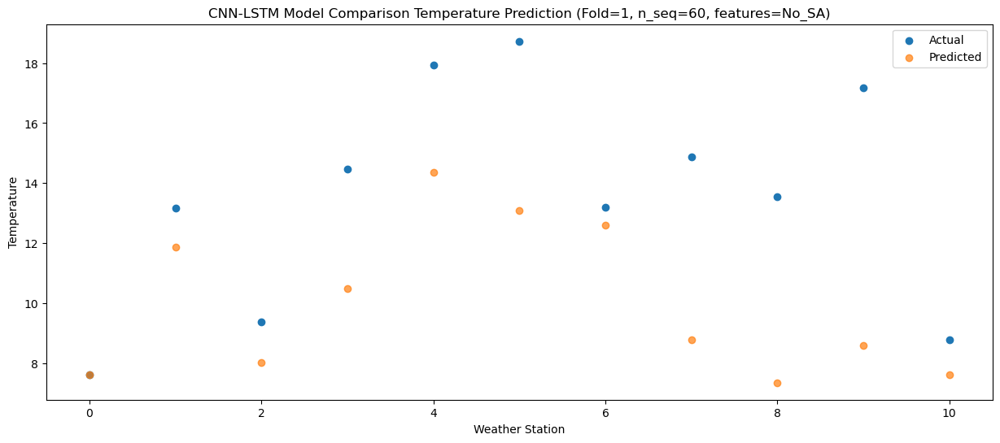

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.24  11.721138
1                 1   16.35  15.961107
2                 2   13.14  12.111123
3                 3   18.62  14.581087
4                 4   22.83  18.471089
5                 5   25.42  17.181043
6                 6   16.47  16.711108
7                 7   18.68  12.880828
8                 8   18.48  11.450811
9                 9   20.40  12.690855
10               10   13.14  11.720892


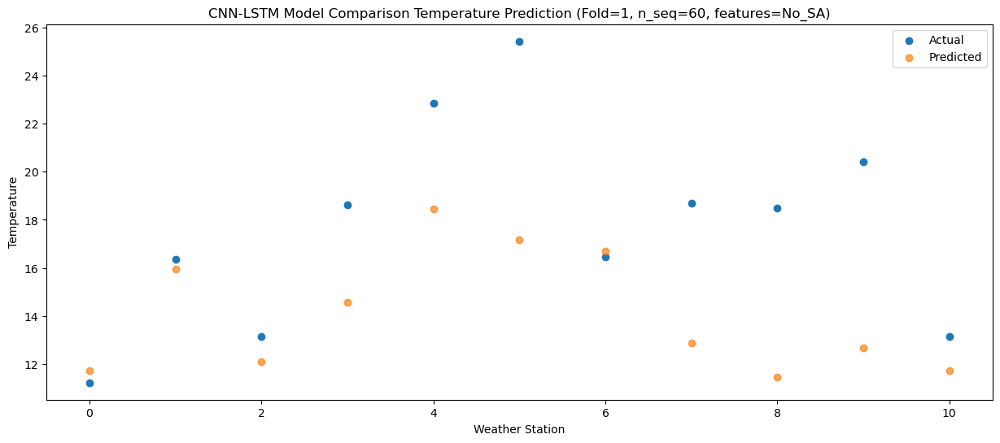

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   14.47  14.352643
1                 1   19.95  18.592615
2                 2   15.51  14.742629
3                 3   20.34  17.212597
4                 4   24.78  21.102595
5                 5   26.52  19.812550
6                 6   19.92  19.342617
7                 7   20.98  15.512336
8                 8   21.36  14.082320
9                 9   25.02  15.322363
10               10   18.28  14.352396


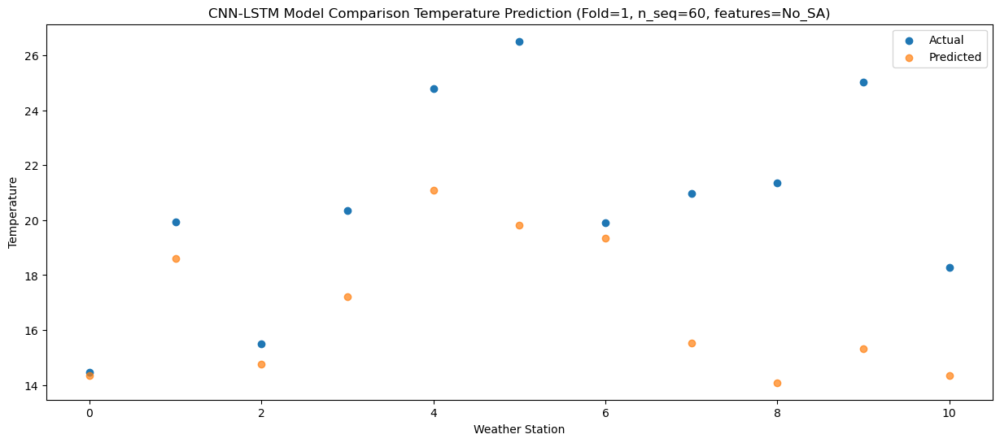

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.26  13.746916
1                 1   19.41  17.986887
2                 2   15.95  14.136902
3                 3   22.31  16.606868
4                 4   26.21  20.496865
5                 5   25.71  19.206821
6                 6   19.50  18.736888
7                 7   21.48  14.906602
8                 8   23.17  13.476584
9                 9   25.42  14.716628
10               10   16.54  13.746660


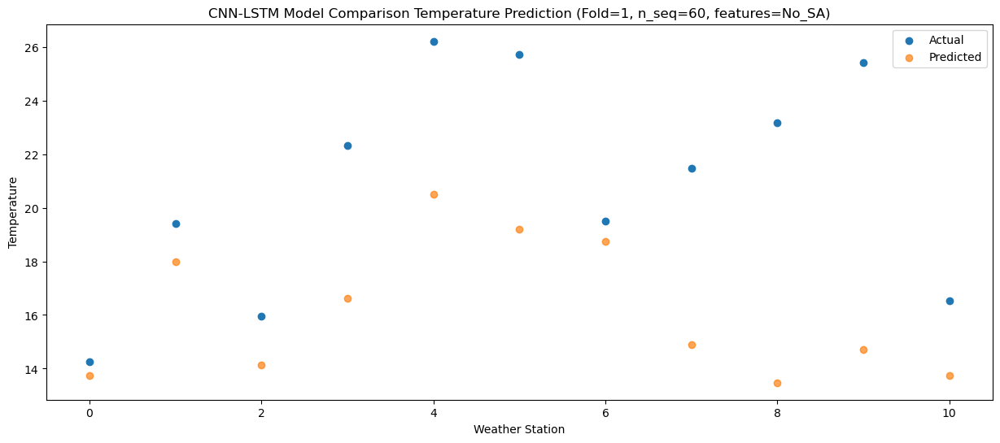

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   10.57  10.194034
1                 1   15.90  14.434011
2                 2   12.99  10.584020
3                 3   19.23  13.053990
4                 4   22.36  16.943989
5                 5   23.43  15.653946
6                 6   16.33  15.184012
7                 7   17.86  11.353739
8                 8   18.53   9.923718
9                 9   21.90  11.163763
10               10   13.35  10.193793


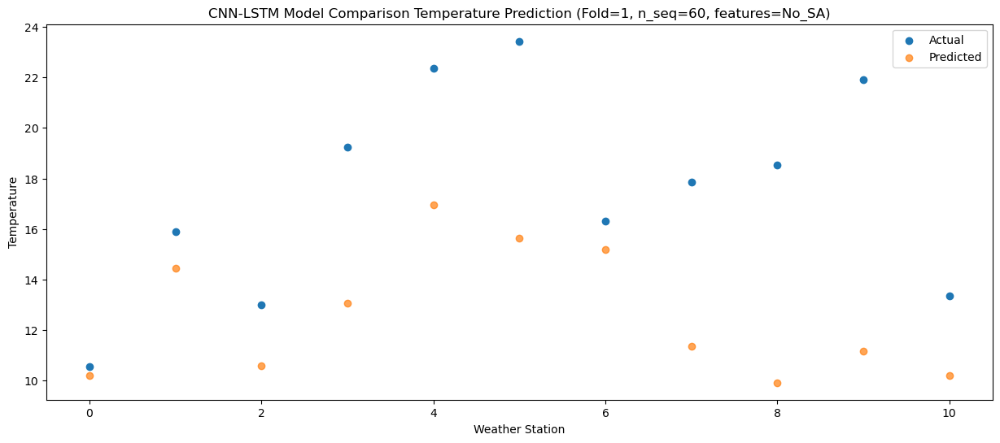

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.69   3.086308
1                 1   10.89   7.326286
2                 2    6.95   3.476294
3                 3   11.97   5.946265
4                 4   14.96   9.836267
5                 5   15.83   8.546221
6                 6   11.32   8.076287
7                 7   11.55   4.246025
8                 8    9.95   2.816007
9                 9   13.80   4.056049
10               10    8.00   3.086080


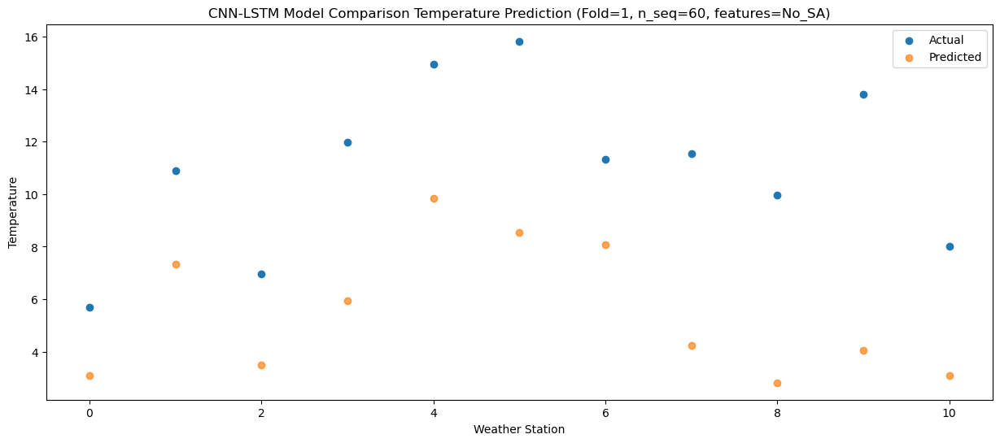

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.54  -4.250228
1                 1    5.27  -0.010245
2                 2    0.39  -3.860239
3                 3    5.69  -1.390267
4                 4    8.76   2.499736
5                 5    9.17   1.209692
6                 6    5.63   0.739756
7                 7    4.15  -3.090500
8                 8    2.83  -4.520520
9                 9    7.05  -3.280479
10               10    0.06  -4.250445


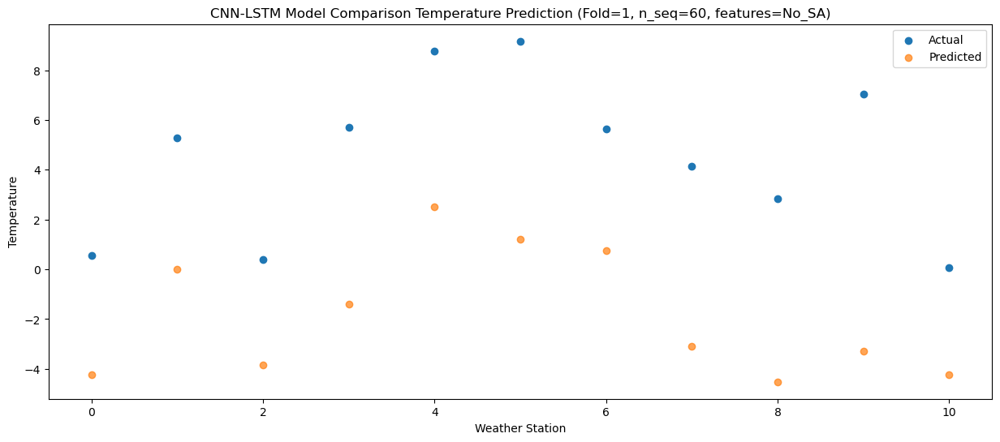

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.49  -7.103808
1                 1    2.13  -2.863827
2                 2   -2.39  -6.713824
3                 3    3.29  -4.243851
4                 4    6.86  -0.353851
5                 5    6.81  -1.643895
6                 6    2.89  -2.113827
7                 7    1.23  -5.944099
8                 8   -0.02  -7.374118
9                 9    3.22  -6.134076
10               10   -1.63  -7.104039


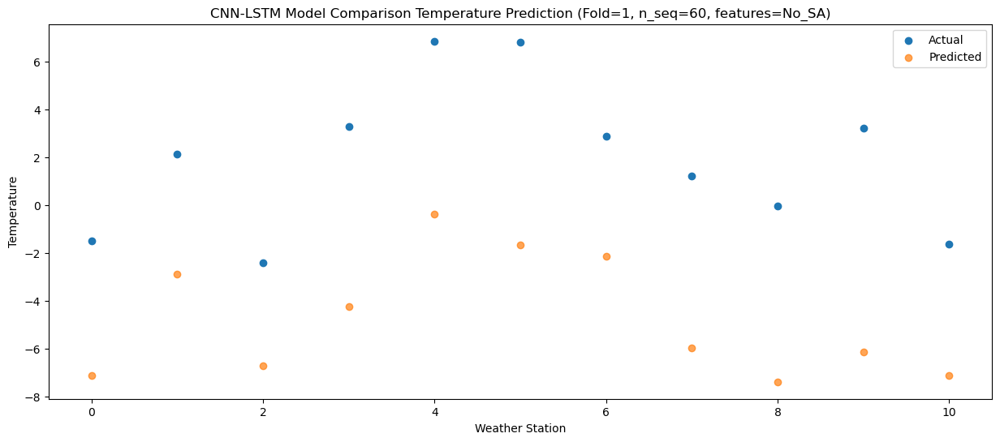

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.81 -12.754722
1                 1   -1.15  -8.514743
2                 2   -5.47 -12.364738
3                 3   -0.13  -9.894767
4                 4    3.01  -6.004767
5                 5    3.20  -7.294813
6                 6   -0.11  -7.764743
7                 7   -4.70 -11.595022
8                 8   -5.85 -13.025043
9                 9   -1.95 -11.784997
10               10   -5.53 -12.754964


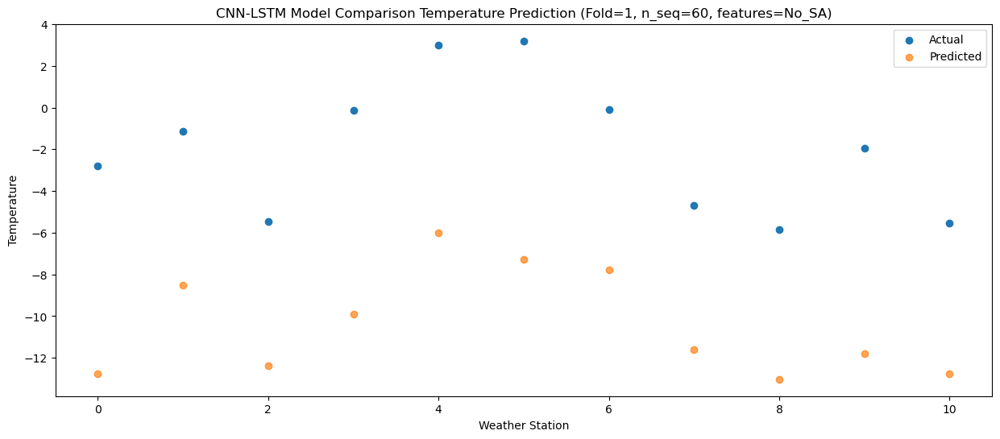

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.43  -6.784837
1                 1    3.93  -2.544868
2                 2   -0.13  -6.394859
3                 3    6.18  -3.924891
4                 4    9.38  -0.034894
5                 5    9.32  -1.324942
6                 6    4.10  -1.794865
7                 7    4.30  -5.625164
8                 8    2.10  -7.055187
9                 9    5.76  -5.815139
10               10   -3.58  -6.785105


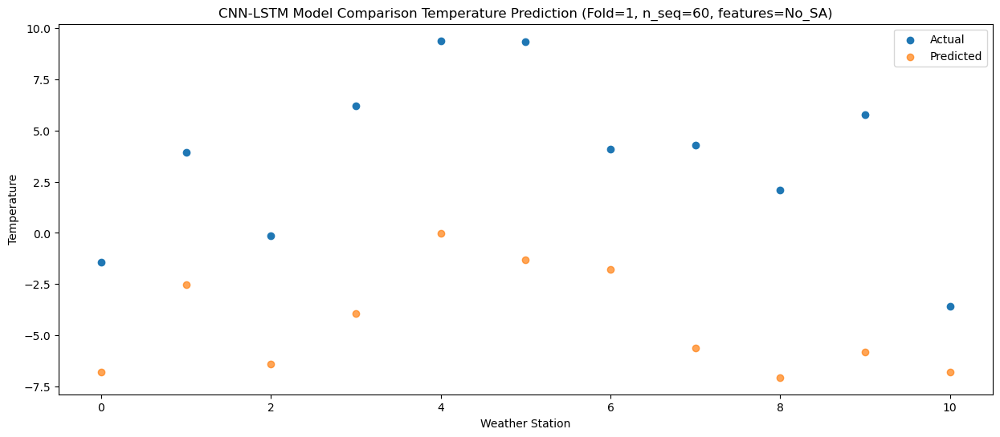

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.42  -3.504197
1                 1    7.15   0.735765
2                 2    2.97  -3.114227
3                 3    8.69  -0.644262
4                 4   12.12   3.245731
5                 5   11.67   1.955683
6                 6    7.76   1.485765
7                 7    7.02  -2.344574
8                 8    5.34  -3.774602
9                 9    8.59  -2.534542
10               10    0.82  -3.504507


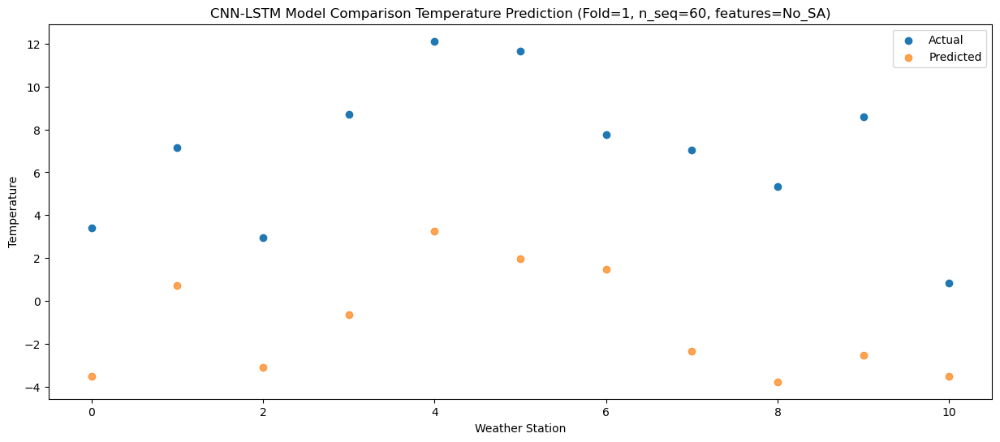

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.82   1.414318
1                 1   10.82   5.654278
2                 2    6.31   1.804288
3                 3   12.17   4.274248
4                 4   15.68   8.164242
5                 5   16.47   6.874196
6                 6   11.23   6.404280
7                 7   11.06   2.573936
8                 8   10.02   1.143905
9                 9   13.66   2.383965
10               10    5.21   1.414000


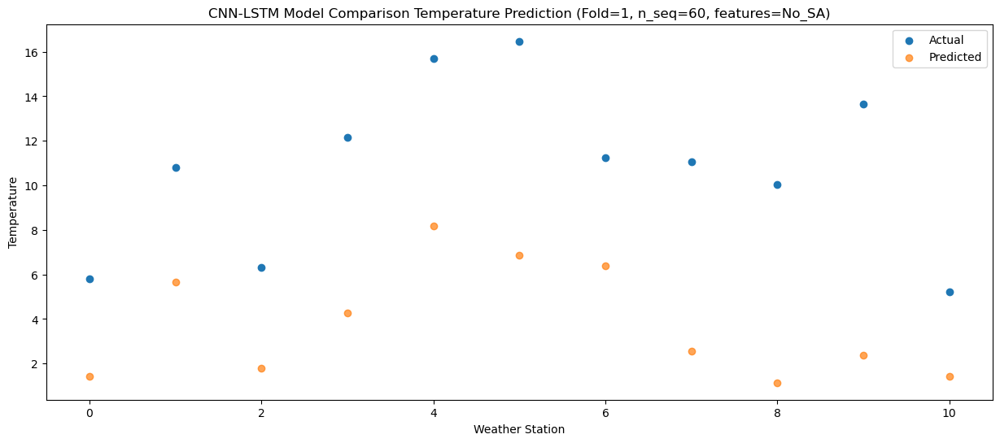

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   10.49   7.341073
1                 1   15.39  11.581037
2                 2   11.92   7.731049
3                 3   15.87  10.201007
4                 4   19.38  14.091001
5                 5   22.09  12.800953
6                 6   15.47  12.331039
7                 7   16.60   8.500697
8                 8   14.78   7.070664
9                 9   17.80   8.310724
10               10   10.80   7.340757


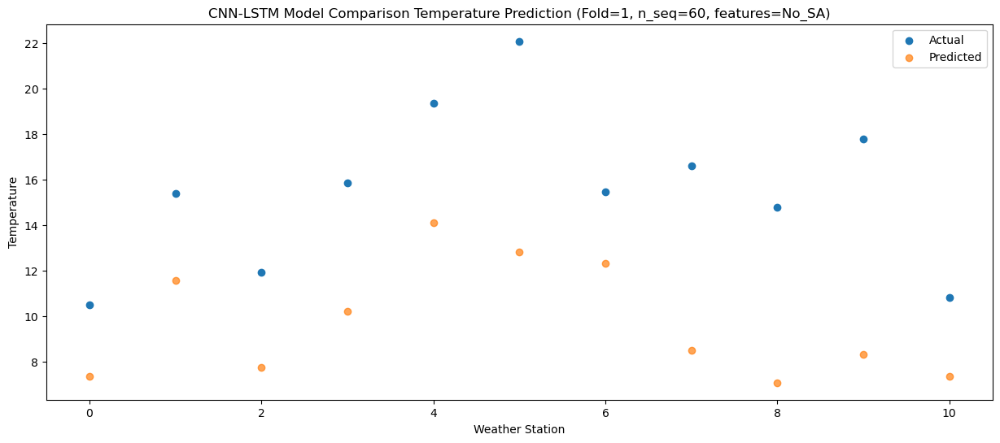

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.36  11.644119
1                 1   19.15  15.884077
2                 2   15.03  12.034093
3                 3   18.50  14.504047
4                 4   22.27  18.394049
5                 5   24.95  17.103995
6                 6   19.40  16.634079
7                 7   19.67  12.803729
8                 8   20.48  11.373700
9                 9   24.21  12.613756
10               10   16.91  11.643793


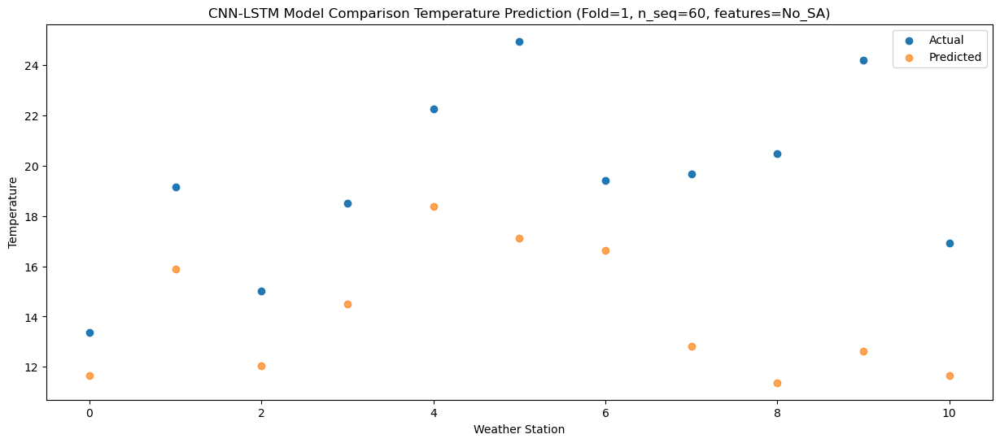

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.32  12.012684
1                 1   20.08  16.252636
2                 2   15.05  12.402656
3                 3   17.89  14.872606
4                 4   22.08  18.762608
5                 5   23.95  17.472550
6                 6   20.43  17.002640
7                 7   20.31  13.172269
8                 8   21.33  11.742236
9                 9   24.94  12.982299
10               10   18.84  12.012334


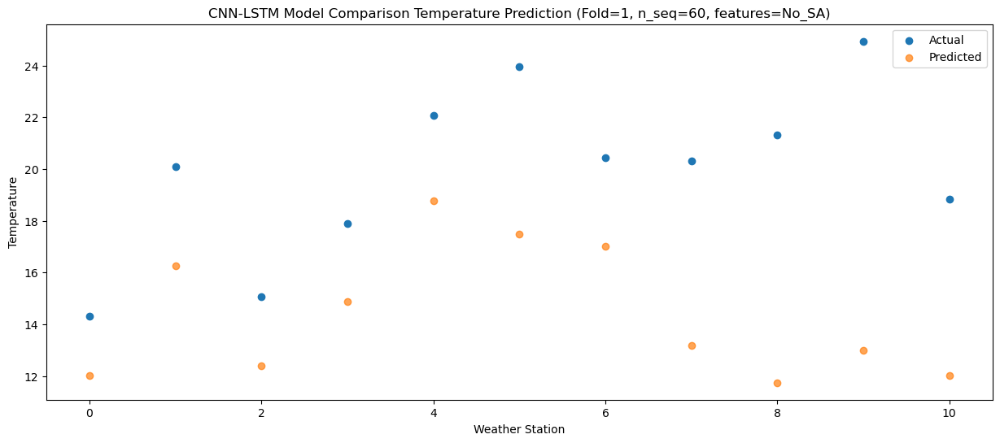

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.97  11.417799
1                 1   19.80  15.657756
2                 2   15.36  11.807778
3                 3   19.02  14.277730
4                 4   23.40  18.167732
5                 5   25.55  16.877674
6                 6   20.10  16.407760
7                 7   20.72  12.577414
8                 8   23.44  11.147381
9                 9   25.74  12.387444
10               10   16.69  11.417477


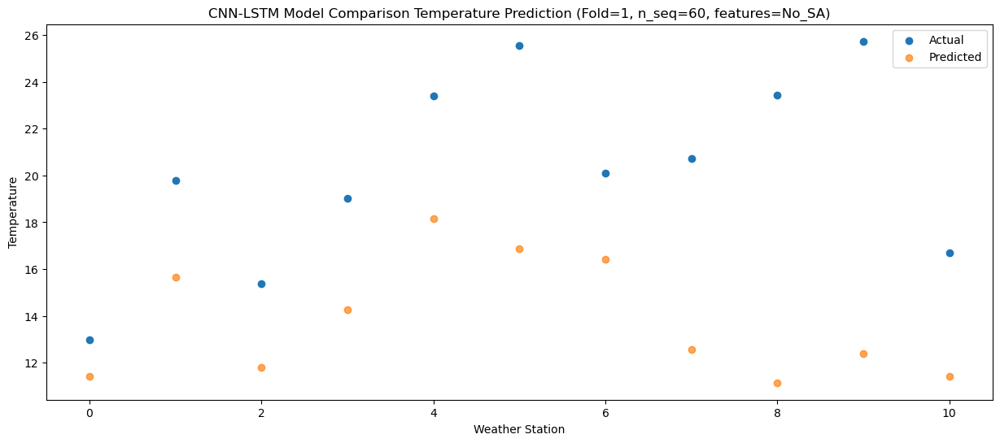

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   10.53   7.925509
1                 1   16.08  12.165465
2                 2   13.05   8.315487
3                 3   16.42  10.785439
4                 4   20.11  14.675440
5                 5   19.84  13.385381
6                 6   16.80  12.915471
7                 7   18.85   9.085109
8                 8   17.47   7.655077
9                 9   21.18   8.895142
10               10   12.96   7.925177


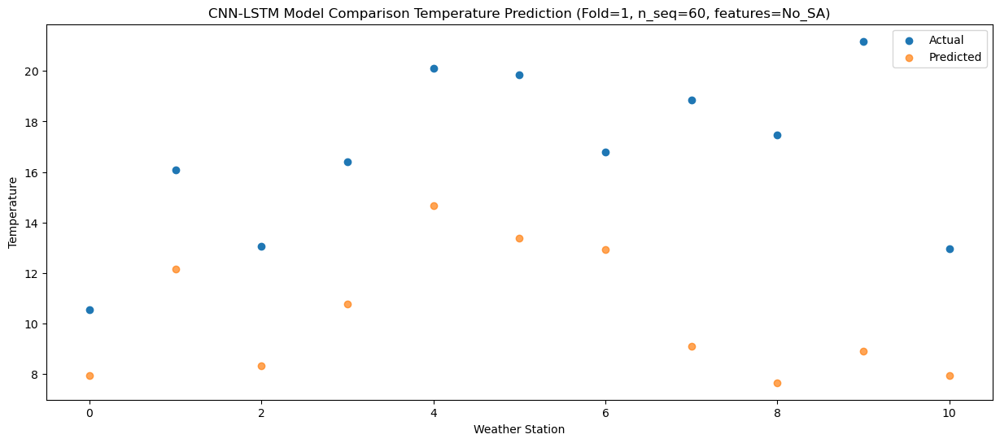

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.65   2.461957
1                 1   11.63   6.701910
2                 2    8.05   2.851932
3                 3   13.73   5.321882
4                 4   16.96   9.211885
5                 5   18.69   7.921822
6                 6   12.00   7.451916
7                 7   13.38   3.621536
8                 8   13.61   2.191507
9                 9   16.33   3.431571
10               10    8.09   2.461610


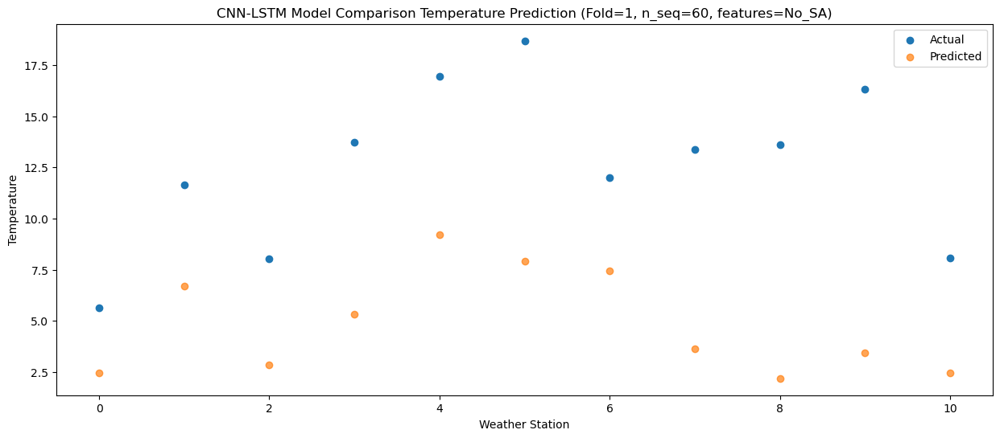

f, t:
[[-1.840e+00  3.520e+00 -1.480e+00  4.050e+00  8.110e+00  7.800e+00
   3.880e+00  9.200e-01  4.400e-01  4.680e+00 -1.560e+00]
 [-1.310e+00  2.610e+00 -1.050e+00  2.630e+00  6.220e+00  5.770e+00
   3.150e+00  3.000e-01 -1.410e+00  3.320e+00 -4.370e+00]
 [-1.420e+00  1.500e+00 -1.580e+00  3.380e+00  7.030e+00  5.110e+00
   2.340e+00 -5.500e-01 -1.230e+00  2.870e+00 -4.030e+00]
 [-1.560e+00  1.590e+00 -1.300e+00  2.850e+00  6.650e+00  4.590e+00
   2.410e+00  1.300e-01 -1.740e+00  1.630e+00 -3.290e+00]
 [ 3.500e+00  7.590e+00  5.800e+00  1.049e+01  1.469e+01  1.194e+01
   8.080e+00  7.050e+00  6.090e+00  9.590e+00  1.030e+00]
 [ 4.990e+00  8.810e+00  4.830e+00  1.037e+01  1.443e+01  1.473e+01
   9.710e+00  8.190e+00  7.470e+00  1.190e+01  2.660e+00]
 [ 8.070e+00  1.216e+01  8.980e+00  1.412e+01  1.823e+01  1.992e+01
   1.249e+01  1.269e+01  1.358e+01  1.843e+01  8.120e+00]
 [ 1.107e+01  1.651e+01  1.321e+01  1.690e+01  2.126e+01  2.264e+01
   1.716e+01  1.825e+01  1.869e+01  2.481e+0

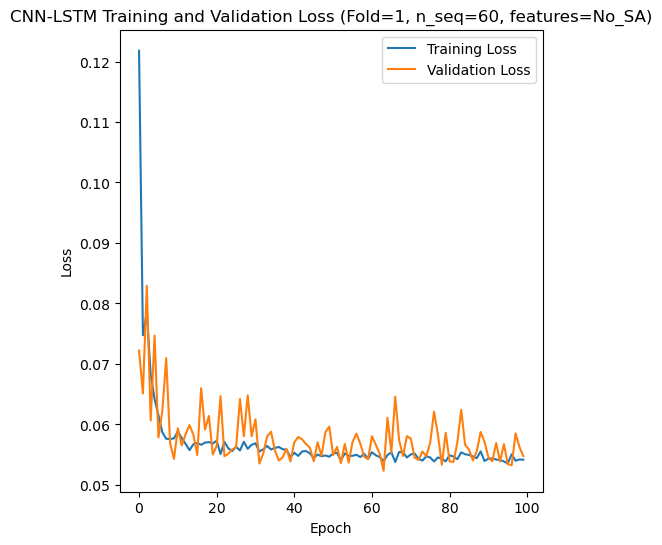

[[ 8.61  4.71 12.22 ... 22.49 18.22 13.52]
 [ 6.28  3.18  8.73 ... 22.36 17.39  7.52]
 [17.82 16.52 20.35 ... 28.79 25.32 22.93]
 ...
 [ 6.77  9.55 12.16 ... 24.55 20.29 10.24]
 [12.04 12.81 10.78 ... 23.32 20.33 13.93]
 [ 8.57  6.56 11.36 ... 21.36 16.14 12.65]]
Epoch 1/100
84/84 [==============================] - 34s 182ms/step - loss: 0.1182 - accuracy: 0.2619 - mae: 0.0974 - rmse: 0.1182 - mape: inf - pearson: 0.6425 - val_loss: 0.0739 - val_accuracy: 0.0000e+00 - val_mae: 0.0599 - val_rmse: 0.0739 - val_mape: 14.4439 - val_pearson: 0.8179
Epoch 2/100
84/84 [==============================] - 9s 105ms/step - loss: 0.0768 - accuracy: 0.4524 - mae: 0.0621 - rmse: 0.0768 - mape: inf - pearson: 0.8065 - val_loss: 0.0786 - val_accuracy: 0.6000 - val_mae: 0.0647 - val_rmse: 0.0786 - val_mape: 14.2182 - val_pearson: 0.9036
Epoch 3/100
84/84 [==============================] - 10s 115ms/step - loss: 0.0734 - accuracy: 0.5000 - mae: 0.0589 - rmse: 0.0734 - mape: inf - pearson: 0.8136 - val_lo

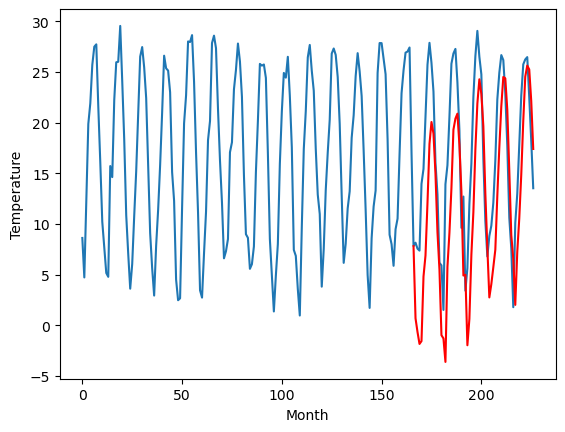

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.41		0.72		-2.69
1.13		-0.64		-1.77
0.89		-1.82		-2.71
0.16		-1.54		-1.70
8.17		4.84		-3.33
10.40		6.92		-3.48
17.20		12.11		-5.09
24.40		17.94		-6.46
24.43		20.10		-4.33
23.10		18.96		-4.14
16.97		14.99		-1.98
9.98		9.23		-0.75
6.86		5.52		-1.34
0.23		-0.95		-1.18
0.15		-1.27		-1.42
-3.89		-3.59		0.30
6.30		5.80		-0.50
10.06		9.17		-0.89
15.24		13.57		-1.67
22.49		19.34		-3.15
23.18		20.44		-2.74
23.94		20.93		-3.01
21.70		17.87		-3.83
13.44		13.24		-0.20
6.73		4.94		-1.79
4.34		5.01		0.67
-0.35		-1.95		-1.60
-0.36		0.65		1.01
6.62		7.00		0.38
13.30		11.21		-2.09
19.10		17.39		-1.71
22.90		21.93		-0.97
26.14		24.32		-1.82
23.83		22.86		-0.97
21.07		19.68		-1.39
12.69		13.01		0.32
2.70		7.69		4.99
-0.01		2.78		2.79
-0.26		4.10		4.36
1.34		5.77		4.43
5.41		7.49		2.08
11.27		12.84		1.57
16.76		17.57		0.81
19.37		21.65		2.28
23.47		24.55		1.08
23.96		24.42		0.46
21.09		21.30		0.21
12.05		15.32	

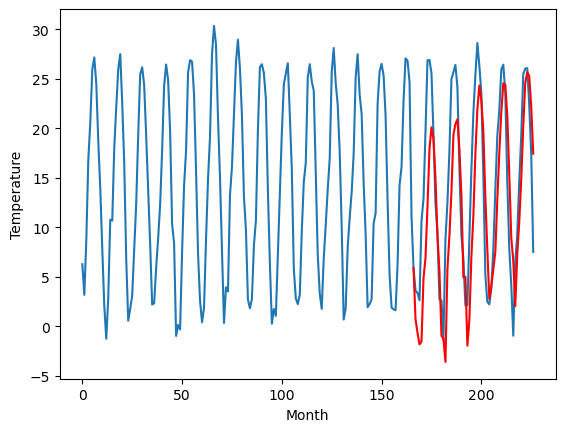

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.10		-1.61		-1.51
-1.22		-2.97		-1.75
-2.37		-4.15		-1.78
-1.33		-3.86		-2.53
2.29		2.51		0.22
3.68		4.59		0.91
4.99		9.78		4.79
7.58		15.61		8.03
8.22		17.77		9.55
7.91		16.63		8.72
6.65		12.66		6.01
5.38		6.90		1.52
1.96		3.19		1.23
-5.03		-3.28		1.75
-4.37		-3.60		0.77
-1.64		-5.92		-4.28
0.17		3.47		3.30
1.98		6.84		4.86
5.56		11.24		5.68
6.78		17.01		10.23
7.57		18.10		10.53
7.62		18.60		10.98
6.34		15.54		9.20
5.20		10.91		5.71
-1.65		2.61		4.26
-0.75		2.68		3.43
-5.01		-4.28		0.73
-2.68		-1.68		1.00
0.79		4.67		3.88
2.60		8.88		6.28
5.36		15.06		9.70
7.17		19.59		12.42
7.35		21.99		14.64
6.78		20.53		13.75
5.37		17.35		11.98
2.74		10.68		7.94
0.98		5.36		4.38
-3.12		0.45		3.57
-3.32		1.77		5.09
-0.26		3.44		3.70
0.76		5.16		4.40
3.30		10.51		7.21
4.28		15.24		10.96
6.69		19.32		12.63
8.60		22.22		13.62
8.78		22.09		13.31
6.83		18.97		12.14
3.25		12.99		9.74
-0.73		6.61		7.34
-2.66		4

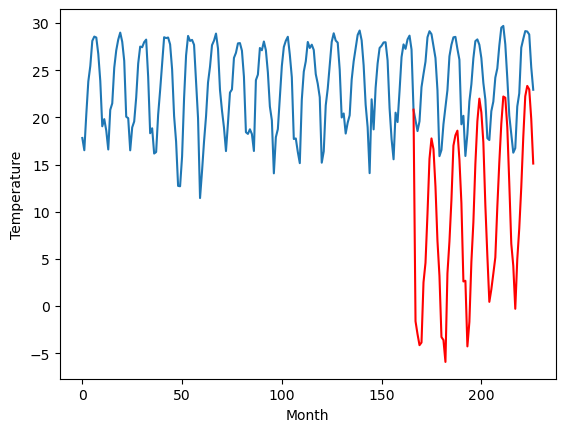

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.24		9.93		0.69
6.18		8.57		2.39
6.45		7.39		0.94
6.60		7.68		1.08
10.15		14.05		3.90
11.38		16.13		4.75
17.27		21.32		4.05
23.33		27.15		3.82
27.61		29.31		1.70
25.76		28.17		2.41
21.18		24.20		3.02
15.96		18.44		2.48
12.00		14.73		2.73
5.17		8.26		3.09
2.09		7.94		5.85
2.11		5.62		3.51
6.22		15.01		8.79
10.72		18.38		7.66
15.98		22.78		6.80
21.55		28.55		7.00
23.55		29.64		6.09
24.61		30.14		5.53
21.44		27.08		5.64
17.61		22.45		4.84
9.53		14.15		4.62
7.61		14.22		6.61
1.46		7.26		5.80
3.78		9.86		6.08
7.64		16.21		8.57
12.08		20.42		8.34
17.42		26.60		9.18
21.66		31.13		9.47
26.28		33.53		7.25
26.20		32.07		5.87
21.16		28.89		7.73
15.72		22.22		6.50
11.92		16.90		4.98
5.75		11.99		6.24
7.04		13.31		6.27
5.16		14.98		9.82
7.60		16.70		9.10
13.32		22.05		8.73
16.95		26.78		9.83
20.74		30.86		10.12
26.31		33.76		7.45
24.30		33.63		9.33
21.88		30.51		8.63
16.86		24.53		7.67
8.88		18.15		9.27


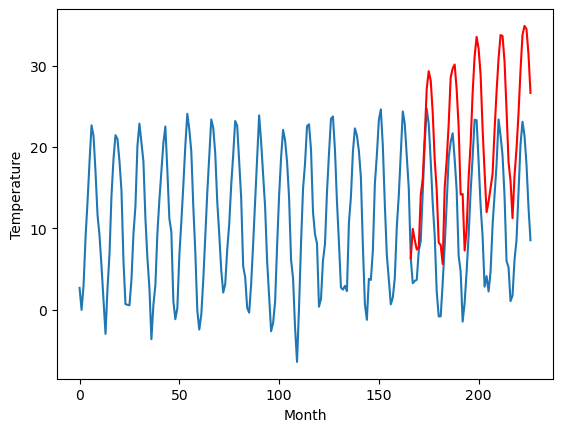

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.25		-5.21		1.04
-5.90		-6.57		-0.67
-5.56		-7.75		-2.19
-4.92		-7.46		-2.54
1.77		-1.09		-2.86
1.24		0.99		-0.25
4.21		6.18		1.97
7.25		12.01		4.76
7.99		14.17		6.18
8.36		13.03		4.67
6.01		9.06		3.05
2.32		3.30		0.98
-1.80		-0.41		1.39
-8.10		-6.88		1.22
-7.75		-7.20		0.55
-8.49		-9.52		-1.03
-1.16		-0.13		1.03
-0.29		3.24		3.53
4.18		7.64		3.46
7.66		13.41		5.75
8.25		14.50		6.25
8.42		15.00		6.58
5.88		11.94		6.06
3.14		7.31		4.17
-5.13		-0.99		4.14
-1.72		-0.92		0.80
-9.45		-7.88		1.57
-6.31		-5.28		1.03
-2.55		1.07		3.62
1.25		5.28		4.03
6.41		11.46		5.05
9.00		15.99		6.99
8.83		18.39		9.56
8.01		16.93		8.92
6.04		13.75		7.71
-0.15		7.08		7.23
-3.22		1.76		4.98
-5.73		-3.15		2.58
-4.56		-1.83		2.73
-2.43		-0.16		2.27
-0.60		1.56		2.16
1.32		6.91		5.59
5.35		11.64		6.29
9.00		15.72		6.72
10.44		18.62		8.18
11.74		18.49		6.75
7.31		15.37		8.06
1.15		9.39		8.24
-3.96		3.01		6.97
-6.56		0

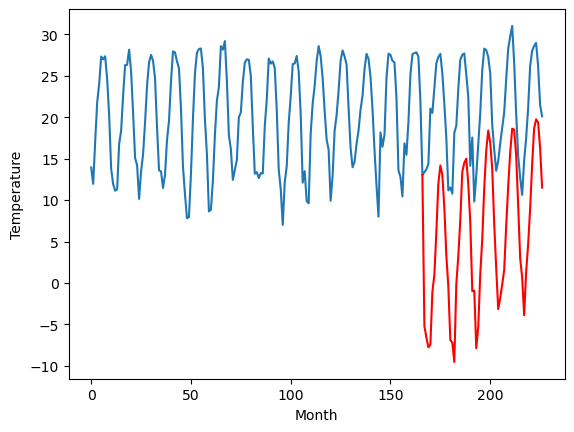

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.27		6.05		-1.22
5.84		4.69		-1.15
6.21		3.51		-2.70
5.45		3.80		-1.65
13.54		10.17		-3.37
13.51		12.25		-1.26
17.35		17.44		0.09
20.96		23.27		2.31
22.66		25.43		2.77
22.96		24.29		1.33
18.56		20.32		1.76
14.09		14.56		0.47
11.41		10.85		-0.56
5.30		4.38		-0.92
4.71		4.06		-0.65
2.36		1.74		-0.62
10.74		11.13		0.39
12.86		14.50		1.64
16.90		18.90		2.00
21.45		24.67		3.22
21.53		25.76		4.23
22.64		26.26		3.62
19.90		23.20		3.30
16.60		18.57		1.97
8.96		10.27		1.31
12.20		10.34		-1.86
3.77		3.38		-0.39
3.39		5.98		2.59
9.51		12.33		2.82
15.66		16.54		0.88
20.26		22.72		2.46
23.98		27.25		3.27
25.34		29.65		4.31
22.62		28.19		5.57
19.96		25.01		5.05
14.39		18.34		3.95
8.51		13.02		4.51
6.28		8.11		1.83
7.04		9.43		2.39
8.23		11.10		2.87
12.03		12.82		0.79
12.95		18.17		5.22
18.03		22.90		4.87
22.95		26.98		4.03
25.11		29.88		4.77
26.81		29.75		2.94
22.33		26.63		4.30
14.44		20.65		6.21
8.16		1

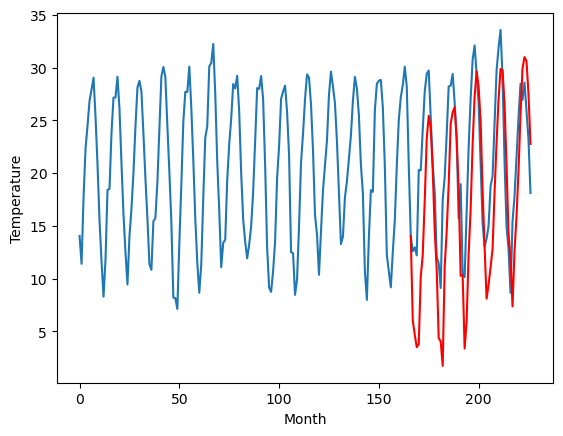

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.65		6.16		-0.49
4.84		4.80		-0.04
5.19		3.62		-1.57
4.63		3.91		-0.72
12.28		10.28		-2.00
12.59		12.36		-0.23
17.49		17.55		0.06
22.23		23.38		1.15
23.41		25.54		2.13
23.64		24.40		0.76
17.70		20.43		2.73
12.22		14.67		2.45
9.73		10.96		1.23
3.27		4.49		1.22
2.57		4.17		1.60
-0.54		1.85		2.39
9.83		11.24		1.41
11.53		14.61		3.08
15.61		19.01		3.40
21.17		24.78		3.61
22.06		25.87		3.81
22.62		26.37		3.75
20.35		23.31		2.96
15.84		18.68		2.84
7.87		10.38		2.51
10.16		10.45		0.29
1.68		3.49		1.81
1.51		6.09		4.58
8.09		12.44		4.35
14.36		16.65		2.29
19.38		22.83		3.45
24.09		27.36		3.27
26.88		29.76		2.88
24.07		28.30		4.23
20.24		25.12		4.88
13.86		18.45		4.59
7.19		13.13		5.94
4.57		8.22		3.65
5.45		9.54		4.09
5.64		11.21		5.57
10.29		12.93		2.64
12.11		18.28		6.17
17.85		23.01		5.16
22.00		27.09		5.09
24.56		29.99		5.43
26.90		29.86		2.96
22.12		26.74		4.62
13.40		20.76		7.36
8.06		14.38		6

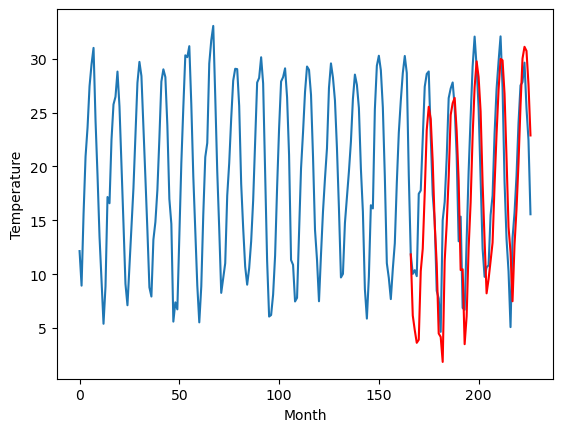

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.03		4.25		-1.78
1.50		2.89		1.39
2.75		1.71		-1.04
3.56		2.00		-1.56
8.06		8.37		0.31
13.04		10.45		-2.59
19.33		15.64		-3.69
22.85		21.47		-1.38
24.95		23.63		-1.32
25.39		22.49		-2.90
19.14		18.52		-0.62
13.54		12.76		-0.78
7.98		9.05		1.07
0.33		2.58		2.25
0.87		2.26		1.39
3.79		-0.06		-3.85
6.89		9.33		2.44
13.55		12.70		-0.85
18.56		17.10		-1.46
23.55		22.87		-0.68
22.35		23.96		1.61
21.83		24.46		2.63
19.65		21.40		1.75
13.09		16.77		3.68
7.69		8.47		0.78
4.34		8.54		4.20
1.34		1.58		0.24
2.31		4.18		1.87
7.37		10.53		3.16
14.56		14.74		0.18
19.26		20.92		1.66
23.12		25.45		2.33
24.26		27.85		3.59
21.24		26.39		5.15
19.51		23.21		3.70
11.30		16.54		5.24
4.41		11.22		6.81
2.24		6.31		4.07
1.53		7.63		6.10
2.74		9.30		6.56
7.44		11.02		3.58
13.08		16.37		3.29
17.73		21.10		3.37
22.39		25.18		2.79
27.14		28.08		0.94
24.14		27.95		3.81
21.48		24.83		3.35
14.74		18.85		4.11
7.63		12.47		4.

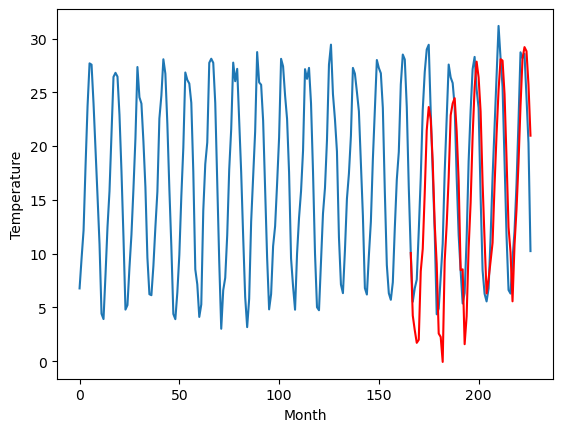

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.17		-1.12		-3.29
-1.37		-2.48		-1.11
-0.83		-3.66		-2.83
1.28		-3.37		-4.65
1.35		3.00		1.65
4.56		5.08		0.52
8.61		10.27		1.66
9.90		16.10		6.20
12.31		18.26		5.95
14.71		17.12		2.41
13.11		13.15		0.04
9.87		7.39		-2.48
3.15		3.68		0.53
1.10		-2.79		-3.89
1.04		-3.11		-4.15
0.12		-5.43		-5.55
-0.28		3.96		4.24
3.58		7.33		3.75
5.80		11.73		5.93
10.04		17.50		7.46
13.02		18.59		5.57
12.62		19.09		6.47
10.84		16.03		5.19
5.86		11.40		5.54
4.60		3.10		-1.50
-1.91		3.17		5.08
0.50		-3.79		-4.29
1.37		-1.19		-2.56
3.16		5.16		2.00
5.28		9.37		4.09
6.24		15.55		9.31
11.16		20.08		8.92
11.97		22.48		10.51
14.01		21.02		7.01
13.60		17.84		4.24
7.33		11.17		3.84
1.10		5.85		4.75
-1.60		0.94		2.54
-1.94		2.26		4.20
-2.26		3.93		6.19
-1.25		5.65		6.90
2.59		11.00		8.41
3.80		15.73		11.93
5.76		19.81		14.05
12.68		22.71		10.03
12.31		22.58		10.27
8.81		19.46		10.65
7.22		13.48		6.26
2.83		7.10		4.27
0

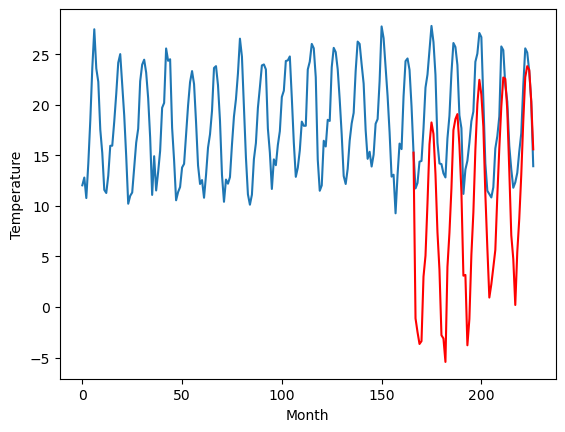

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.04		4.15		2.11
1.63		2.79		1.16
1.34		1.61		0.27
2.38		1.90		-0.48
7.61		8.27		0.66
8.91		10.35		1.44
11.51		15.54		4.03
16.80		21.37		4.57
19.79		23.53		3.74
18.79		22.39		3.60
14.76		18.42		3.66
10.84		12.66		1.82
6.23		8.95		2.72
-0.77		2.48		3.25
-1.18		2.16		3.34
-0.68		-0.16		0.52
6.20		9.23		3.03
8.99		12.60		3.61
13.01		17.00		3.99
17.30		22.77		5.47
18.87		23.86		4.99
18.96		24.36		5.40
14.85		21.30		6.45
11.57		16.67		5.10
2.66		8.37		5.71
4.58		8.44		3.86
-1.90		1.48		3.38
2.12		4.08		1.96
6.23		10.43		4.20
9.52		14.64		5.12
14.37		20.82		6.45
18.13		25.35		7.22
19.57		27.75		8.18
18.19		26.29		8.10
14.88		23.11		8.23
7.57		16.44		8.87
5.45		11.12		5.67
-1.08		6.21		7.29
2.12		7.53		5.41
5.14		9.20		4.06
5.59		10.92		5.33
9.11		16.27		7.16
11.89		21.00		9.11
15.55		25.08		9.53
19.14		27.98		8.84
18.59		27.85		9.26
14.63		24.73		10.10
9.34		18.75		9.41
3.44		12.37		8.93
0.97		10.

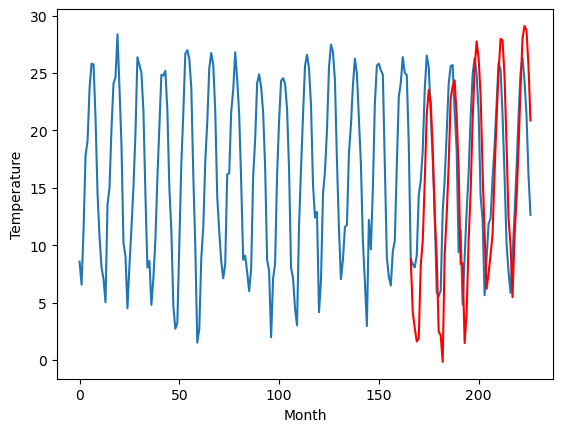

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.92		0.68		2.60
-1.32		-0.68		0.64
-1.76		-1.86		-0.10
-1.96		-1.57		0.39
4.08		4.80		0.72
4.51		6.88		2.37
8.55		12.07		3.52
13.92		17.90		3.98
17.21		20.06		2.85
15.95		18.92		2.97
12.00		14.95		2.95
7.34		9.19		1.85
2.29		5.48		3.19
-4.77		-0.99		3.78
-4.44		-1.31		3.13
-3.09		-3.63		-0.54
3.12		5.76		2.64
5.09		9.13		4.04
10.00		13.53		3.53
15.41		19.30		3.89
16.72		20.39		3.67
16.80		20.89		4.09
12.31		17.83		5.52
8.55		13.20		4.65
-1.67		4.90		6.57
0.43		4.97		4.54
-6.44		-1.99		4.45
-1.85		0.61		2.46
2.70		6.96		4.26
5.86		11.17		5.31
12.10		17.35		5.25
15.75		21.88		6.13
17.10		24.28		7.18
15.85		22.82		6.97
11.70		19.64		7.94
4.42		12.97		8.55
1.97		7.65		5.68
-3.49		2.74		6.23
-1.57		4.06		5.63
1.22		5.73		4.51
1.75		7.45		5.70
6.64		12.80		6.16
9.99		17.53		7.54
12.90		21.61		8.71
16.45		24.51		8.06
15.74		24.38		8.64
12.96		21.26		8.30
6.91		15.28		8.37
0.70		8.90		8.20
-2.15		

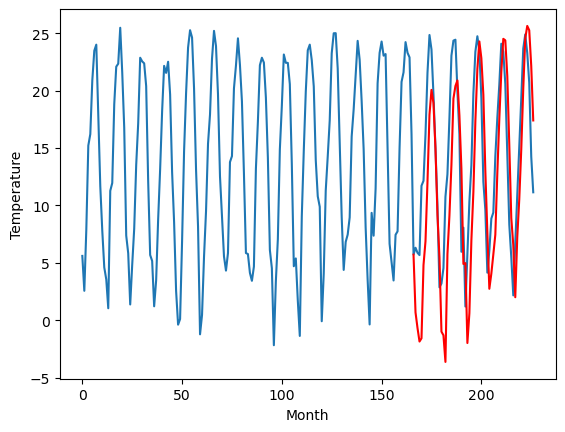

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.65   0.677525
1                 1    3.41   0.717524
2                 2   -0.10  -1.612469
3                 3    9.24   9.927524
4                 4   -6.25  -5.212470
5                 5    7.27   6.047525
6                 6    6.65   6.157525
7                 7    6.03   4.247529
8                 8    2.17  -1.122471
9                 9    2.04   4.147527
10               10   -1.92   0.677527


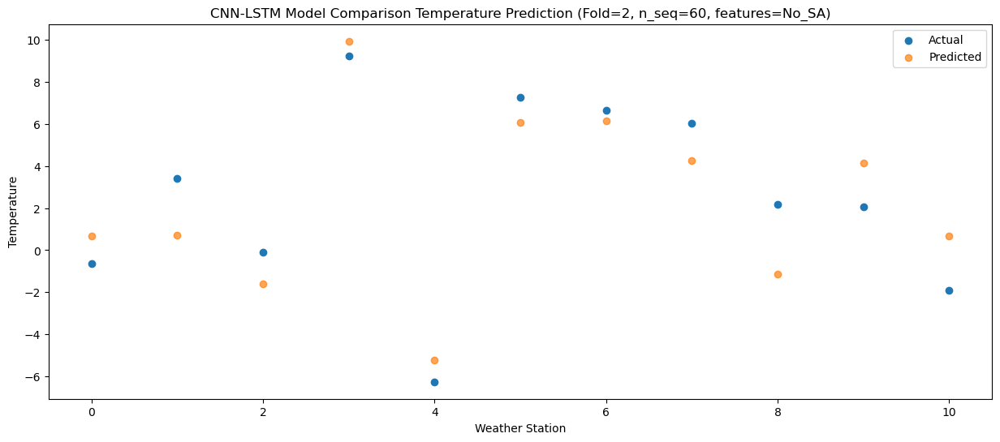

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.31  -0.681380
1                 1    1.13  -0.641418
2                 2   -1.22  -2.971343
3                 3    6.18   8.568645
4                 4   -5.90  -6.571355
5                 5    5.84   4.688634
6                 6    4.84   4.798610
7                 7    1.50   2.888606
8                 8   -1.37  -2.481384
9                 9    1.63   2.788646
10               10   -1.32  -0.681348


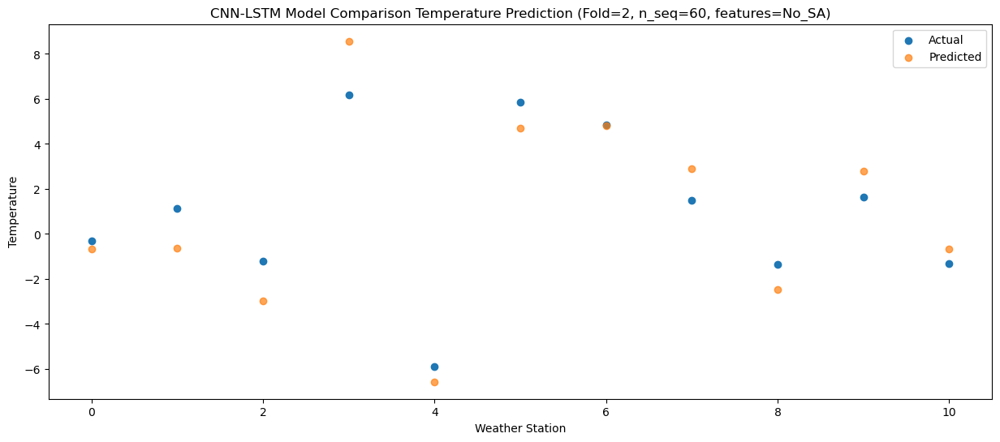

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.90  -1.858061
1                 1    0.89  -1.818109
2                 2   -2.37  -4.148004
3                 3    6.45   7.391981
4                 4   -5.56  -7.748025
5                 5    6.21   3.511967
6                 6    5.19   3.621933
7                 7    2.75   1.711933
8                 8   -0.83  -3.658057
9                 9    1.34   1.611980
10               10   -1.76  -1.858008


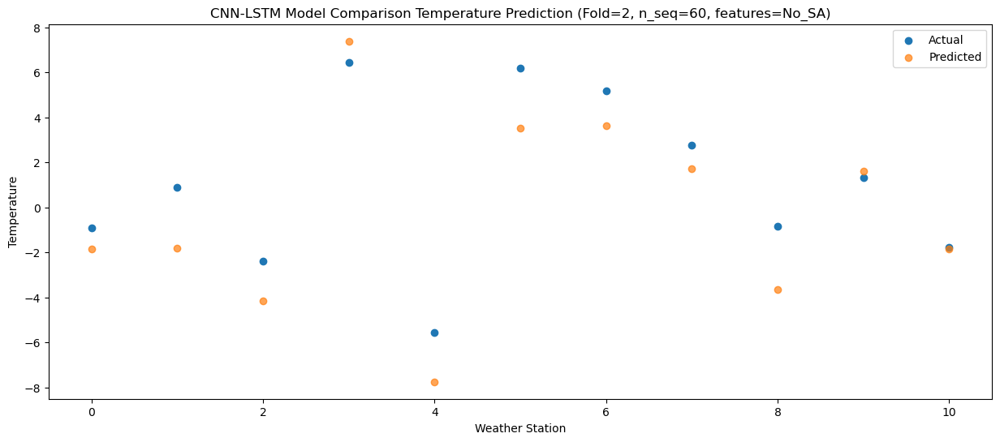

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -1.574982
1                 1    0.16  -1.535014
2                 2   -1.33  -3.864953
3                 3    6.60   7.675035
4                 4   -4.92  -7.464970
5                 5    5.45   3.795030
6                 6    4.63   3.905010
7                 7    3.56   1.995008
8                 8    1.28  -3.374986
9                 9    2.38   1.895033
10               10   -1.96  -1.574957


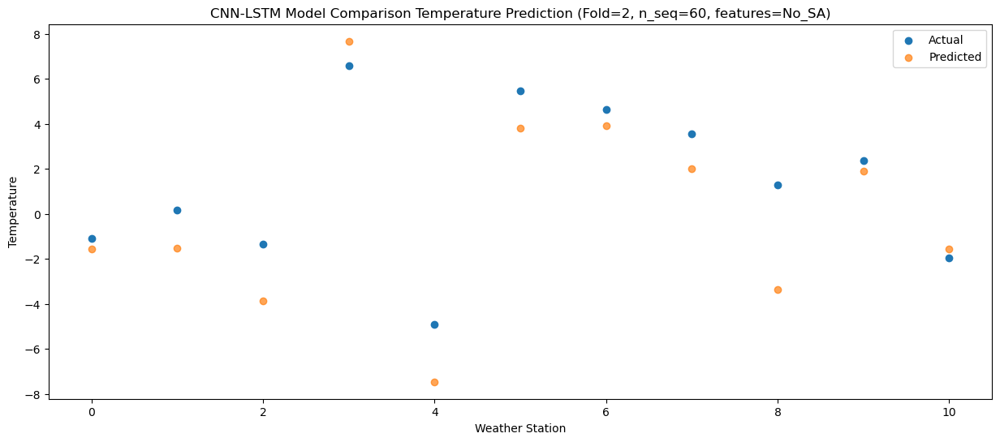

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    5.50   4.798964
1                 1    8.17   4.838924
2                 2    2.29   2.509003
3                 3   10.15  14.048994
4                 4    1.77  -1.091018
5                 5   13.54  10.168979
6                 6   12.28  10.278956
7                 7    8.06   8.368948
8                 8    1.35   2.998960
9                 9    7.61   8.268987
10               10    4.08   4.799001


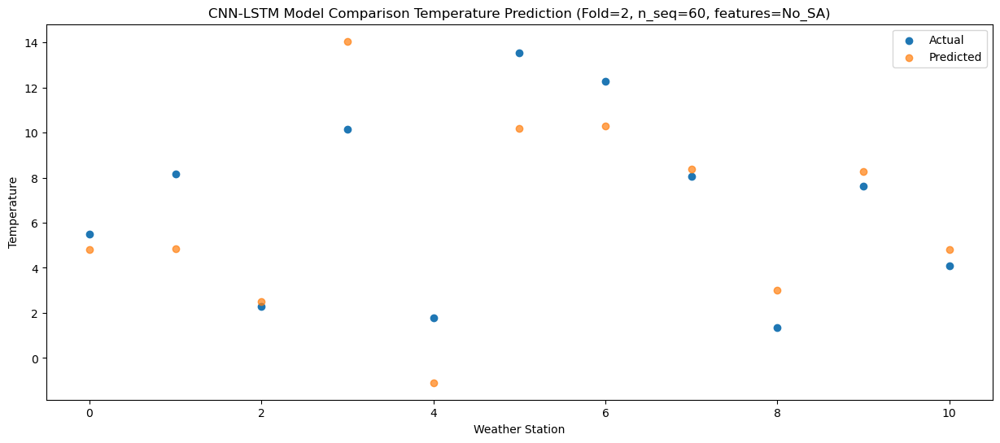

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.98   6.876543
1                 1   10.40   6.916532
2                 2    3.68   4.586550
3                 3   11.38  16.126548
4                 4    1.24   0.986539
5                 5   13.51  12.246544
6                 6   12.59  12.356539
7                 7   13.04  10.446533
8                 8    4.56   5.076539
9                 9    8.91  10.346543
10               10    4.51   6.876553


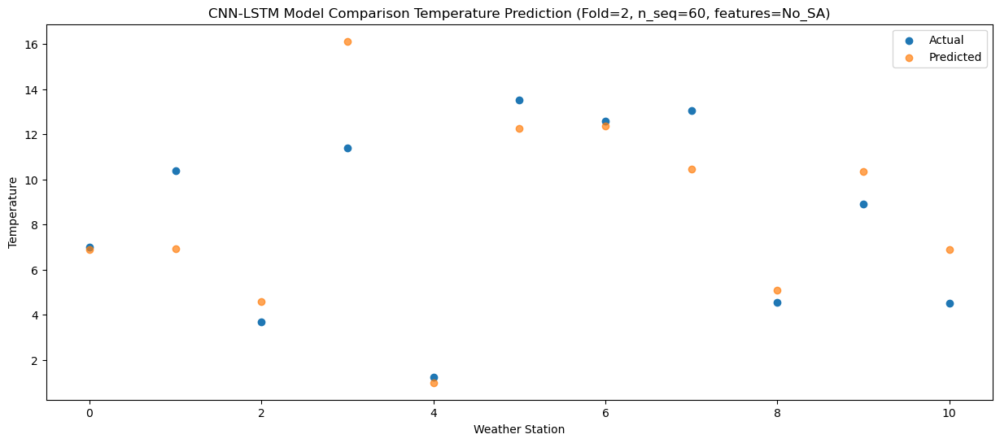

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.27  12.071343
1                 1   17.20  12.111362
2                 2    4.99   9.781317
3                 3   17.27  21.321330
4                 4    4.21   6.181318
5                 5   17.35  17.441335
6                 6   17.49  17.551349
7                 7   19.33  15.641343
8                 8    8.61  10.271341
9                 9   11.51  15.541321
10               10    8.55  12.071327


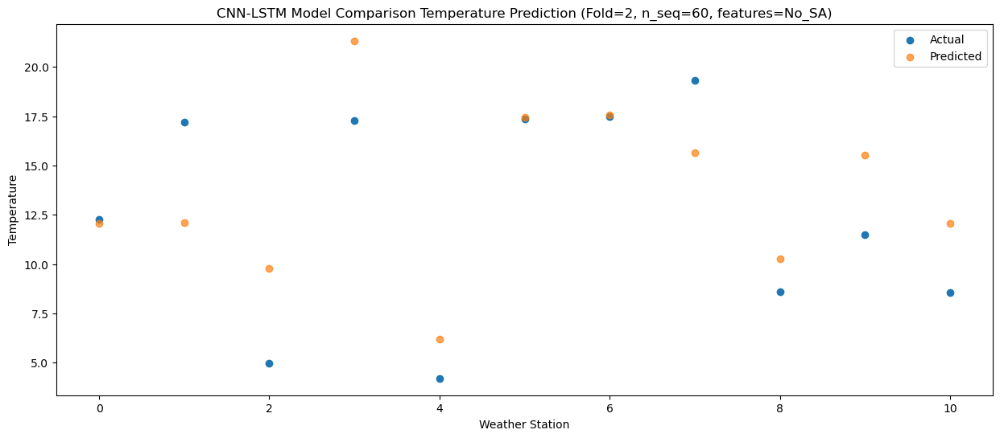

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.27  17.901442
1                 1   24.40  17.941478
2                 2    7.58  15.611395
3                 3   23.33  27.151411
4                 4    7.25  12.011403
5                 5   20.96  23.271424
6                 6   22.23  23.381454
7                 7   22.85  21.471443
8                 8    9.90  16.101436
9                 9   16.80  21.371398
10               10   13.92  17.901408


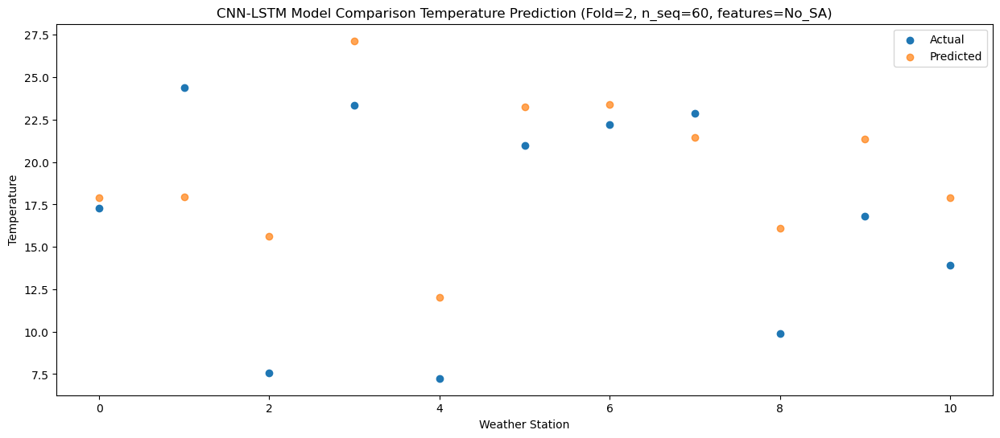

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   19.43  20.060437
1                 1   24.43  20.100458
2                 2    8.22  17.770395
3                 3   27.61  29.310407
4                 4    7.99  14.170397
5                 5   22.66  25.430416
6                 6   23.41  25.540442
7                 7   24.95  23.630432
8                 8   12.31  18.260428
9                 9   19.79  23.530392
10               10   17.21  20.060400


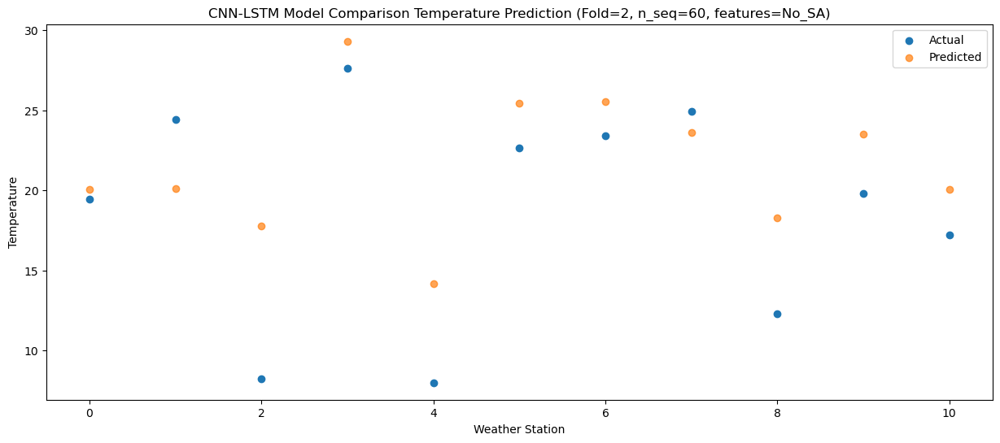

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.45  18.921293
1                 1   23.10  18.961322
2                 2    7.91  16.631246
3                 3   25.76  28.171265
4                 4    8.36  13.031248
5                 5   22.96  24.291272
6                 6   23.64  24.401299
7                 7   25.39  22.491289
8                 8   14.71  17.121281
9                 9   18.79  22.391248
10               10   15.95  18.921256


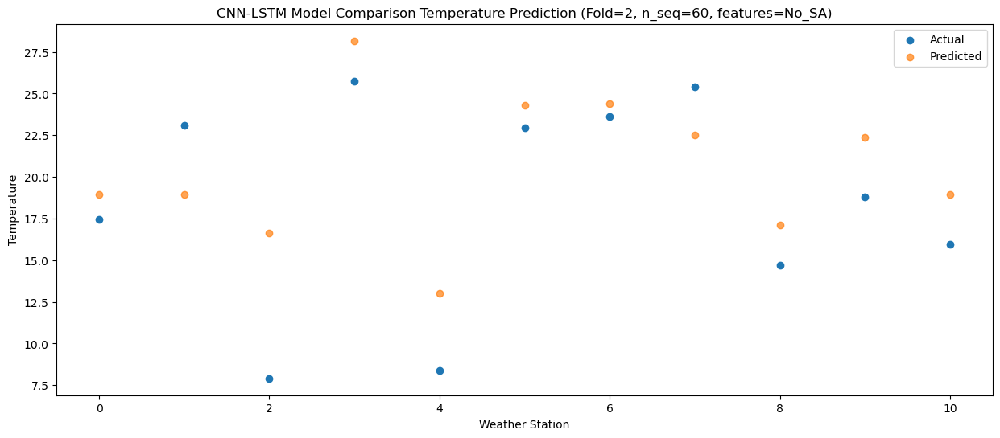

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.61  14.952261
1                 1   16.97  14.992319
2                 2    6.65  12.662180
3                 3   21.18  24.202213
4                 4    6.01   9.062192
5                 5   18.56  20.322225
6                 6   17.70  20.432269
7                 7   19.14  18.522262
8                 8   13.11  13.152248
9                 9   14.76  18.422192
10               10   12.00  14.952198


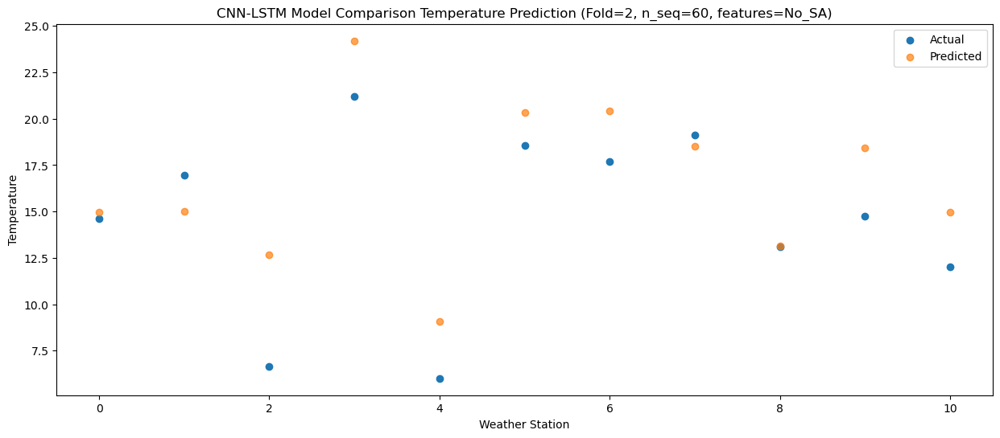

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.60   9.191902
1                 1    9.98   9.231974
2                 2    5.38   6.901805
3                 3   15.96  18.441840
4                 4    2.32   3.301822
5                 5   14.09  14.561862
6                 6   12.22  14.671913
7                 7   13.54  12.761907
8                 8    9.87   7.391887
9                 9   10.84  12.661821
10               10    7.34   9.191824


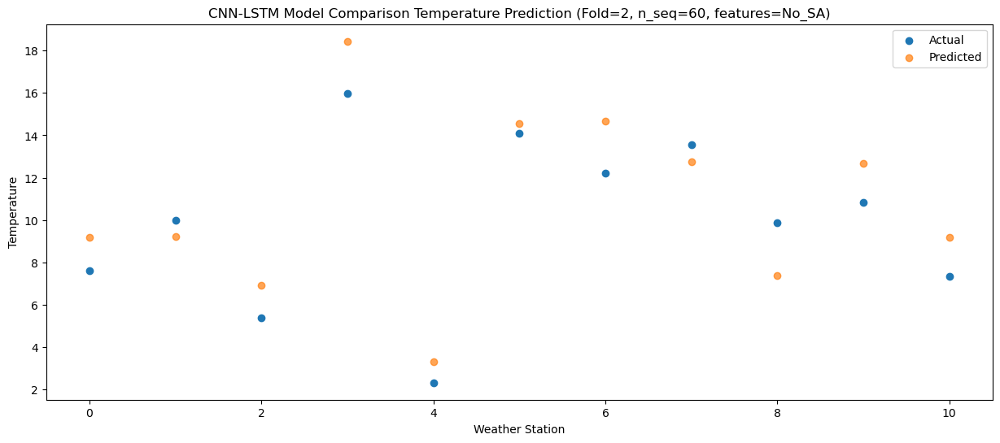

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.47   5.478917
1                 1    6.86   5.519030
2                 2    1.96   3.188763
3                 3   12.00  14.728821
4                 4   -1.80  -0.411201
5                 5   11.41  10.848853
6                 6    9.73  10.958936
7                 7    7.98   9.048919
8                 8    3.15   3.678892
9                 9    6.23   8.948795
10               10    2.29   5.478793


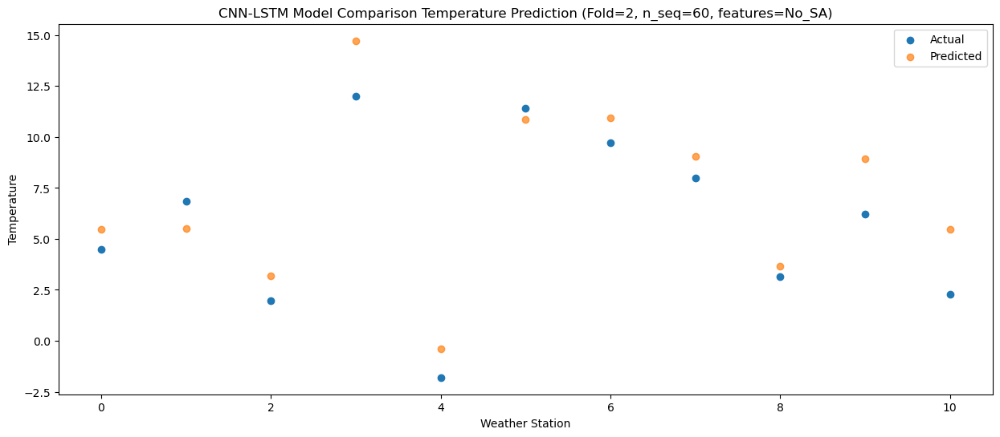

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.29  -0.993882
1                 1    0.23  -0.953726
2                 2   -5.03  -3.284083
3                 3    5.17   8.255993
4                 4   -8.10  -6.884030
5                 5    5.30   4.376035
6                 6    3.27   4.486146
7                 7    0.33   2.576127
8                 8    1.10  -2.793910
9                 9   -0.77   2.475963
10               10   -4.77  -0.994039


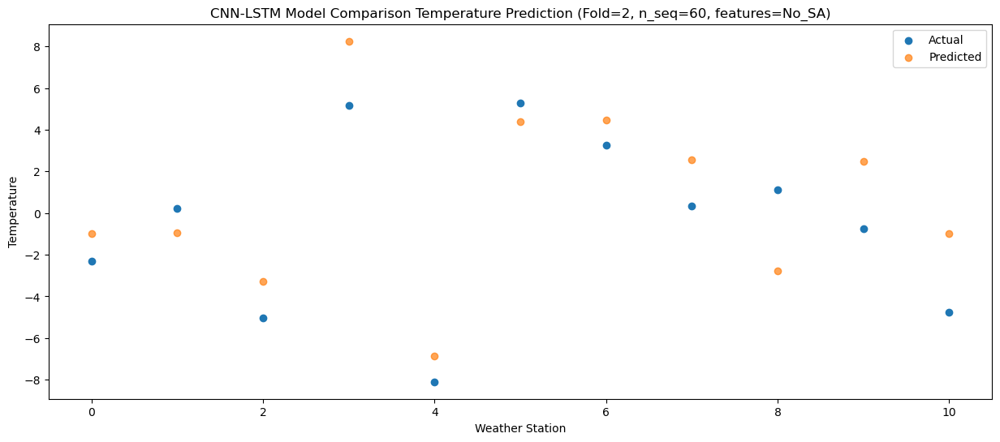

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -1.313314
1                 1    0.15  -1.273141
2                 2   -4.37  -3.603535
3                 3    2.09   7.936542
4                 4   -7.75  -7.203475
5                 5    4.71   4.056592
6                 6    2.57   4.166715
7                 7    0.87   2.256696
8                 8    1.04  -3.113341
9                 9   -1.18   2.156512
10               10   -4.44  -1.313486


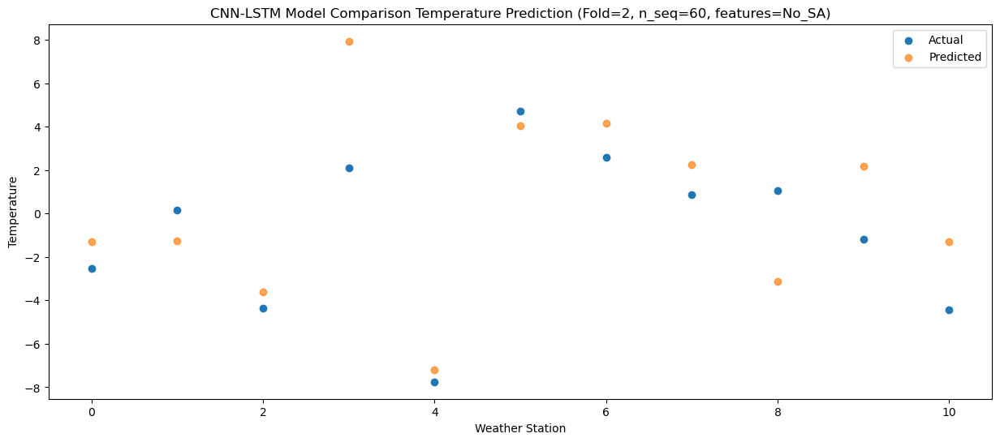

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -6.95  -3.633117
1                 1   -3.89  -3.592919
2                 2   -1.64  -5.923354
3                 3    2.11   5.616730
4                 4   -8.49  -9.523286
5                 5    2.36   1.736787
6                 6   -0.54   1.846918
7                 7    3.79  -0.063101
8                 8    0.12  -5.433144
9                 9   -0.68  -0.163303
10               10   -3.09  -3.633301


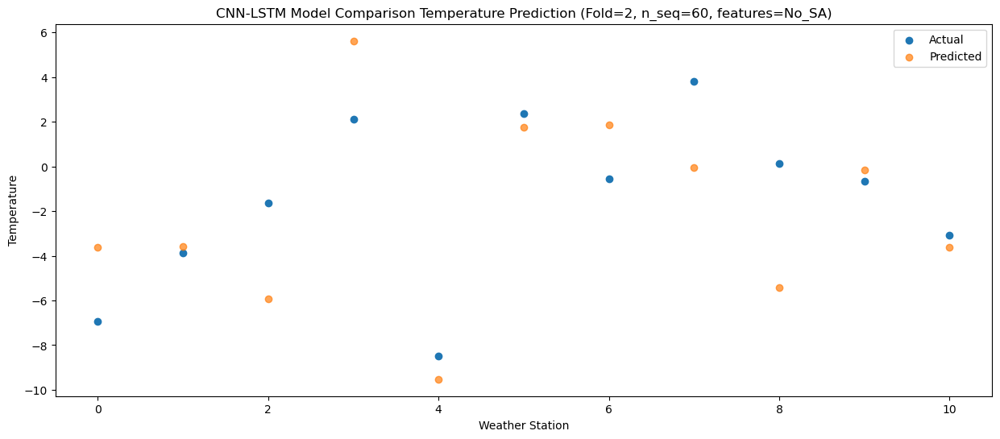

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.47   5.762990
1                 1    6.30   5.803192
2                 2    0.17   3.472761
3                 3    6.22  15.012844
4                 4   -1.16  -0.127168
5                 5   10.74  11.132901
6                 6    9.83  11.243025
7                 7    6.89   9.333006
8                 8   -0.28   3.962963
9                 9    6.20   9.232812
10               10    3.12   5.762810


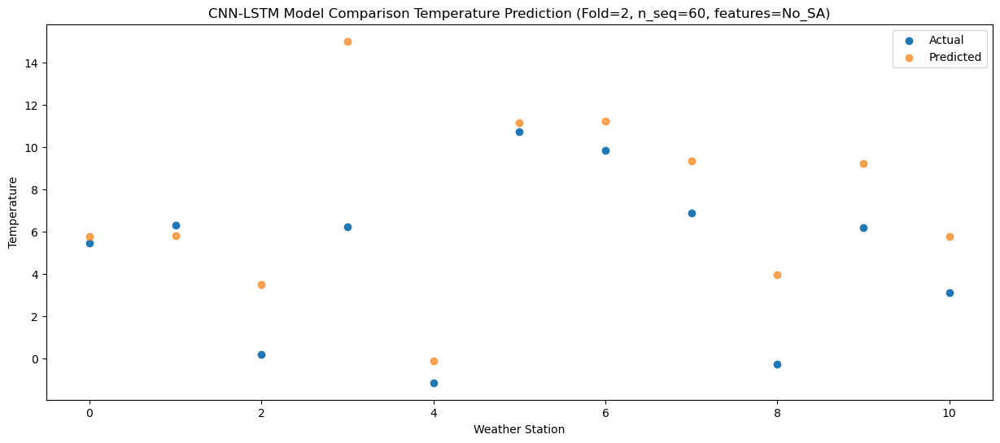

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.34   9.128410
1                 1   10.06   9.168578
2                 2    1.98   6.838218
3                 3   10.72  18.378289
4                 4   -0.29   3.238277
5                 5   12.86  14.498335
6                 6   11.53  14.608435
7                 7   13.55  12.698416
8                 8    3.58   7.328381
9                 9    8.99  12.598259
10               10    5.09   9.128261


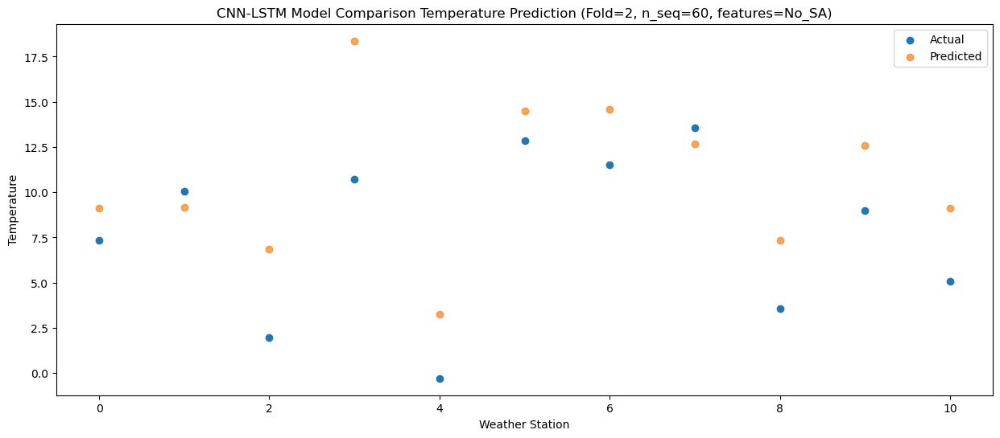

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   12.12  13.533986
1                 1   15.24  13.574196
2                 2    5.56  11.243747
3                 3   15.98  22.783834
4                 4    4.18   7.643824
5                 5   16.90  18.903894
6                 6   15.61  19.014017
7                 7   18.56  17.103999
8                 8    5.80  11.733955
9                 9   13.01  17.003808
10               10   10.00  13.533802


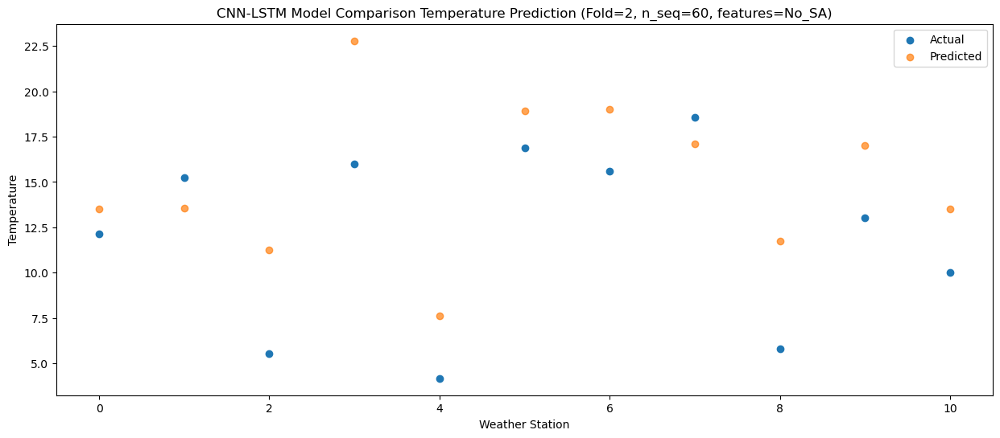

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   17.37  19.302839
1                 1   22.49  19.343060
2                 2    6.78  17.012590
3                 3   21.55  28.552683
4                 4    7.66  13.412665
5                 5   21.45  24.672739
6                 6   21.17  24.782870
7                 7   23.55  22.872858
8                 8   10.04  17.502806
9                 9   17.30  22.772656
10               10   15.41  19.302647


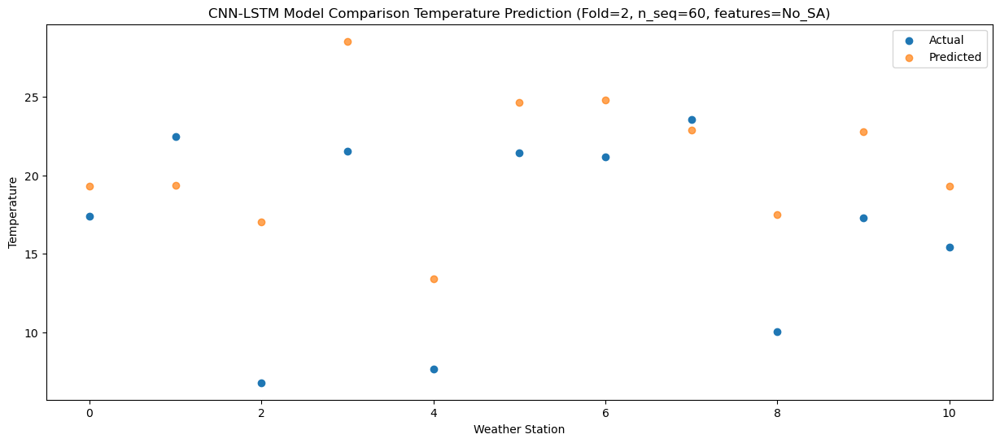

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   18.38  20.394870
1                 1   23.18  20.435103
2                 2    7.57  18.104613
3                 3   23.55  29.644710
4                 4    8.25  14.504692
5                 5   21.53  25.764765
6                 6   22.06  25.874904
7                 7   22.35  23.964889
8                 8   13.02  18.594840
9                 9   18.87  23.864677
10               10   16.72  20.394668


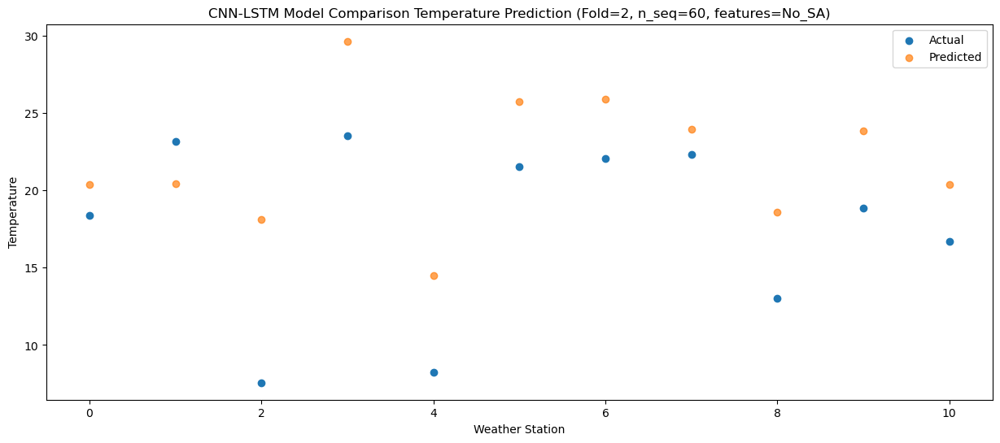

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.83  20.886676
1                 1   23.94  20.926926
2                 2    7.62  18.596405
3                 3   24.61  30.136506
4                 4    8.42  14.996490
5                 5   22.64  26.256570
6                 6   22.62  26.366712
7                 7   21.83  24.456703
8                 8   12.62  19.086650
9                 9   18.96  24.356471
10               10   16.80  20.886458


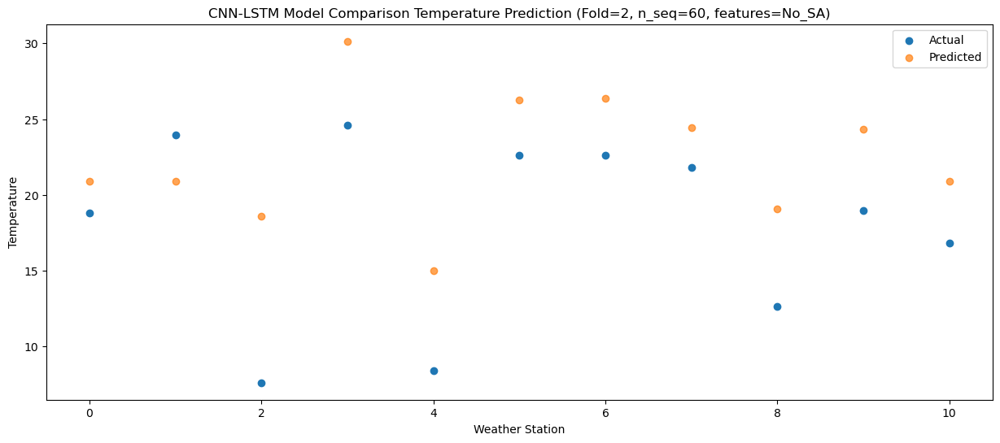

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   15.53  17.827336
1                 1   21.70  17.867606
2                 2    6.34  15.537055
3                 3   21.44  27.077152
4                 4    5.88  11.937145
5                 5   19.90  23.197222
6                 6   20.35  23.307376
7                 7   19.65  21.397376
8                 8   10.84  16.027319
9                 9   14.85  21.297117
10               10   12.31  17.827105


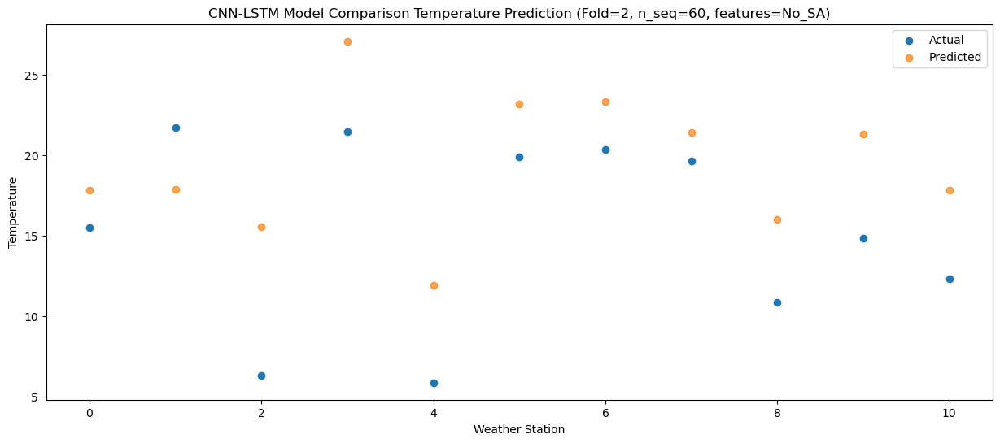

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.78  13.201267
1                 1   13.44  13.241596
2                 2    5.20  10.910924
3                 3   17.61  22.451035
4                 4    3.14   7.311040
5                 5   16.60  18.571129
6                 6   15.84  18.681319
7                 7   13.09  16.771321
8                 8    5.86  11.401251
9                 9   11.57  16.670999
10               10    8.55  13.200982


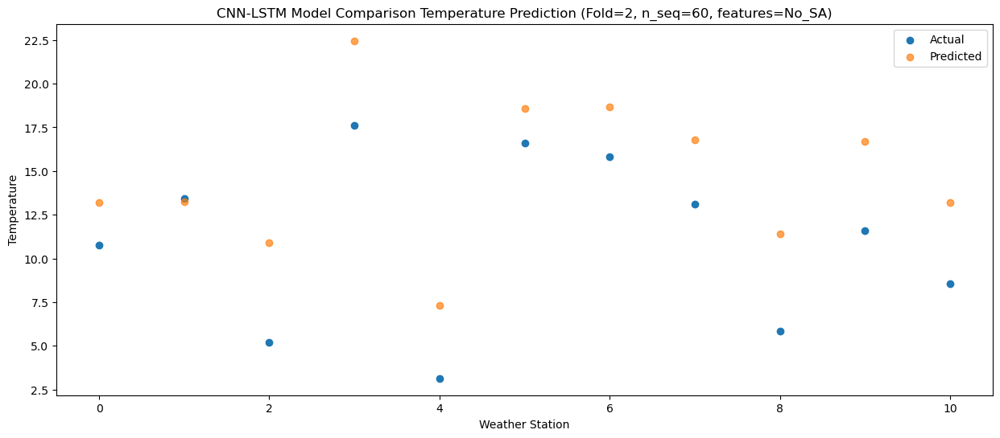

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.16   4.900020
1                 1    6.73   4.940335
2                 2   -1.65   2.609691
3                 3    9.53  14.149800
4                 4   -5.13  -0.990197
5                 5    8.96  10.269888
6                 6    7.87  10.380068
7                 7    7.69   8.470069
8                 8    4.60   3.100000
9                 9    2.66   8.369764
10               10   -1.67   4.899746


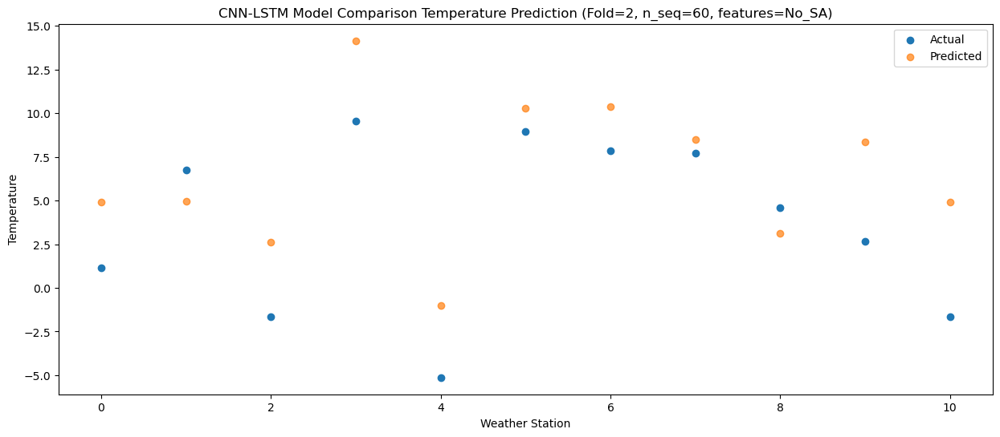

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.25   4.971640
1                 1    4.34   5.011909
2                 2   -0.75   2.681354
3                 3    7.61  14.221447
4                 4   -1.72  -0.918554
5                 5   12.20  10.341523
6                 6   10.16  10.451680
7                 7    4.34   8.541677
8                 8   -1.91   3.171616
9                 9    4.58   8.441419
10               10    0.43   4.971403


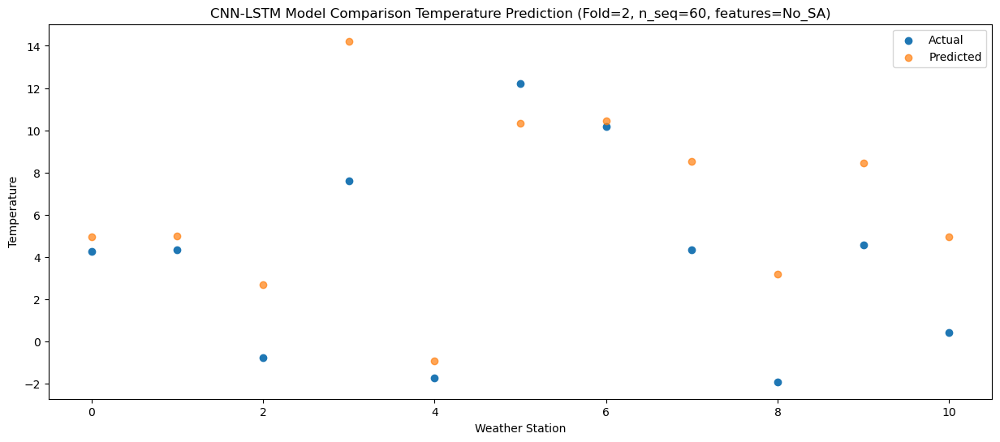

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.05  -1.986802
1                 1   -0.35  -1.946566
2                 2   -5.01  -4.277062
3                 3    1.46   7.263026
4                 4   -9.45  -7.876978
5                 5    3.77   3.383091
6                 6    1.68   3.493231
7                 7    1.34   1.583228
8                 8    0.50  -3.786829
9                 9   -1.90   1.483001
10               10   -6.44  -1.987014


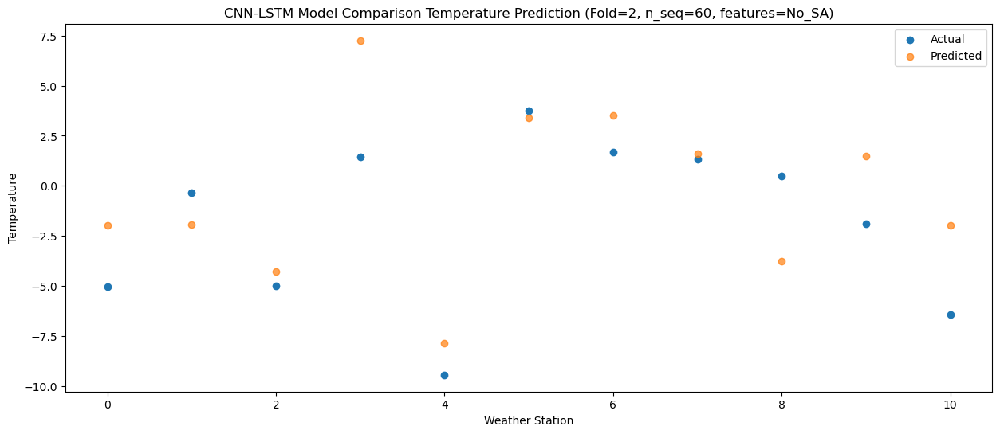

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.81   0.614580
1                 1   -0.36   0.654847
2                 2   -2.68  -1.675707
3                 3    3.78   9.864379
4                 4   -6.31  -5.275619
5                 5    3.39   5.984459
6                 6    1.51   6.094619
7                 7    2.31   4.184618
8                 8    1.37  -1.185443
9                 9    2.12   4.084357
10               10   -1.85   0.614337


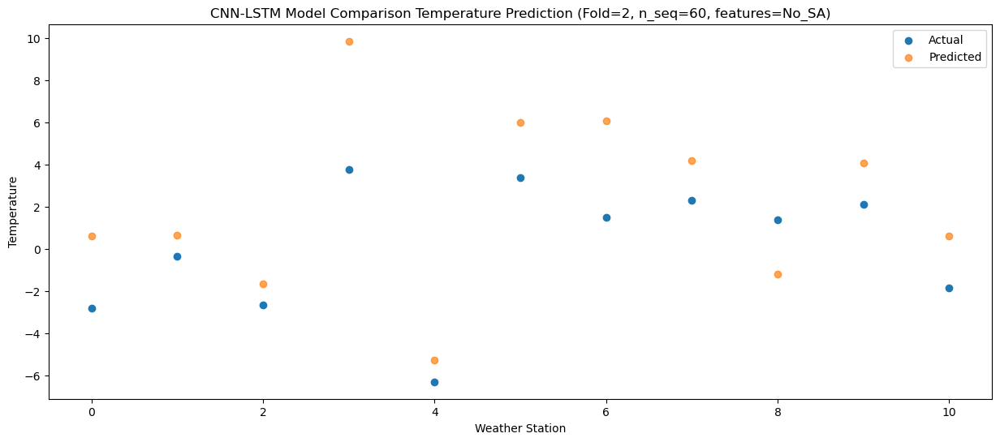

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.48   6.957888
1                 1    6.62   6.998118
2                 2    0.79   4.667634
3                 3    7.64  16.207717
4                 4   -2.55   1.067715
5                 5    9.51  12.327779
6                 6    8.09  12.437914
7                 7    7.37  10.527910
8                 8    3.16   5.157865
9                 9    6.23  10.427691
10               10    2.70   6.957680


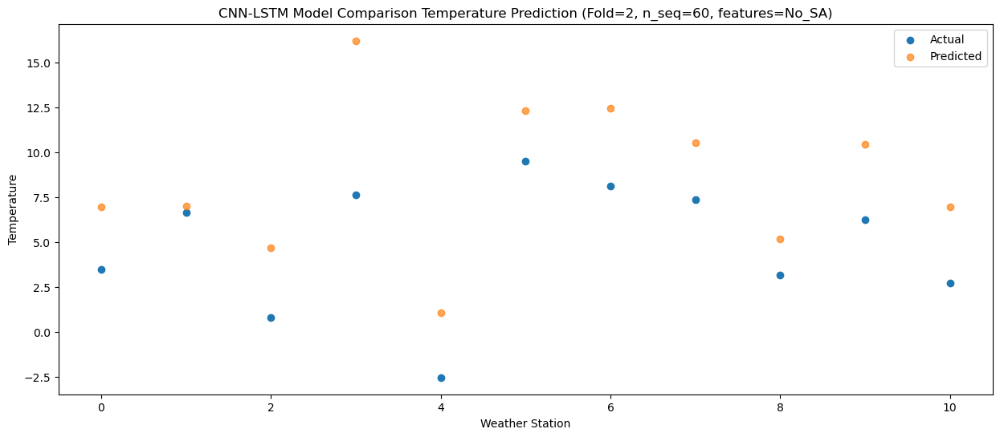

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    7.51  11.168015
1                 1   13.30  11.208241
2                 2    2.60   8.877756
3                 3   12.08  20.417842
4                 4    1.25   5.277842
5                 5   15.66  16.537904
6                 6   14.36  16.648039
7                 7   14.56  14.738035
8                 8    5.28   9.367988
9                 9    9.52  14.637814
10               10    5.86  11.167801


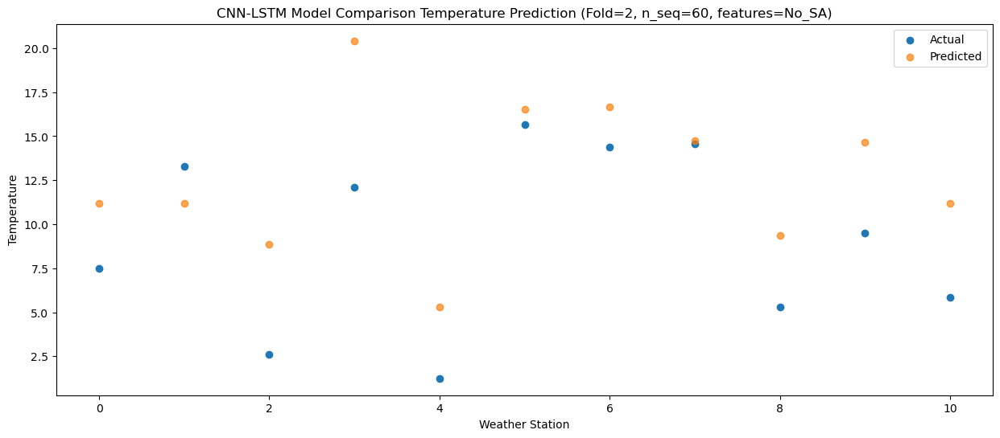

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.06  17.351986
1                 1   19.10  17.392188
2                 2    5.36  15.061755
3                 3   17.42  26.601824
4                 4    6.41  11.461829
5                 5   20.26  22.721887
6                 6   19.38  22.832006
7                 7   19.26  20.922008
8                 8    6.24  15.551957
9                 9   14.37  20.821800
10               10   12.10  17.351792


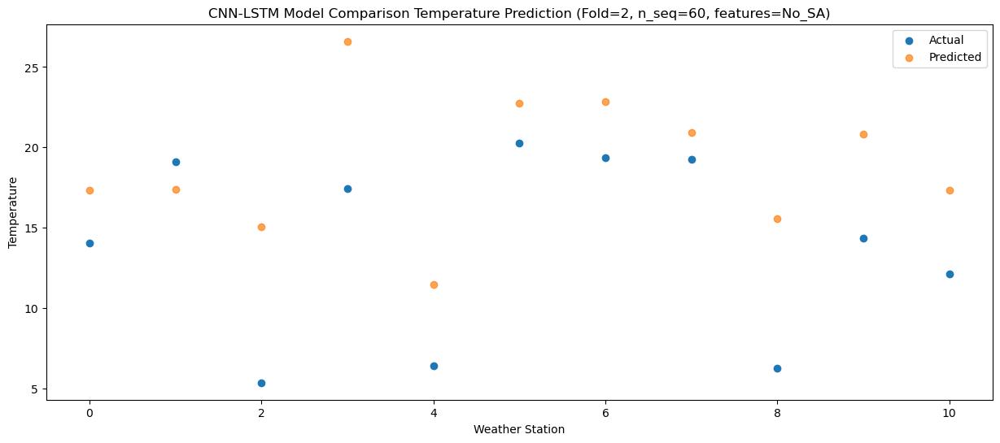

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   18.11  21.884854
1                 1   22.90  21.925038
2                 2    7.17  19.594649
3                 3   21.66  31.134711
4                 4    9.00  15.994715
5                 5   23.98  27.254768
6                 6   24.09  27.364873
7                 7   23.12  25.454883
8                 8   11.16  20.084827
9                 9   18.13  25.354689
10               10   15.75  21.884676


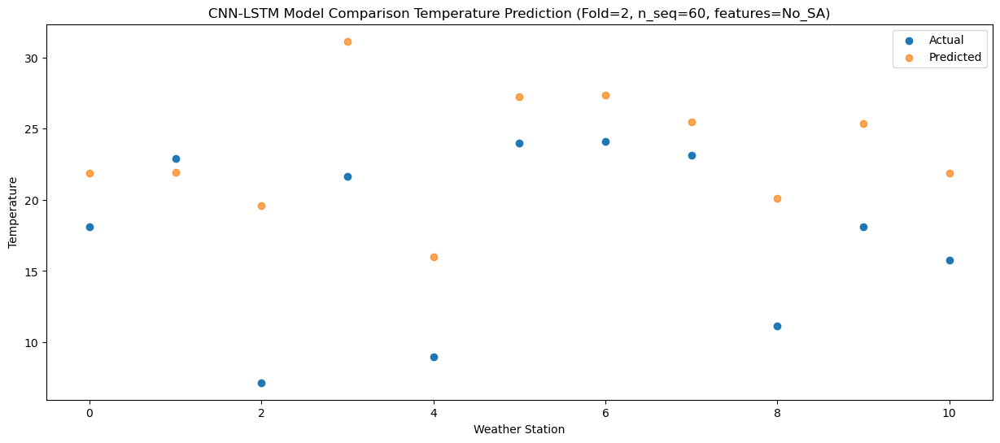

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   20.61  24.279077
1                 1   26.14  24.319286
2                 2    7.35  21.988844
3                 3   26.28  33.528918
4                 4    8.83  18.388922
5                 5   25.34  29.648979
6                 6   26.88  29.759099
7                 7   24.26  27.849113
8                 8   11.97  22.479050
9                 9   19.57  27.748892
10               10   17.10  24.278875


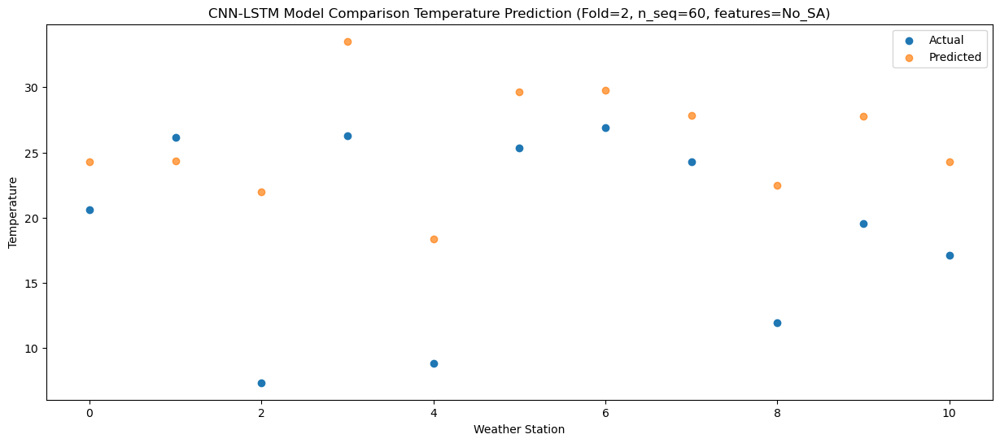

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   18.06  22.822316
1                 1   23.83  22.862473
2                 2    6.78  20.532142
3                 3   26.20  32.072195
4                 4    8.01  16.932194
5                 5   22.62  28.192239
6                 6   24.07  28.302327
7                 7   21.24  26.392340
8                 8   14.01  21.022289
9                 9   18.19  26.292174
10               10   15.85  22.822157


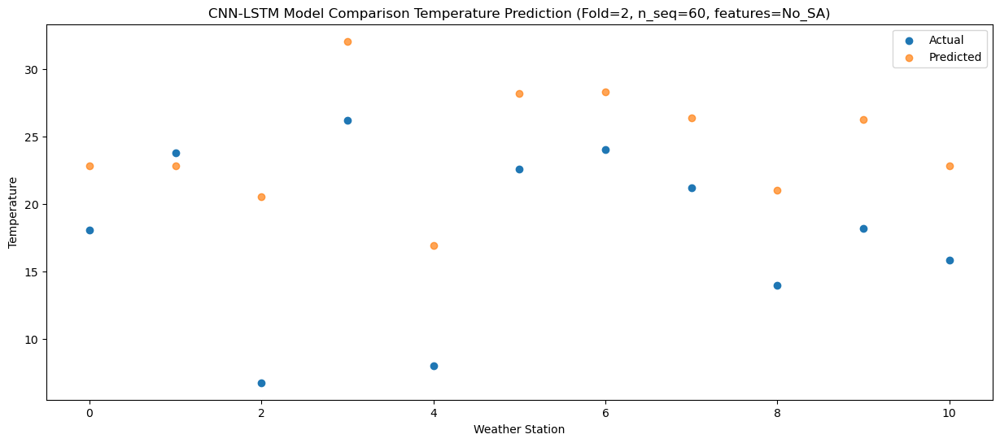

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   16.31  19.637615
1                 1   21.07  19.677788
2                 2    5.37  17.347426
3                 3   21.16  28.887483
4                 4    6.04  13.747486
5                 5   19.96  25.007530
6                 6   20.24  25.117628
7                 7   19.51  23.207638
8                 8   13.60  17.837588
9                 9   14.88  23.107457
10               10   11.70  19.637447


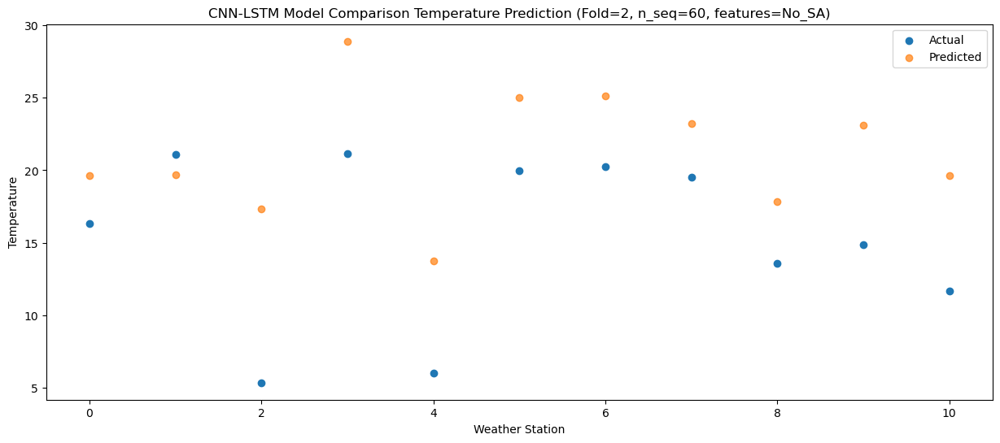

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    7.97  12.971576
1                 1   12.69  13.011755
2                 2    2.74  10.681383
3                 3   15.72  22.221438
4                 4   -0.15   7.081447
5                 5   14.39  18.341490
6                 6   13.86  18.451586
7                 7   11.30  16.541601
8                 8    7.33  11.171550
9                 9    7.57  16.441417
10               10    4.42  12.971406


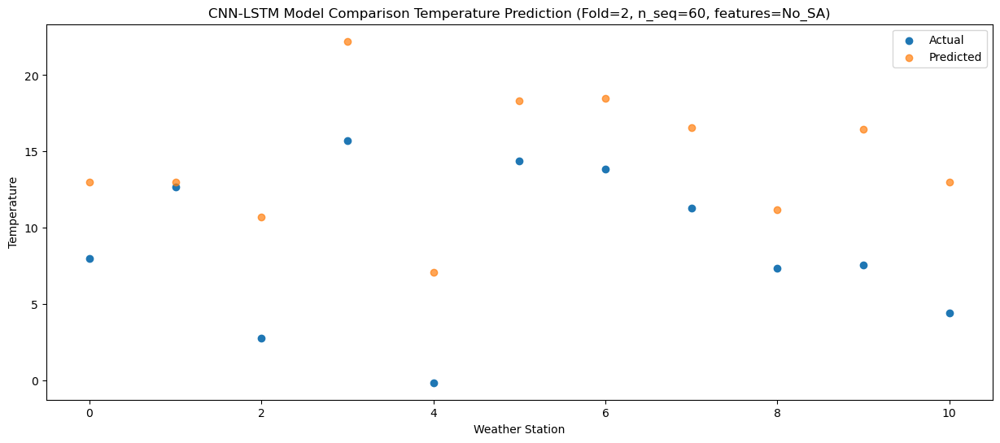

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.84   7.653753
1                 1    2.70   7.693926
2                 2    0.98   5.363569
3                 3   11.92  16.903621
4                 4   -3.22   1.763630
5                 5    8.51  13.023673
6                 6    7.19  13.133761
7                 7    4.41  11.223778
8                 8    1.10   5.853727
9                 9    5.45  11.123603
10               10    1.97   7.653590


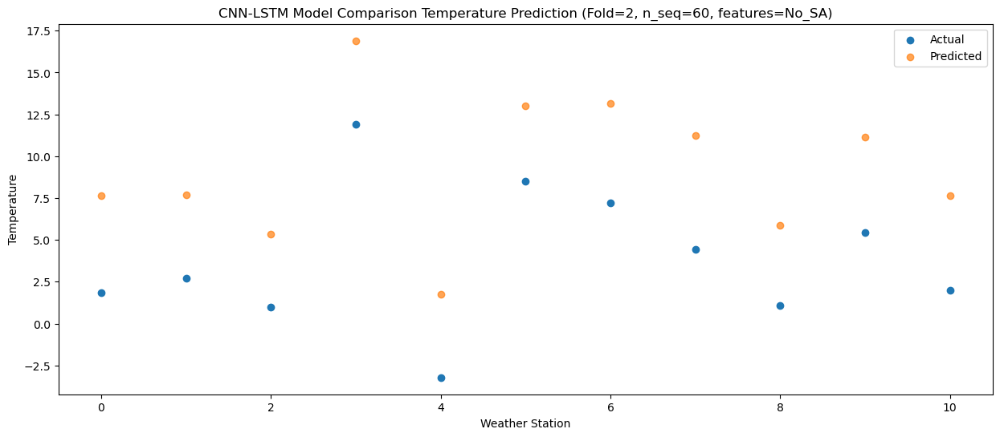

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.67   2.736009
1                 1   -0.01   2.776218
2                 2   -3.12   0.445787
3                 3    5.75  11.985848
4                 4   -5.73  -3.154142
5                 5    6.28   8.105911
6                 6    4.57   8.216021
7                 7    2.24   6.306037
8                 8   -1.60   0.935982
9                 9   -1.08   6.205826
10               10   -3.49   2.735811


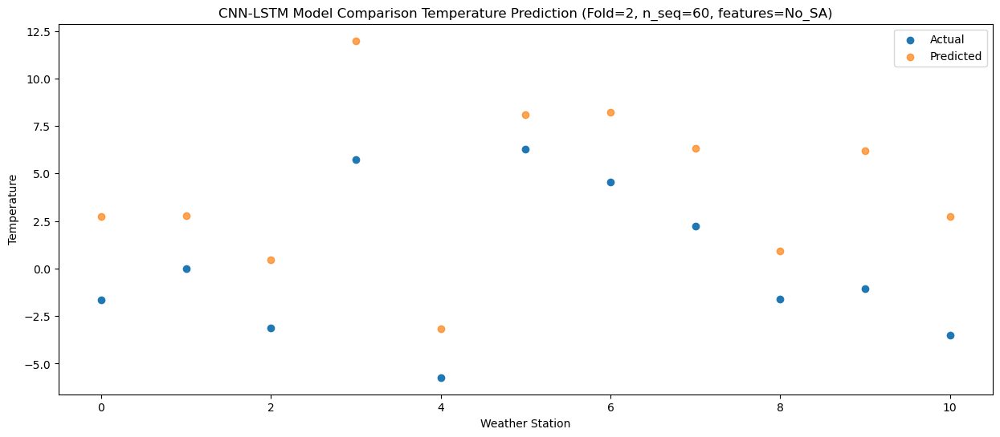

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.35   4.055649
1                 1   -0.26   4.095933
2                 2   -3.32   1.765329
3                 3    7.04  13.305417
4                 4   -4.56  -1.834567
5                 5    7.04   9.425510
6                 6    5.45   9.535673
7                 7    1.53   7.625687
8                 8   -1.94   2.255616
9                 9    2.12   7.525394
10               10   -1.57   4.055375


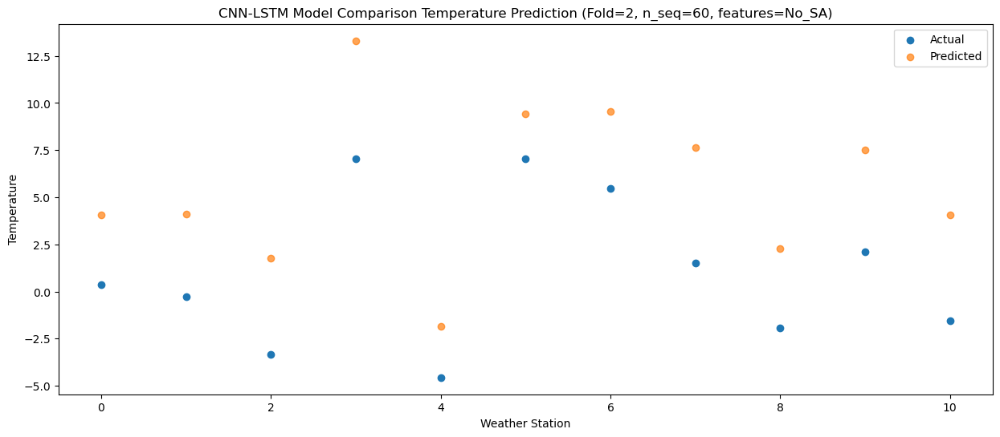

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.37   5.726593
1                 1    1.34   5.766934
2                 2   -0.26   3.436218
3                 3    5.16  14.976328
4                 4   -2.43  -0.163658
5                 5    8.23  11.096435
6                 6    5.64  11.206630
7                 7    2.74   9.296638
8                 8   -2.26   3.926562
9                 9    5.14   9.196298
10               10    1.22   5.726277


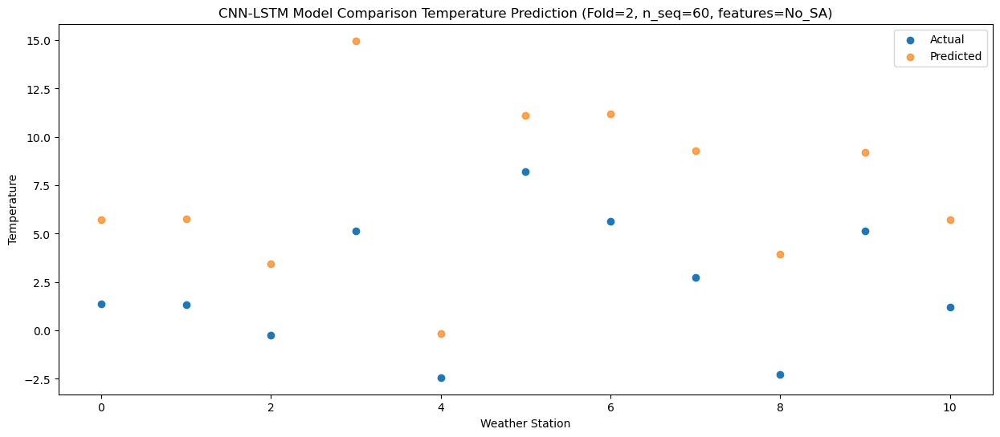

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.64   7.446893
1                 1    5.41   7.487232
2                 2    0.76   5.156521
3                 3    7.60  16.696632
4                 4   -0.60   1.556642
5                 5   12.03  12.816735
6                 6   10.29  12.926927
7                 7    7.44  11.016943
8                 8   -1.25   5.646864
9                 9    5.59  10.916599
10               10    1.75   7.446580


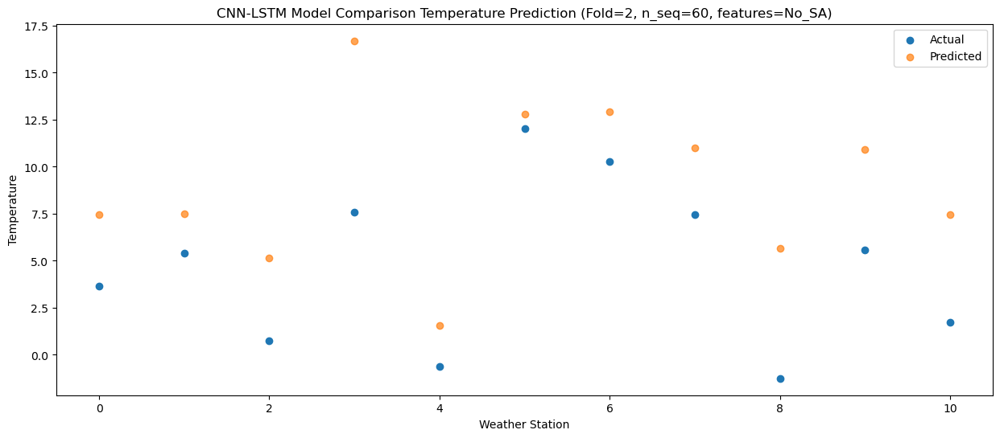

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.79  12.796578
1                 1   11.27  12.836967
2                 2    3.30  10.506151
3                 3   13.32  22.046276
4                 4    1.32   6.906294
5                 5   12.95  18.166405
6                 6   12.11  18.276624
7                 7   13.08  16.366638
8                 8    2.59  10.996551
9                 9    9.11  16.266241
10               10    6.64  12.796218


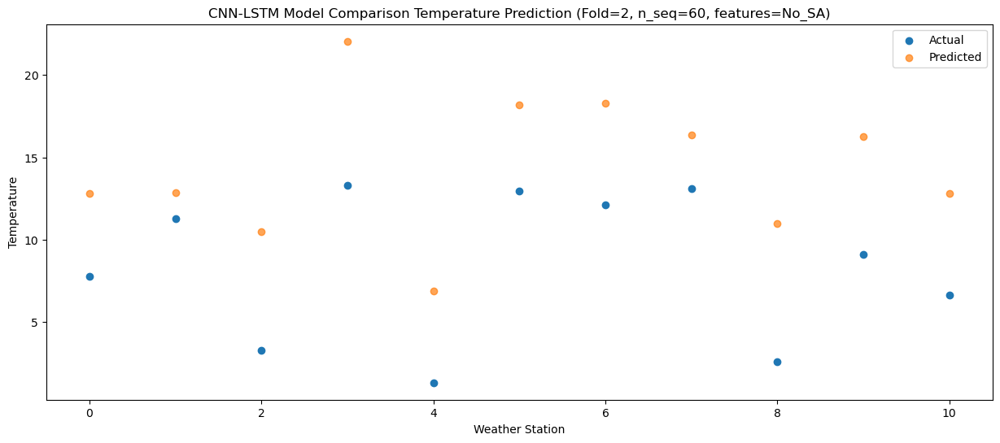

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.84  17.527112
1                 1   16.76  17.567565
2                 2    4.28  15.236610
3                 3   16.95  26.776753
4                 4    5.35  11.636781
5                 5   18.03  22.896907
6                 6   17.85  23.007169
7                 7   17.73  21.097181
8                 8    3.80  15.727085
9                 9   11.89  20.996718
10               10    9.99  17.526689


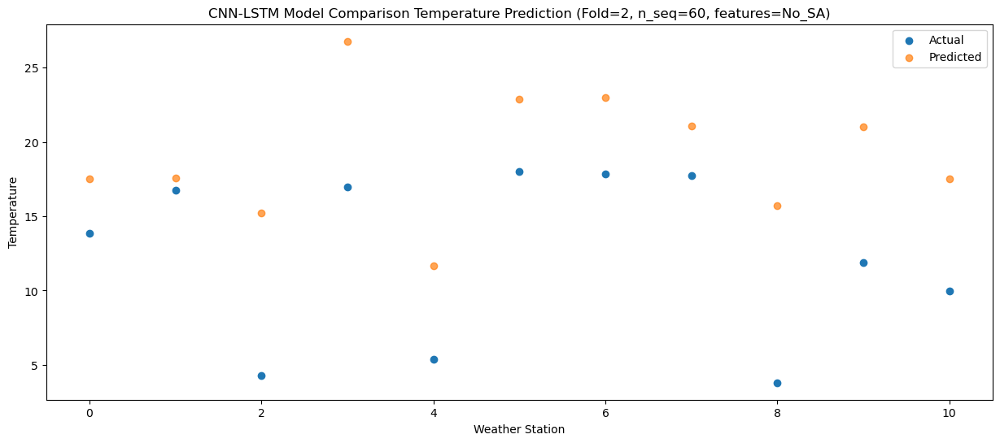

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.47  21.614378
1                 1   19.37  21.654840
2                 2    6.69  19.323861
3                 3   20.74  30.864012
4                 4    9.00  15.724035
5                 5   22.95  26.984166
6                 6   22.00  27.094436
7                 7   22.39  25.184440
8                 8    5.76  19.814348
9                 9   15.55  25.083977
10               10   12.90  21.613947


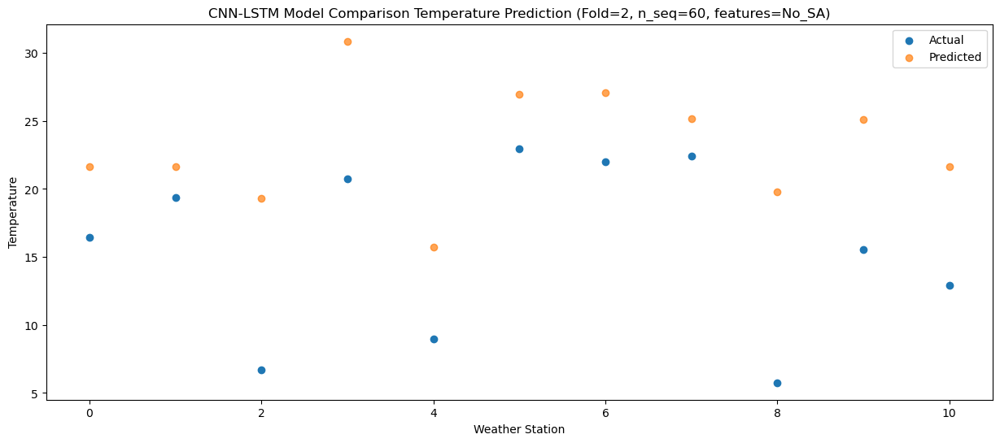

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.22  24.506547
1                 1   23.47  24.547006
2                 2    8.60  22.216031
3                 3   26.31  33.756182
4                 4   10.44  18.616208
5                 5   25.11  29.876336
6                 6   24.56  29.986606
7                 7   27.14  28.076610
8                 8   12.68  22.706526
9                 9   19.14  27.976147
10               10   16.45  24.506120


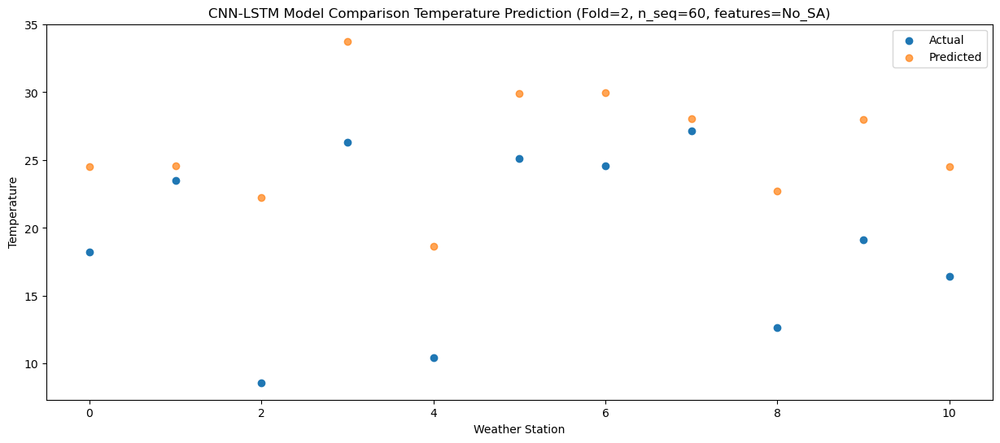

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.73  24.378045
1                 1   23.96  24.418524
2                 2    8.78  22.087504
3                 3   24.30  33.627659
4                 4   11.74  18.487692
5                 5   26.81  29.747824
6                 6   26.90  29.858102
7                 7   24.14  27.948111
8                 8   12.31  22.578024
9                 9   18.59  27.847626
10               10   15.74  24.377599


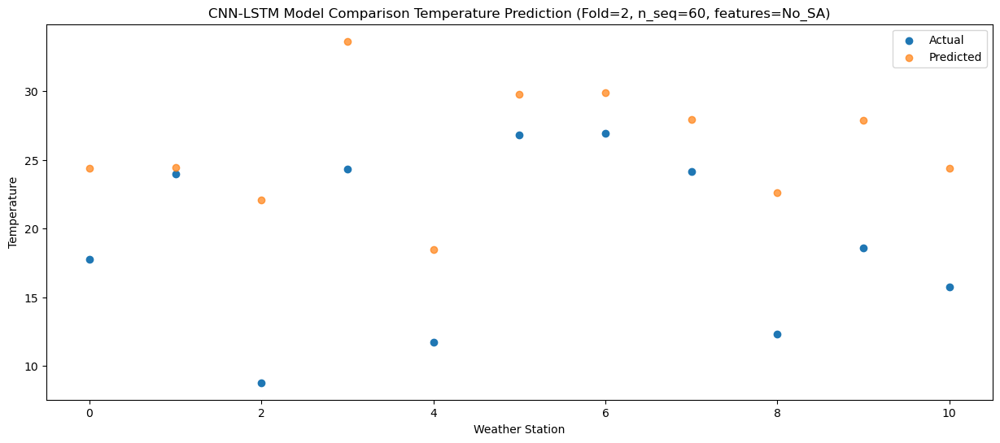

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.44  21.260713
1                 1   21.09  21.301186
2                 2    6.83  18.970180
3                 3   21.88  30.510337
4                 4    7.31  15.370368
5                 5   22.33  26.630499
6                 6   22.12  26.740765
7                 7   21.48  24.830774
8                 8    8.81  19.460697
9                 9   14.63  24.730303
10               10   12.96  21.260280


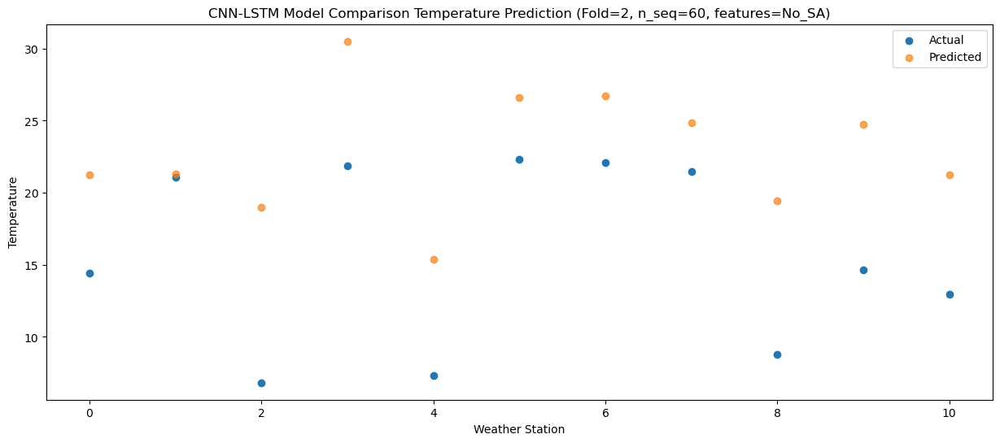

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    9.28  15.276010
1                 1   12.05  15.316449
2                 2    3.25  12.985507
3                 3   16.86  24.525657
4                 4    1.15   9.385685
5                 5   14.44  20.645807
6                 6   13.40  20.756052
7                 7   14.74  18.846061
8                 8    7.22  13.475992
9                 9    9.34  18.745624
10               10    6.91  15.275605


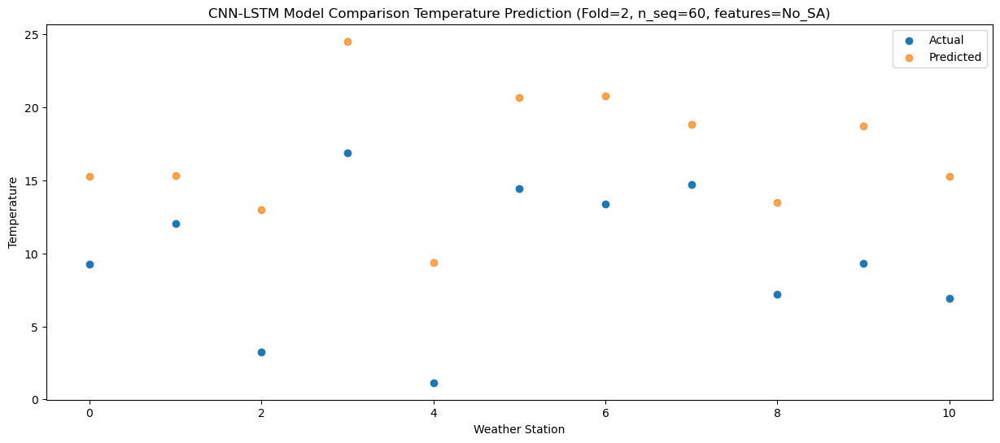

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.17   8.898223
1                 1    5.33   8.938639
2                 2   -0.73   6.607741
3                 3    8.88  18.147887
4                 4   -3.96   3.007915
5                 5    8.16  14.268027
6                 6    8.06  14.378261
7                 7    7.63  12.468268
8                 8    2.83   7.098206
9                 9    3.44  12.367856
10               10    0.70   8.897837


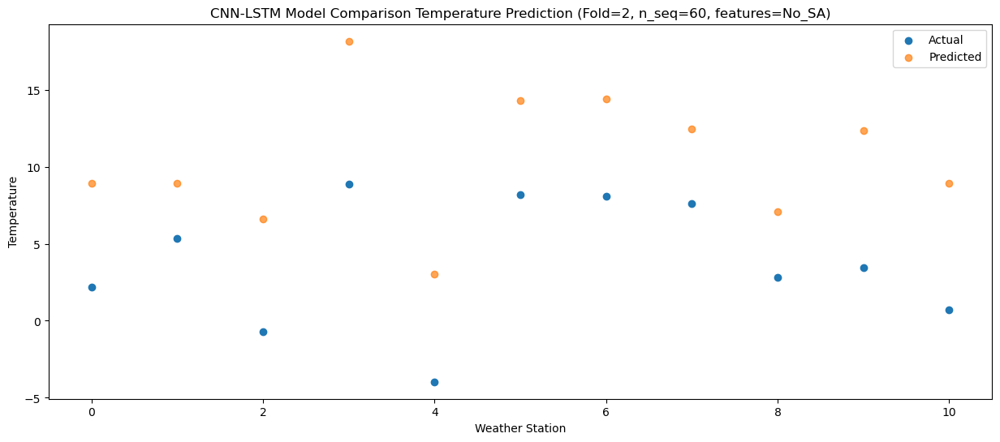

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.89   6.551722
1                 1    1.66   6.592163
2                 2   -2.66   4.261216
3                 3    8.14  15.801369
4                 4   -6.56   0.661401
5                 5    6.05  11.921515
6                 6    5.08  12.031762
7                 7    2.59  10.121775
8                 8    0.50   4.751703
9                 9    0.97  10.021332
10               10   -2.15   6.551317


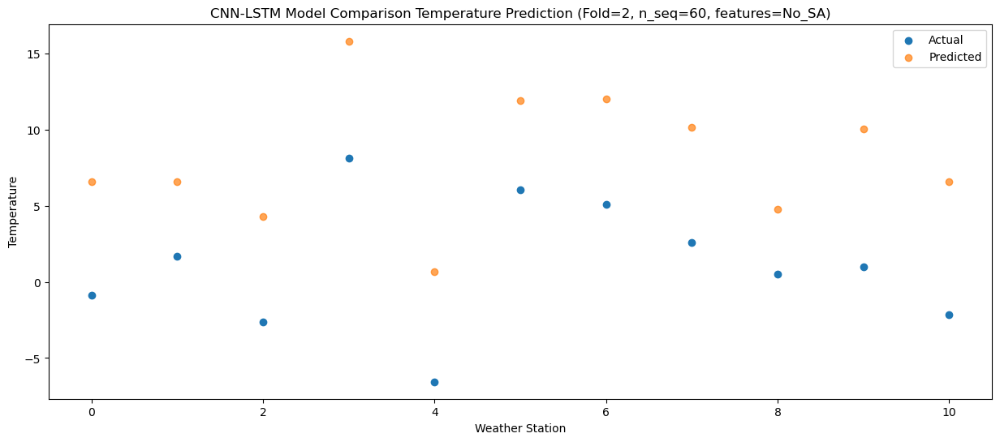

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -6.68   2.000000
1                 1   -3.43   2.040440
2                 2   -4.66  -0.290514
3                 3    3.97  11.249643
4                 4   -8.64  -3.890325
5                 5    1.90   7.369791
6                 6   -0.10   7.480042
7                 7    2.26   5.570053
8                 8   -1.30   0.199982
9                 9   -0.88   5.469607
10               10   -5.47   1.999595


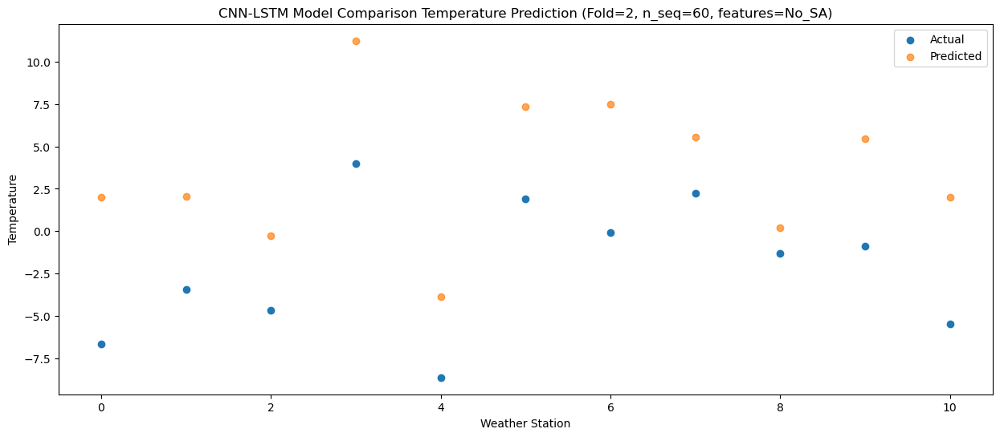

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.64   7.239394
1                 1    4.05   7.279852
2                 2   -4.18   4.948860
3                 3    4.65  16.489022
4                 4   -4.48   1.349060
5                 5    8.66  12.609178
6                 6    8.16  12.719436
7                 7    5.47  10.809448
8                 8   -0.77   5.439384
9                 9    2.34  10.708986
10               10   -0.93   7.238972


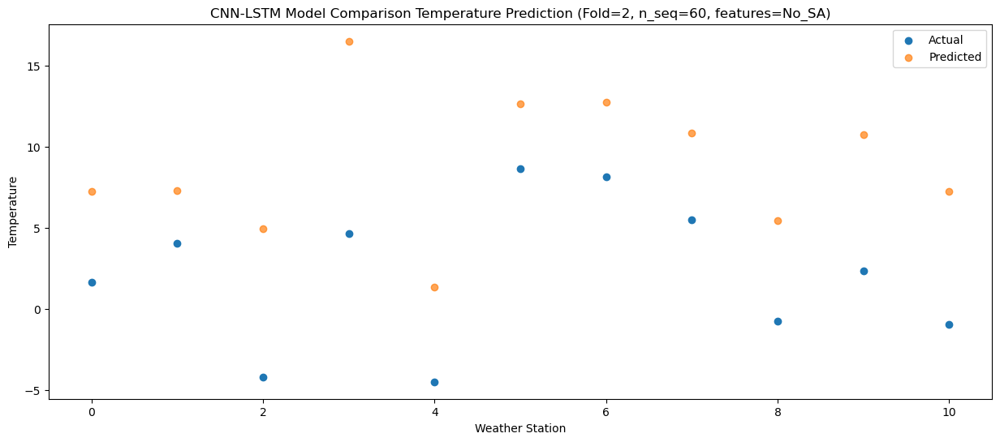

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.53  10.539266
1                 1    6.82  10.579776
2                 2    0.24   8.248689
3                 3    9.05  19.788857
4                 4   -1.81   4.648902
5                 5   11.03  15.909024
6                 6   10.51  16.019319
7                 7    8.04  14.109332
8                 8    0.17   8.739258
9                 9    5.90  14.008818
10               10    3.24  10.538806


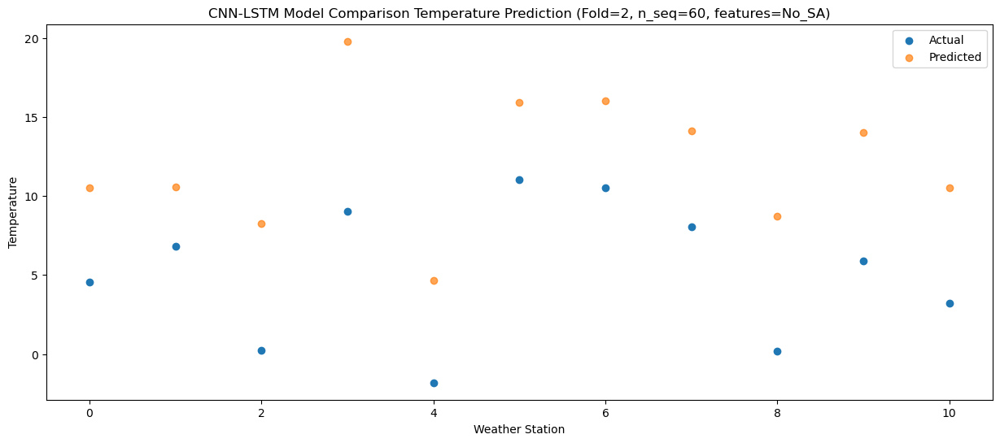

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.29  14.868525
1                 1   12.23  14.909020
2                 2    1.63  12.577964
3                 3   11.48  24.118120
4                 4    1.85   8.978165
5                 5   14.77  20.238287
6                 6   13.96  20.348572
7                 7   12.45  18.438583
8                 8    2.28  13.068515
9                 9    9.96  18.338085
10               10    7.22  14.868076


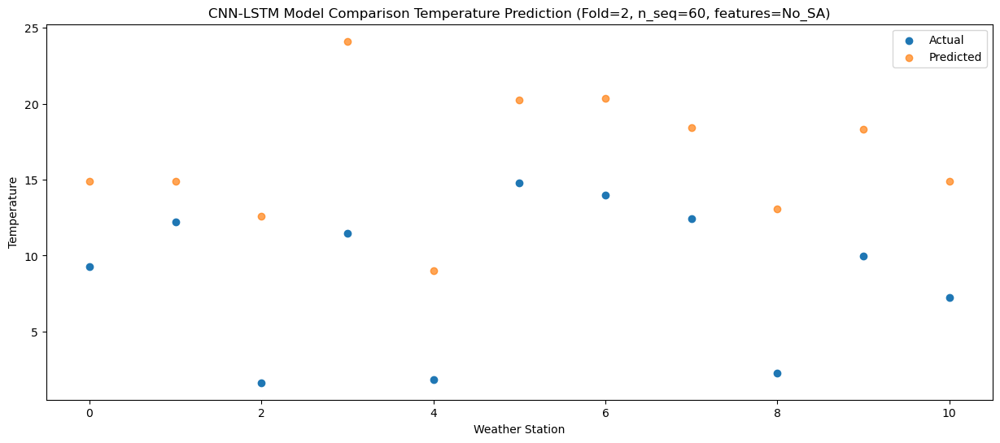

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.22  20.153650
1                 1   16.84  20.194173
2                 2    6.48  17.863054
3                 3   17.27  29.403228
4                 4    6.90  14.263268
5                 5   18.47  25.523404
6                 6   18.85  25.633709
7                 7   18.27  23.723713
8                 8    4.08  18.353634
9                 9   14.34  23.623186
10               10   11.68  20.153172


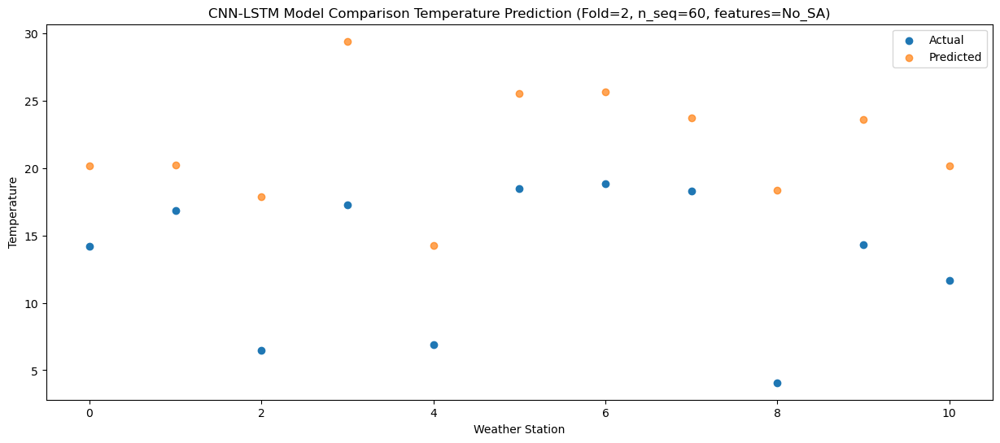

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.30  24.535232
1                 1   23.01  24.575763
2                 2    7.39  22.244623
3                 3   23.24  33.784794
4                 4    8.73  18.644839
5                 5   21.70  29.904975
6                 6   22.35  30.015291
7                 7   24.69  28.105295
8                 8    8.76  22.735211
9                 9   18.22  28.004759
10               10   16.03  24.534743


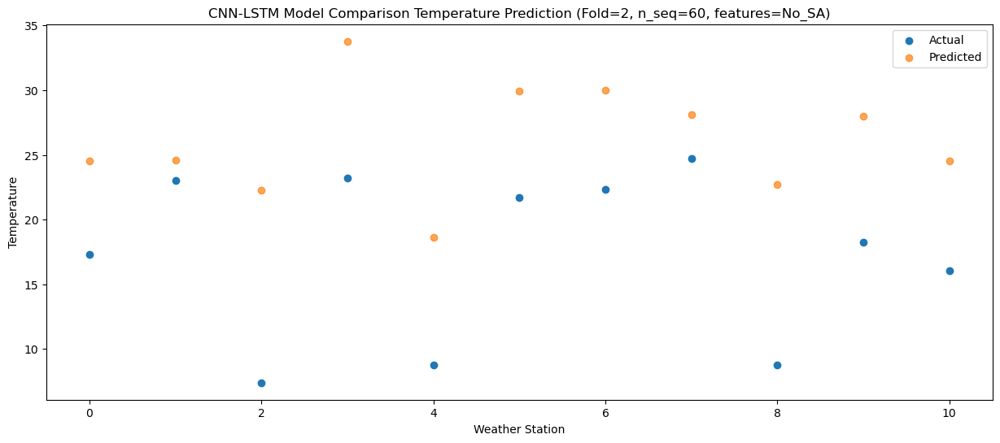

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   17.79  25.630687
1                 1   23.56  25.671216
2                 2    8.23  23.340082
3                 3   26.02  34.880253
4                 4    9.34  19.740298
5                 5   20.18  31.000436
6                 6   22.66  31.110746
7                 7   24.16  29.200749
8                 8   12.49  23.830665
9                 9   19.61  29.100218
10               10   17.26  25.630202


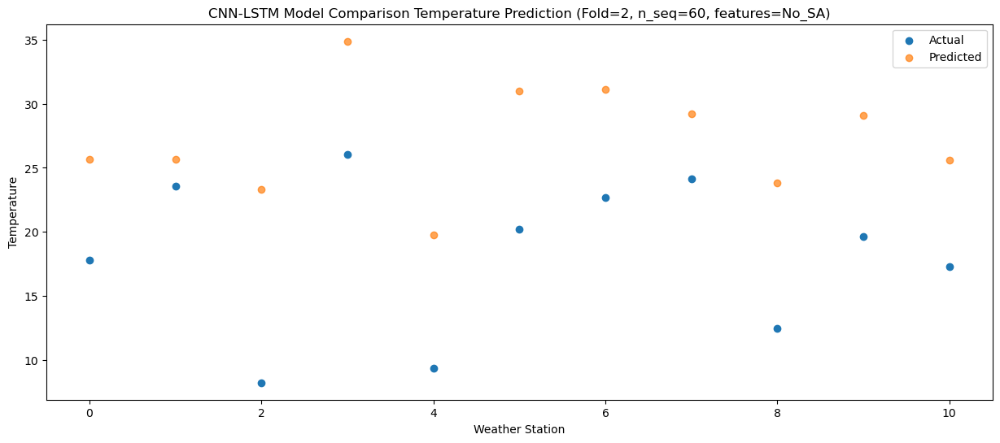

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.02  25.252073
1                 1   23.61  25.292634
2                 2    8.19  22.961434
3                 3   24.31  34.501615
4                 4    9.69  19.361665
5                 5   21.83  30.621806
6                 6   24.46  30.732135
7                 7   24.55  28.822144
8                 8   12.07  23.452049
9                 9   17.59  28.721581
10               10   15.64  25.251561


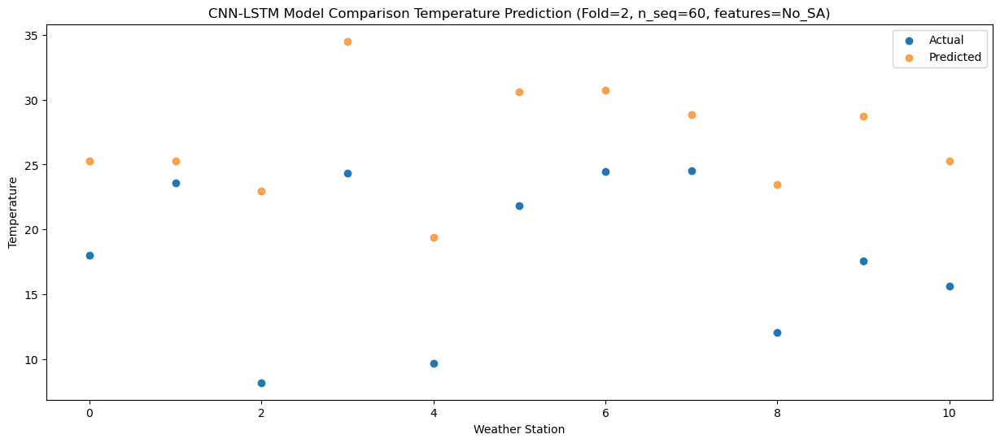

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.04  22.138058
1                 1   19.88  22.178663
2                 2    7.87  19.847368
3                 3   20.79  31.387569
4                 4    6.89  16.247617
5                 5   19.10  27.507773
6                 6   20.23  27.618132
7                 7   20.52  25.708141
8                 8   10.22  20.338032
9                 9   14.63  25.607528
10               10   13.05  22.137503


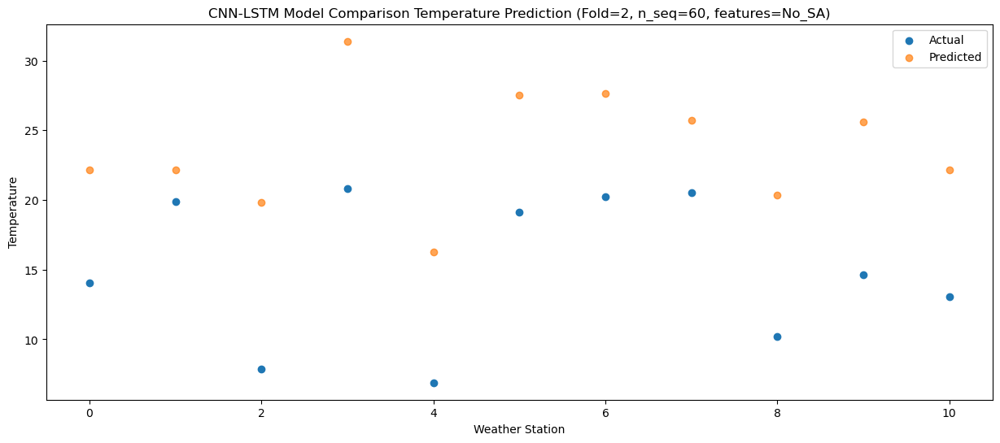

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    9.77  17.398387
1                 1   14.91  17.439048
2                 2    4.40  15.107644
3                 3   15.53  26.647857
4                 4    2.20  11.507908
5                 5   16.45  22.768080
6                 6   17.26  22.878477
7                 7   16.26  20.968485
8                 8    7.23  15.598369
9                 9    9.41  20.867813
10               10    6.63  17.397786


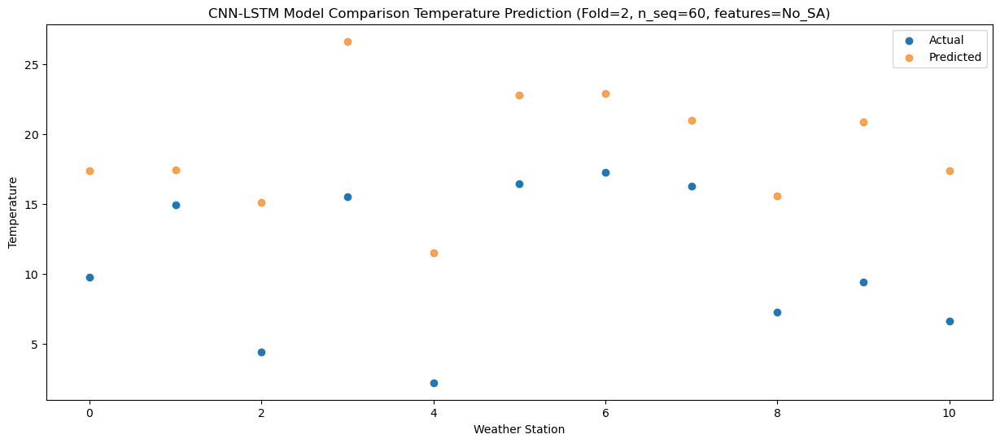

f, t:
[[-6.500e-01  3.410e+00 -1.000e-01  9.240e+00 -6.250e+00  7.270e+00
   6.650e+00  6.030e+00  2.170e+00  2.040e+00 -1.920e+00]
 [-3.100e-01  1.130e+00 -1.220e+00  6.180e+00 -5.900e+00  5.840e+00
   4.840e+00  1.500e+00 -1.370e+00  1.630e+00 -1.320e+00]
 [-9.000e-01  8.900e-01 -2.370e+00  6.450e+00 -5.560e+00  6.210e+00
   5.190e+00  2.750e+00 -8.300e-01  1.340e+00 -1.760e+00]
 [-1.090e+00  1.600e-01 -1.330e+00  6.600e+00 -4.920e+00  5.450e+00
   4.630e+00  3.560e+00  1.280e+00  2.380e+00 -1.960e+00]
 [ 5.500e+00  8.170e+00  2.290e+00  1.015e+01  1.770e+00  1.354e+01
   1.228e+01  8.060e+00  1.350e+00  7.610e+00  4.080e+00]
 [ 6.980e+00  1.040e+01  3.680e+00  1.138e+01  1.240e+00  1.351e+01
   1.259e+01  1.304e+01  4.560e+00  8.910e+00  4.510e+00]
 [ 1.227e+01  1.720e+01  4.990e+00  1.727e+01  4.210e+00  1.735e+01
   1.749e+01  1.933e+01  8.610e+00  1.151e+01  8.550e+00]
 [ 1.727e+01  2.440e+01  7.580e+00  2.333e+01  7.250e+00  2.096e+01
   2.223e+01  2.285e+01  9.900e+00  1.680e+0

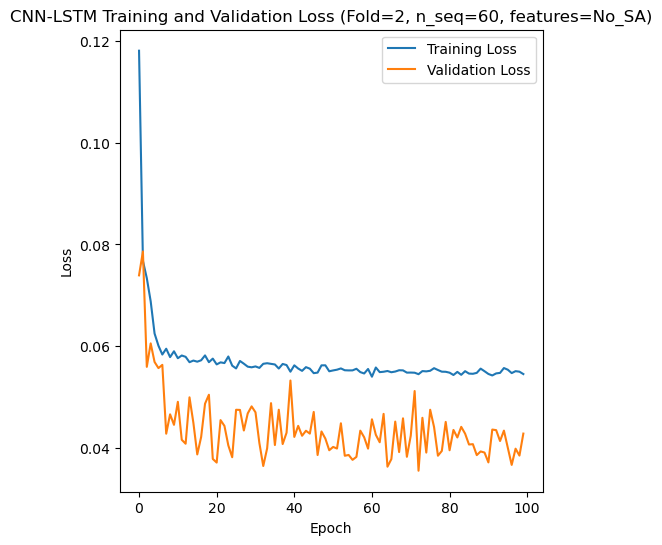

[[ 8.9   6.89 11.3  ... 22.19 16.88 13.54]
 [ 7.02  3.15 10.24 ... 22.31 18.92 11.32]
 [ 7.65  9.7   9.44 ... 25.68 20.65 11.46]
 ...
 [ 9.57 11.93 12.22 ... 30.9  25.01 12.37]
 [ 9.04  9.3   8.59 ... 17.72 17.26 10.73]
 [ 3.2   0.4   3.78 ... 18.92 14.39 10.04]]
Epoch 1/100
84/84 [==============================] - 35s 174ms/step - loss: 0.1164 - accuracy: 0.3214 - mae: 0.0955 - rmse: 0.1164 - mape: 21.3926 - pearson: 0.6900 - val_loss: 0.1118 - val_accuracy: 0.1000 - val_mae: 0.0890 - val_rmse: 0.1118 - val_mape: 18.7057 - val_pearson: 0.6107
Epoch 2/100
84/84 [==============================] - 10s 121ms/step - loss: 0.0772 - accuracy: 0.4643 - mae: 0.0620 - rmse: 0.0772 - mape: 14.4070 - pearson: 0.7990 - val_loss: 0.0778 - val_accuracy: 0.5000 - val_mae: 0.0630 - val_rmse: 0.0778 - val_mape: 14.0141 - val_pearson: 0.7831
Epoch 3/100
84/84 [==============================] - 10s 117ms/step - loss: 0.0724 - accuracy: 0.5833 - mae: 0.0589 - rmse: 0.0724 - mape: 13.4202 - pearson: 0.8499

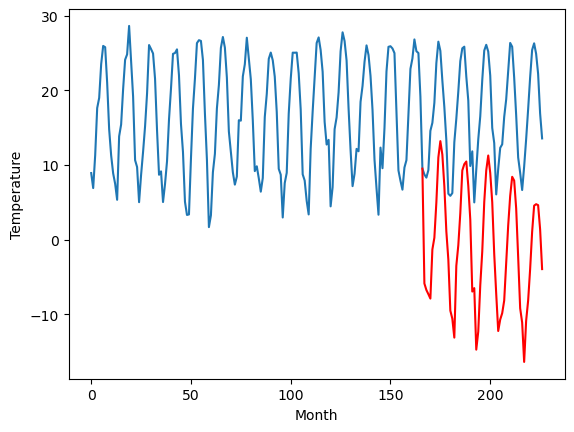

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.22		-0.19		-2.41
0.87		-1.06		-1.93
0.03		-1.62		-1.65
0.18		-2.21		-2.39
7.67		4.36		-3.31
8.59		5.94		-2.65
12.99		10.68		-2.31
20.09		16.70		-3.39
21.95		18.88		-3.07
20.09		17.07		-3.02
16.42		12.85		-3.57
9.31		6.79		-2.52
6.49		3.01		-3.48
-0.06		-3.82		-3.76
-1.21		-4.90		-3.69
-4.93		-7.44		-2.51
7.04		2.17		-4.87
8.90		4.94		-3.96
13.12		9.23		-3.89
19.83		14.95		-4.88
21.14		15.79		-5.35
21.71		16.15		-5.56
18.98		12.89		-6.09
12.38		8.36		-4.02
4.67		-1.27		-5.94
5.98		-0.81		-6.79
-2.85		-9.05		-6.20
-1.63		-6.62		-4.99
5.15		-0.45		-5.60
10.00		4.09		-5.91
15.43		10.72		-4.71
20.58		14.96		-5.62
24.62		16.95		-7.67
21.54		14.61		-6.93
17.68		10.71		-6.97
11.13		3.76		-7.37
3.90		-1.59		-5.49
-0.15		-6.55		-6.40
0.55		-5.02		-5.57
2.51		-4.16		-6.67
5.11		-2.47		-7.58
10.16		2.57		-7.59
15.47		7.57		-7.90
19.80		11.55		-8.25
22.06		14.10		-7.96
22.24		13.59		-8.65
18.19		9.87		-

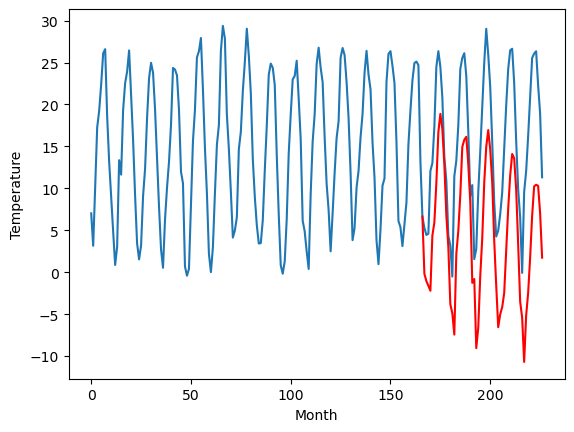

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.71		-2.07		-4.78
0.18		-2.94		-3.12
-1.04		-3.50		-2.46
1.38		-4.09		-5.47
3.17		2.48		-0.69
7.83		4.06		-3.77
13.02		8.80		-4.22
16.37		14.82		-1.55
19.15		17.00		-2.15
19.68		15.19		-4.49
15.35		10.97		-4.38
9.86		4.91		-4.95
1.21		1.13		-0.08
-1.99		-5.70		-3.71
-0.73		-6.78		-6.05
1.57		-9.32		-10.89
2.72		0.29		-2.43
8.45		3.06		-5.39
13.25		7.35		-5.90
18.10		13.07		-5.03
21.23		13.91		-7.32
19.03		14.27		-4.76
15.72		11.01		-4.71
7.06		6.48		-0.58
2.72		-3.15		-5.87
-1.20		-2.69		-1.49
-1.53		-10.93		-9.40
0.17		-8.50		-8.67
4.88		-2.33		-7.21
7.95		2.21		-5.74
12.19		8.84		-3.35
17.58		13.08		-4.50
20.15		15.07		-5.08
20.33		12.73		-7.60
17.51		8.83		-8.68
10.33		1.88		-8.45
-0.40		-3.47		-3.07
-1.36		-8.43		-7.07
0.03		-6.90		-6.93
-0.82		-6.04		-5.22
2.05		-4.35		-6.40
7.68		0.69		-6.99
12.12		5.69		-6.43
14.92		9.67		-5.25
20.58		12.22		-8.36
18.89		11.71		-7.18
15.12		7.99		-7.1

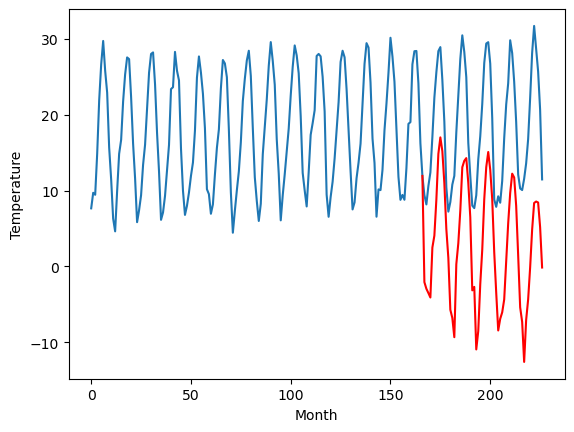

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.86		-1.44		1.42
-2.85		-2.31		0.54
-3.40		-2.87		0.53
-3.75		-3.46		0.29
3.16		3.11		-0.05
3.80		4.69		0.89
8.37		9.43		1.06
14.19		15.45		1.26
17.99		17.63		-0.36
15.57		15.82		0.25
11.51		11.60		0.09
6.09		5.54		-0.55
2.17		1.76		-0.41
-5.03		-5.07		-0.04
-6.49		-6.15		0.34
-7.81		-8.69		-0.88
2.40		0.92		-1.48
4.75		3.69		-1.06
8.82		7.98		-0.84
14.74		13.70		-1.04
15.73		14.54		-1.19
16.25		14.90		-1.35
12.12		11.64		-0.48
8.54		7.11		-1.43
-1.12		-2.52		-1.40
0.37		-2.06		-2.43
-8.58		-10.30		-1.72
-4.06		-7.87		-3.81
1.69		-1.70		-3.39
4.70		2.84		-1.86
11.48		9.47		-2.01
14.96		13.71		-1.25
16.51		15.70		-0.81
15.44		13.36		-2.08
11.46		9.46		-2.00
4.19		2.51		-1.68
1.07		-2.84		-3.91
-4.20		-7.80		-3.60
-2.45		-6.27		-3.82
-0.11		-5.41		-5.30
0.13		-3.72		-3.85
6.37		1.32		-5.05
9.06		6.32		-2.74
12.80		10.30		-2.50
16.42		12.85		-3.57
15.31		12.34		-2.97
12.58		8.62		-3.96
7.14		2

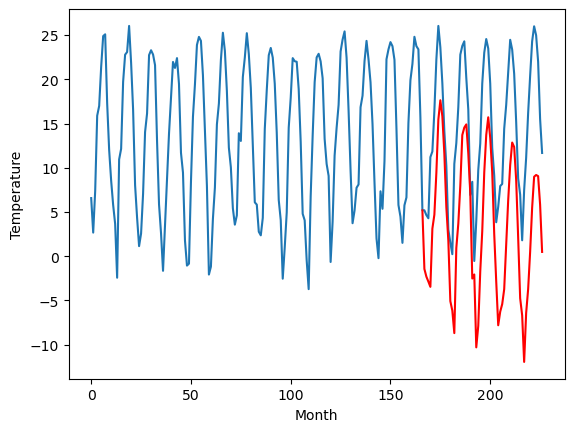

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.31		-2.52		-5.83
0.05		-3.39		-3.44
-2.82		-3.95		-1.13
-1.67		-4.54		-2.87
5.74		2.03		-3.71
8.77		3.61		-5.16
14.84		8.35		-6.49
21.89		14.37		-7.52
23.35		16.55		-6.80
20.79		14.74		-6.05
16.72		10.52		-6.20
8.99		4.46		-4.53
6.17		0.68		-5.49
-1.00		-6.15		-5.15
-2.47		-7.23		-4.76
-6.34		-9.77		-3.43
6.74		-0.16		-6.90
10.03		2.61		-7.42
14.60		6.90		-7.70
22.08		12.62		-9.46
22.08		13.46		-8.62
22.20		13.82		-8.38
18.84		10.56		-8.28
13.42		6.03		-7.39
3.68		-3.60		-7.28
3.32		-3.14		-6.46
-6.15		-11.38		-5.23
-3.63		-8.95		-5.32
4.83		-2.78		-7.61
8.96		1.76		-7.20
16.53		8.39		-8.14
21.98		12.63		-9.35
23.10		14.62		-8.48
21.28		12.28		-9.00
16.96		8.38		-8.58
9.69		1.43		-8.26
3.80		-3.92		-7.72
-2.17		-8.88		-6.71
-0.45		-7.35		-6.90
6.07		-6.49		-12.56
3.11		-4.80		-7.91
10.32		0.24		-10.08
16.32		5.24		-11.08
20.42		9.22		-11.20
22.12		11.77		-10.35
20.83		11.26		-9.57
17.47		7.

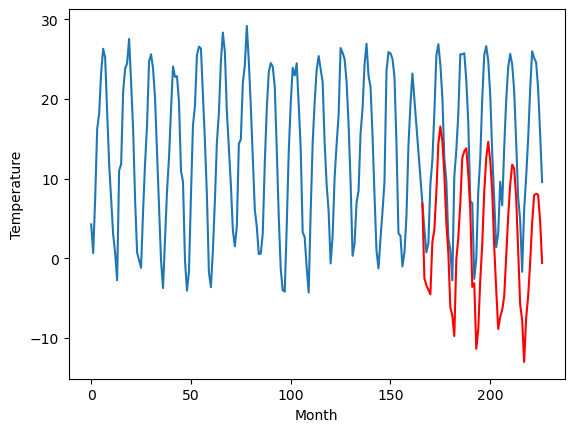

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.82		-4.84		0.98
-5.61		-5.71		-0.10
-7.03		-6.27		0.76
-7.44		-6.86		0.58
-0.58		-0.29		0.29
1.69		1.29		-0.40
7.10		6.03		-1.07
14.09		12.05		-2.04
15.98		14.23		-1.75
13.47		12.42		-1.05
9.84		8.20		-1.64
3.84		2.14		-1.70
-0.10		-1.64		-1.54
-7.71		-8.47		-0.76
-9.16		-9.55		-0.39
-11.88		-12.09		-0.21
-0.55		-2.48		-1.93
2.90		0.29		-2.61
7.18		4.58		-2.60
13.89		10.30		-3.59
14.27		11.14		-3.13
14.59		11.50		-3.09
11.33		8.24		-3.09
6.75		3.71		-3.04
-4.10		-5.92		-1.82
-3.05		-5.46		-2.41
-11.87		-13.70		-1.83
-8.68		-11.27		-2.59
-1.72		-5.10		-3.38
2.13		-0.56		-2.69
9.93		6.07		-3.86
13.87		10.31		-3.56
15.86		12.30		-3.56
14.21		9.96		-4.25
10.26		6.06		-4.20
4.22		-0.89		-5.11
-2.33		-6.24		-3.91
-7.87		-11.20		-3.33
-5.73		-9.67		-3.94
-4.01		-8.81		-4.80
-3.11		-7.12		-4.01
3.12		-2.08		-5.20
8.53		2.92		-5.61
11.99		6.90		-5.09
15.25		9.45		-5.80
13.70		8.94		-4.76
10.24		5.2

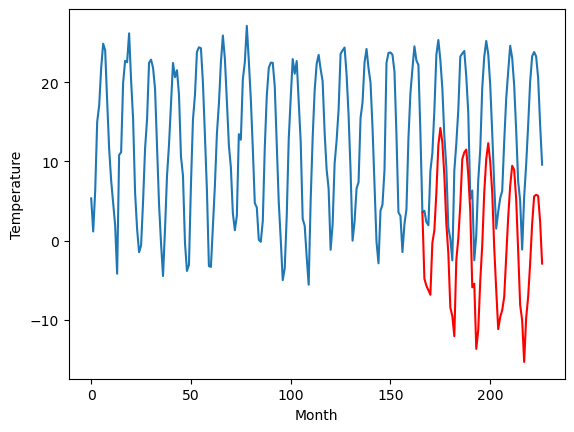

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-3.76		2.70
-12.13		-4.63		7.50
-12.22		-5.19		7.03
-12.03		-5.78		6.25
-7.10		0.79		7.89
-4.12		2.37		6.49
2.99		7.11		4.12
7.20		13.13		5.93
9.19		15.31		6.12
9.94		13.50		3.56
4.44		9.28		4.84
0.70		3.22		2.52
-6.49		-0.56		5.93
-12.19		-7.39		4.80
-11.92		-8.47		3.45
-11.82		-11.01		0.81
-8.85		-1.40		7.45
-4.07		1.37		5.44
0.98		5.66		4.68
8.37		11.38		3.01
10.21		12.22		2.01
8.29		12.58		4.29
6.42		9.32		2.90
-1.55		4.79		6.34
-4.29		-4.84		-0.55
-9.05		-4.38		4.67
-11.34		-12.62		-1.28
-13.06		-10.19		2.87
-8.52		-4.02		4.50
-4.20		0.52		4.72
1.71		7.15		5.44
7.48		11.39		3.91
9.40		13.38		3.98
8.64		11.04		2.40
6.48		7.14		0.66
-1.78		0.19		1.97
-9.46		-5.16		4.30
-11.63		-10.12		1.51
-12.36		-8.59		3.77
-12.33		-7.73		4.60
-10.54		-6.04		4.50
-5.20		-1.00		4.20
2.01		4.00		1.99
6.59		7.98		1.39
12.73		10.53		-2.20
10.14		10.02		-0.12
5.99		6.30		0.31
-0.14		-0.23		-0.09
-6.00	

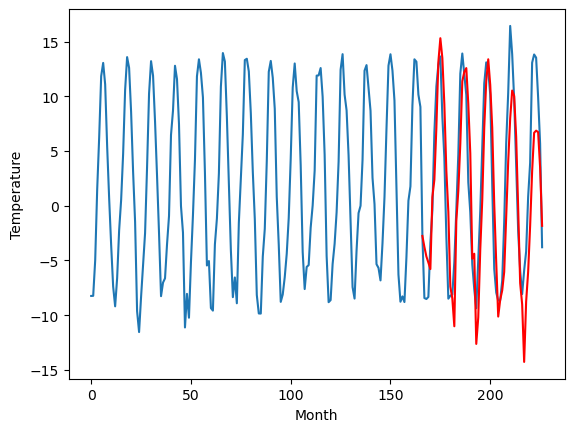

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-13.16		-17.33		-4.17
-17.89		-18.20		-0.31
-16.73		-18.76		-2.03
-15.22		-19.35		-4.13
-12.11		-12.78		-0.67
-6.20		-11.20		-5.00
1.07		-6.46		-7.53
4.53		-0.44		-4.97
8.76		1.74		-7.02
8.87		-0.07		-8.94
4.06		-4.29		-8.35
-2.88		-10.35		-7.47
-11.69		-14.13		-2.44
-17.38		-20.96		-3.58
-16.83		-22.04		-5.21
-13.98		-24.58		-10.60
-12.38		-14.97		-2.59
-4.41		-12.20		-7.79
0.02		-7.91		-7.93
7.66		-2.19		-9.85
8.74		-1.35		-10.09
7.51		-0.99		-8.50
3.54		-4.25		-7.79
-6.81		-8.78		-1.97
-9.33		-18.41		-9.08
-16.60		-17.95		-1.35
-16.67		-26.19		-9.52
-14.63		-23.76		-9.13
-9.92		-17.59		-7.67
-5.29		-13.05		-7.76
-0.62		-6.42		-5.80
5.86		-2.18		-8.04
8.09		-0.19		-8.28
6.50		-2.53		-9.03
4.14		-6.43		-10.57
-3.75		-13.38		-9.63
-15.17		-18.73		-3.56
-17.50		-23.69		-6.19
-18.01		-22.16		-4.15
-17.10		-21.30		-4.20
-14.27		-19.61		-5.34
-6.32		-14.57		-8.25
-0.52		-9.57		-9.05
1.98		-5.59		

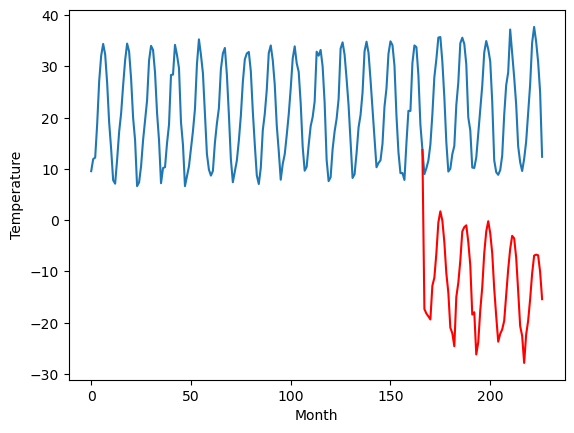

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.28		0.48		-4.80
4.03		-0.39		-4.42
3.40		-0.95		-4.35
5.42		-1.54		-6.96
4.86		5.03		0.17
8.48		6.61		-1.87
10.88		11.35		0.47
13.42		17.37		3.95
12.61		19.55		6.94
14.49		17.74		3.25
13.91		13.52		-0.39
11.69		7.46		-4.23
4.53		3.68		-0.85
2.48		-3.15		-5.63
3.70		-4.23		-7.93
4.63		-6.77		-11.40
4.41		2.84		-1.57
6.60		5.61		-0.99
10.89		9.90		-0.99
12.59		15.62		3.03
11.77		16.46		4.69
12.32		16.82		4.50
11.77		13.56		1.79
9.01		9.03		0.02
6.19		-0.60		-6.79
2.49		-0.14		-2.63
3.11		-8.38		-11.49
4.07		-5.95		-10.02
6.30		0.22		-6.08
7.74		4.76		-2.98
10.73		11.39		0.66
13.88		15.63		1.75
12.23		17.62		5.39
13.65		15.28		1.63
13.88		11.38		-2.50
9.15		4.43		-4.72
3.42		-0.92		-4.34
2.22		-5.88		-8.10
3.89		-4.35		-8.24
2.09		-3.49		-5.58
3.55		-1.80		-5.35
7.63		3.24		-4.39
8.66		8.24		-0.42
10.56		12.22		1.66
13.57		14.77		1.20
14.60		14.26		-0.34
11.99		10.54		-1.45
10.53		4.01		-6.52


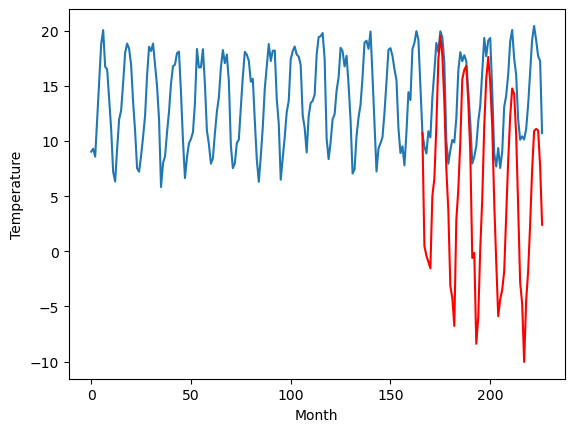

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.63		-0.05		-0.68
-2.13		-0.92		1.21
-2.10		-1.48		0.62
-1.66		-2.07		-0.41
1.92		4.50		2.58
3.36		6.08		2.72
8.92		10.82		1.90
15.90		16.84		0.94
19.85		19.02		-0.83
18.67		17.21		-1.46
14.33		12.99		-1.34
9.01		6.93		-2.08
4.94		3.15		-1.79
-1.40		-3.68		-2.28
-4.42		-4.76		-0.34
-4.54		-7.30		-2.76
0.46		2.31		1.85
5.08		5.08		-0.00
9.91		9.37		-0.54
15.78		15.09		-0.69
17.92		15.93		-1.99
18.54		16.29		-2.25
15.22		13.03		-2.19
10.78		8.50		-2.28
1.86		-1.13		-2.99
0.26		-0.67		-0.93
-6.29		-8.91		-2.62
-3.53		-6.48		-2.95
0.43		-0.31		-0.74
4.72		4.23		-0.49
10.51		10.86		0.35
14.83		15.10		0.27
19.38		17.09		-2.29
19.30		14.75		-4.55
14.39		10.85		-3.54
8.13		3.90		-4.23
4.17		-1.45		-5.62
-2.19		-6.41		-4.22
-0.21		-4.88		-4.67
-1.94		-4.02		-2.08
0.03		-2.33		-2.36
6.08		2.71		-3.37
9.72		7.71		-2.01
13.71		11.69		-2.02
19.39		14.24		-5.15
17.14		13.73		-3.41
14.57		10.01		-4.56
9.1

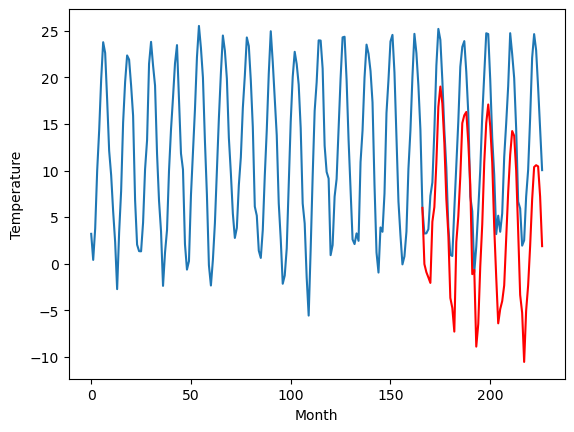

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-5.89		0.57
-9.42		-6.76		2.66
-9.01		-7.32		1.69
-8.09		-7.91		0.18
-3.68		-1.34		2.34
-1.74		0.24		1.98
4.03		4.98		0.95
10.75		11.00		0.25
14.52		13.18		-1.34
12.65		11.37		-1.28
7.68		7.15		-0.53
2.19		1.09		-1.10
-2.09		-2.69		-0.60
-8.91		-9.52		-0.61
-10.47		-10.60		-0.13
-11.27		-13.14		-1.87
-4.08		-3.53		0.55
0.79		-0.76		-1.55
5.05		3.53		-1.52
11.22		9.25		-1.97
12.86		10.09		-2.77
12.59		10.45		-2.14
8.33		7.19		-1.14
4.21		2.66		-1.55
-6.01		-6.97		-0.96
-6.42		-6.51		-0.09
-13.40		-14.75		-1.35
-9.59		-12.32		-2.73
-4.41		-6.15		-1.74
-0.59		-1.61		-1.02
6.19		5.02		-1.17
10.18		9.26		-0.92
13.96		11.25		-2.71
13.09		8.91		-4.18
7.86		5.01		-2.85
0.25		-1.94		-2.19
-2.87		-7.29		-4.42
-9.90		-12.25		-2.35
-7.25		-10.72		-3.47
-7.04		-9.86		-2.82
-5.48		-8.17		-2.69
2.09		-3.13		-5.22
4.56		1.87		-2.69
8.49		5.85		-2.64
13.33		8.40		-4.93
11.36		7.89		-3.47
8.07		4.17		-

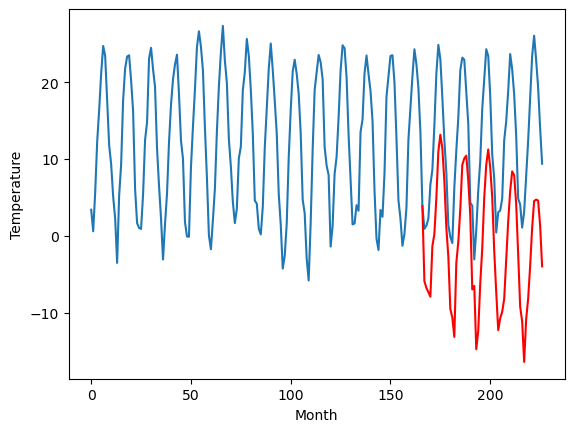

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -6.46  -5.890277
1                 1    2.22  -0.190303
2                 2    2.71  -2.070292
3                 3   -2.86  -1.440288
4                 4    3.31  -2.520303
5                 5   -5.82  -4.840299
6                 6   -6.46  -3.760294
7                 7  -13.16 -17.330292
8                 8    5.28   0.479715
9                 9    0.63  -0.050285
10               10   -6.46  -5.890284


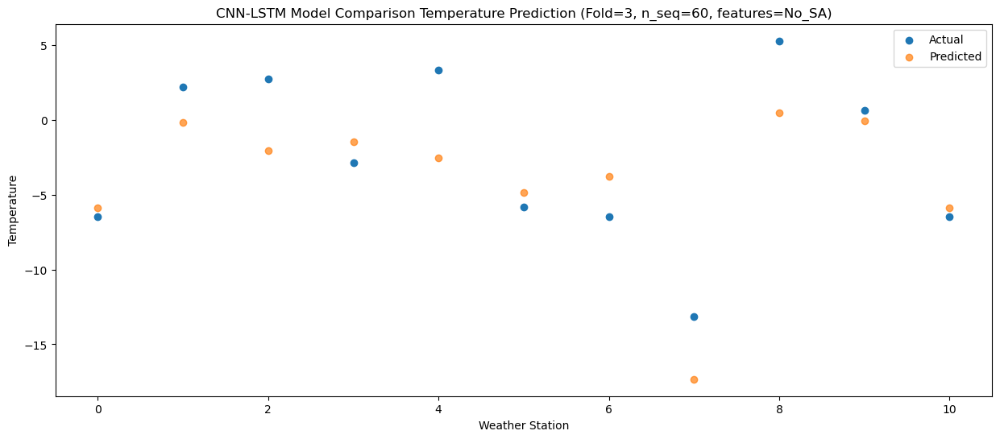

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -7.24  -6.763740
1                 1    0.87  -1.063775
2                 2    0.18  -2.943772
3                 3   -2.85  -2.313749
4                 4    0.05  -3.393771
5                 5   -5.61  -5.713760
6                 6  -12.13  -4.633772
7                 7  -17.89 -18.203768
8                 8    4.03  -0.393758
9                 9   -2.13  -0.923742
10               10   -9.42  -6.763740


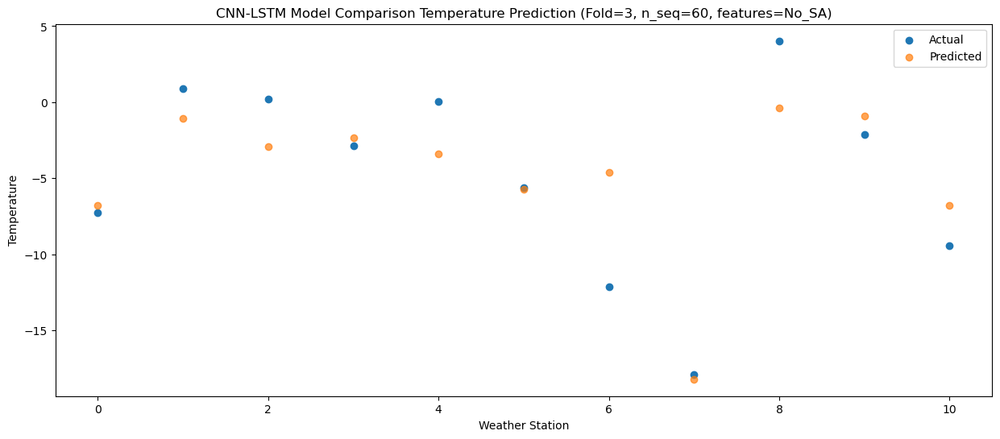

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.66  -7.320008
1                 1    0.03  -1.619984
2                 2   -1.04  -3.500011
3                 3   -3.40  -2.869983
4                 4   -2.82  -3.949965
5                 5   -7.03  -6.269968
6                 6  -12.22  -5.190003
7                 7  -16.73 -18.760003
8                 8    3.40  -0.950009
9                 9   -2.10  -1.479989
10               10   -9.01  -7.319985


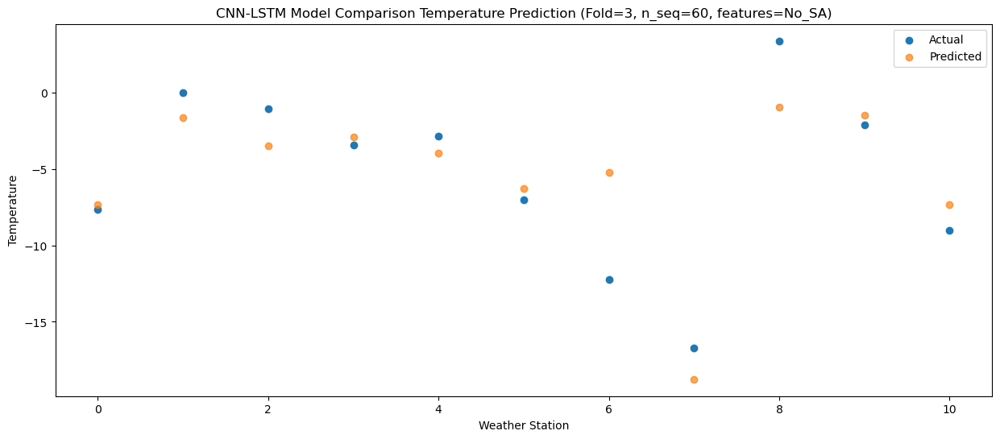

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.65  -7.912045
1                 1    0.18  -2.212080
2                 2    1.38  -4.092078
3                 3   -3.75  -3.462050
4                 4   -1.67  -4.542068
5                 5   -7.44  -6.862063
6                 6  -12.03  -5.782077
7                 7  -15.22 -19.352077
8                 8    5.42  -1.542067
9                 9   -1.66  -2.072051
10               10   -8.09  -7.912049


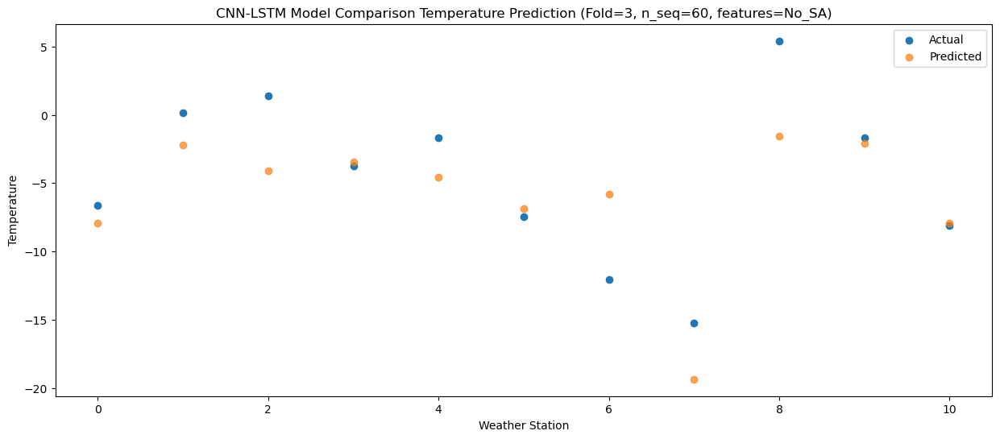

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.39  -1.336090
1                 1    7.67   4.363881
2                 2    3.17   2.483882
3                 3    3.16   3.113909
4                 4    5.74   2.033896
5                 5   -0.58  -0.286099
6                 6   -7.10   0.793884
7                 7  -12.11 -12.776110
8                 8    4.86   5.033895
9                 9    1.92   4.503913
10               10   -3.68  -1.336085


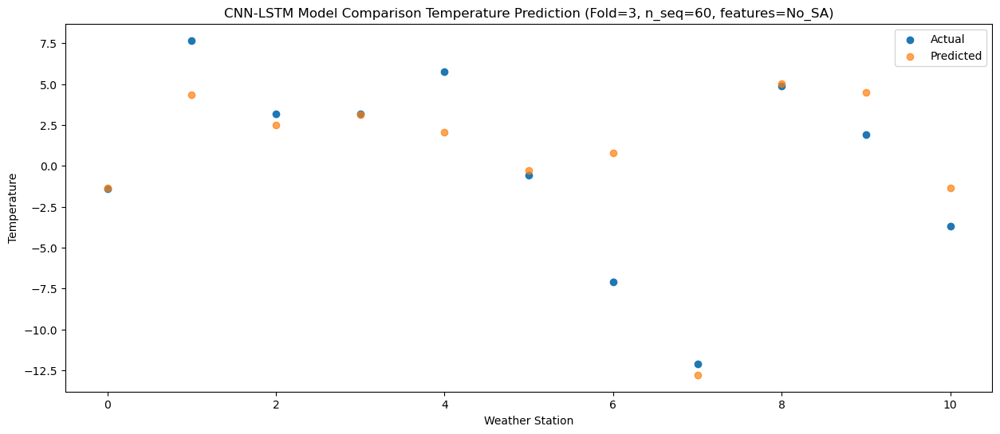

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -0.32   0.238280
1                 1    8.59   5.938219
2                 2    7.83   4.058228
3                 3    3.80   4.688269
4                 4    8.77   3.608240
5                 5    1.69   1.288250
6                 6   -4.12   2.368227
7                 7   -6.20 -11.201769
8                 8    8.48   6.608248
9                 9    3.36   6.078281
10               10   -1.74   0.238280


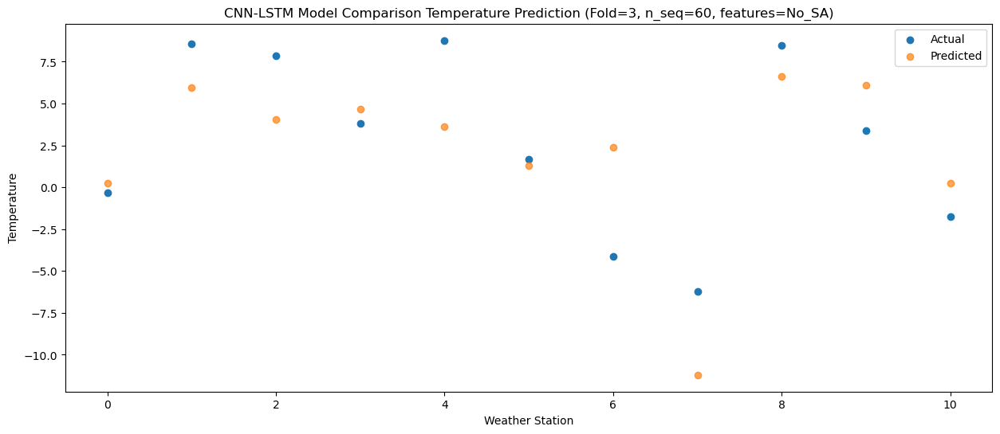

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.37   4.979839
1                 1   12.99  10.679793
2                 2   13.02   8.799770
3                 3    8.37   9.429859
4                 4   14.84   8.349845
5                 5    7.10   6.029851
6                 6    2.99   7.109781
7                 7    1.07  -6.460217
8                 8   10.88  11.349795
9                 9    8.92  10.819873
10               10    4.03   4.979871


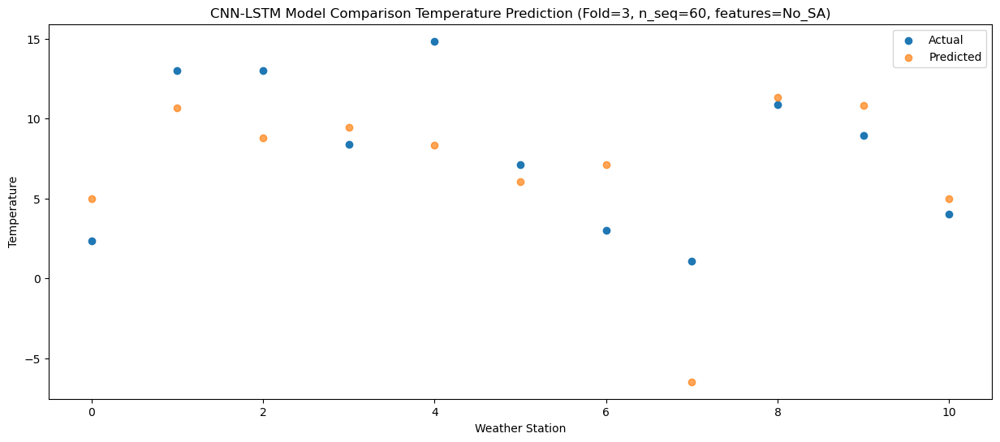

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.69  11.002115
1                 1   20.09  16.702116
2                 2   16.37  14.822055
3                 3   14.19  15.452174
4                 4   21.89  14.372192
5                 5   14.09  12.052185
6                 6    7.20  13.132080
7                 7    4.53  -0.437922
8                 8   13.42  17.372082
9                 9   15.90  16.842188
10               10   10.75  11.002188


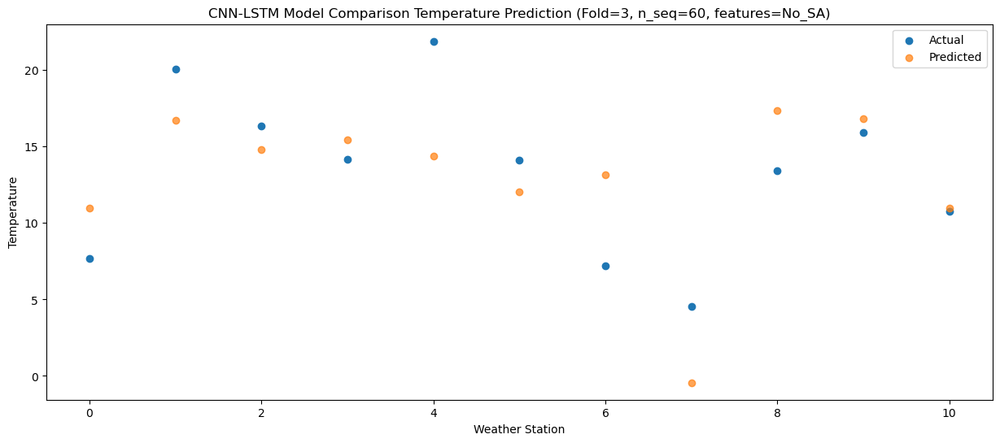

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.55  13.177464
1                 1   21.95  18.877461
2                 2   19.15  16.997378
3                 3   17.99  17.627534
4                 4   23.35  16.547554
5                 5   15.98  14.227553
6                 6    9.19  15.307406
7                 7    8.76   1.737404
8                 8   12.61  19.547412
9                 9   19.85  19.017556
10               10   14.52  13.177556


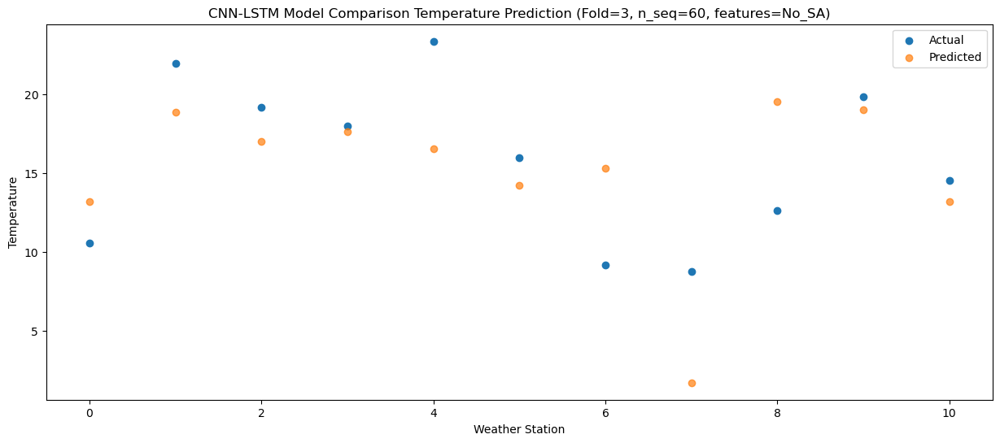

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.32  11.366422
1                 1   20.09  17.066457
2                 2   19.68  15.186365
3                 3   15.57  15.816517
4                 4   20.79  14.736555
5                 5   13.47  12.416546
6                 6    9.94  13.496392
7                 7    8.87  -0.073612
8                 8   14.49  17.736390
9                 9   18.67  17.206535
10               10   12.65  11.366533


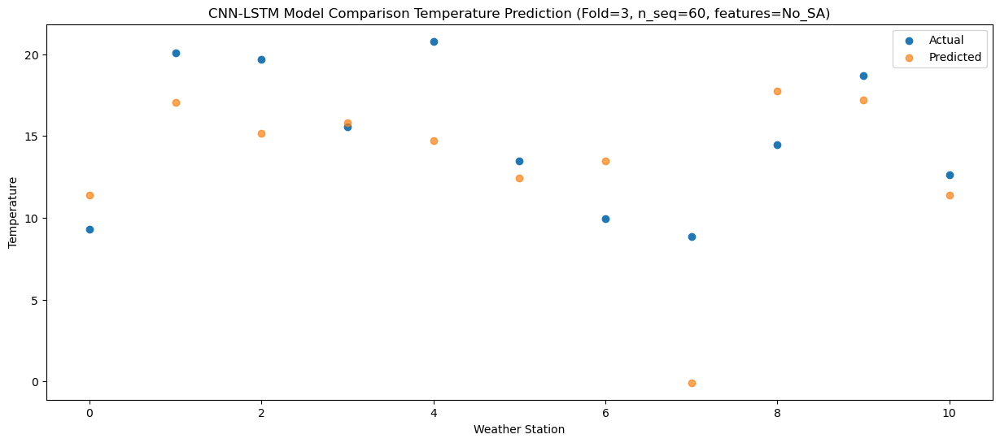

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    5.35   7.145333
1                 1   16.42  12.845351
2                 2   15.35  10.965245
3                 3   11.51  11.595437
4                 4   16.72  10.515470
5                 5    9.84   8.195468
6                 6    4.44   9.275280
7                 7    4.06  -4.294726
8                 8   13.91  13.515280
9                 9   14.33  12.985463
10               10    7.68   7.145458


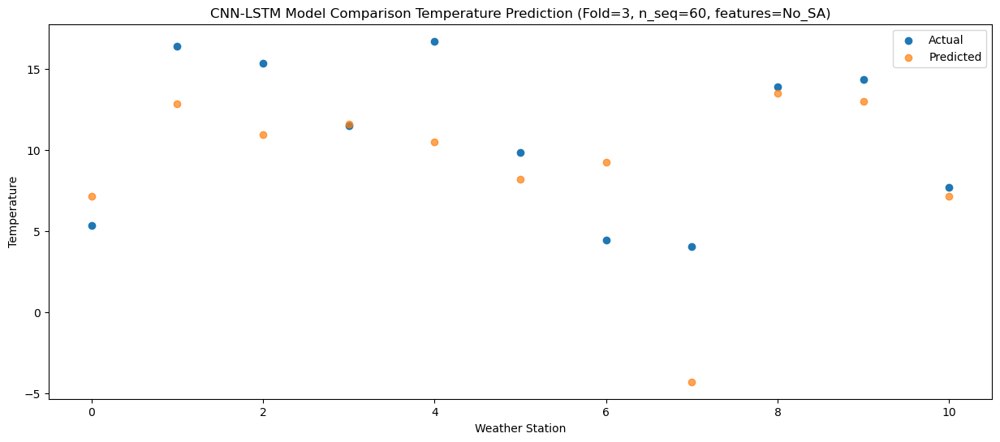

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    1.78   1.092137
1                 1    9.31   6.792200
2                 2    9.86   4.912075
3                 3    6.09   5.542270
4                 4    8.99   4.462327
5                 5    3.84   2.142313
6                 6    0.70   3.222116
7                 7   -2.88 -10.347895
8                 8   11.69   7.462101
9                 9    9.01   6.932285
10               10    2.19   1.092283


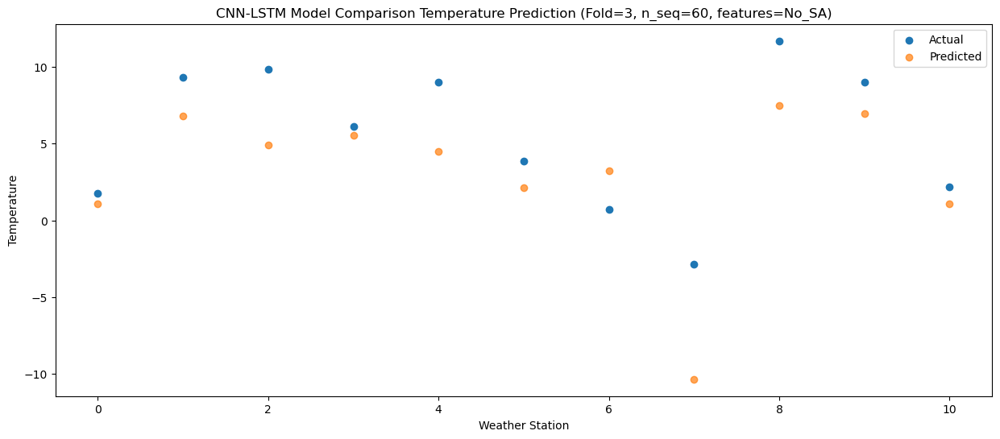

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -2.64  -2.687188
1                 1    6.49   3.012868
2                 2    1.21   1.132745
3                 3    2.17   1.762939
4                 4    6.17   0.682993
5                 5   -0.10  -1.637021
6                 6   -6.49  -0.557214
7                 7  -11.69 -14.127223
8                 8    4.53   3.682769
9                 9    4.94   3.152953
10               10   -2.09  -2.687049


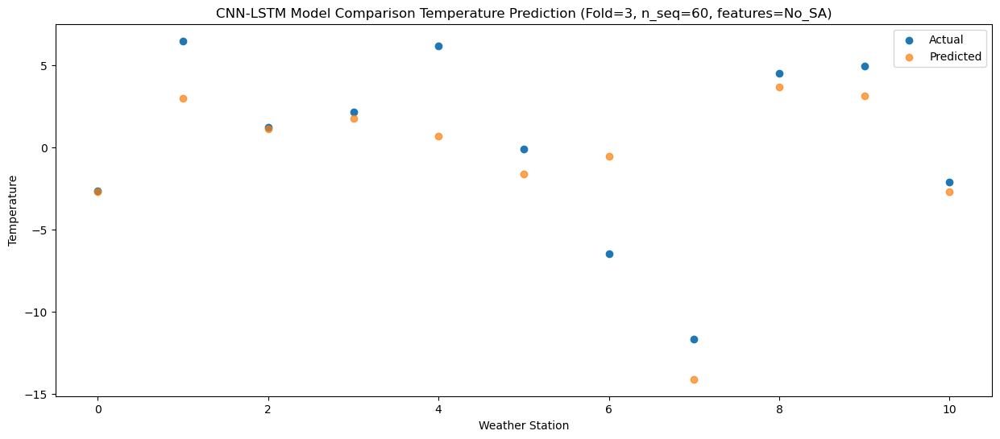

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -9.82  -9.523706
1                 1   -0.06  -3.823699
2                 2   -1.99  -5.703800
3                 3   -5.03  -5.073608
4                 4   -1.00  -6.153584
5                 5   -7.71  -8.473589
6                 6  -12.19  -7.393765
7                 7  -17.38 -20.963774
8                 8    2.48  -3.153768
9                 9   -1.40  -3.683589
10               10   -8.91  -9.523590


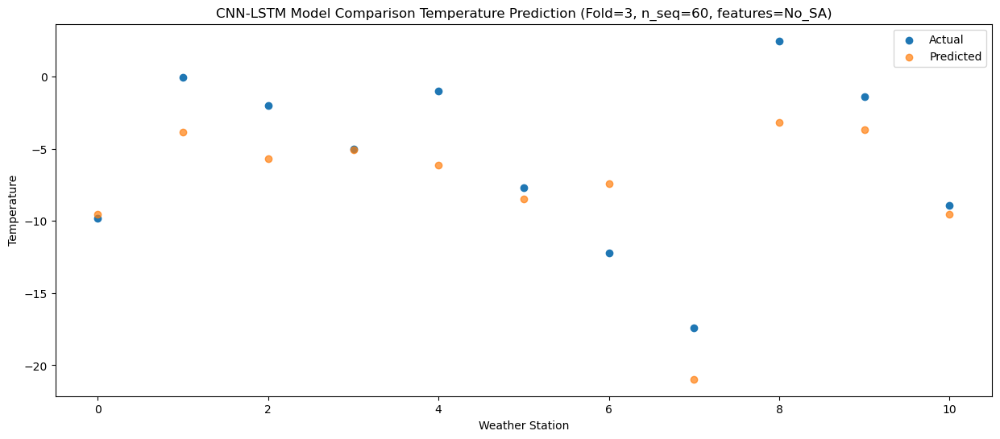

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -10.10 -10.603613
1                 1   -1.21  -4.903587
2                 2   -0.73  -6.783701
3                 3   -6.49  -6.153498
4                 4   -2.47  -7.233461
5                 5   -9.16  -9.553466
6                 6  -11.92  -8.473664
7                 7  -16.83 -22.043677
8                 8    3.70  -4.233674
9                 9   -4.42  -4.763481
10               10  -10.47 -10.603479


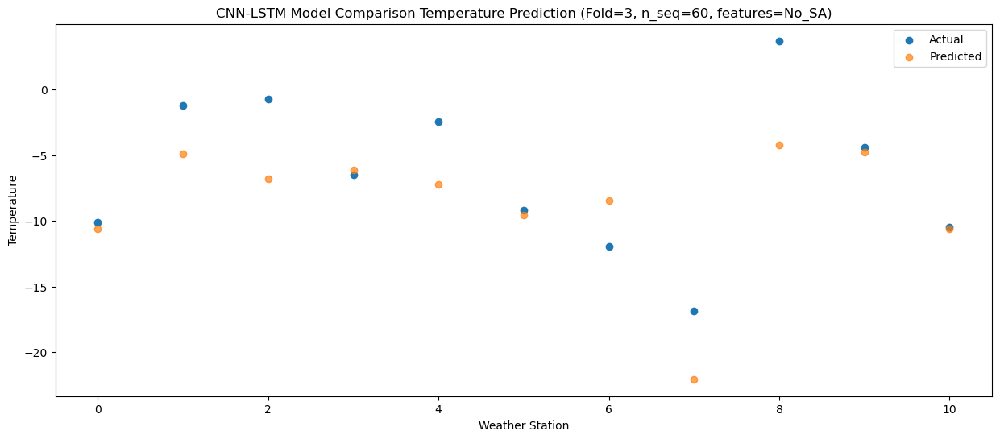

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.73 -13.141341
1                 1   -4.93  -7.441316
2                 2    1.57  -9.321437
3                 3   -7.81  -8.691217
4                 4   -6.34  -9.771180
5                 5  -11.88 -12.091186
6                 6  -11.82 -11.011393
7                 7  -13.98 -24.581410
8                 8    4.63  -6.771409
9                 9   -4.54  -7.301192
10               10  -11.27 -13.141192


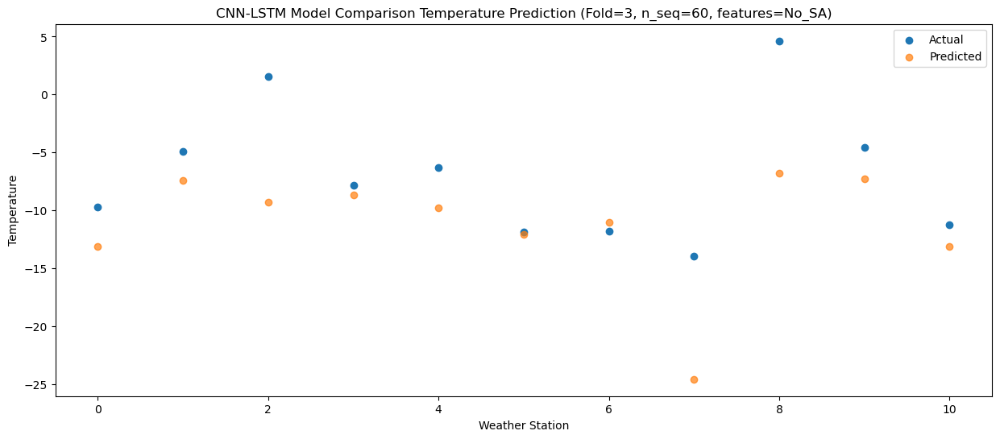

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.93  -3.525403
1                 1    7.04   2.174670
2                 2    2.72   0.294525
3                 3    2.40   0.924750
4                 4    6.74  -0.155186
5                 5   -0.55  -2.475196
6                 6   -8.85  -1.395424
7                 7  -12.38 -14.965442
8                 8    4.41   2.844550
9                 9    0.46   2.314767
10               10   -4.08  -3.525231


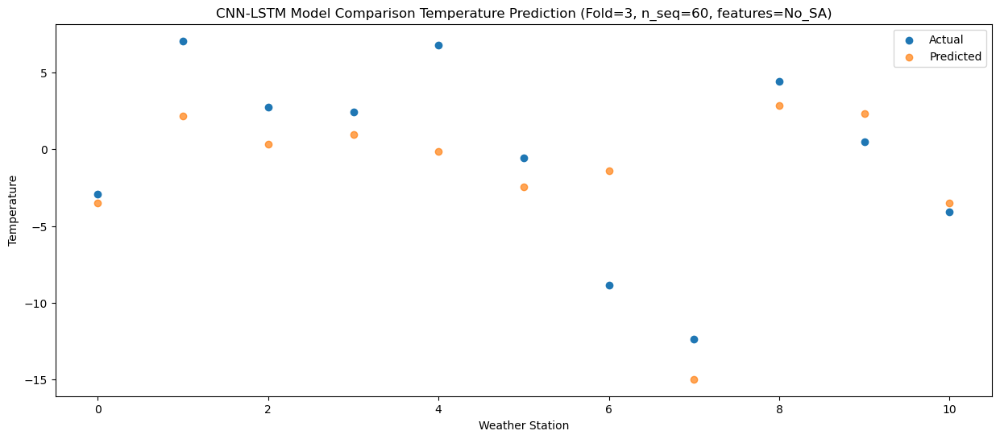

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.23  -0.764520
1                 1    8.90   4.935558
2                 2    8.45   3.055405
3                 3    4.75   3.685642
4                 4   10.03   2.605712
5                 5    2.90   0.285701
6                 6   -4.07   1.365464
7                 7   -4.41 -12.204555
8                 8    6.60   5.605431
9                 9    5.08   5.075657
10               10    0.79  -0.764341


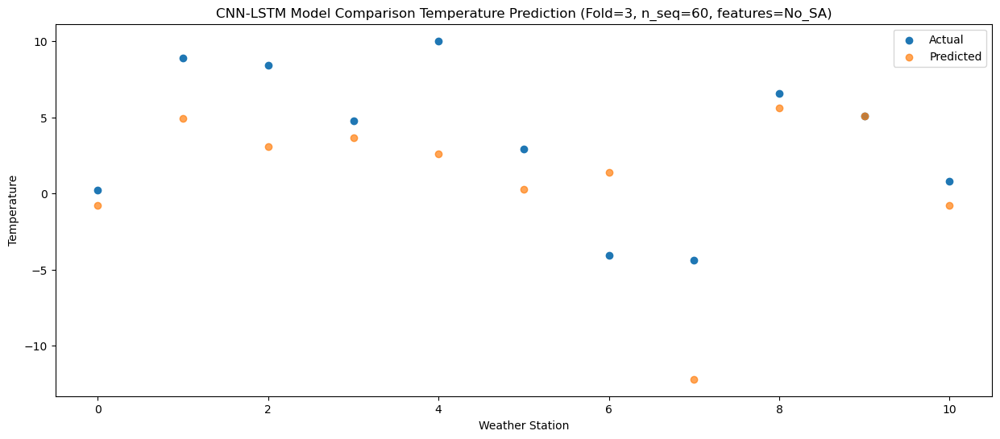

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.89   3.527713
1                 1   13.12   9.227769
2                 2   13.25   7.347609
3                 3    8.82   7.977872
4                 4   14.60   6.897934
5                 5    7.18   4.577927
6                 6    0.98   5.657675
7                 7    0.02  -7.912348
8                 8   10.89   9.897638
9                 9    9.91   9.367898
10               10    5.05   3.527897


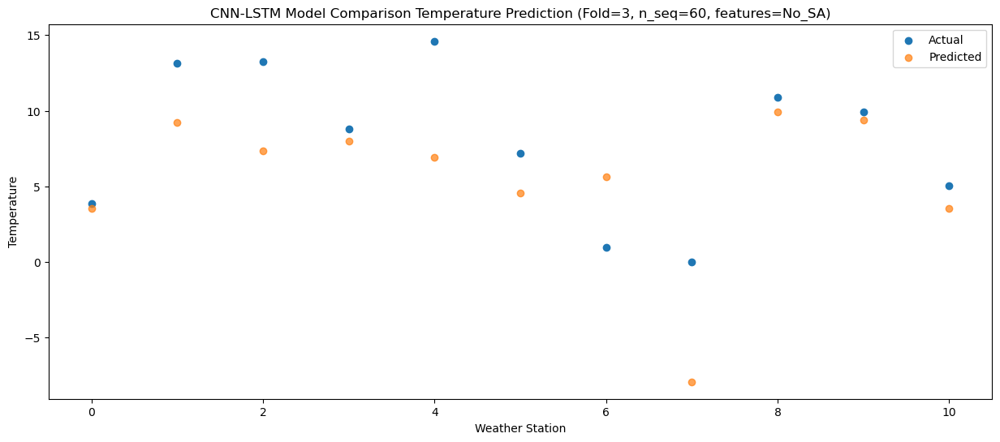

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.95   9.248603
1                 1   19.83  14.948614
2                 2   18.10  13.068475
3                 3   14.74  13.698746
4                 4   22.08  12.618777
5                 5   13.89  10.298777
6                 6    8.37  11.378538
7                 7    7.66  -2.191485
8                 8   12.59  15.618514
9                 9   15.78  15.088778
10               10   11.22   9.248779


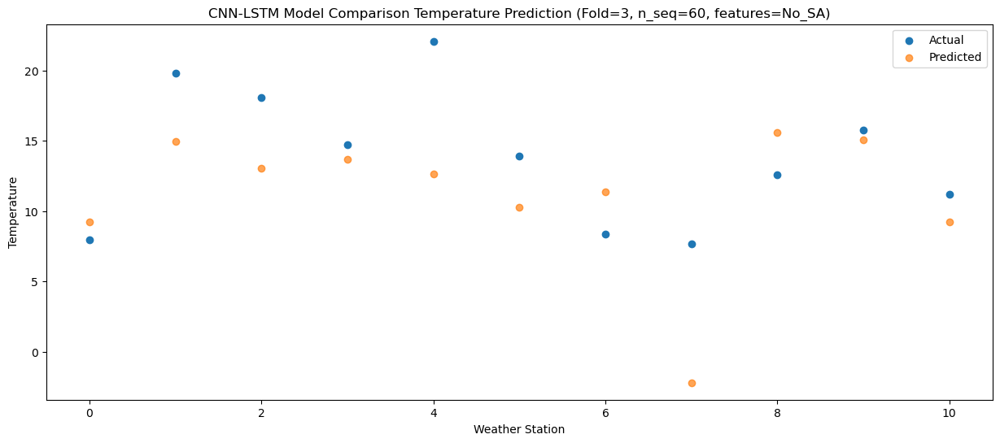

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.66  10.093675
1                 1   21.14  15.793664
2                 2   21.23  13.913535
3                 3   15.73  14.543807
4                 4   22.08  13.463815
5                 5   14.27  11.143825
6                 6   10.21  12.223595
7                 7    8.74  -1.346427
8                 8   11.77  16.463580
9                 9   17.92  15.933836
10               10   12.86  10.093834


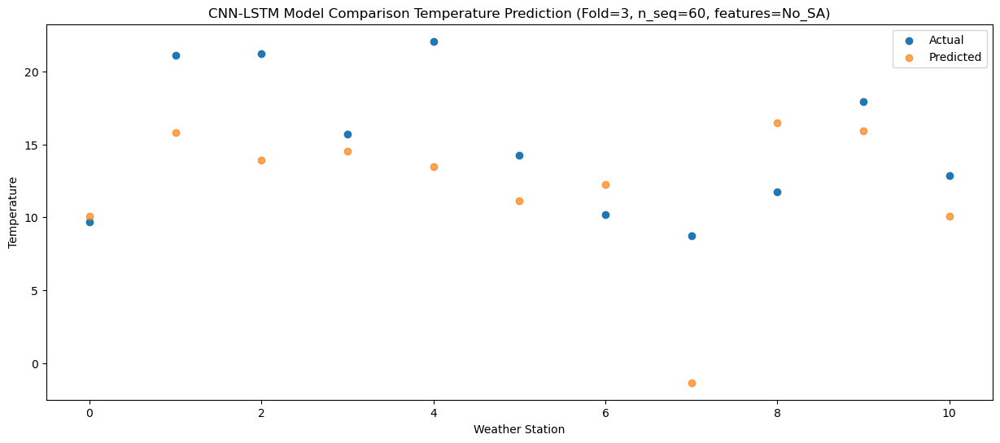

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.88  10.447932
1                 1   21.71  16.147893
2                 2   19.03  14.267762
3                 3   16.25  14.898053
4                 4   22.20  13.818046
5                 5   14.59  11.498058
6                 6    8.29  12.577826
7                 7    7.51  -0.992197
8                 8   12.32  16.817816
9                 9   18.54  16.288084
10               10   12.59  10.448078


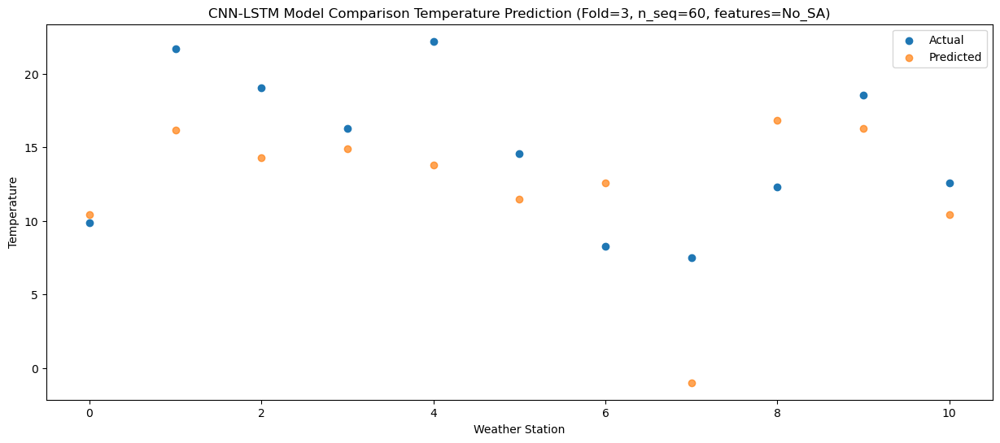

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.89   7.188184
1                 1   18.98  12.888072
2                 2   15.72  11.007986
3                 3   12.12  11.638259
4                 4   18.84  10.558200
5                 5   11.33   8.238226
6                 6    6.42   9.318039
7                 7    3.54  -4.251980
8                 8   11.77  13.558050
9                 9   15.22  13.028295
10               10    8.33   7.188285


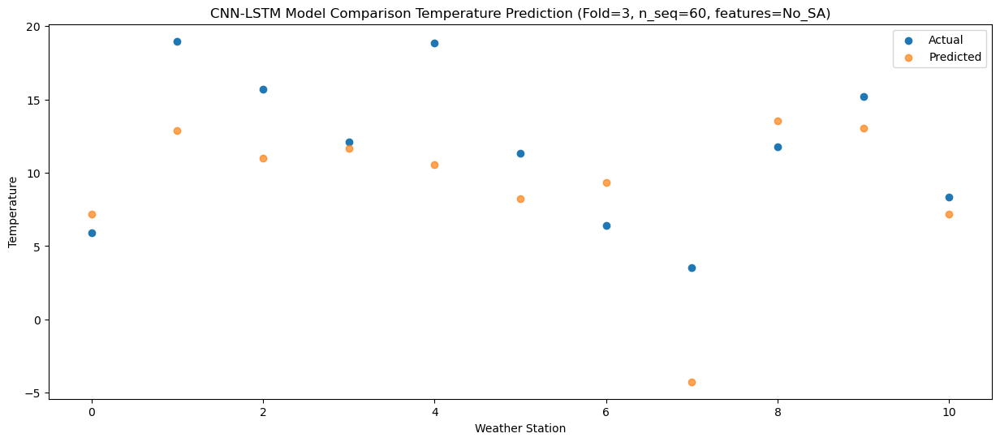

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    2.66   2.662324
1                 1   12.38   8.362246
2                 2    7.06   6.482137
3                 3    8.54   7.112420
4                 4   13.42   6.032387
5                 5    6.75   3.712404
6                 6   -1.55   4.792196
7                 7   -6.81  -8.777825
8                 8    9.01   9.032196
9                 9   10.78   8.502451
10               10    4.21   2.662442


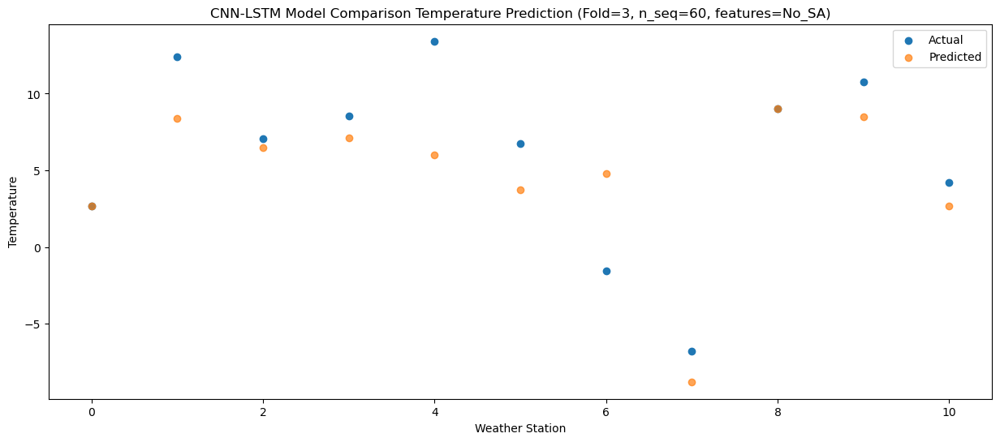

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -6.10  -6.973008
1                 1    4.67  -1.273071
2                 2    2.72  -3.153195
3                 3   -1.12  -2.522899
4                 4    3.68  -3.602922
5                 5   -4.10  -5.922908
6                 6   -4.29  -4.843134
7                 7   -9.33 -18.413156
8                 8    6.19  -0.603137
9                 9    1.86  -1.132868
10               10   -6.01  -6.972879


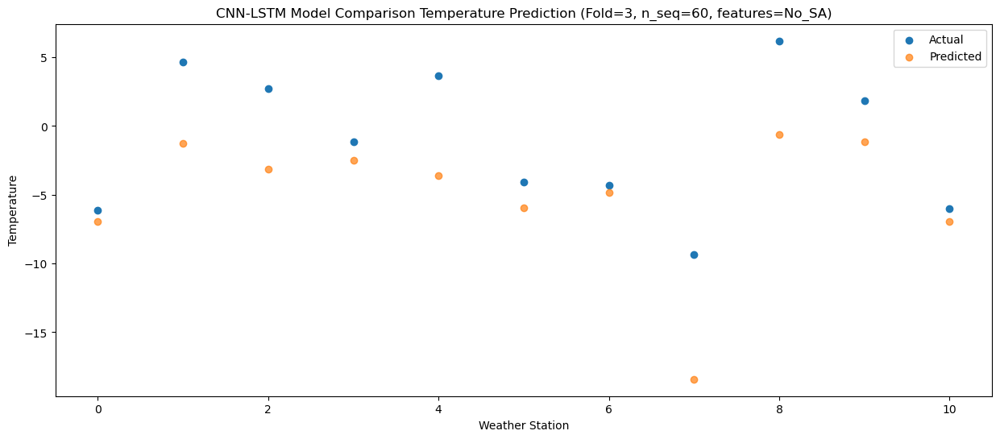

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -4.14  -6.512385
1                 1    5.98  -0.812429
2                 2   -1.20  -2.692548
3                 3    0.37  -2.062279
4                 4    3.32  -3.142297
5                 5   -3.05  -5.462286
6                 6   -9.05  -4.382488
7                 7  -16.60 -17.952508
8                 8    2.49  -0.142499
9                 9    0.26  -0.672257
10               10   -6.42  -6.512265


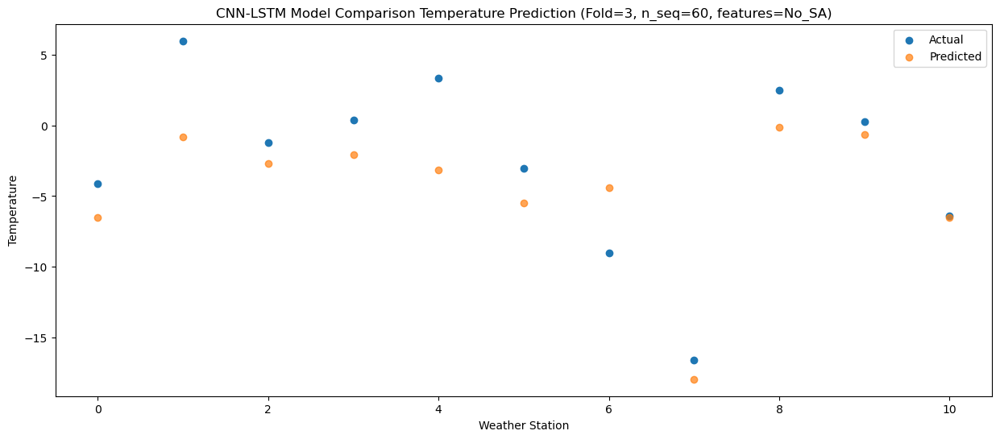

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.98 -14.752586
1                 1   -2.85  -9.052602
2                 2   -1.53 -10.932735
3                 3   -8.58 -10.302462
4                 4   -6.15 -11.382460
5                 5  -11.87 -13.702456
6                 6  -11.34 -12.622673
7                 7  -16.67 -26.192693
8                 8    3.11  -8.382696
9                 9   -6.29  -8.912443
10               10  -13.40 -14.752448


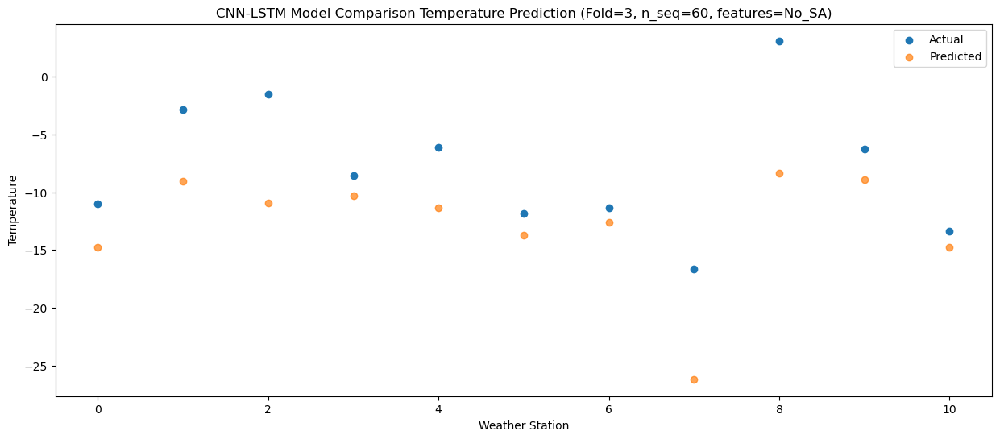

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -6.60 -12.323362
1                 1   -1.63  -6.623380
2                 2    0.17  -8.503531
3                 3   -4.06  -7.873221
4                 4   -3.63  -8.953214
5                 5   -8.68 -11.273211
6                 6  -13.06 -10.193458
7                 7  -14.63 -23.763482
8                 8    4.07  -5.953485
9                 9   -3.53  -6.483201
10               10   -9.59 -12.323205


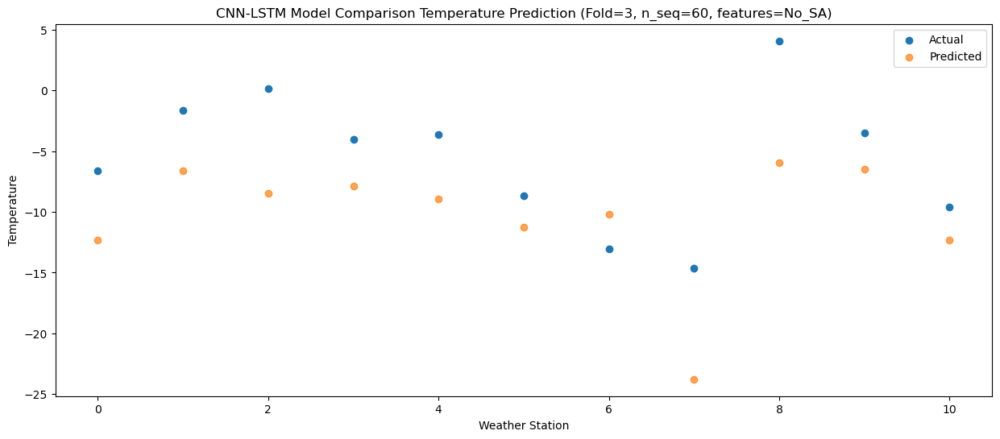

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.54  -6.147921
1                 1    5.15  -0.447938
2                 2    4.88  -2.328080
3                 3    1.69  -1.697793
4                 4    4.83  -2.777784
5                 5   -1.72  -5.097788
6                 6   -8.52  -4.018006
7                 7   -9.92 -17.588030
8                 8    6.30   0.221969
9                 9    0.43  -0.307772
10               10   -4.41  -6.147778


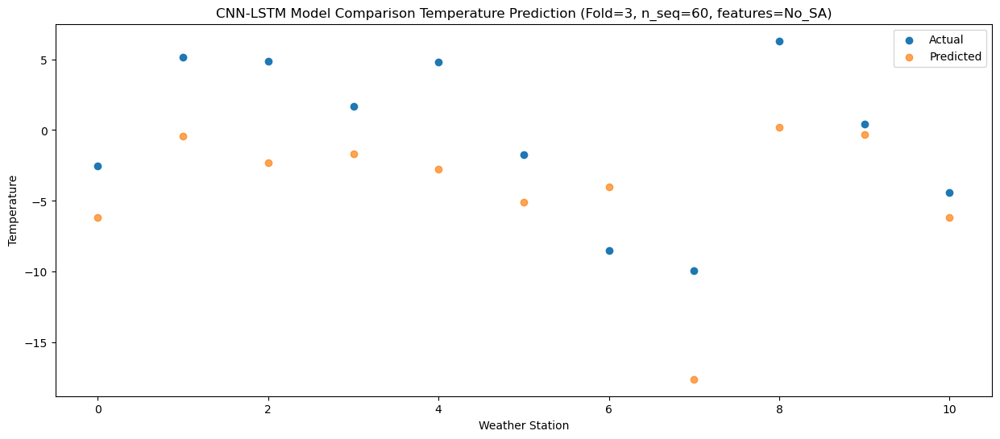

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.56  -1.614326
1                 1   10.00   4.085590
2                 2    7.95   2.205469
3                 3    4.70   2.835772
4                 4    8.96   1.755741
5                 5    2.13  -0.564249
6                 6   -4.20   0.515544
7                 7   -5.29 -13.054482
8                 8    7.74   4.755538
9                 9    4.72   4.225806
10               10   -0.59  -1.614201


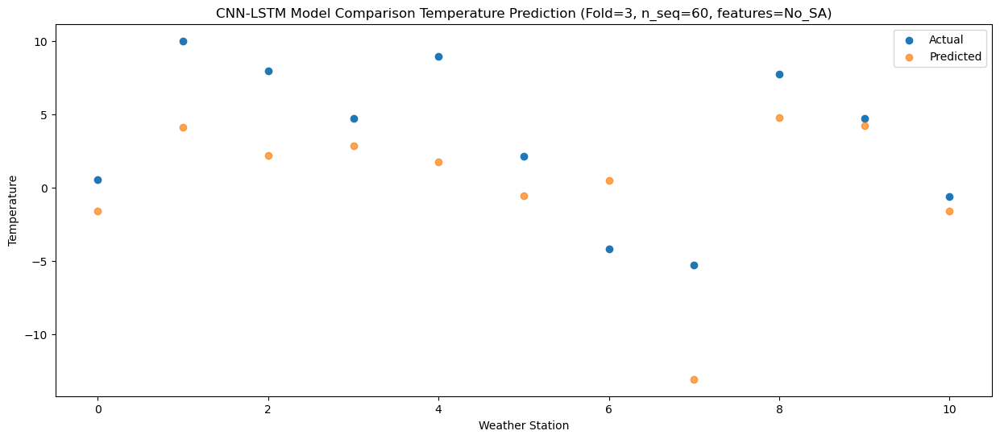

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.40   5.018328
1                 1   15.43  10.718204
2                 2   12.19   8.838087
3                 3   11.48   9.468426
4                 4   16.53   8.388363
5                 5    9.93   6.068387
6                 6    1.71   7.148164
7                 7   -0.62  -6.421856
8                 8   10.73  11.388173
9                 9   10.51  10.858470
10               10    6.19   5.018458


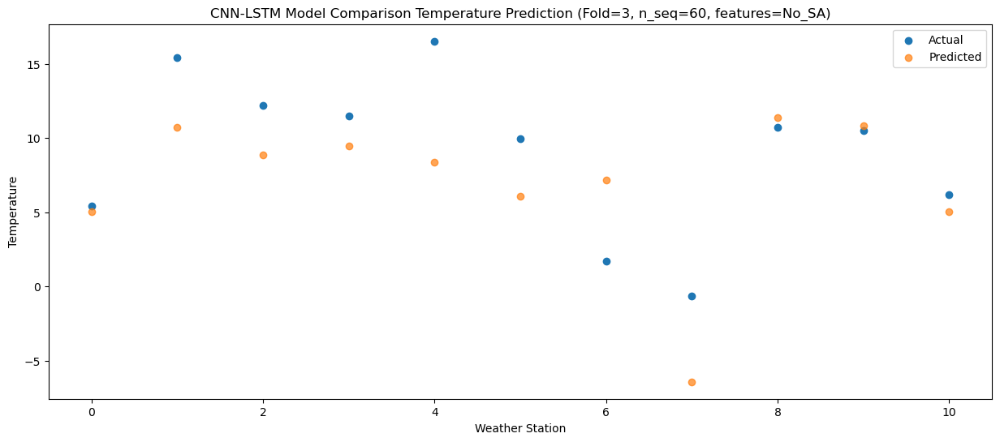

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.36   9.257339
1                 1   20.58  14.957199
2                 2   17.58  13.077098
3                 3   14.96  13.707427
4                 4   21.98  12.627348
5                 5   13.87  10.307376
6                 6    7.48  11.387171
7                 7    5.86  -2.182853
8                 8   13.88  15.627188
9                 9   14.83  15.097471
10               10   10.18   9.257461


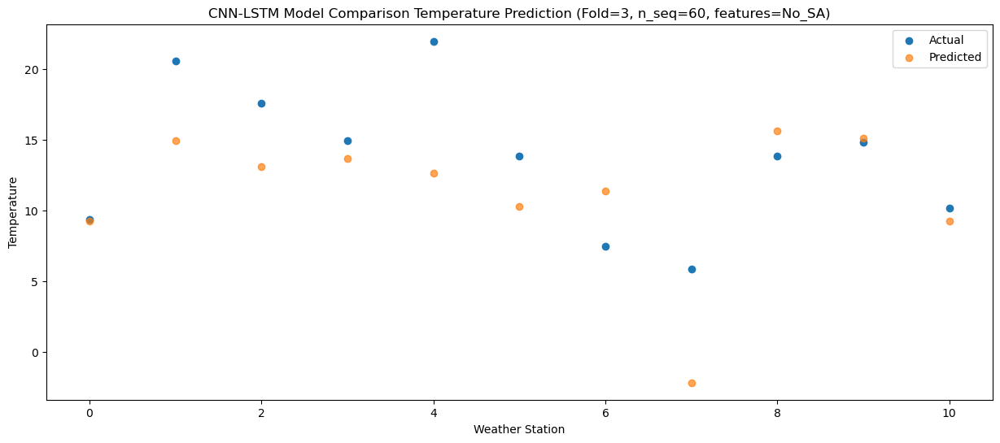

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.13  11.252434
1                 1   24.62  16.952298
2                 2   20.15  15.072177
3                 3   16.51  15.702537
4                 4   23.10  14.622461
5                 5   15.86  12.302494
6                 6    9.40  13.382264
7                 7    8.09  -0.187766
8                 8   12.23  17.622273
9                 9   19.38  17.092589
10               10   13.96  11.252571


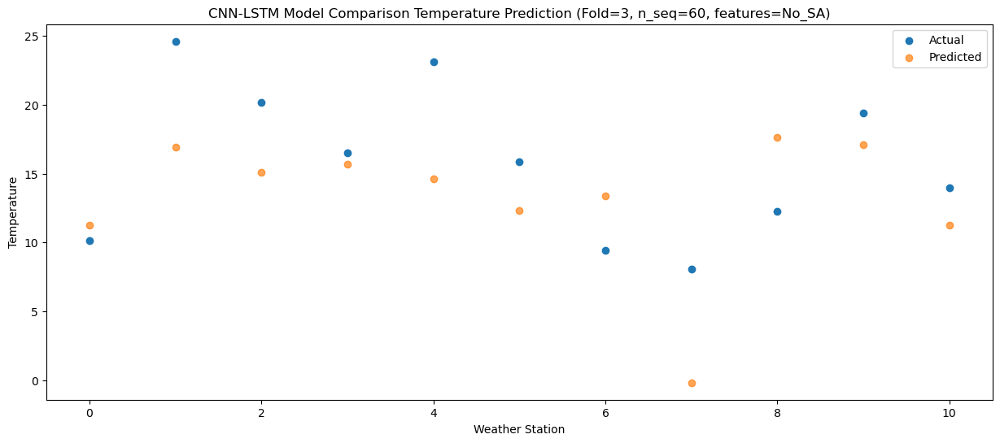

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    9.22   8.912365
1                 1   21.54  14.612168
2                 2   20.33  12.732075
3                 3   15.44  13.362442
4                 4   21.28  12.282329
5                 5   14.21   9.962374
6                 6    8.64  11.042154
7                 7    6.50  -2.527880
8                 8   13.65  15.282180
9                 9   19.30  14.752503
10               10   13.09   8.912487


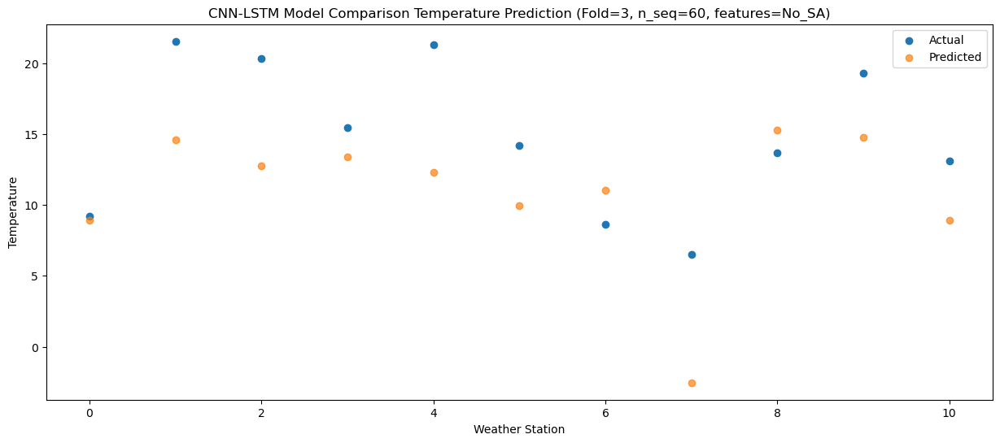

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.01   5.011663
1                 1   17.68  10.711417
2                 2   17.51   8.831339
3                 3   11.46   9.461721
4                 4   16.96   8.381577
5                 5   10.26   6.061631
6                 6    6.48   7.141417
7                 7    4.14  -6.428619
8                 8   13.88  11.381454
9                 9   14.39  10.851784
10               10    7.86   5.011767


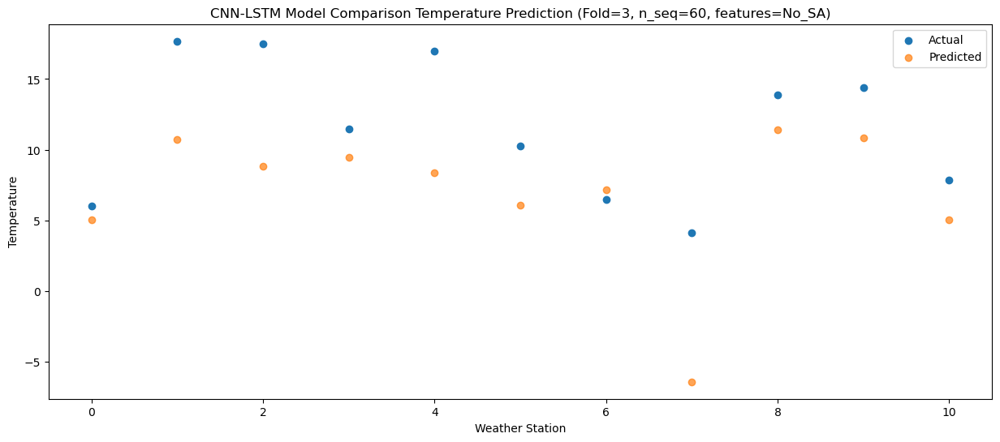

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.00  -1.943335
1                 1   11.13   3.756385
2                 2   10.33   1.876318
3                 3    4.19   2.506706
4                 4    9.69   1.426542
5                 5    4.22  -0.893397
6                 6   -1.78   0.186394
7                 7   -3.75 -13.383640
8                 8    9.15   4.426440
9                 9    8.13   3.896776
10               10    0.25  -1.943243


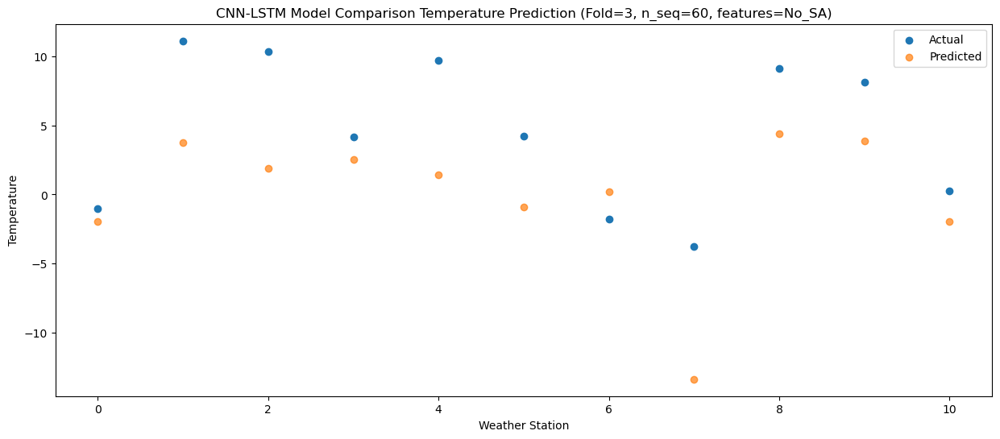

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -3.03  -7.293446
1                 1    3.90  -1.593717
2                 2   -0.40  -3.473777
3                 3    1.07  -2.843410
4                 4    3.80  -3.923572
5                 5   -2.33  -6.243513
6                 6   -9.46  -5.163705
7                 7  -15.17 -18.733735
8                 8    3.42  -0.923659
9                 9    4.17  -1.453340
10               10   -2.87  -7.293359


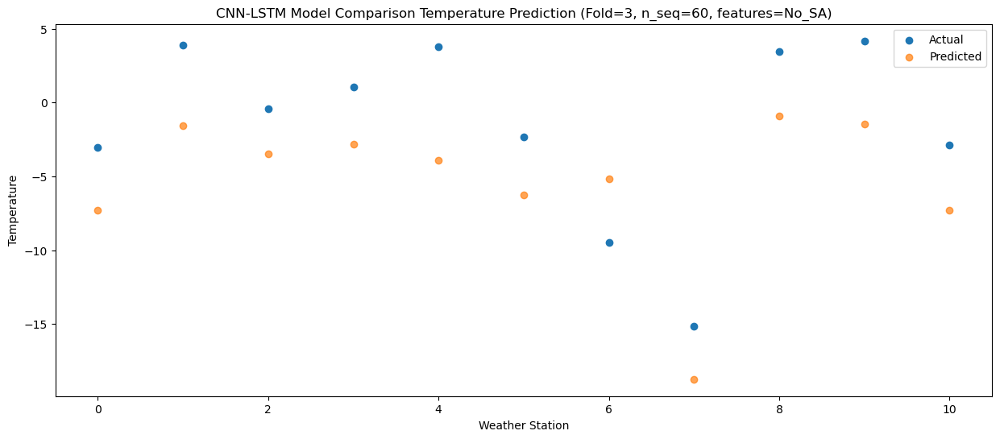

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -9.91 -12.253791
1                 1   -0.15  -6.554052
2                 2   -1.36  -8.434119
3                 3   -4.20  -7.803746
4                 4   -2.17  -8.883899
5                 5   -7.87 -11.203838
6                 6  -11.63 -10.124046
7                 7  -17.50 -23.694081
8                 8    2.22  -5.884001
9                 9   -2.19  -6.413675
10               10   -9.90 -12.253692


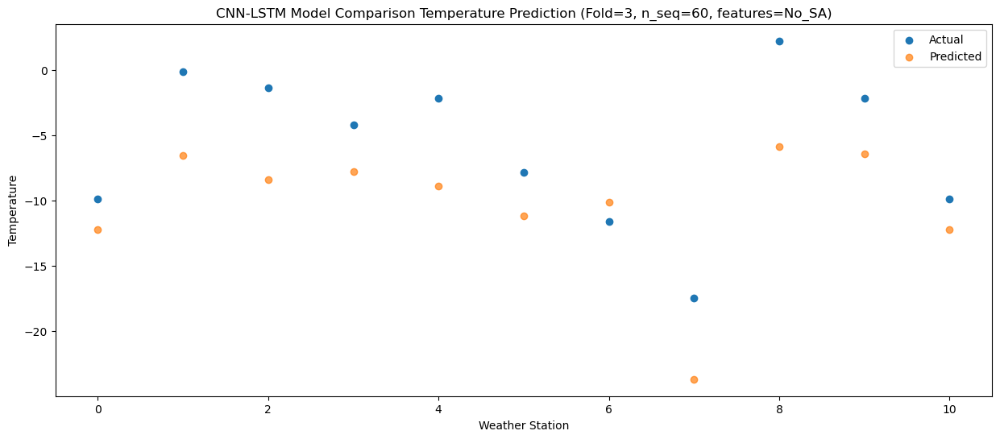

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.49 -10.720028
1                 1    0.55  -5.020432
2                 2    0.03  -6.900431
3                 3   -2.45  -6.270054
4                 4   -0.45  -7.350298
5                 5   -5.73  -9.670211
6                 6  -12.36  -8.590379
7                 7  -18.01 -22.160408
8                 8    3.89  -4.350290
9                 9   -0.21  -4.879960
10               10   -7.25 -10.719985


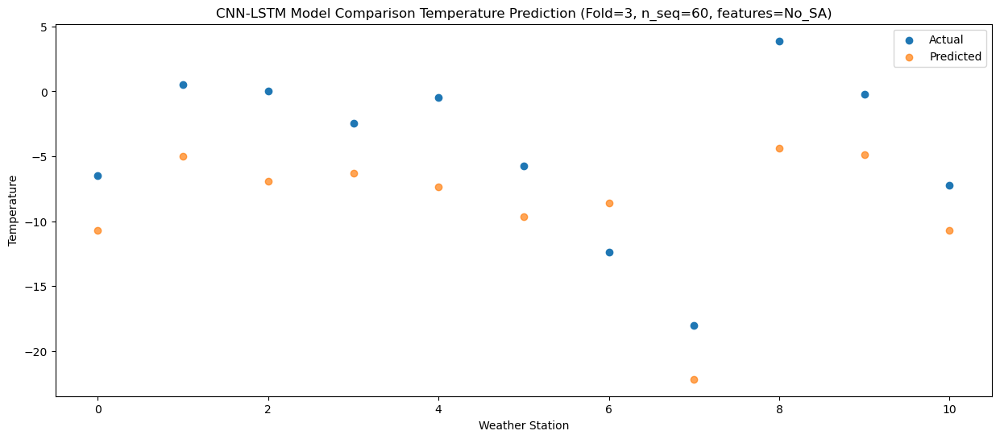

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -3.67  -9.863619
1                 1    2.51  -4.164099
2                 2   -0.82  -6.044069
3                 3   -0.11  -5.413684
4                 4    6.07  -6.493970
5                 5   -4.01  -8.813864
6                 6  -12.33  -7.734021
7                 7  -17.10 -21.304054
8                 8    2.09  -3.493905
9                 9   -1.94  -4.023576
10               10   -7.04  -9.863599


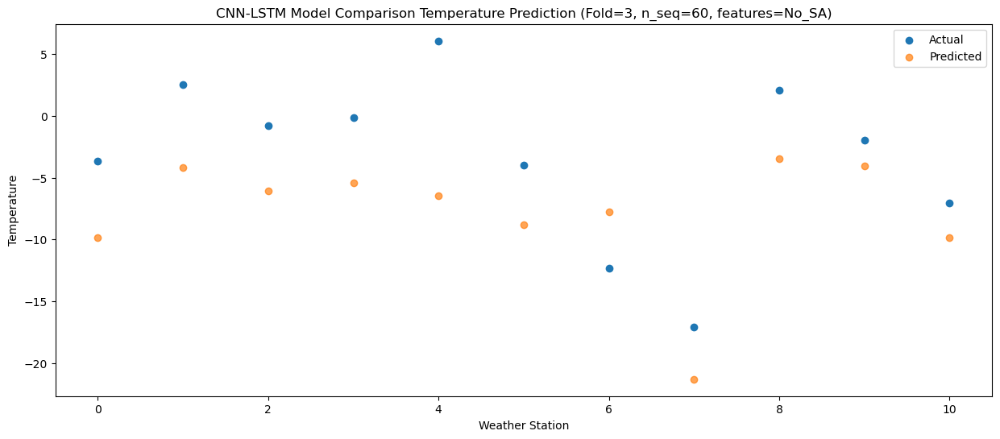

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -8.174403
1                 1    5.11  -2.474962
2                 2    2.05  -4.354885
3                 3    0.13  -3.724517
4                 4    3.11  -4.804851
5                 5   -3.11  -7.124732
6                 6  -10.54  -6.044849
7                 7  -14.27 -19.614878
8                 8    3.55  -1.804711
9                 9    0.03  -2.334398
10               10   -5.48  -8.174423


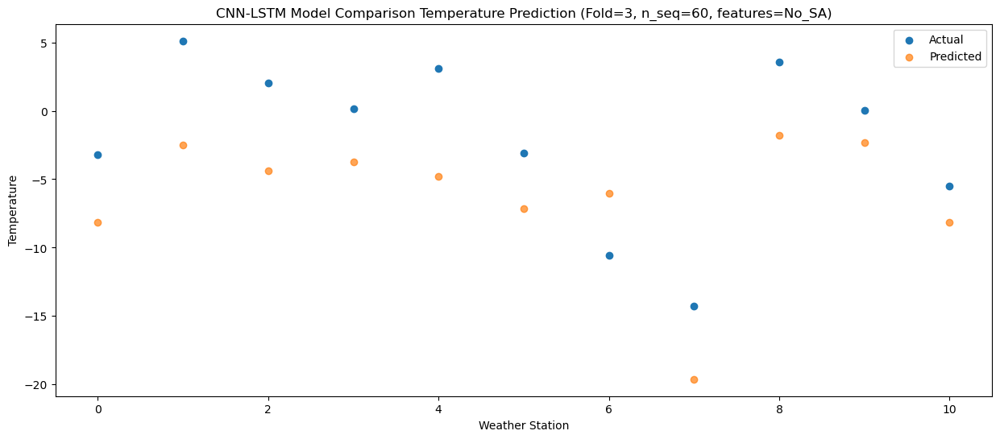

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    0.47  -3.134285
1                 1   10.16   2.565164
2                 2    7.68   0.685245
3                 3    6.37   1.315594
4                 4   10.32   0.235262
5                 5    3.12  -2.084620
6                 6   -5.20  -1.004718
7                 7   -6.32 -14.574746
8                 8    7.63   3.235413
9                 9    6.08   2.705707
10               10    2.09  -3.134316


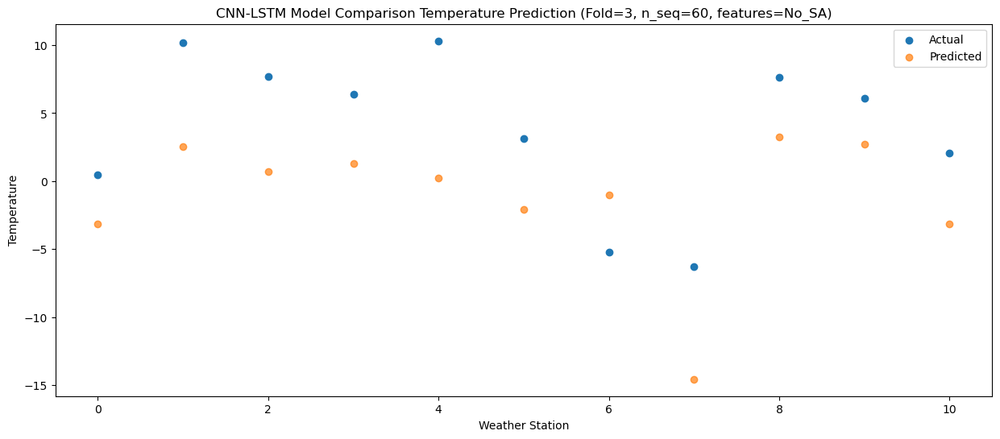

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.83   1.871644
1                 1   15.47   7.571087
2                 2   12.12   5.691187
3                 3    9.06   6.321504
4                 4   16.32   5.241157
5                 5    8.53   2.921274
6                 6    2.01   4.001214
7                 7   -0.52  -9.568806
8                 8    8.66   8.241353
9                 9    9.72   7.711609
10               10    4.56   1.871590


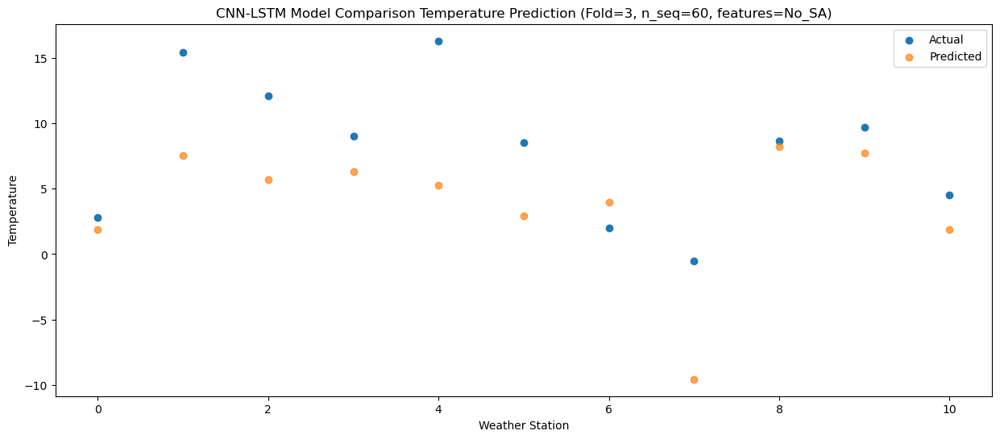

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.60   5.848087
1                 1   19.80  11.547489
2                 2   14.92   9.667587
3                 3   12.80  10.297930
4                 4   20.42   9.217565
5                 5   11.99   6.897693
6                 6    6.59   7.977620
7                 7    1.98  -5.592402
8                 8   10.56  12.217768
9                 9   13.71  11.688052
10               10    8.49   5.848028


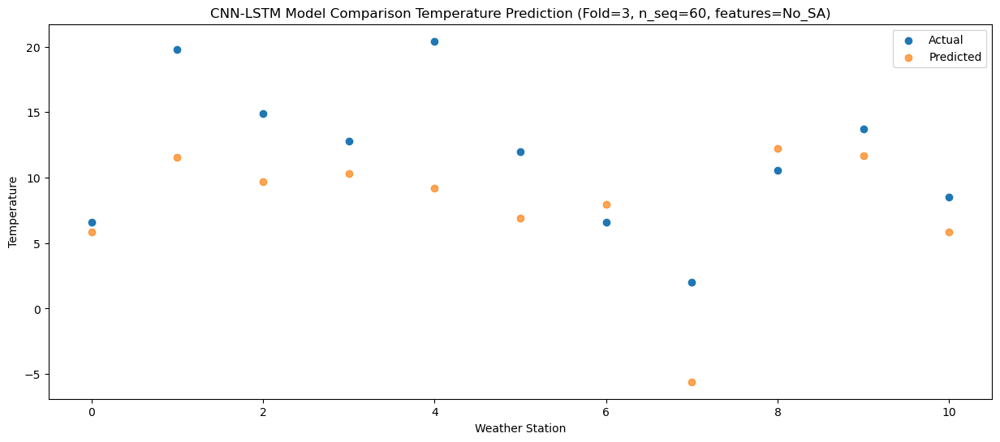

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.38   8.398857
1                 1   22.06  14.098137
2                 2   20.58  12.218277
3                 3   16.42  12.848651
4                 4   22.12  11.768213
5                 5   15.25   9.448364
6                 6   12.73  10.528306
7                 7   10.34  -3.041716
8                 8   13.57  14.768483
9                 9   19.39  14.238788
10               10   13.33   8.398755


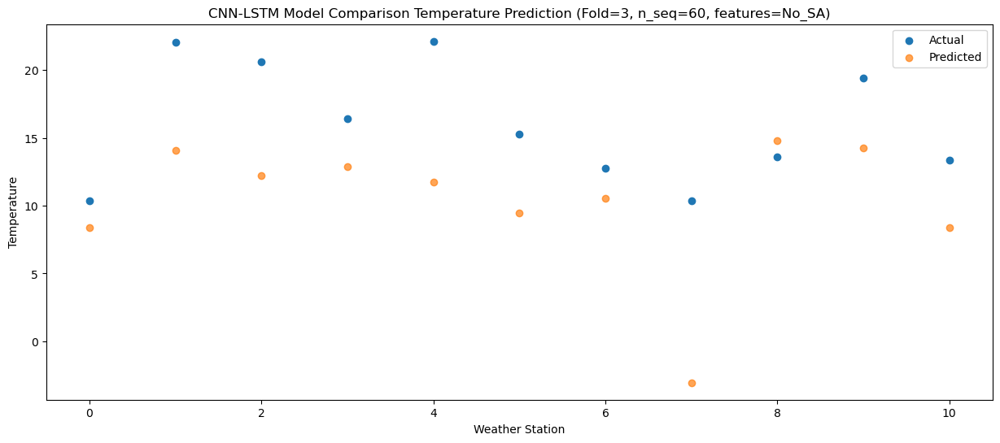

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.87   7.894182
1                 1   22.24  13.593514
2                 2   18.89  11.713608
3                 3   15.31  12.344023
4                 4   20.83  11.263624
5                 5   13.70   8.943770
6                 6   10.14  10.023654
7                 7    5.71  -3.546376
8                 8   14.60  14.263816
9                 9   17.14  13.734163
10               10   11.36   7.894132


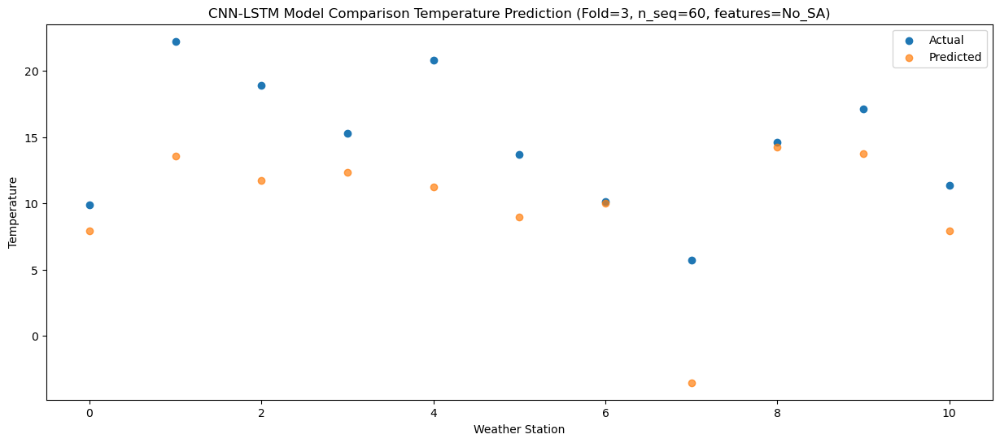

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.73   4.168973
1                 1   18.19   9.868317
2                 2   15.12   7.988406
3                 3   12.58   8.618828
4                 4   17.47   7.538433
5                 5   10.24   5.218576
6                 6    5.99   6.298453
7                 7    1.01  -7.271579
8                 8   11.99  10.538614
9                 9   14.57  10.008965
10               10    8.07   4.168935


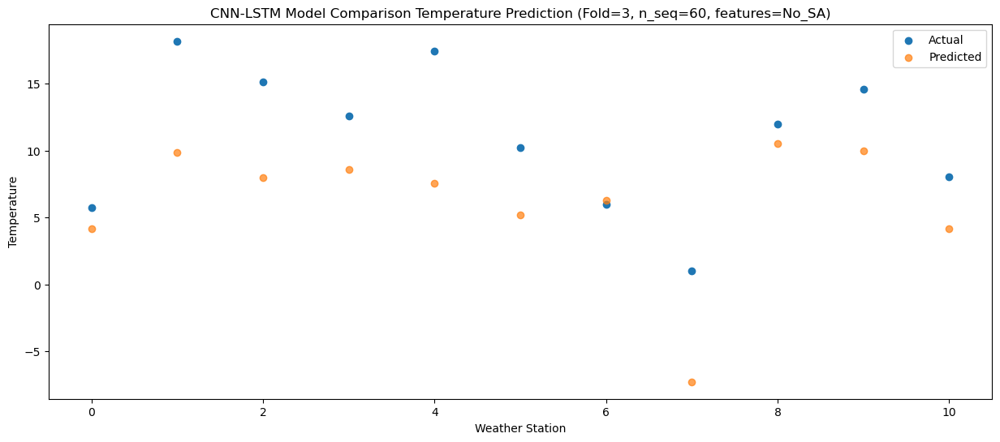

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.70  -2.360956
1                 1   11.25   3.338370
2                 2    9.81   1.458465
3                 3    7.14   2.088893
4                 4   11.01   1.008492
5                 5    4.59  -1.311363
6                 6   -0.14  -0.231489
7                 7   -4.28 -13.801521
8                 8   10.53   4.008677
9                 9    9.14   3.479034
10               10    2.78  -2.360995


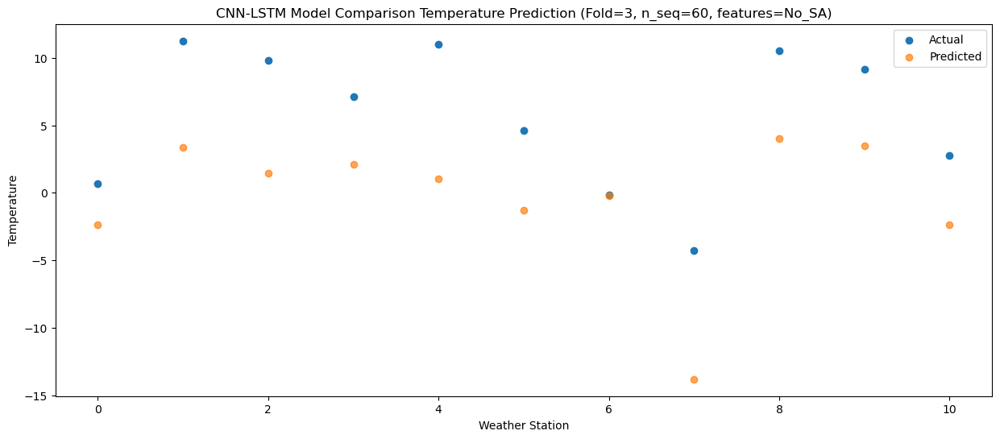

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -4.96  -9.204522
1                 1    5.47  -3.505216
2                 2    2.90  -5.385126
3                 3    0.75  -4.754675
4                 4    4.06  -5.835084
5                 5   -1.89  -8.154933
6                 6   -6.00  -7.075076
7                 7  -12.42 -20.645108
8                 8    6.49  -2.834908
9                 9    1.29  -3.364528
10               10   -5.49  -9.204557


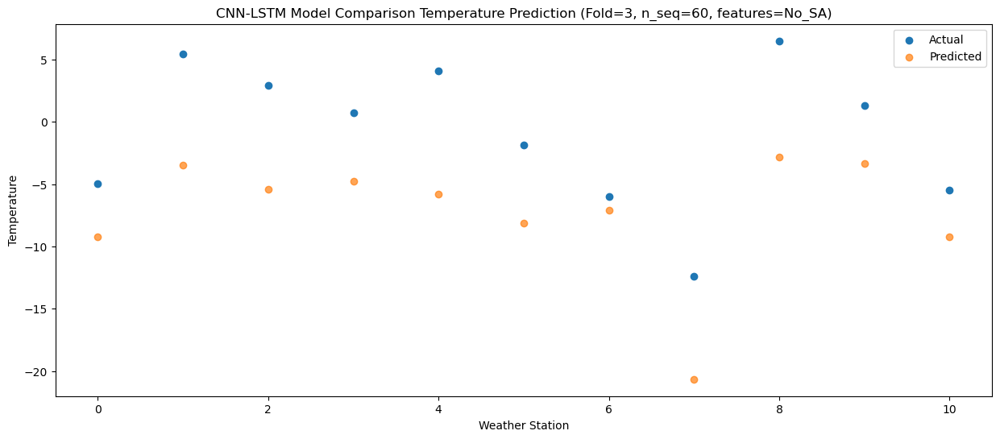

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -7.01 -11.126506
1                 1    2.12  -5.427311
2                 2    1.06  -7.307170
3                 3   -1.08  -6.676715
4                 4    1.25  -7.757193
5                 5   -4.35 -10.077024
6                 6   -9.63  -8.997131
7                 7  -15.55 -22.567162
8                 8    4.65  -4.756931
9                 9    0.56  -5.286555
10               10   -6.24 -11.126588


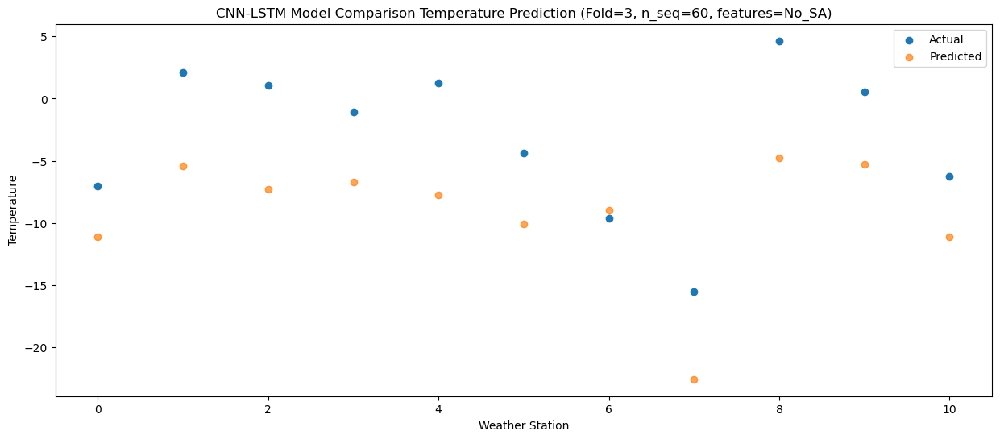

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -9.32 -16.397040
1                 1   -4.49 -10.697839
2                 2    0.85 -12.577700
3                 3   -6.24 -11.947240
4                 4   -5.25 -13.027716
5                 5  -10.51 -15.347546
6                 6  -11.77 -14.267662
7                 7  -17.27 -27.837693
8                 8    4.96 -10.027462
9                 9   -3.43 -10.557080
10               10   -9.26 -16.397113


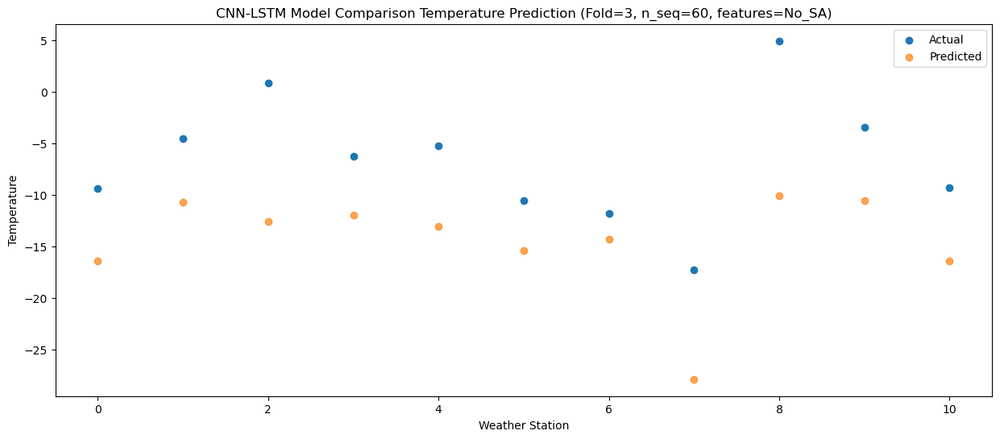

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -6.18 -10.875440
1                 1    5.16  -5.176269
2                 2    2.34  -7.056119
3                 3   -0.56  -6.425655
4                 4    2.56  -7.506149
5                 5   -3.88  -9.825975
6                 6   -9.61  -8.746086
7                 7  -14.91 -22.316115
8                 8    4.67  -4.505873
9                 9   -2.86  -5.035483
10               10   -7.22 -10.875520


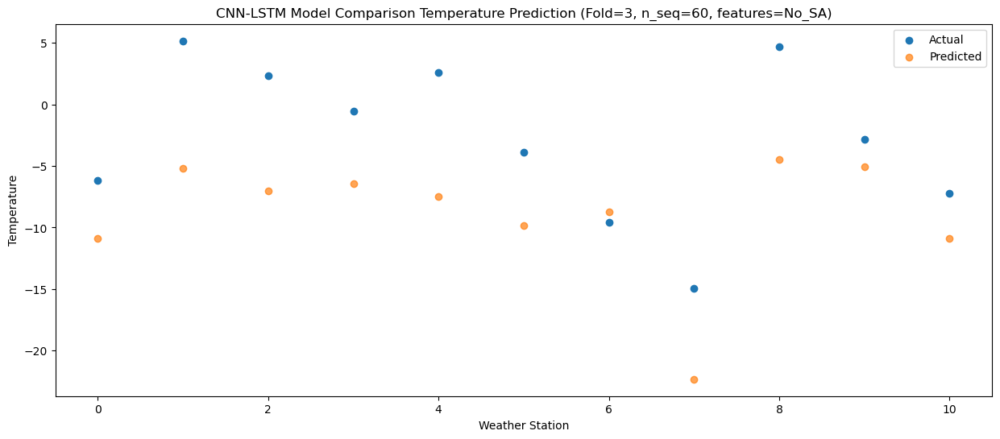

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.51  -8.168675
1                 1    7.64  -2.469566
2                 2    4.37  -4.349407
3                 3    3.09  -3.718911
4                 4    6.67  -4.799443
5                 5    0.19  -7.119256
6                 6   -7.87  -6.039372
7                 7  -11.55 -19.609403
8                 8    5.60  -1.799150
9                 9    1.84  -2.328731
10               10   -2.56  -8.168769


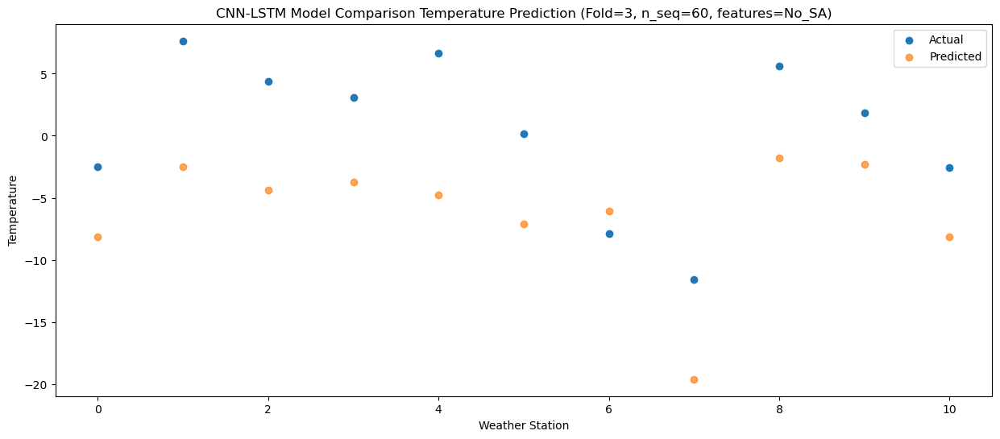

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    1.51  -3.954338
1                 1   11.81   1.744716
2                 2    7.56  -0.135104
3                 3    8.15   0.495401
4                 4   11.42  -0.585163
5                 5    5.16  -2.904964
6                 6   -2.89  -1.825073
7                 7   -6.05 -15.395102
8                 8    7.83   2.415172
9                 9    4.71   1.885596
10               10    2.02  -3.954451


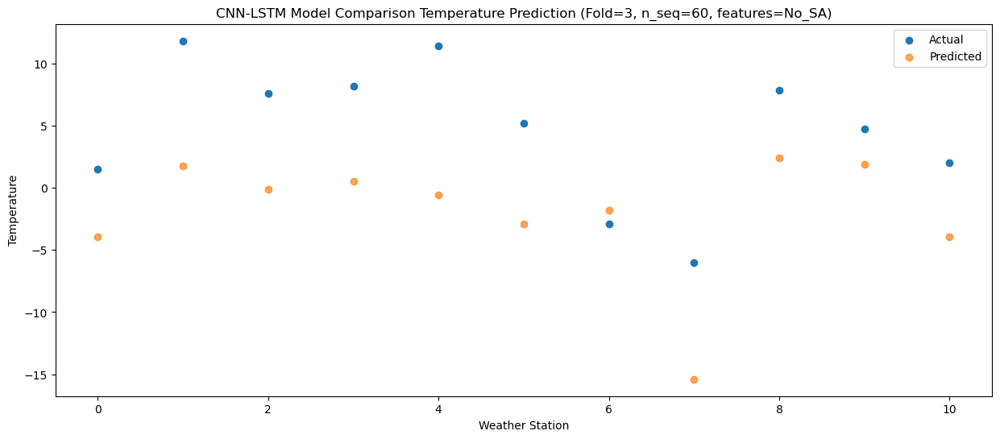

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.78   1.023966
1                 1   16.58   6.723093
2                 2   12.95   4.843244
3                 3   12.34   5.473734
4                 4   17.58   4.393216
5                 5   10.68   2.073396
6                 6    0.22   3.153276
7                 7   -0.42 -10.416749
8                 8   10.80   7.393507
9                 9   10.26   6.863922
10               10    7.69   1.023879


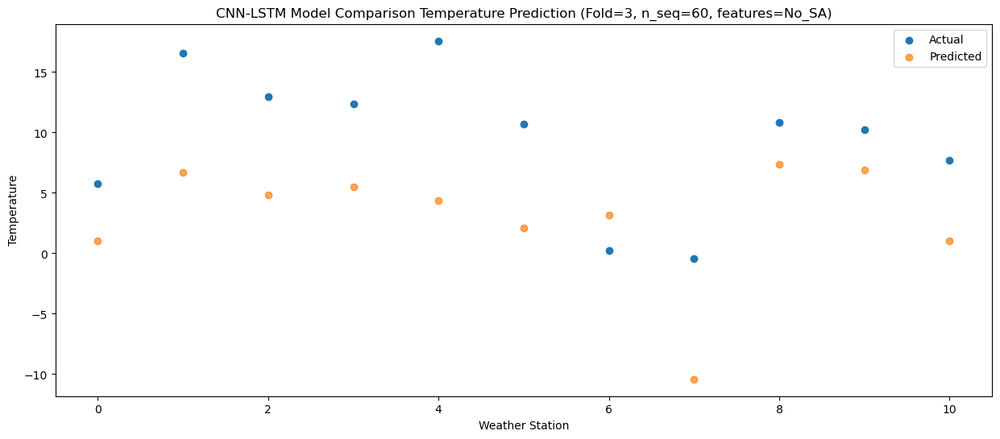

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    9.44   4.537238
1                 1   21.14  10.236314
2                 2   18.90   8.356488
3                 3   16.24   8.986982
4                 4   22.45   7.906434
5                 5   13.91   5.586623
6                 6    9.37   6.666516
7                 7    7.76  -6.903511
8                 8   13.71  10.906760
9                 9   16.73  10.377175
10               10   13.06   4.537132


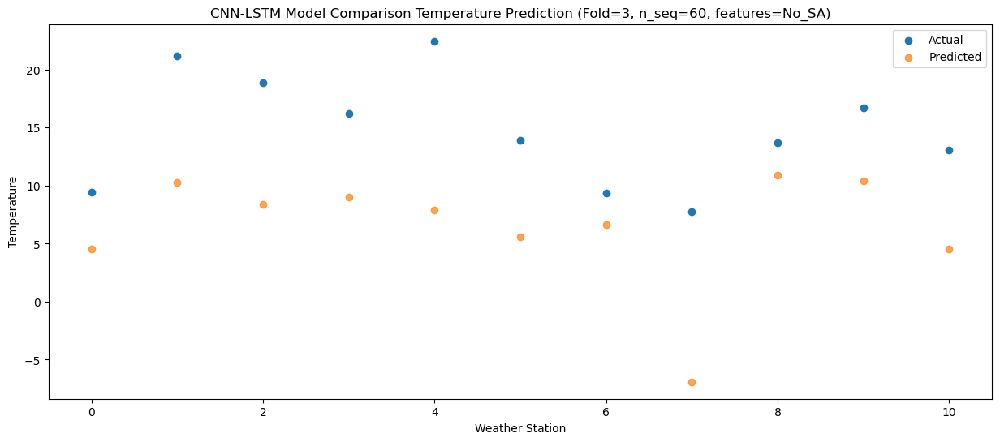

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.33   4.732126
1                 1   21.66  10.431156
2                 2   22.47   8.551354
3                 3   17.95   9.181841
4                 4   21.61   8.101259
5                 5   14.46   5.781456
6                 6   10.12   6.861375
7                 7   10.84  -6.708651
8                 8   14.97  11.101634
9                 9   19.29  10.572037
10               10   15.72   4.731992


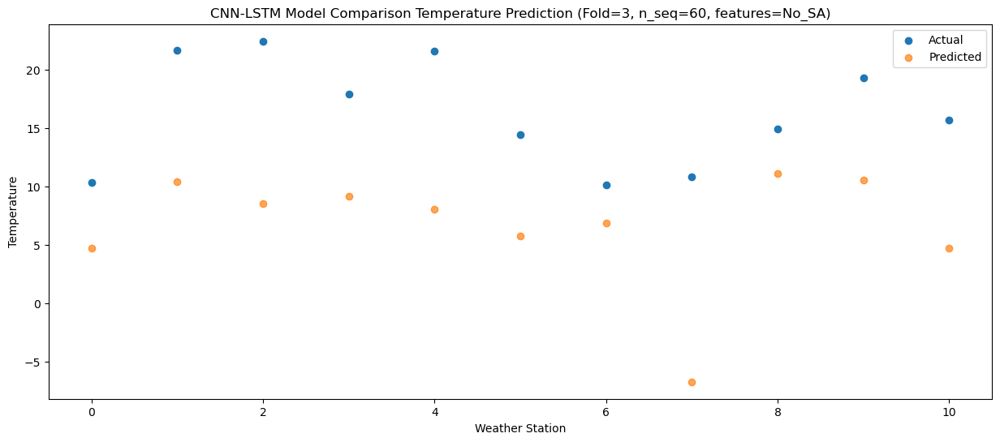

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    8.93   4.600986
1                 1   21.94  10.299942
2                 2   19.50   8.420180
3                 3   16.93   9.050656
4                 4   21.06   7.970028
5                 5   13.91   5.650239
6                 6    9.83   6.730192
7                 7    7.98  -6.839829
8                 8   13.69  10.970471
9                 9   17.57  10.440863
10               10   12.58   4.600815


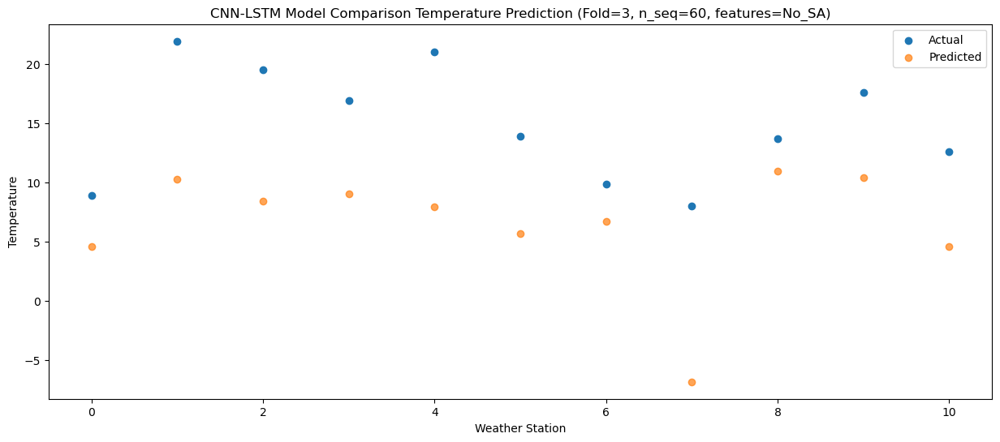

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    6.24   1.365536
1                 1   17.90   7.064501
2                 2   16.47   5.184719
3                 3   13.96   5.815224
4                 4   17.80   4.734607
5                 5   11.22   2.414814
6                 6    6.21   3.494740
7                 7    4.03 -10.075285
8                 8   12.25   7.735014
9                 9   13.56   7.205438
10               10    8.99   1.365388


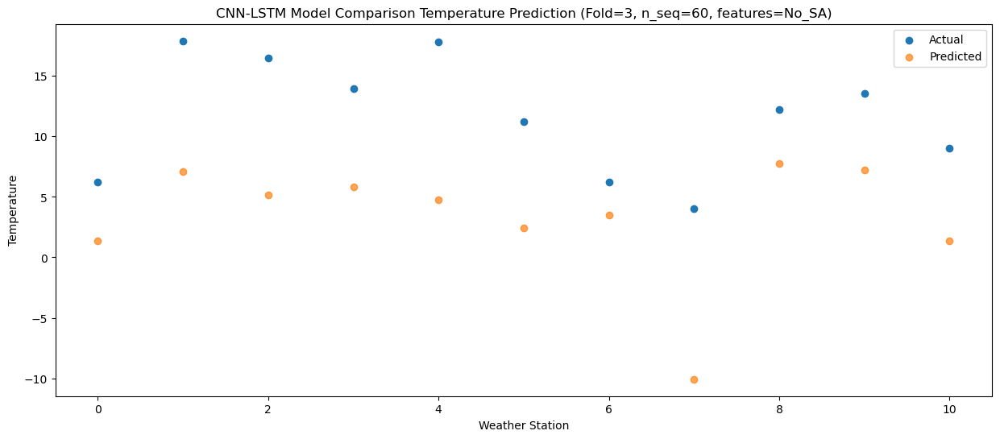

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.93  -3.963132
1                 1   14.51   1.735833
2                 2   11.44  -0.143950
3                 3    7.46   0.486553
4                 4   12.17  -0.594066
5                 5    5.34  -2.913855
6                 6    1.98  -1.833928
7                 7   -1.86 -15.403954
8                 8   11.79   2.406350
9                 9    9.03   1.876776
10               10    3.75  -3.963275


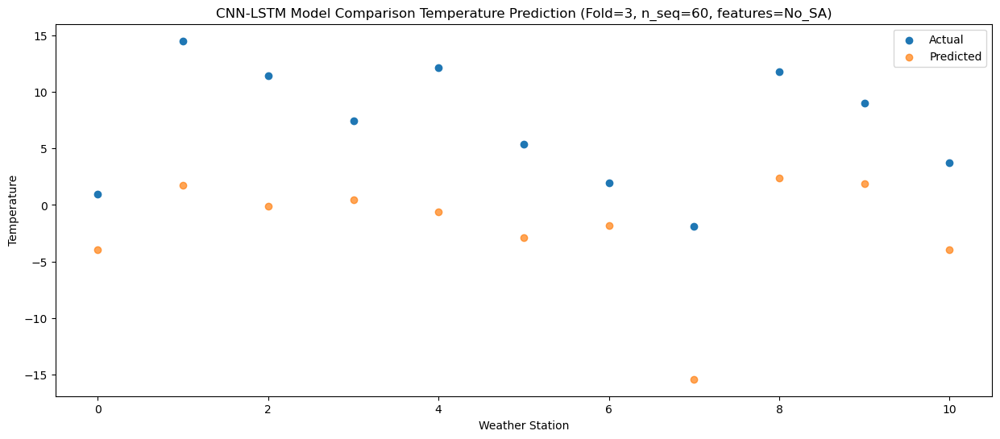

f, t:
[[-6.460e+00  2.220e+00  2.710e+00 -2.860e+00  3.310e+00 -5.820e+00
  -6.460e+00 -1.316e+01  5.280e+00  6.300e-01 -6.460e+00]
 [-7.240e+00  8.700e-01  1.800e-01 -2.850e+00  5.000e-02 -5.610e+00
  -1.213e+01 -1.789e+01  4.030e+00 -2.130e+00 -9.420e+00]
 [-7.660e+00  3.000e-02 -1.040e+00 -3.400e+00 -2.820e+00 -7.030e+00
  -1.222e+01 -1.673e+01  3.400e+00 -2.100e+00 -9.010e+00]
 [-6.650e+00  1.800e-01  1.380e+00 -3.750e+00 -1.670e+00 -7.440e+00
  -1.203e+01 -1.522e+01  5.420e+00 -1.660e+00 -8.090e+00]
 [-1.390e+00  7.670e+00  3.170e+00  3.160e+00  5.740e+00 -5.800e-01
  -7.100e+00 -1.211e+01  4.860e+00  1.920e+00 -3.680e+00]
 [-3.200e-01  8.590e+00  7.830e+00  3.800e+00  8.770e+00  1.690e+00
  -4.120e+00 -6.200e+00  8.480e+00  3.360e+00 -1.740e+00]
 [ 2.370e+00  1.299e+01  1.302e+01  8.370e+00  1.484e+01  7.100e+00
   2.990e+00  1.070e+00  1.088e+01  8.920e+00  4.030e+00]
 [ 7.690e+00  2.009e+01  1.637e+01  1.419e+01  2.189e+01  1.409e+01
   7.200e+00  4.530e+00  1.342e+01  1.590e+0

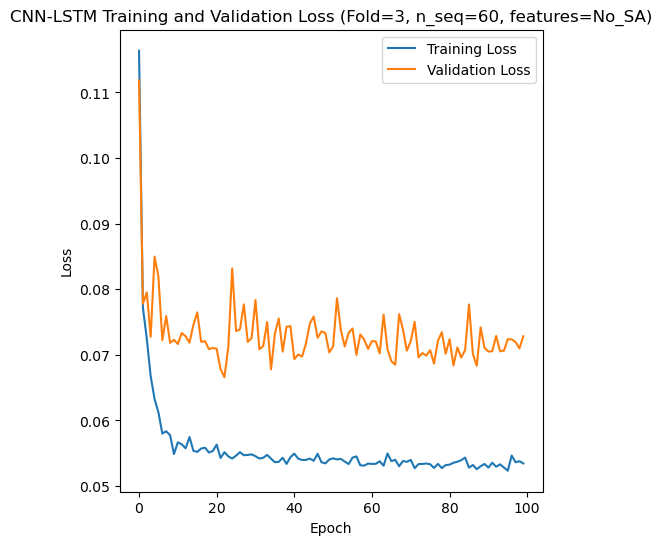

[[ 4.89  1.26  7.78 ... 22.59 18.46  9.82]
 [15.38 13.87 17.63 ... 26.66 22.89 20.2 ]
 [11.49  8.39 14.48 ... 24.97 20.83 17.82]
 ...
 [ 7.64  3.61 10.44 ... 21.3  17.62 11.34]
 [ 4.26  0.29  5.21 ... 21.47 15.54  9.34]
 [ 3.62 -0.32  6.05 ... 19.99 14.92  8.29]]
Epoch 1/100
84/84 [==============================] - 33s 153ms/step - loss: 0.1167 - accuracy: 0.2262 - mae: 0.0972 - rmse: 0.1167 - mape: inf - pearson: 0.6700 - val_loss: 0.0749 - val_accuracy: 0.6000 - val_mae: 0.0602 - val_rmse: 0.0749 - val_mape: 13.5537 - val_pearson: 0.7925
Epoch 2/100
84/84 [==============================] - 7s 87ms/step - loss: 0.0746 - accuracy: 0.3929 - mae: 0.0598 - rmse: 0.0746 - mape: inf - pearson: 0.7814 - val_loss: 0.0774 - val_accuracy: 0.6000 - val_mae: 0.0613 - val_rmse: 0.0774 - val_mape: 13.6332 - val_pearson: 0.8067
Epoch 3/100
84/84 [==============================] - 7s 90ms/step - loss: 0.0699 - accuracy: 0.4286 - mae: 0.0558 - rmse: 0.0699 - mape: inf - pearson: 0.8161 - val_loss: 0.0

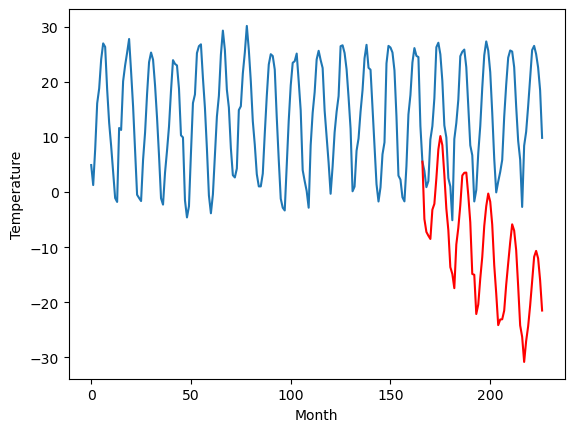

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.38		-3.63		-1.25
-2.56		-5.97		-3.41
-4.02		-6.66		-2.64
-2.47		-7.25		-4.78
1.60		-1.94		-3.54
3.28		-0.88		-4.16
4.68		3.75		-0.93
6.44		8.99		2.55
6.76		11.42		4.66
6.61		9.76		3.15
6.03		4.40		-1.63
4.53		-1.74		-6.27
1.14		-5.64		-6.78
-6.61		-12.36		-5.75
-5.91		-13.59		-7.68
-2.48		-16.18		-13.70
-0.88		-8.25		-7.37
0.56		-5.24		-5.80
4.60		-1.12		-5.72
6.23		4.27		-1.96
6.60		4.76		-1.84
6.88		4.79		-2.09
5.59		0.68		-4.91
3.75		-4.22		-7.97
-3.41		-13.60		-10.19
-1.61		-13.74		-12.13
-6.37		-20.86		-14.49
-2.94		-19.13		-16.19
-0.12		-14.43		-14.31
2.22		-10.52		-12.74
5.04		-4.90		-9.94
6.76		-1.30		-8.06
7.13		0.99		-6.14
7.08		-0.49		-7.57
5.64		-4.65		-10.29
1.81		-12.00		-13.81
0.35		-17.13		-17.48
-4.50		-22.88		-18.38
-4.65		-21.86		-17.21
-1.35		-21.82		-20.47
0.37		-20.25		-20.62
3.09		-15.55		-18.64
3.87		-11.65		-15.52
6.08		-7.87		-13.95
7.69		-4.59		-12.28
8.20		-5.74

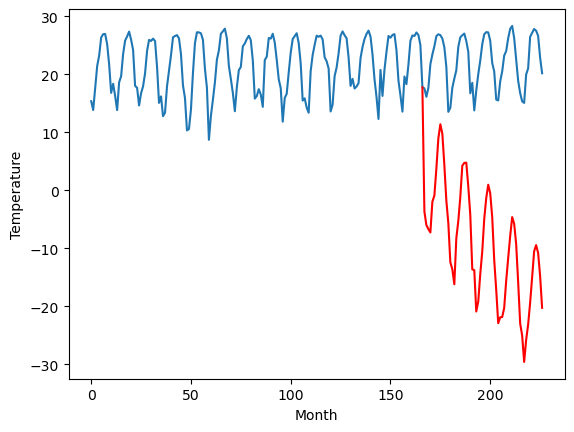

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.75		6.86		0.11
6.81		4.52		-2.29
6.62		3.83		-2.79
6.88		3.24		-3.64
14.68		8.55		-6.13
13.73		9.61		-4.12
17.61		14.24		-3.37
21.70		19.48		-2.22
23.27		21.91		-1.36
22.44		20.25		-2.19
20.34		14.89		-5.45
15.00		8.75		-6.25
11.00		4.85		-6.15
4.75		-1.87		-6.62
4.78		-3.10		-7.88
2.86		-5.69		-8.55
12.19		2.24		-9.95
13.26		5.25		-8.01
17.73		9.37		-8.36
21.99		14.76		-7.23
22.65		15.25		-7.40
23.30		15.28		-8.02
20.18		11.17		-9.01
16.79		6.27		-10.52
8.12		-3.11		-11.23
11.63		-3.25		-14.88
3.35		-10.37		-13.72
5.71		-8.64		-14.35
10.45		-3.94		-14.39
14.66		-0.03		-14.69
20.46		5.59		-14.87
23.75		9.19		-14.56
23.95		11.48		-12.47
22.41		10.00		-12.41
20.34		5.84		-14.50
14.21		-1.51		-15.72
9.62		-6.64		-16.26
7.19		-12.39		-19.58
7.60		-11.37		-18.97
9.54		-11.33		-20.87
11.69		-9.76		-21.45
13.44		-5.06		-18.50
18.30		-1.16		-19.46
21.89		2.62		-19.27
23.67		5.90		-17.77
25.75		4.75

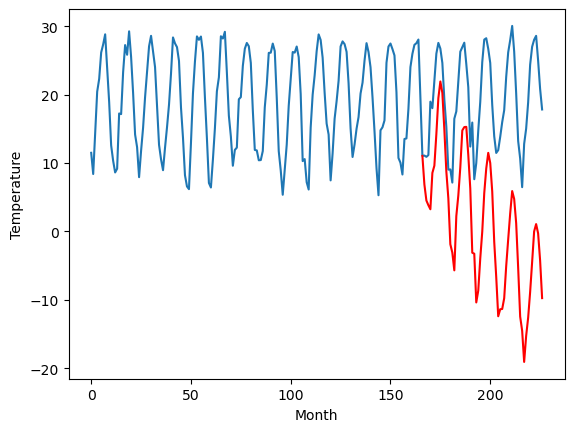

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.23		2.97		-1.26
2.58		0.63		-1.95
2.82		-0.06		-2.88
2.49		-0.65		-3.14
9.95		4.66		-5.29
10.61		5.72		-4.89
15.74		10.35		-5.39
20.70		15.59		-5.11
22.56		18.02		-4.54
22.31		16.36		-5.95
16.53		11.00		-5.53
10.80		4.86		-5.94
8.19		0.96		-7.23
1.91		-5.76		-7.67
0.99		-6.99		-7.98
-2.47		-9.58		-7.11
8.49		-1.65		-10.14
10.18		1.36		-8.82
14.34		5.48		-8.86
20.02		10.87		-9.15
21.61		11.36		-10.25
21.98		11.39		-10.59
19.19		7.28		-11.91
14.54		2.38		-12.16
6.54		-7.00		-13.54
8.54		-7.14		-15.68
0.07		-14.26		-14.33
0.33		-12.53		-12.86
6.51		-7.83		-14.34
12.56		-3.92		-16.48
17.27		1.70		-15.57
21.82		5.30		-16.52
25.12		7.59		-17.53
22.39		6.11		-16.28
18.96		1.95		-17.01
12.09		-5.40		-17.49
5.04		-10.53		-15.57
2.35		-16.28		-18.63
3.34		-15.26		-18.60
3.40		-15.22		-18.62
7.93		-13.65		-21.58
10.53		-8.95		-19.48
16.21		-5.05		-21.26
20.40		-1.27		-21.67
22.95		2.01		-20.94
25.50		

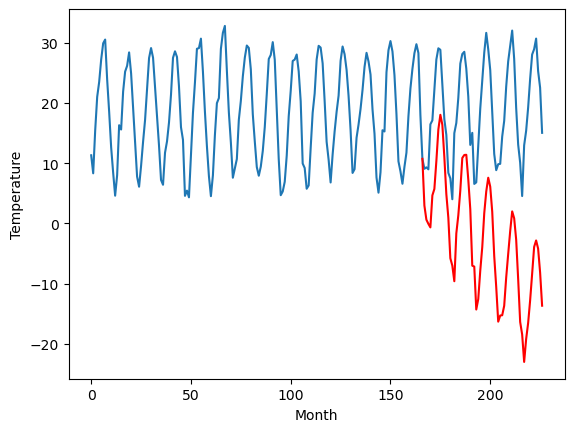

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.65		2.79		-0.86
1.87		0.45		-1.42
2.49		-0.24		-2.73
2.11		-0.83		-2.94
9.99		4.48		-5.51
10.68		5.54		-5.14
16.33		10.17		-6.16
21.04		15.41		-5.63
23.48		17.84		-5.64
22.80		16.18		-6.62
16.50		10.82		-5.68
10.75		4.68		-6.07
7.99		0.78		-7.21
1.42		-5.94		-7.36
0.82		-7.17		-7.99
-3.07		-9.76		-6.69
7.85		-1.83		-9.68
10.03		1.18		-8.85
13.56		5.30		-8.26
20.41		10.69		-9.72
21.90		11.18		-10.72
22.27		11.21		-11.06
18.84		7.10		-11.74
13.97		2.20		-11.77
6.13		-7.18		-13.31
7.87		-7.32		-15.19
-1.03		-14.44		-13.41
-0.41		-12.71		-12.30
6.51		-8.01		-14.52
13.20		-4.10		-17.30
18.03		1.52		-16.51
22.70		5.12		-17.58
26.12		7.41		-18.71
23.28		5.93		-17.35
19.19		1.77		-17.42
12.04		-5.58		-17.62
4.95		-10.71		-15.66
1.98		-16.46		-18.44
2.75		-15.44		-18.19
2.98		-15.40		-18.38
7.83		-13.83		-21.66
10.48		-9.13		-19.61
16.64		-5.23		-21.87
21.75		-1.45		-23.20
24.83		1.83		-23.00
26.70	

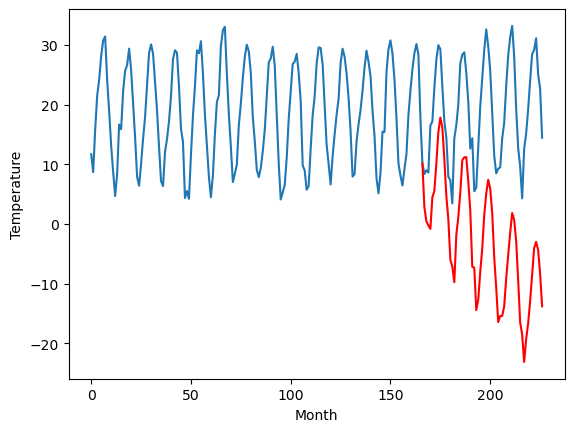

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.12		3.17		-1.95
3.48		0.83		-2.65
2.75		0.14		-2.61
1.99		-0.45		-2.44
9.55		4.86		-4.69
12.52		5.92		-6.60
19.09		10.55		-8.54
22.42		15.79		-6.63
25.25		18.22		-7.03
24.63		16.56		-8.07
16.90		11.20		-5.70
12.94		5.06		-7.88
9.06		1.16		-7.90
2.08		-5.56		-7.64
0.98		-6.79		-7.77
-0.59		-9.38		-8.79
8.66		-1.45		-10.11
10.89		1.56		-9.33
16.38		5.68		-10.70
21.34		11.07		-10.27
21.08		11.56		-9.52
21.40		11.59		-9.81
20.71		7.48		-13.23
15.01		2.58		-12.43
8.07		-6.80		-14.87
8.48		-6.94		-15.42
1.11		-14.06		-15.17
0.91		-12.33		-13.24
8.23		-7.63		-15.86
15.74		-3.72		-19.46
21.43		1.90		-19.53
23.80		5.50		-18.30
25.70		7.79		-17.91
22.40		6.31		-16.09
19.50		2.15		-17.35
12.69		-5.20		-17.89
4.84		-10.33		-15.17
3.24		-16.08		-19.32
3.61		-15.06		-18.67
3.78		-15.02		-18.80
8.85		-13.45		-22.30
13.07		-8.75		-21.82
17.99		-4.85		-22.84
24.47		-1.07		-25.54
25.93		2.21		-23.72
26.02		1

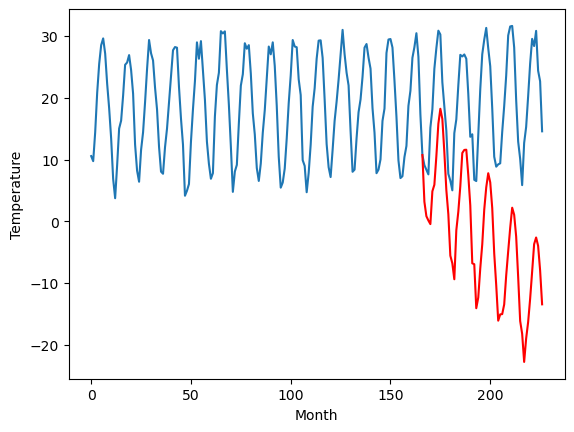

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.86		2.04		1.18
0.51		-0.30		-0.81
0.34		-0.99		-1.33
0.81		-1.58		-2.39
6.42		3.73		-2.69
7.69		4.79		-2.90
10.48		9.42		-1.06
15.07		14.66		-0.41
18.11		17.09		-1.02
16.91		15.43		-1.48
13.11		10.07		-3.04
9.29		3.93		-5.36
4.98		0.03		-4.95
-2.27		-6.69		-4.42
-2.04		-7.92		-5.88
-1.37		-10.51		-9.14
5.03		-2.58		-7.61
7.76		0.43		-7.33
11.21		4.55		-6.66
15.23		9.94		-5.29
16.97		10.43		-6.54
17.10		10.46		-6.64
13.13		6.35		-6.78
9.33		1.45		-7.88
1.17		-7.93		-9.10
3.08		-8.07		-11.15
-2.98		-15.19		-12.21
1.30		-13.46		-14.76
4.86		-8.76		-13.62
7.52		-4.85		-12.37
13.50		0.77		-12.73
16.71		4.37		-12.34
17.98		6.66		-11.32
16.46		5.18		-11.28
13.37		1.02		-12.35
6.50		-6.33		-12.83
3.80		-11.46		-15.26
-2.15		-17.21		-15.06
0.87		-16.19		-17.06
4.29		-16.15		-20.44
4.77		-14.58		-19.35
7.88		-9.88		-17.76
10.50		-5.98		-16.48
14.14		-2.20		-16.34
18.01		1.08		-16.93
17.45		-0.07		-17

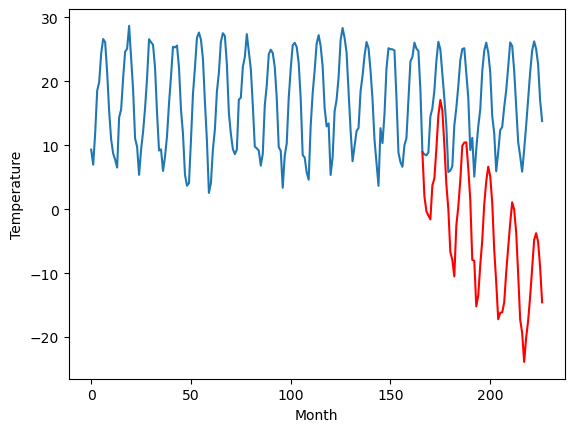

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.01		0.80		-1.21
1.20		-1.54		-2.74
-0.45		-2.23		-1.78
0.12		-2.82		-2.94
7.05		2.49		-4.56
8.63		3.55		-5.08
12.73		8.18		-4.55
19.08		13.42		-5.66
21.62		15.85		-5.77
19.63		14.19		-5.44
16.05		8.83		-7.22
9.12		2.69		-6.43
6.57		-1.21		-7.78
0.04		-7.93		-7.97
-1.63		-9.16		-7.53
-5.24		-11.75		-6.51
7.03		-3.82		-10.85
8.93		-0.81		-9.74
12.97		3.31		-9.66
19.27		8.70		-10.57
20.56		9.19		-11.37
21.08		9.22		-11.86
18.04		5.11		-12.93
12.27		0.21		-12.06
4.33		-9.17		-13.50
5.79		-9.31		-15.10
-3.28		-16.43		-13.15
-1.22		-14.70		-13.48
5.44		-10.00		-15.44
9.30		-6.09		-15.39
14.97		-0.47		-15.44
20.29		3.13		-17.16
23.99		5.42		-18.57
20.47		3.94		-16.53
16.88		-0.22		-17.10
10.51		-7.57		-18.08
3.96		-12.70		-16.66
-0.89		-18.45		-17.56
0.76		-17.43		-18.19
2.90		-17.39		-20.29
4.62		-15.82		-20.44
10.24		-11.12		-21.36
15.02		-7.22		-22.24
19.10		-3.44		-22.54
21.06		-0.16		-21.22
2

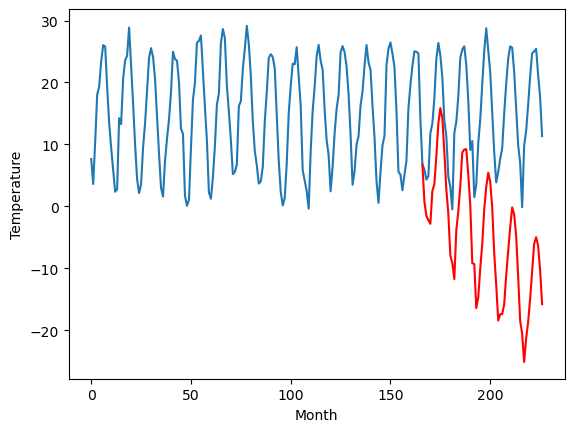

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.64		-0.88		1.76
-3.46		-3.22		0.24
-4.39		-3.91		0.48
-5.22		-4.50		0.72
1.60		0.81		-0.79
4.59		1.87		-2.72
10.17		6.50		-3.67
17.46		11.74		-5.72
19.50		14.17		-5.33
17.30		12.51		-4.79
13.54		7.15		-6.39
6.70		1.01		-5.69
2.86		-2.89		-5.75
-4.65		-9.61		-4.96
-6.23		-10.84		-4.61
-9.59		-13.43		-3.84
2.38		-5.49		-7.87
6.03		-2.49		-8.52
10.44		1.63		-8.81
17.68		7.02		-10.66
18.25		7.51		-10.74
19.11		7.54		-11.57
15.62		3.43		-12.19
10.27		-1.47		-11.74
-0.59		-10.85		-10.26
-0.27		-10.99		-10.72
-9.11		-18.11		-9.00
-6.09		-16.38		-10.29
1.38		-11.68		-13.06
5.16		-7.77		-12.93
13.66		-2.15		-15.81
18.14		1.45		-16.69
20.08		3.74		-16.34
17.85		2.26		-15.59
13.94		-1.90		-15.84
6.45		-9.25		-15.70
0.66		-14.38		-15.04
-5.12		-20.13		-15.01
-3.16		-19.11		-15.95
-1.57		-19.07		-17.50
-0.30		-17.50		-17.20
6.20		-12.80		-19.00
11.91		-8.90		-20.81
15.79		-5.12		-20.91
18.52		-1.84		-2

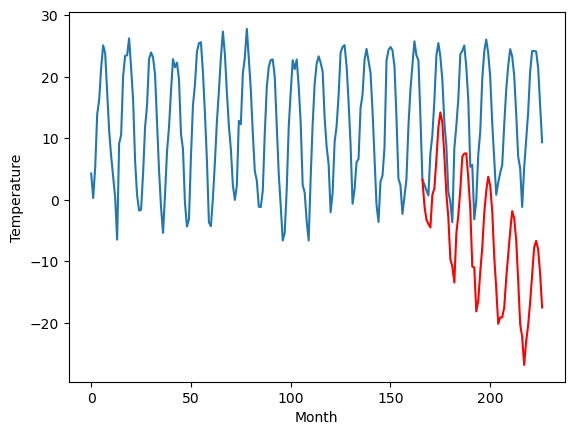

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.88		-4.26		0.62
-5.20		-6.60		-1.40
-7.64		-7.29		0.35
-7.89		-7.88		0.01
-0.29		-2.57		-2.28
2.82		-1.51		-4.33
8.70		3.12		-5.58
16.43		8.36		-8.07
17.64		10.79		-6.85
15.04		9.13		-5.91
11.14		3.77		-7.37
3.80		-2.37		-6.17
1.16		-6.27		-7.43
-6.72		-12.99		-6.27
-8.75		-14.22		-5.47
-13.19		-16.81		-3.62
0.67		-8.88		-9.55
4.38		-5.87		-10.25
9.16		-1.75		-10.91
16.55		3.64		-12.91
16.26		4.13		-12.13
16.54		4.16		-12.38
13.43		0.05		-13.38
7.97		-4.85		-12.82
-2.34		-14.23		-11.89
-2.59		-14.37		-11.78
-12.07		-21.49		-9.42
-9.24		-19.76		-10.52
-1.03		-15.06		-14.03
3.09		-11.15		-14.24
11.62		-5.53		-17.15
16.23		-1.93		-18.16
17.05		0.36		-16.69
15.75		-1.12		-16.87
11.61		-5.28		-16.89
4.14		-12.63		-16.77
-1.40		-17.76		-16.36
-8.13		-23.51		-15.38
-5.89		-22.49		-16.60
-4.70		-22.45		-17.75
-2.16		-20.88		-18.72
5.17		-16.18		-21.35
10.93		-12.28		-23.21
15.24		-8.50		-23.74
16

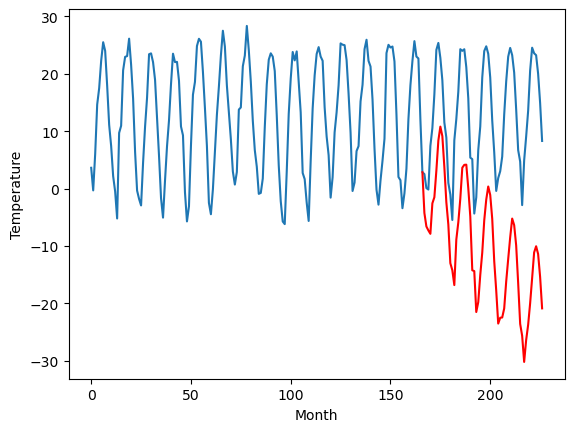

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.79		-4.90		1.89
-7.57		-7.24		0.33
-8.77		-7.93		0.84
-9.58		-8.52		1.06
-3.42		-3.21		0.21
-2.04		-2.15		-0.11
4.70		2.48		-2.22
11.19		7.72		-3.47
14.63		10.15		-4.48
12.22		8.49		-3.73
8.23		3.13		-5.10
2.07		-3.01		-5.08
-1.16		-6.91		-5.75
-8.72		-13.63		-4.91
-10.64		-14.86		-4.22
-12.88		-17.45		-4.57
-2.99		-9.52		-6.53
0.81		-6.51		-7.32
5.34		-2.39		-7.73
12.23		3.00		-9.23
12.39		3.49		-8.90
13.59		3.52		-10.07
9.30		-0.59		-9.89
5.77		-5.49		-11.26
-4.63		-14.87		-10.24
-5.49		-15.01		-9.52
-14.32		-22.13		-7.81
-10.76		-20.40		-9.64
-4.79		-15.70		-10.91
-0.79		-11.79		-11.00
7.79		-6.17		-13.96
11.06		-2.57		-13.63
13.66		-0.28		-13.94
12.59		-1.76		-14.35
8.54		-5.92		-14.46
1.68		-13.27		-14.95
-2.40		-18.40		-16.00
-9.11		-24.15		-15.04
-7.48		-23.13		-15.65
-7.34		-23.09		-15.75
-6.46		-21.52		-15.06
2.01		-16.82		-18.83
5.70		-12.92		-18.62
10.01		-9.14		-19.15
13.10		-

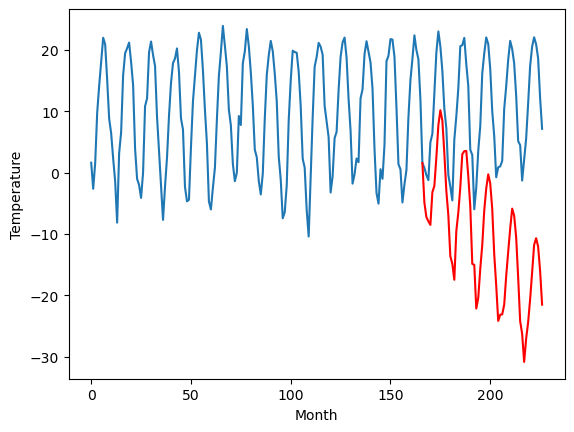

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -4.899024
1                 1   -2.38  -3.629013
2                 2    6.75   6.860985
3                 3    4.23   2.970982
4                 4    3.65   2.790983
5                 5    5.12   3.170986
6                 6    0.86   2.040986
7                 7    2.01   0.800979
8                 8   -2.64  -0.879021
9                 9   -4.88  -4.259021
10               10   -6.79  -4.899023


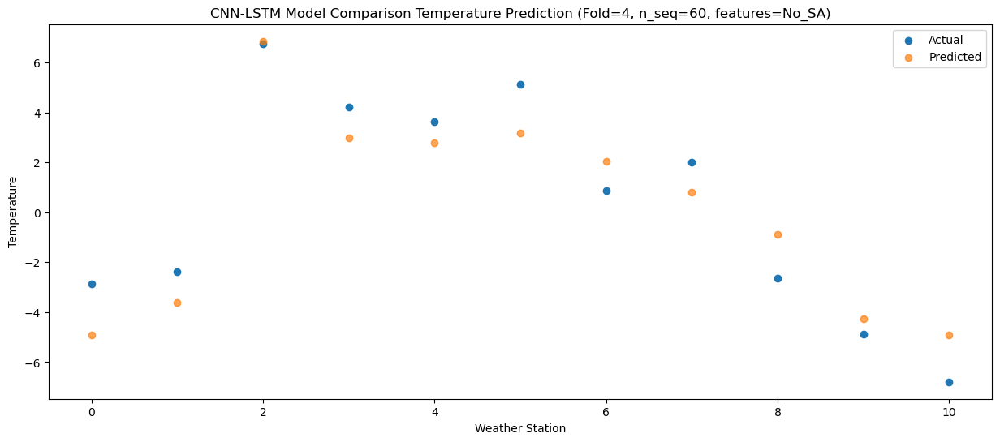

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -4.52  -7.240430
1                 1   -2.56  -5.970457
2                 2    6.81   4.519558
3                 3    2.58   0.629565
4                 4    1.87   0.449564
5                 5    3.48   0.829552
6                 6    0.51  -0.300445
7                 7    1.20  -1.540430
8                 8   -3.46  -3.220423
9                 9   -5.20  -6.600417
10               10   -7.57  -7.240430


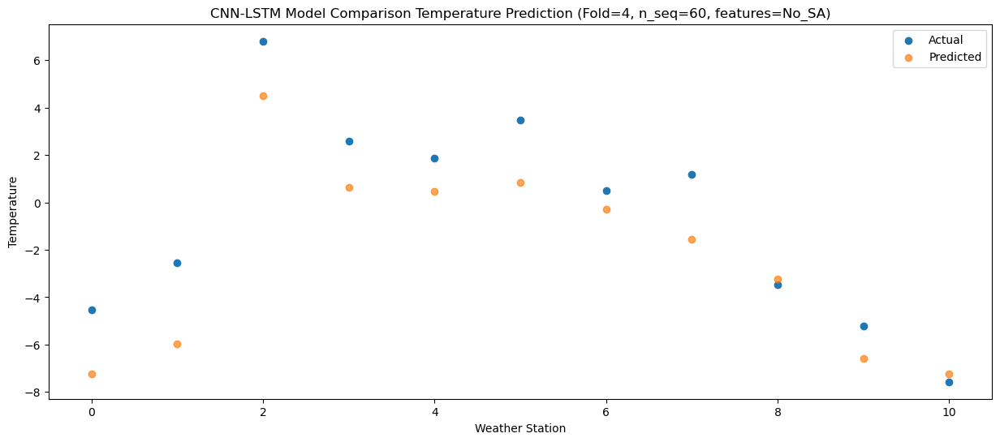

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.48  -7.928586
1                 1   -4.02  -6.658536
2                 2    6.62   3.831446
3                 3    2.82  -0.058564
4                 4    2.49  -0.238564
5                 5    2.75   0.141443
6                 6    0.34  -0.988547
7                 7   -0.45  -2.228566
8                 8   -4.39  -3.908558
9                 9   -7.64  -7.288578
10               10   -8.77  -7.928559


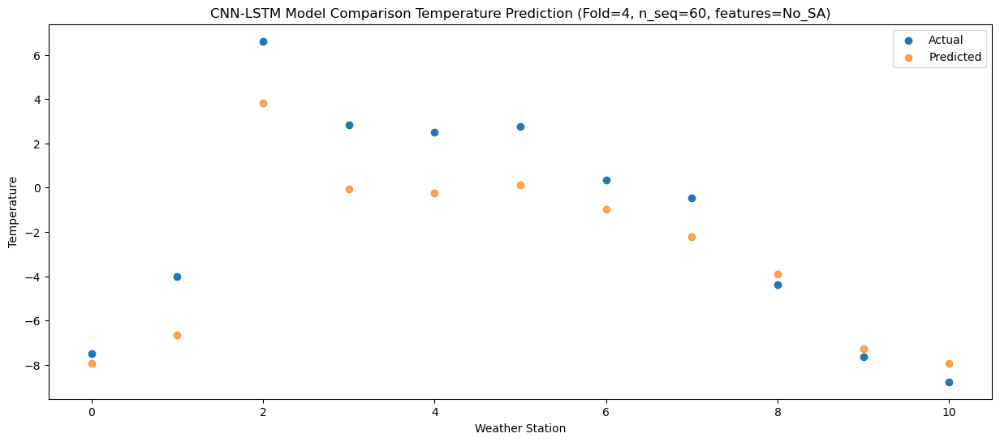

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.37  -8.519651
1                 1   -2.47  -7.249662
2                 2    6.88   3.240340
3                 3    2.49  -0.649654
4                 4    2.11  -0.829656
5                 5    1.99  -0.449665
6                 6    0.81  -1.579663
7                 7    0.12  -2.819652
8                 8   -5.22  -4.499631
9                 9   -7.89  -7.879637
10               10   -9.58  -8.519646


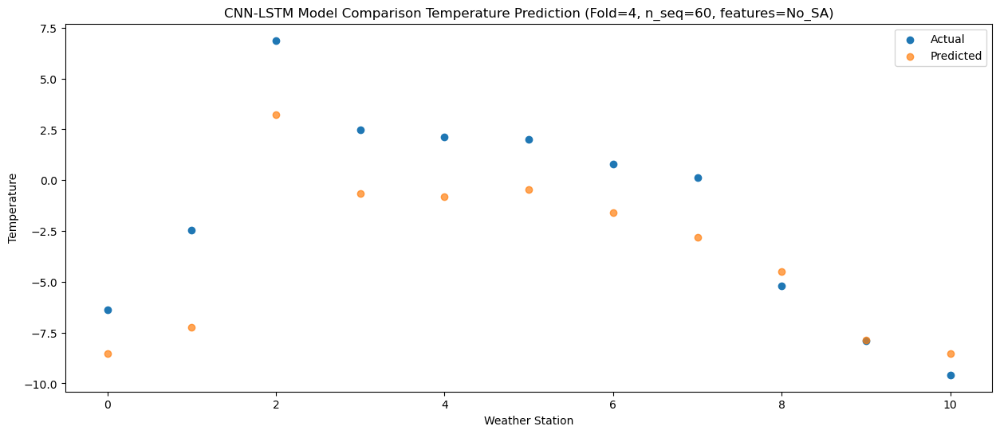

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.16  -3.209567
1                 1    1.60  -1.939609
2                 2   14.68   8.550404
3                 3    9.95   4.660416
4                 4    9.99   4.480414
5                 5    9.55   4.860398
6                 6    6.42   3.730396
7                 7    7.05   2.490418
8                 8    1.60   0.810450
9                 9   -0.29  -2.569551
10               10   -3.42  -3.209570


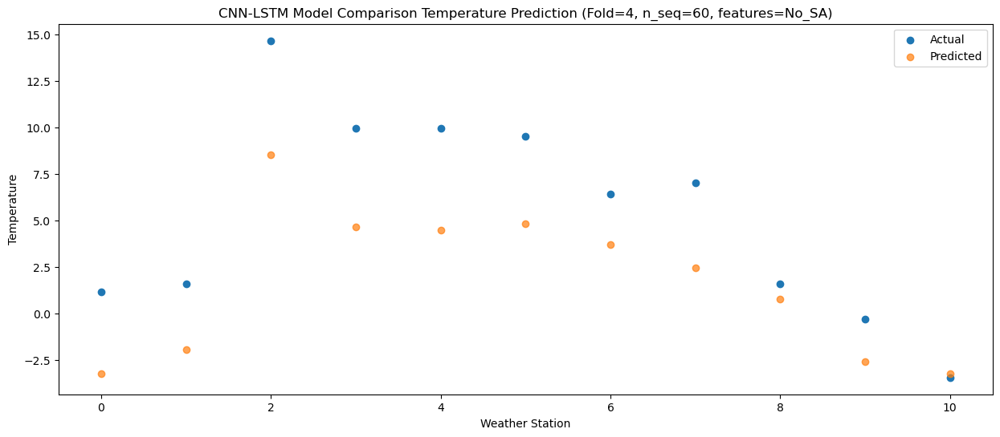

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.59  -2.148947
1                 1    3.28  -0.878999
2                 2   13.73   9.611018
3                 3   10.61   5.721034
4                 4   10.68   5.541030
5                 5   12.52   5.921012
6                 6    7.69   4.791012
7                 7    8.63   3.551038
8                 8    4.59   1.871074
9                 9    2.82  -1.508931
10               10   -2.04  -2.148946


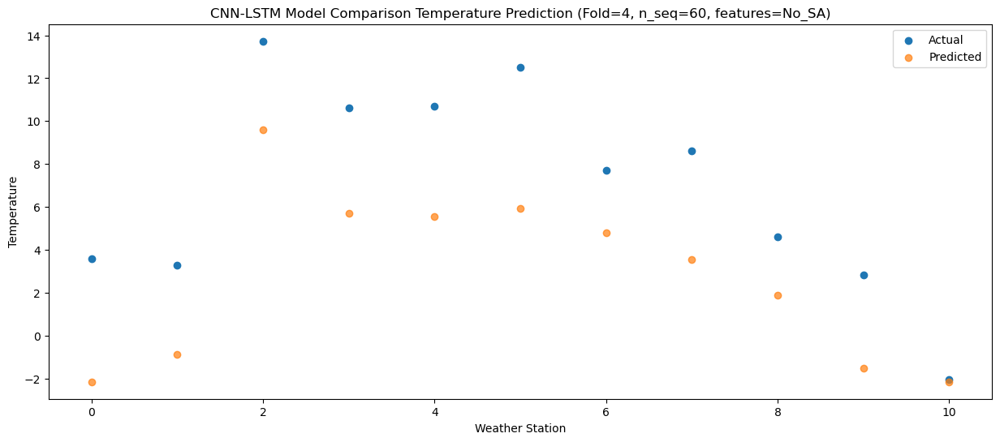

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.66   2.482536
1                 1    4.68   3.752409
2                 2   17.61  14.242460
3                 3   15.74  10.352487
4                 4   16.33  10.172487
5                 5   19.09  10.552443
6                 6   10.48   9.422441
7                 7   12.73   8.182505
8                 8   10.17   6.502544
9                 9    8.70   3.122563
10               10    4.70   2.482515


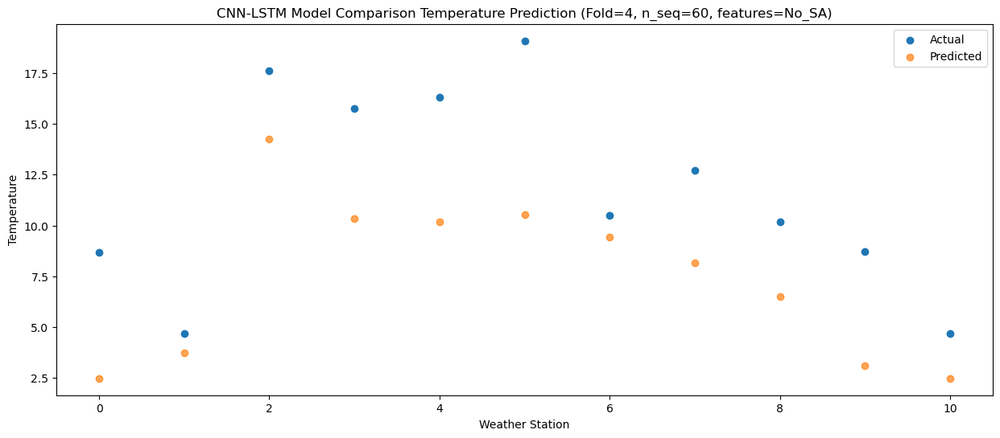

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.91   7.721485
1                 1    6.44   8.991360
2                 2   21.70  19.481411
3                 3   20.70  15.591431
4                 4   21.04  15.411431
5                 5   22.42  15.791391
6                 6   15.07  14.661392
7                 7   19.08  13.421452
8                 8   17.46  11.741496
9                 9   16.43   8.361511
10               10   11.19   7.721468


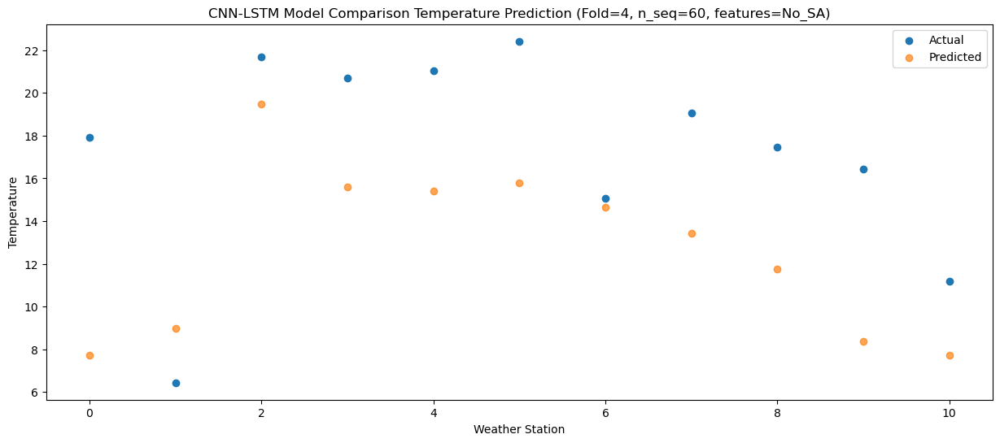

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.72  10.149693
1                 1    6.76  11.419491
2                 2   23.27  21.909567
3                 3   22.56  18.019609
4                 4   23.48  17.839609
5                 5   25.25  18.219543
6                 6   18.11  17.089535
7                 7   21.62  15.849635
8                 8   19.50  14.169686
9                 9   17.64  10.789724
10               10   14.63  10.149648


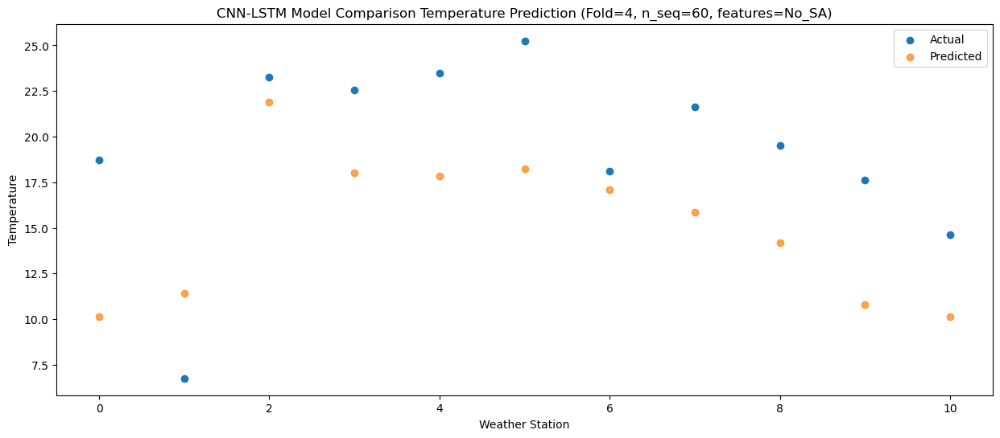

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   16.62   8.489544
1                 1    6.61   9.759342
2                 2   22.44  20.249420
3                 3   22.31  16.359462
4                 4   22.80  16.179461
5                 5   24.63  16.559396
6                 6   16.91  15.429389
7                 7   19.63  14.189486
8                 8   17.30  12.509539
9                 9   15.04   9.129581
10               10   12.22   8.489500


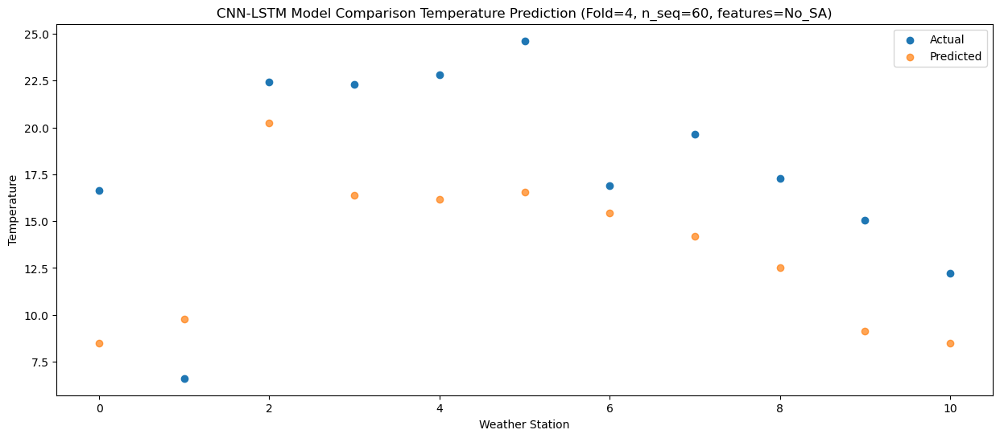

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.78   3.133492
1                 1    6.03   4.403314
2                 2   20.34  14.893383
3                 3   16.53  11.003416
4                 4   16.50  10.823415
5                 5   16.90  11.203357
6                 6   13.11  10.073357
7                 7   16.05   8.833441
8                 8   13.54   7.153499
9                 9   11.14   3.773528
10               10    8.23   3.133458


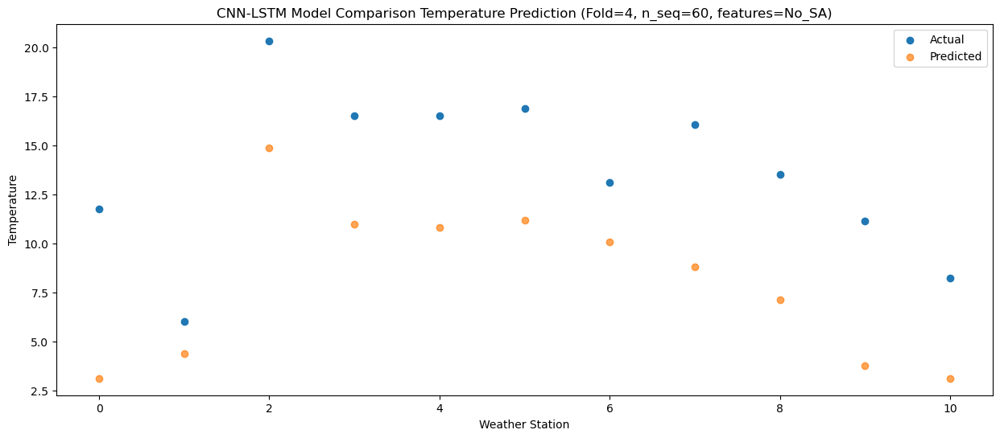

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.73  -3.010734
1                 1    4.53  -1.740882
2                 2   15.00   8.749178
3                 3   10.80   4.859202
4                 4   10.75   4.679200
5                 5   12.94   5.059151
6                 6    9.29   3.929155
7                 7    9.12   2.689223
8                 8    6.70   1.009282
9                 9    3.80  -2.370700
10               10    2.07  -3.010757


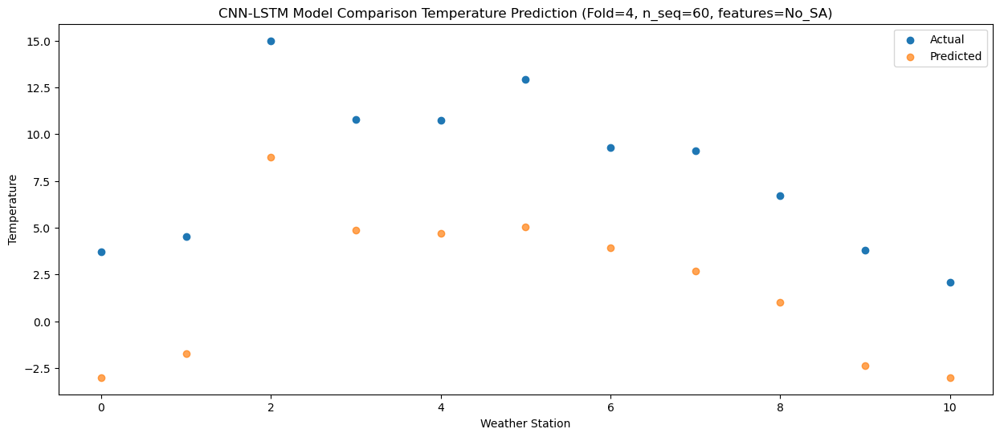

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.54  -6.913753
1                 1    1.14  -5.643903
2                 2   11.00   4.846159
3                 3    8.19   0.956184
4                 4    7.99   0.776179
5                 5    9.06   1.156133
6                 6    4.98   0.026136
7                 7    6.57  -1.213798
8                 8    2.86  -2.893737
9                 9    1.16  -6.273720
10               10   -1.16  -6.913776


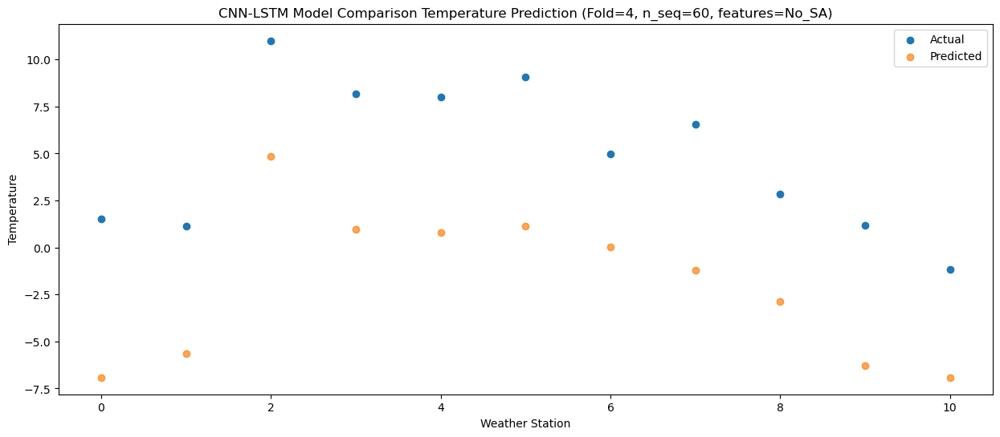

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -5.84 -13.629350
1                 1   -6.61 -12.359462
2                 2    4.75  -1.869415
3                 3    1.91  -5.759401
4                 4    1.42  -5.939408
5                 5    2.08  -5.559445
6                 6   -2.27  -6.689433
7                 7    0.04  -7.929384
8                 8   -4.65  -9.609323
9                 9   -6.72 -12.989317
10               10   -8.72 -13.629360


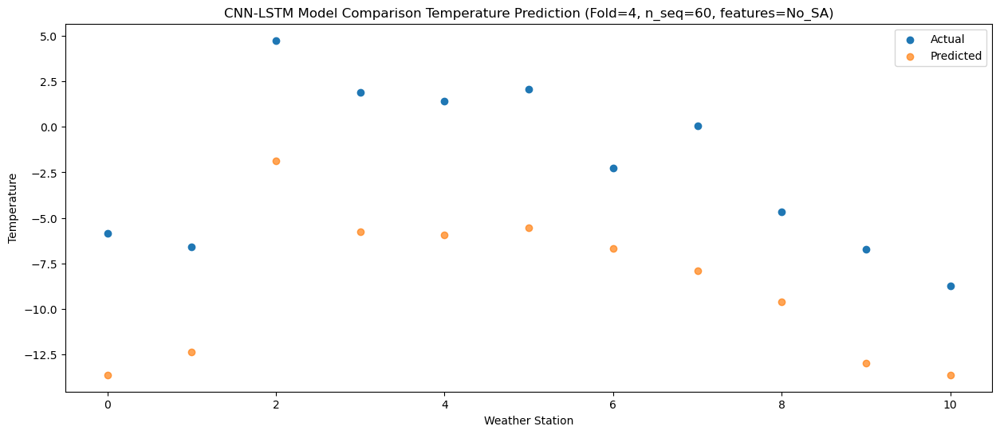

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -7.35 -14.860286
1                 1   -5.91 -13.590406
2                 2    4.78  -3.100354
3                 3    0.99  -6.990341
4                 4    0.82  -7.170348
5                 5    0.98  -6.790384
6                 6   -2.04  -7.920372
7                 7   -1.63  -9.160319
8                 8   -6.23 -10.840256
9                 9   -8.75 -14.220254
10               10  -10.64 -14.860295


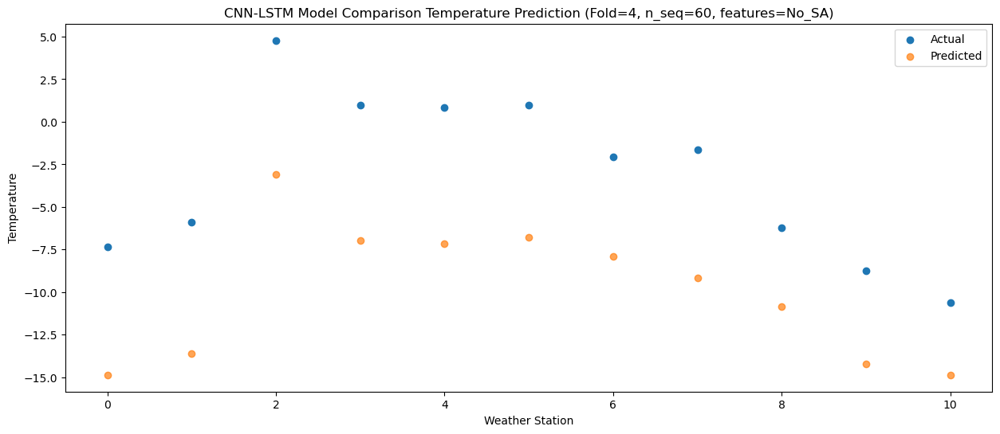

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -13.48 -17.446092
1                 1   -2.48 -16.176191
2                 2    2.86  -5.686146
3                 3   -2.47  -9.576141
4                 4   -3.07  -9.756148
5                 5   -0.59  -9.376181
6                 6   -1.37 -10.506164
7                 7   -5.24 -11.746118
8                 8   -9.59 -13.426053
9                 9  -13.19 -16.806056
10               10  -12.88 -17.446089


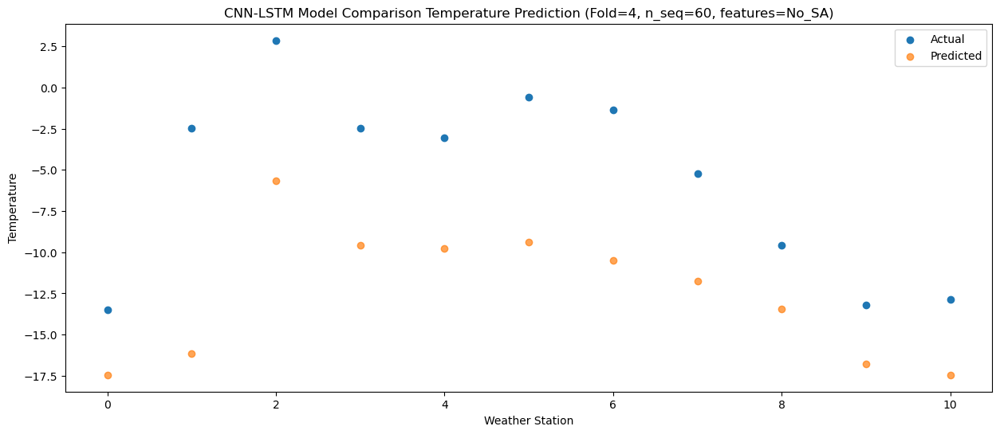

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.25  -9.515043
1                 1   -0.88  -8.245120
2                 2   12.19   2.244921
3                 3    8.49  -1.645080
4                 4    7.85  -1.825087
5                 5    8.66  -1.445120
6                 6    5.03  -2.575085
7                 7    7.03  -3.815059
8                 8    2.38  -5.494992
9                 9    0.67  -8.875007
10               10   -2.99  -9.515025


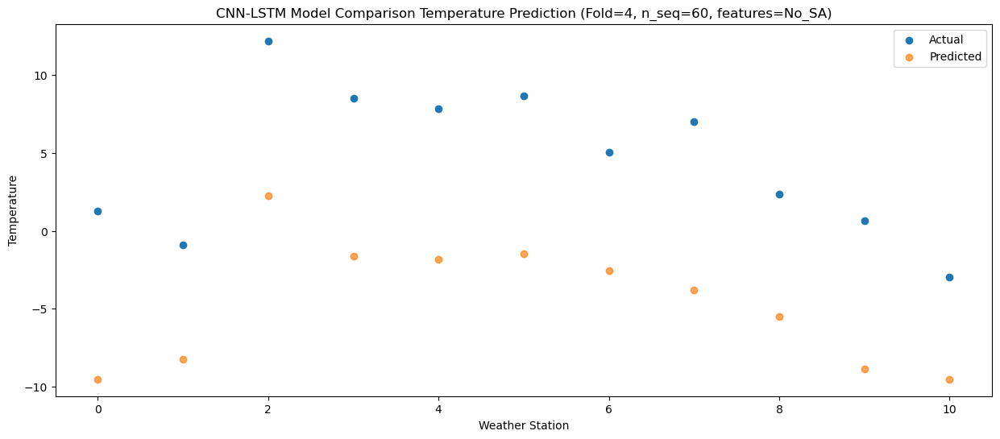

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.16  -6.512225
1                 1    0.56  -5.242341
2                 2   13.26   5.247707
3                 3   10.18   1.357724
4                 4   10.03   1.177715
5                 5   10.89   1.557669
6                 6    7.76   0.427699
7                 7    8.93  -0.812250
8                 8    6.03  -2.492178
9                 9    4.38  -5.872185
10               10    0.81  -6.512217


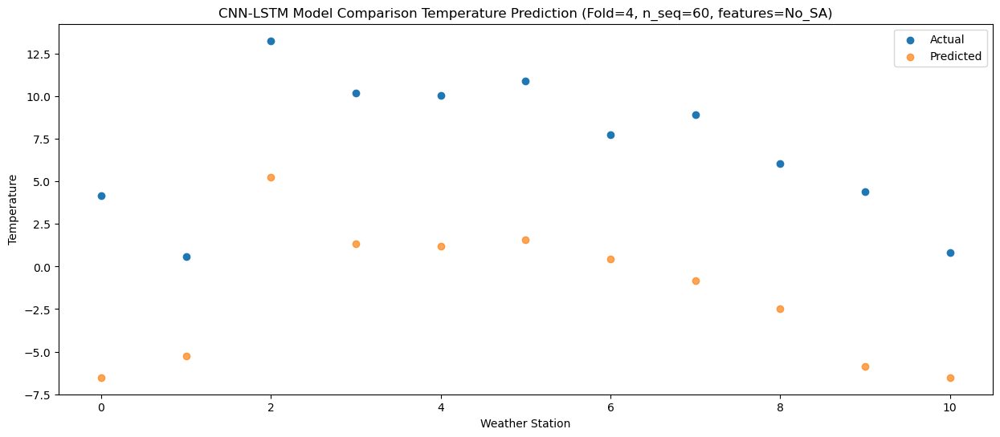

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.37  -2.392143
1                 1    4.60  -1.122369
2                 2   17.73   9.367725
3                 3   14.34   5.477769
4                 4   13.56   5.297758
5                 5   16.38   5.677674
6                 6   11.21   4.547703
7                 7   12.97   3.307808
8                 8   10.44   1.627897
9                 9    9.16  -1.752084
10               10    5.34  -2.392159


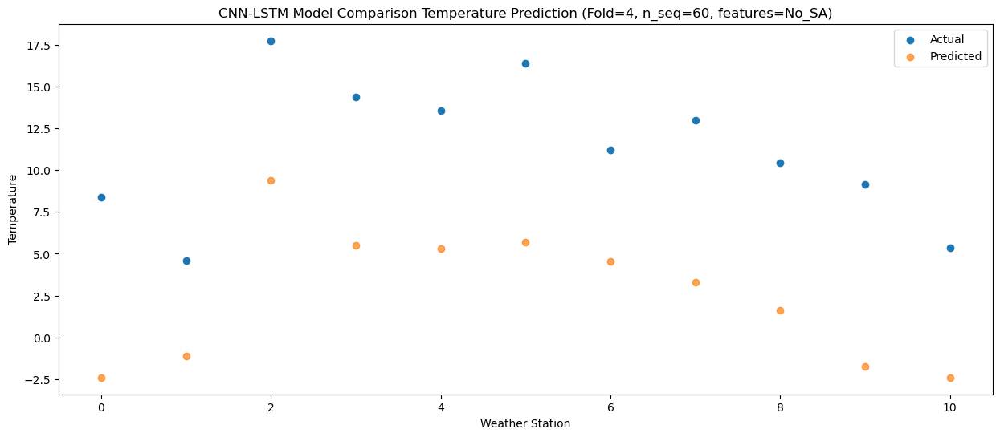

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.28   2.996001
1                 1    6.23   4.265744
2                 2   21.99  14.755849
3                 3   20.02  10.865905
4                 4   20.41  10.685893
5                 5   21.34  11.065795
6                 6   15.23   9.935824
7                 7   19.27   8.695944
8                 8   17.68   7.016045
9                 9   16.55   3.636068
10               10   12.23   2.995981


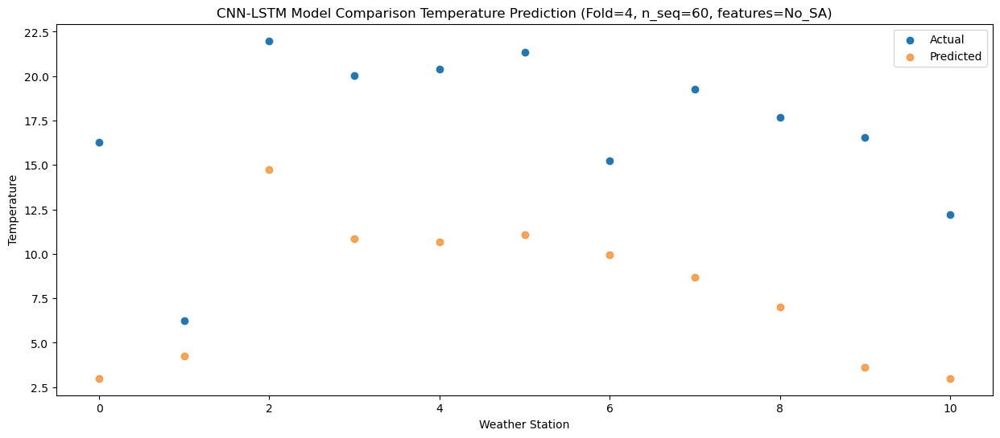

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.08   3.488488
1                 1    6.60   4.758201
2                 2   22.65  15.248317
3                 3   21.61  11.358378
4                 4   21.90  11.178362
5                 5   21.08  11.558260
6                 6   16.97  10.428289
7                 7   20.56   9.188422
8                 8   18.25   7.508533
9                 9   16.26   4.128561
10               10   12.39   3.488462


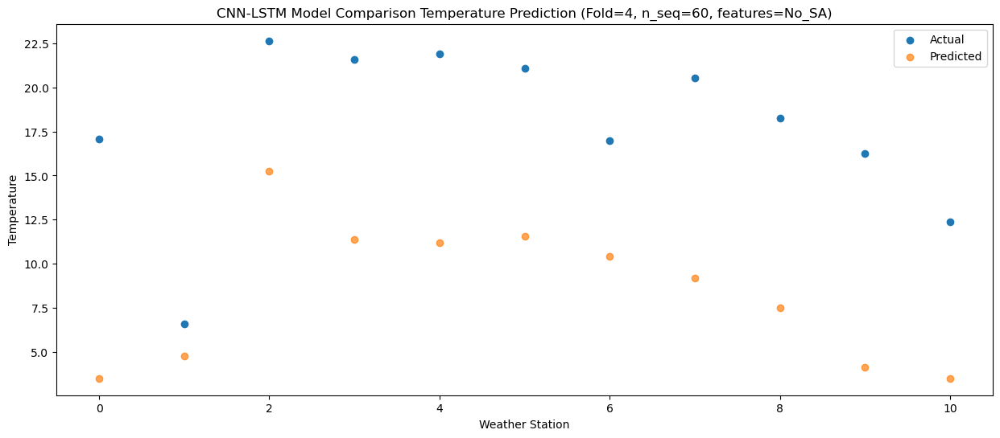

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   17.48   3.523085
1                 1    6.88   4.792775
2                 2   23.30  15.282900
3                 3   21.98  11.392964
4                 4   22.27  11.212947
5                 5   21.40  11.592842
6                 6   17.10  10.462869
7                 7   21.08   9.223013
8                 8   19.11   7.543127
9                 9   16.54   4.163155
10               10   13.59   3.523054


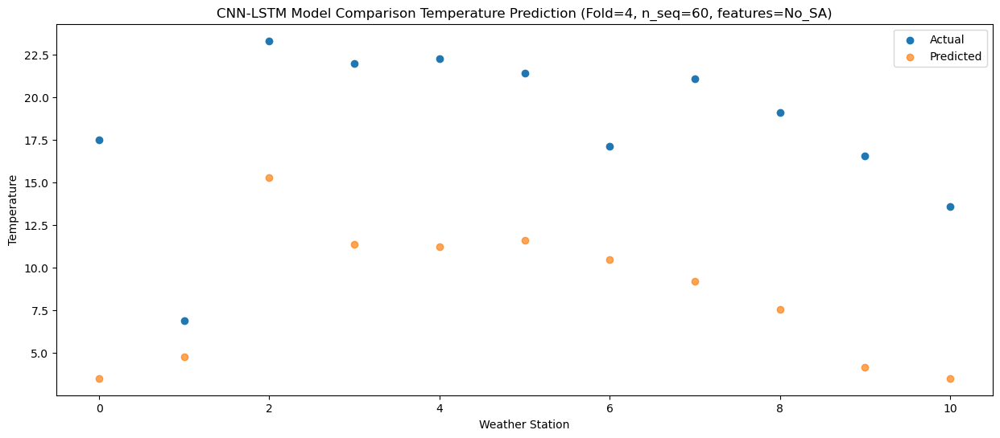

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.29  -0.589404
1                 1    5.59   0.680171
2                 2   20.18  11.170343
3                 3   19.19   7.280433
4                 4   18.84   7.100415
5                 5   20.71   7.480274
6                 6   13.13   6.350292
7                 7   18.04   5.110493
8                 8   15.62   3.430621
9                 9   13.43   0.050679
10               10    9.30  -0.589463


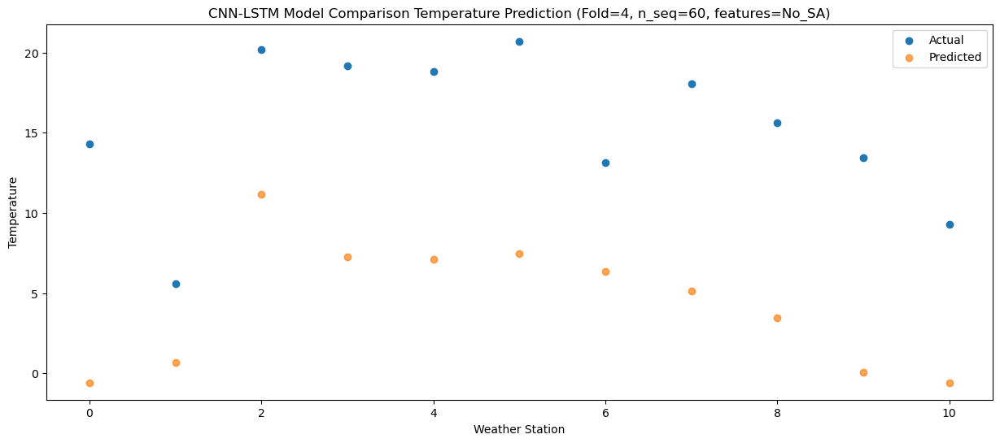

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.16  -5.493110
1                 1    3.75  -4.223618
2                 2   16.79   6.266583
3                 3   14.54   2.376696
4                 4   13.97   2.196677
5                 5   15.01   2.576512
6                 6    9.33   1.446522
7                 7   12.27   0.206765
8                 8   10.27  -1.473100
9                 9    7.97  -4.853020
10               10    5.77  -5.493194


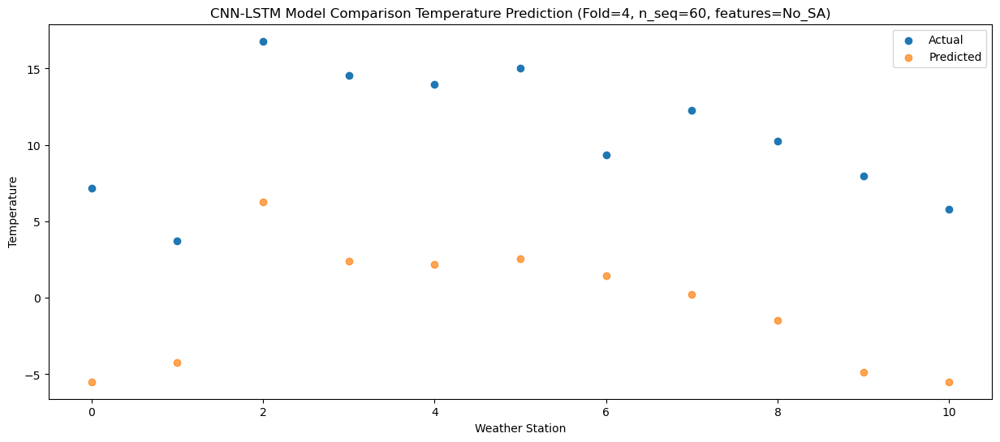

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.10 -14.865327
1                 1   -3.41 -13.595827
2                 2    8.12  -3.105629
3                 3    6.54  -6.995519
4                 4    6.13  -7.175537
5                 5    8.07  -6.795699
6                 6    1.17  -7.925689
7                 7    4.33  -9.165451
8                 8   -0.59 -10.845318
9                 9   -2.34 -14.225237
10               10   -4.63 -14.865409


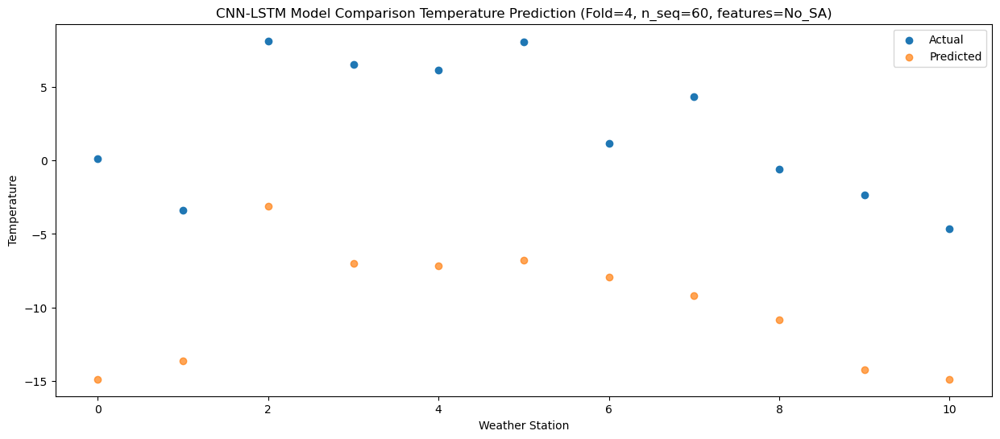

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.69 -15.013097
1                 1   -1.61 -13.743614
2                 2   11.63  -3.253405
3                 3    8.54  -7.143292
4                 4    7.87  -7.323309
5                 5    8.48  -6.943479
6                 6    3.08  -8.073470
7                 7    5.79  -9.313220
8                 8   -0.27 -10.993086
9                 9   -2.59 -14.373004
10               10   -5.49 -15.013182


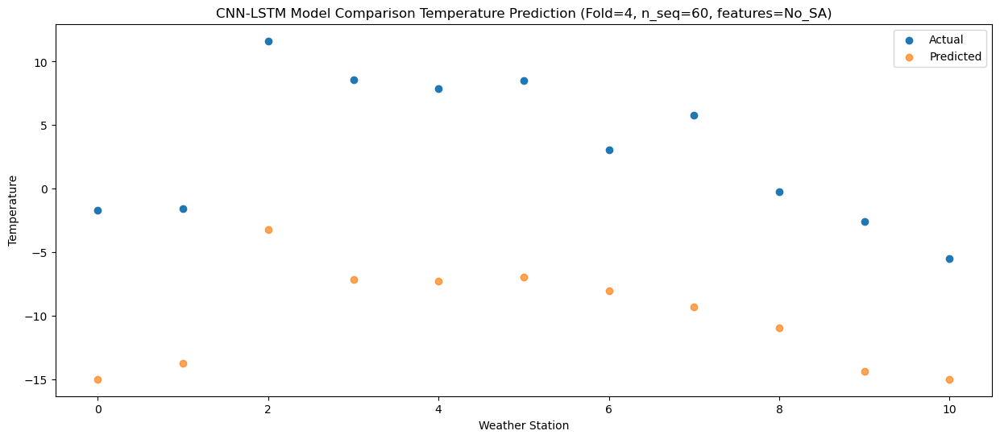

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.07 -22.133937
1                 1   -6.37 -20.864380
2                 2    3.35 -10.374198
3                 3    0.07 -14.264104
4                 4   -1.03 -14.444123
5                 5    1.11 -14.064270
6                 6   -2.98 -15.194254
7                 7   -3.28 -16.434037
8                 8   -9.11 -18.113911
9                 9  -12.07 -21.493849
10               10  -14.32 -22.133996


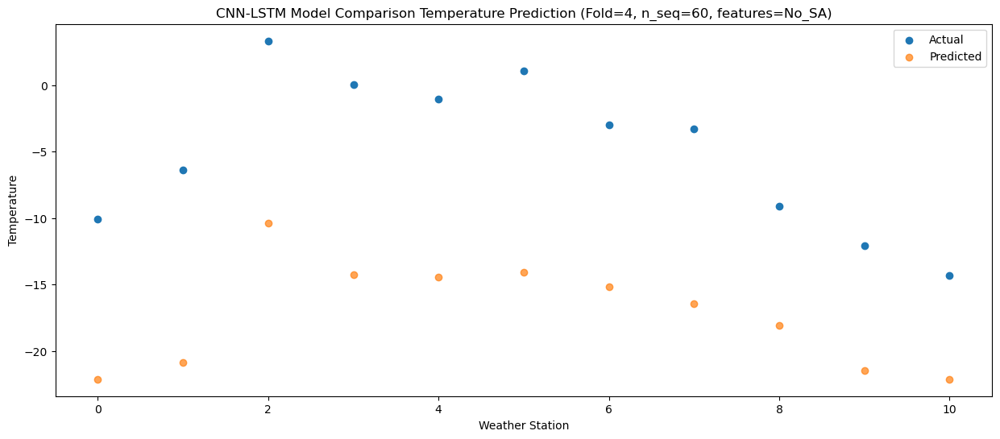

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -8.00 -20.399181
1                 1   -2.94 -19.129710
2                 2    5.71  -8.639497
3                 3    0.33 -12.529387
4                 4   -0.41 -12.709404
5                 5    0.91 -12.329574
6                 6    1.30 -13.459566
7                 7   -1.22 -14.699304
8                 8   -6.09 -16.379169
9                 9   -9.24 -19.759089
10               10  -10.76 -20.399271


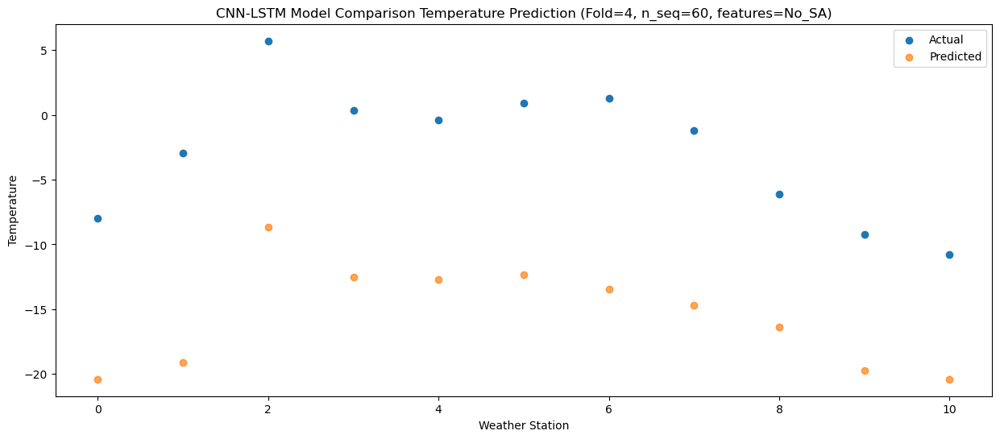

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -1.29 -15.696326
1                 1   -0.12 -14.426871
2                 2   10.45  -3.936645
3                 3    6.51  -7.826544
4                 4    6.51  -8.006559
5                 5    8.23  -7.626731
6                 6    4.86  -8.756721
7                 7    5.44  -9.996449
8                 8    1.38 -11.676314
9                 9   -1.03 -15.056230
10               10   -4.79 -15.696416


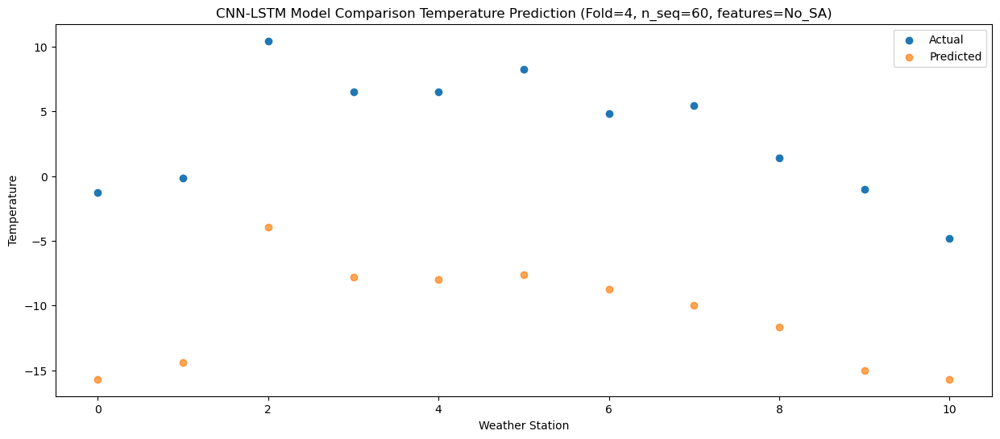

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.59 -11.793478
1                 1    2.22 -10.524015
2                 2   14.66  -0.033788
3                 3   12.56  -3.923696
4                 4   13.20  -4.103708
5                 5   15.74  -3.723879
6                 6    7.52  -4.853865
7                 7    9.30  -6.093593
8                 8    5.16  -7.773459
9                 9    3.09 -11.153382
10               10   -0.79 -11.793561


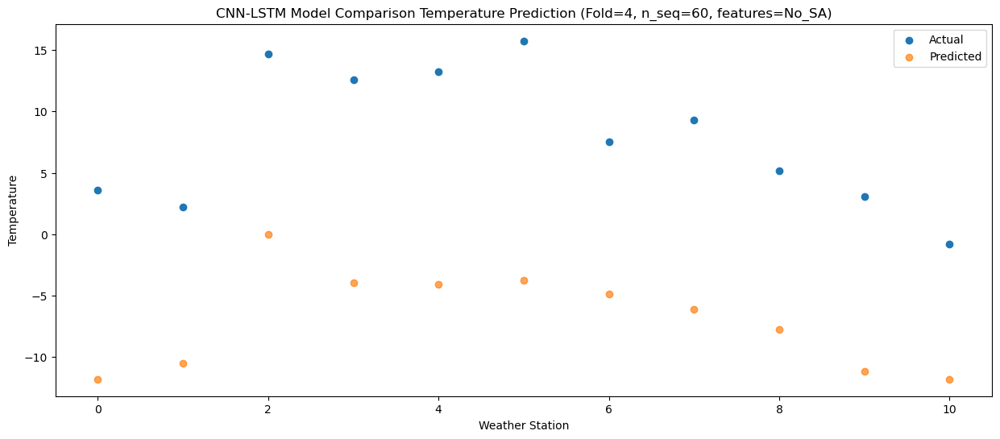

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.53  -6.169757
1                 1    5.04  -4.900283
2                 2   20.46   5.589939
3                 3   17.27   1.700025
4                 4   18.03   1.520012
5                 5   21.43   1.899849
6                 6   13.50   0.769863
7                 7   14.97  -0.469869
8                 8   13.66  -2.149735
9                 9   11.62  -5.529666
10               10    7.79  -6.169834


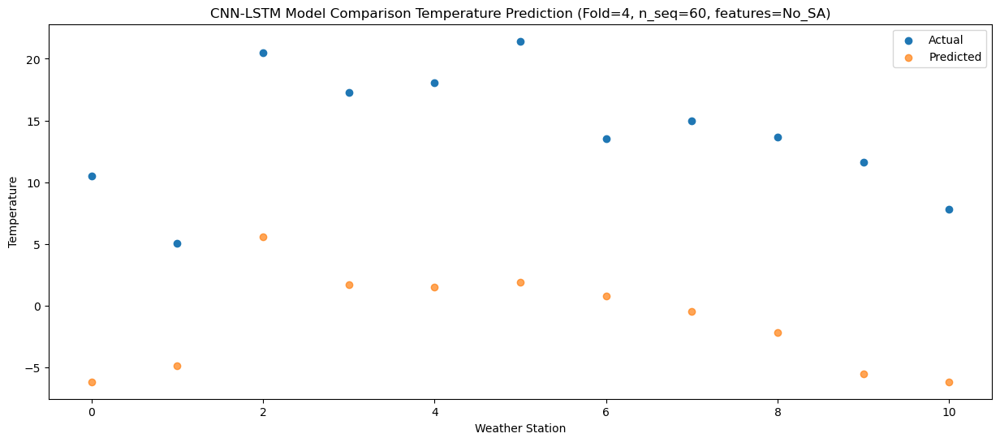

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   16.44  -2.566030
1                 1    6.76  -1.296526
2                 2   23.75   9.193688
3                 3   21.82   5.303766
4                 4   22.70   5.123751
5                 5   23.80   5.503592
6                 6   16.71   4.373618
7                 7   20.29   3.133868
8                 8   18.14   1.454002
9                 9   16.23  -1.925933
10               10   11.06  -2.566087


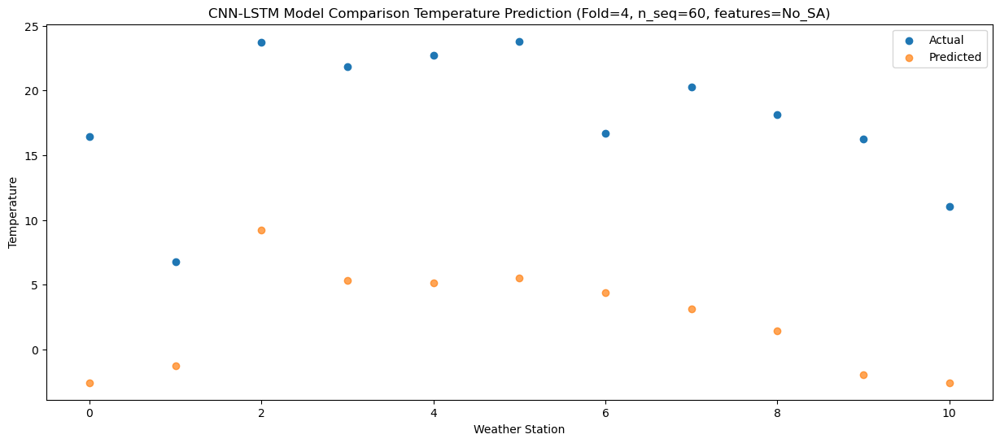

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   18.96  -0.279121
1                 1    7.13   0.990353
2                 2   23.95  11.480581
3                 3   25.12   7.590667
4                 4   26.12   7.410652
5                 5   25.70   7.790481
6                 6   17.98   6.660509
7                 7   23.99   5.420769
8                 8   20.08   3.740905
9                 9   17.05   0.360984
10               10   13.66  -0.279186


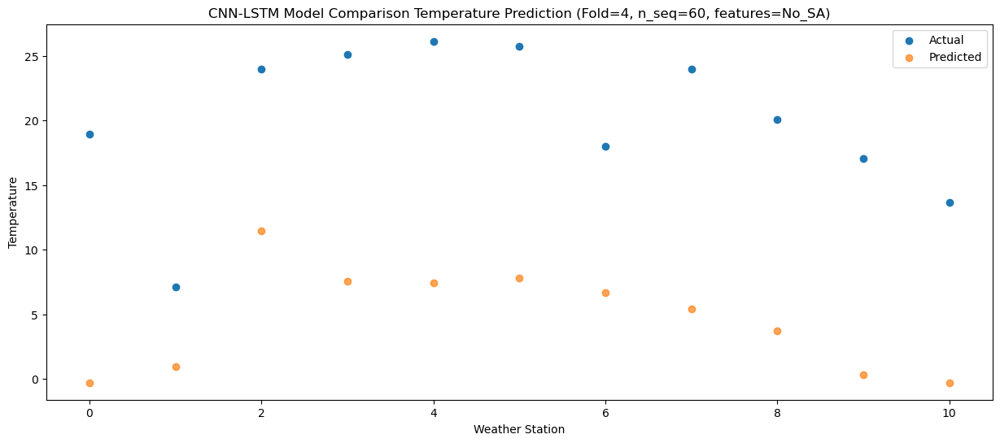

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.30  -1.763156
1                 1    7.08  -0.493655
2                 2   22.41   9.996558
3                 3   22.39   6.106639
4                 4   23.28   5.926626
5                 5   22.40   6.306461
6                 6   16.46   5.176491
7                 7   20.47   3.936743
8                 8   17.85   2.256876
9                 9   15.75  -1.123052
10               10   12.59  -1.763211


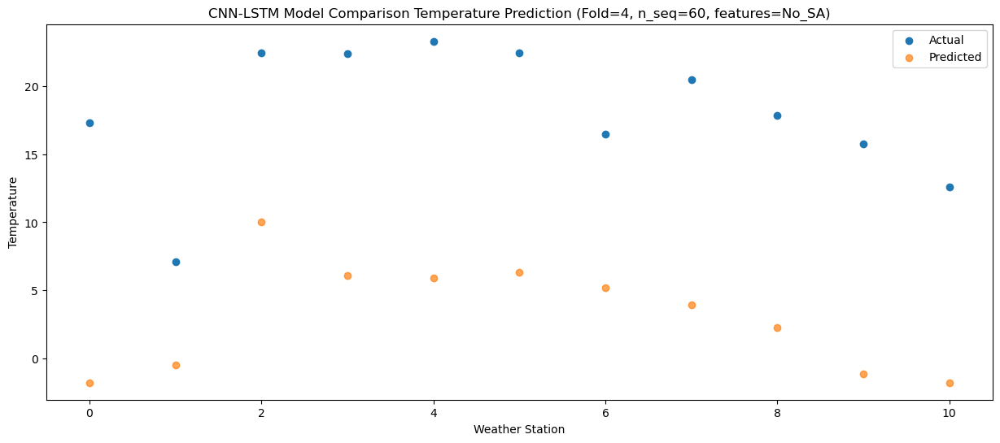

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   13.39  -5.919209
1                 1    5.64  -4.649741
2                 2   20.34   5.840478
3                 3   18.96   1.950571
4                 4   19.19   1.770559
5                 5   19.50   2.150376
6                 6   13.37   1.020410
7                 7   16.88  -0.219315
8                 8   13.94  -1.899185
9                 9   11.61  -5.279107
10               10    8.54  -5.919274


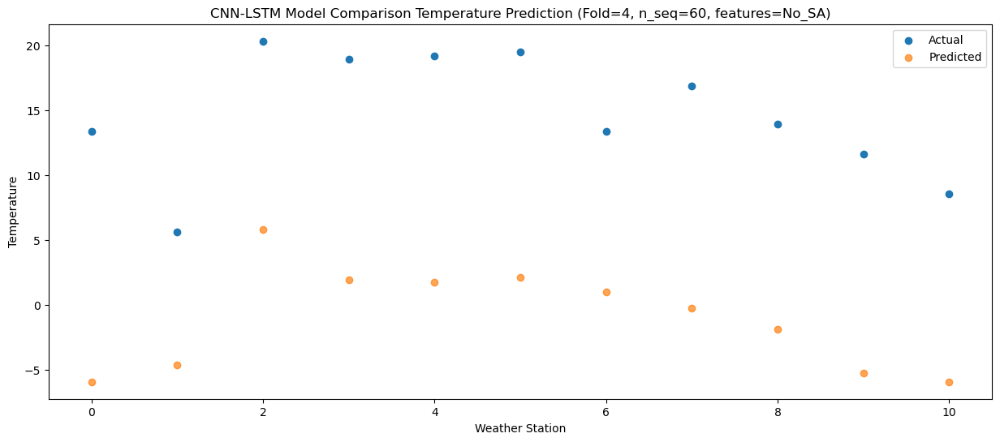

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    6.04 -13.270492
1                 1    1.81 -12.001064
2                 2   14.21  -1.510829
3                 3   12.09  -5.400726
4                 4   12.04  -5.580738
5                 5   12.69  -5.200934
6                 6    6.50  -6.330902
7                 7   10.51  -7.570609
8                 8    6.45  -9.250469
9                 9    4.14 -12.630384
10               10    1.68 -13.270568


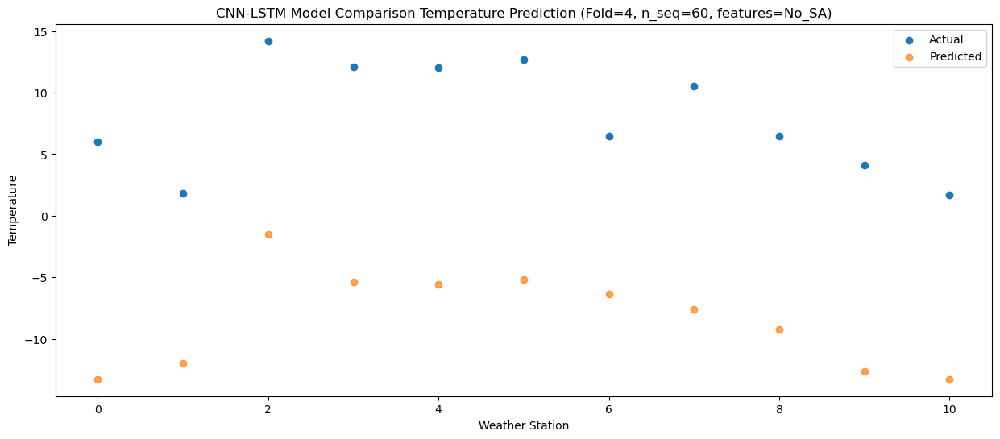

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -2.29 -18.400470
1                 1    0.35 -17.130989
2                 2    9.62  -6.640782
3                 3    5.04 -10.530687
4                 4    4.95 -10.710699
5                 5    4.84 -10.330880
6                 6    3.80 -11.460841
7                 7    3.96 -12.700576
8                 8    0.66 -14.380438
9                 9   -1.40 -17.760368
10               10   -2.40 -18.400529


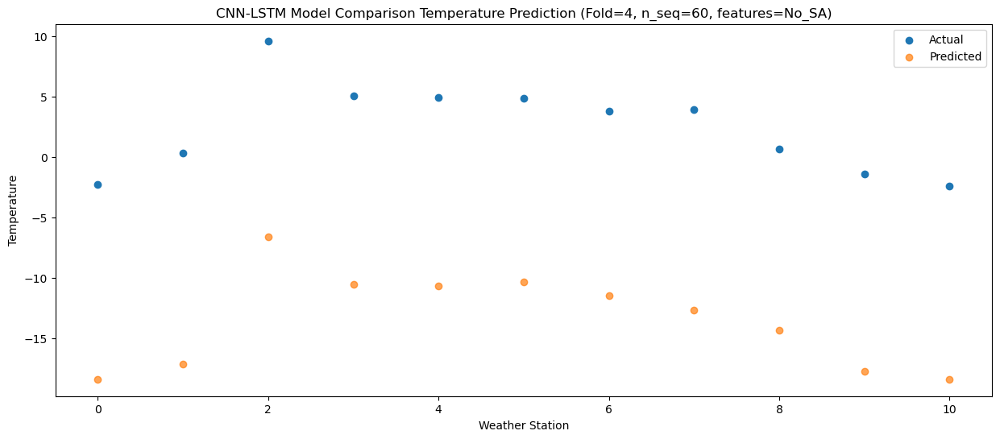

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -8.43 -24.151211
1                 1   -4.50 -22.881700
2                 2    7.19 -12.391506
3                 3    2.35 -16.281422
4                 4    1.98 -16.461433
5                 5    3.24 -16.081605
6                 6   -2.15 -17.211561
7                 7   -0.89 -18.451308
8                 8   -5.12 -20.131175
9                 9   -8.13 -23.511114
10               10   -9.11 -24.151264


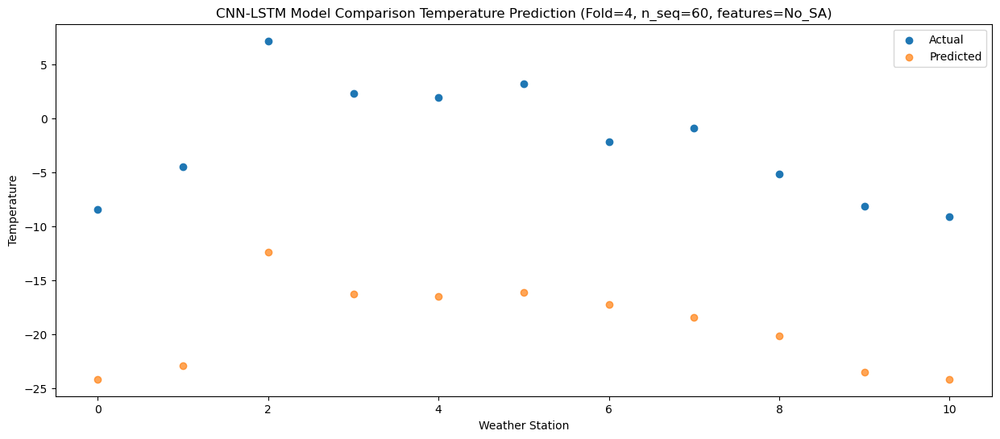

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.47 -23.129523
1                 1   -4.65 -21.860065
2                 2    7.60 -11.369853
3                 3    3.34 -15.259751
4                 4    2.75 -15.439767
5                 5    3.61 -15.059956
6                 6    0.87 -16.189916
7                 7    0.76 -17.429632
8                 8   -3.16 -19.109493
9                 9   -5.89 -22.489420
10               10   -7.48 -23.129590


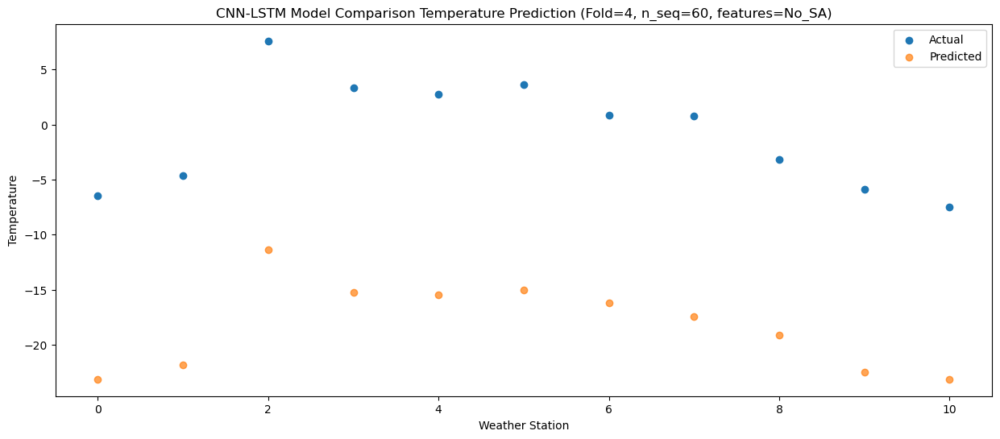

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -4.72 -23.088735
1                 1   -1.35 -21.819245
2                 2    9.54 -11.329047
3                 3    3.40 -15.218953
4                 4    2.98 -15.398969
5                 5    3.78 -15.019150
6                 6    4.29 -16.149103
7                 7    2.90 -17.388840
8                 8   -1.57 -19.068695
9                 9   -4.70 -22.448632
10               10   -7.34 -23.088788


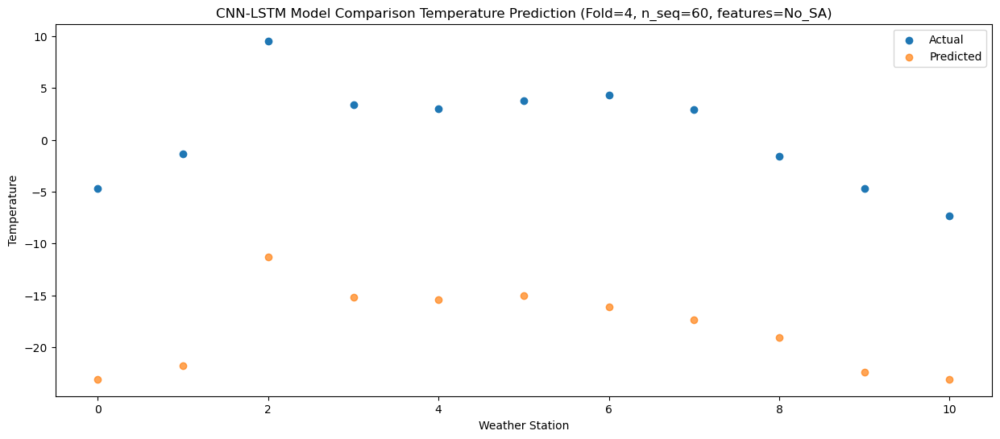

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.54 -21.515241
1                 1    0.37 -20.245708
2                 2   11.69  -9.755532
3                 3    7.93 -13.645446
4                 4    7.83 -13.825459
5                 5    8.85 -13.445635
6                 6    4.77 -14.575575
7                 7    4.62 -15.815334
8                 8   -0.30 -17.495191
9                 9   -2.16 -20.875138
10               10   -6.46 -21.515279


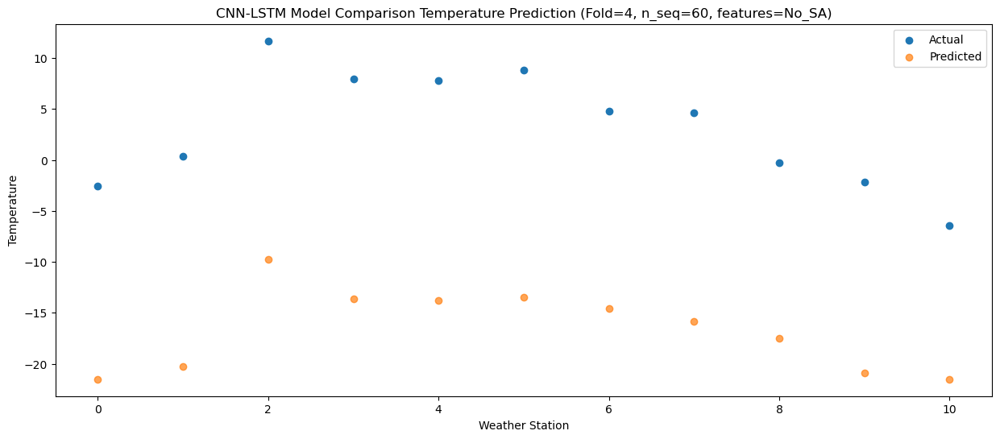

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    5.29 -16.823443
1                 1    3.09 -15.553871
2                 2   13.44  -5.063712
3                 3   10.53  -8.953632
4                 4   10.48  -9.133646
5                 5   13.07  -8.753815
6                 6    7.88  -9.883750
7                 7   10.24 -11.123528
8                 8    6.20 -12.803385
9                 9    5.17 -16.183340
10               10    2.01 -16.823469


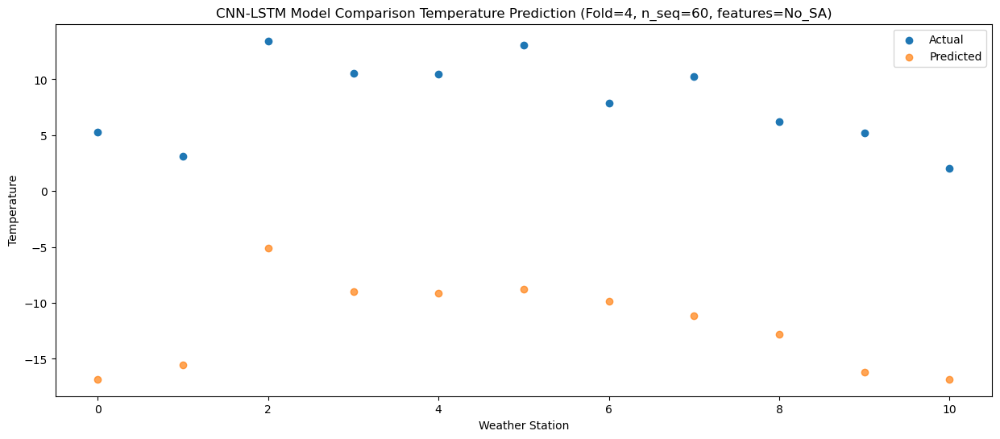

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   11.10 -12.919876
1                 1    3.87 -11.650355
2                 2   18.30  -1.160169
3                 3   16.21  -5.050081
4                 4   16.64  -5.230095
5                 5   17.99  -4.850278
6                 6   10.50  -5.980215
7                 7   15.02  -7.219969
8                 8   11.91  -8.899821
9                 9   10.93 -12.279763
10               10    5.70 -12.919910


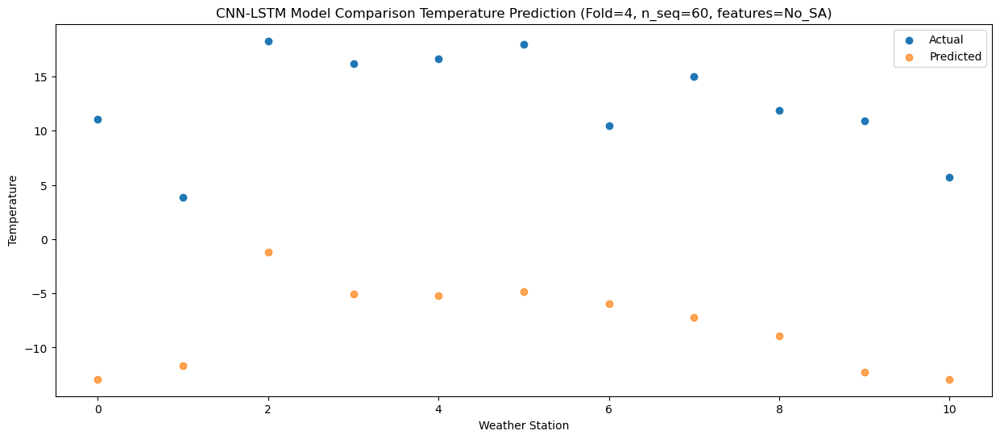

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.01  -9.136526
1                 1    6.08  -7.867029
2                 2   21.89   2.623171
3                 3   20.40  -1.266738
4                 4   21.75  -1.446751
5                 5   24.47  -1.066942
6                 6   14.14  -2.196879
7                 7   19.10  -3.436626
8                 8   15.79  -5.116469
9                 9   15.24  -8.496412
10               10   10.01  -9.136559


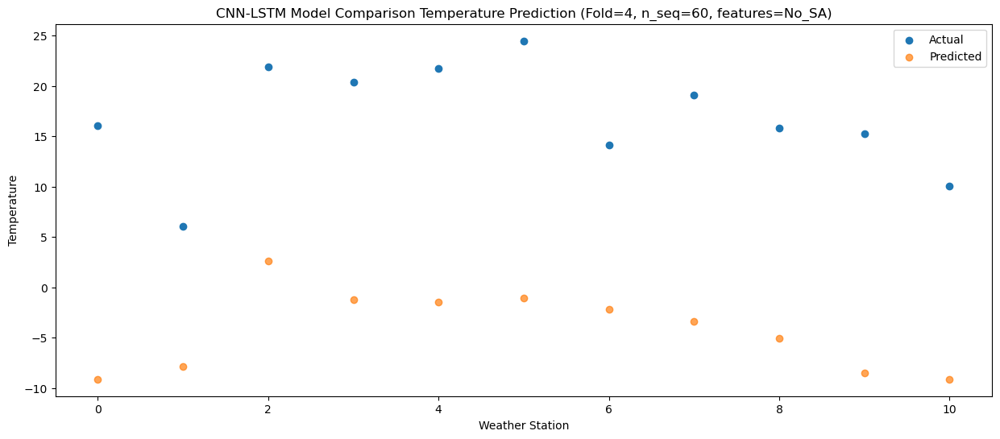

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   17.32  -5.862227
1                 1    7.69  -4.592692
2                 2   23.67   5.897490
3                 3   22.95   2.007568
4                 4   24.83   1.827555
5                 5   25.93   2.207378
6                 6   18.01   1.077443
7                 7   21.06  -0.162318
8                 8   18.52  -1.842160
9                 9   16.77  -5.222114
10               10   13.10  -5.862247


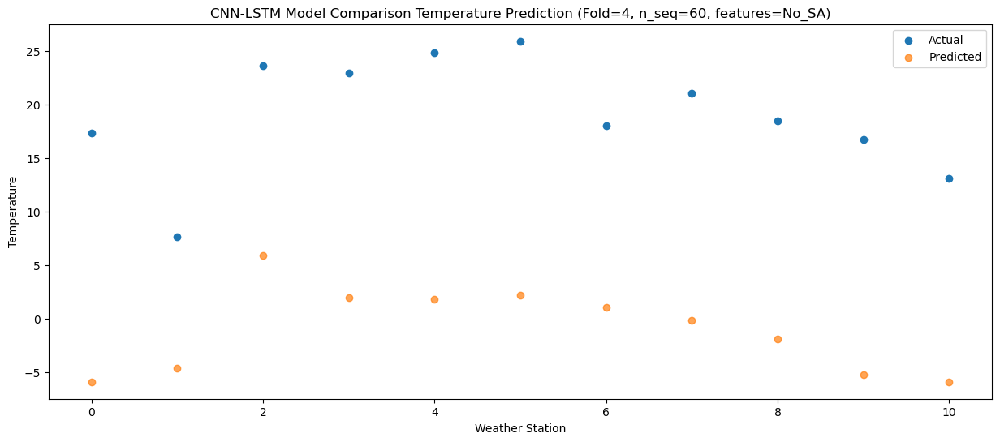

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.12  -7.010328
1                 1    8.20  -5.740848
2                 2   25.75   4.749357
3                 3   25.50   0.859451
4                 4   26.70   0.679433
5                 5   26.02   1.059239
6                 6   17.45  -0.070698
7                 7   20.87  -1.310431
8                 8   17.36  -2.990267
9                 9   15.51  -6.370210
10               10   11.77  -7.010364


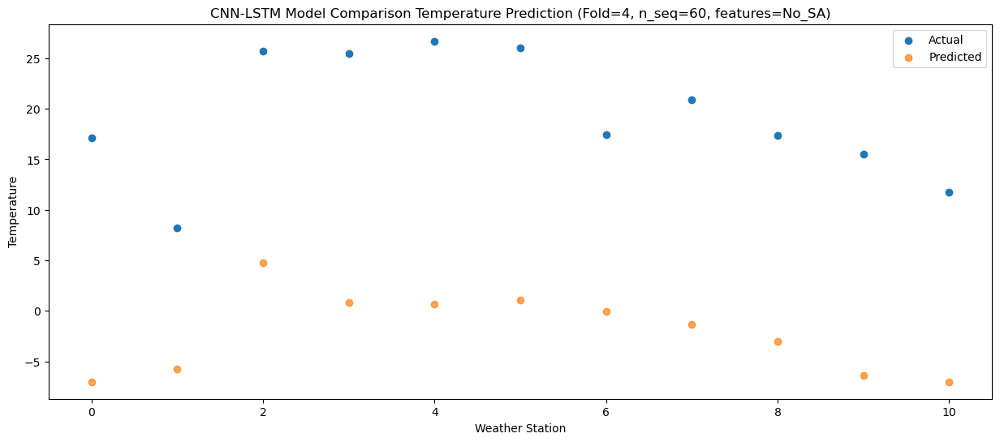

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.29 -10.545310
1                 1    6.10  -9.275857
2                 2   22.00   1.214360
3                 3   20.80  -2.675538
4                 4   21.61  -2.855557
5                 5   22.54  -2.475761
6                 6   13.61  -3.605700
7                 7   16.93  -4.845419
8                 8   14.27  -6.525254
9                 9   12.47  -9.905190
10               10    9.43 -10.545358


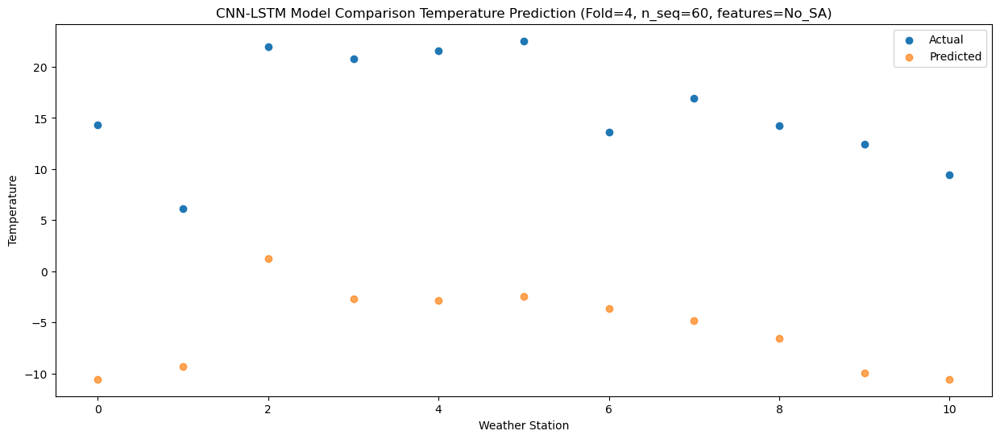

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    7.17 -17.095811
1                 1    2.45 -15.826316
2                 2   15.89  -5.336114
3                 3   12.67  -9.226024
4                 4   12.78  -9.406042
5                 5   14.01  -9.026234
6                 6    8.17 -10.156169
7                 7   11.03 -11.395906
8                 8    8.13 -13.075749
9                 9    6.06 -16.455690
10               10    4.17 -17.095845


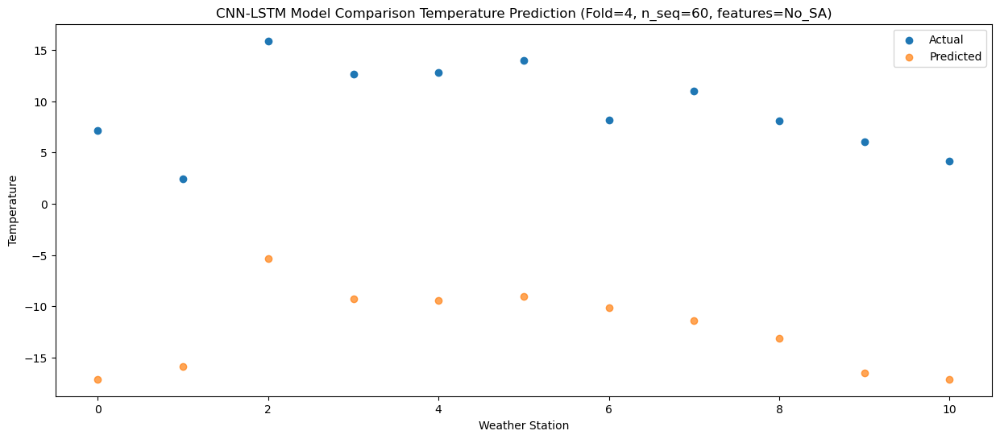

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.92 -24.201647
1                 1   -1.26 -22.932219
2                 2    8.93 -12.441992
3                 3    6.60 -16.331884
4                 4    6.25 -16.511904
5                 5    7.30 -16.132115
6                 6    2.44 -17.262054
7                 7    5.13 -18.501761
8                 8    1.06 -20.181597
9                 9   -1.03 -23.561520
10               10   -3.22 -24.201702


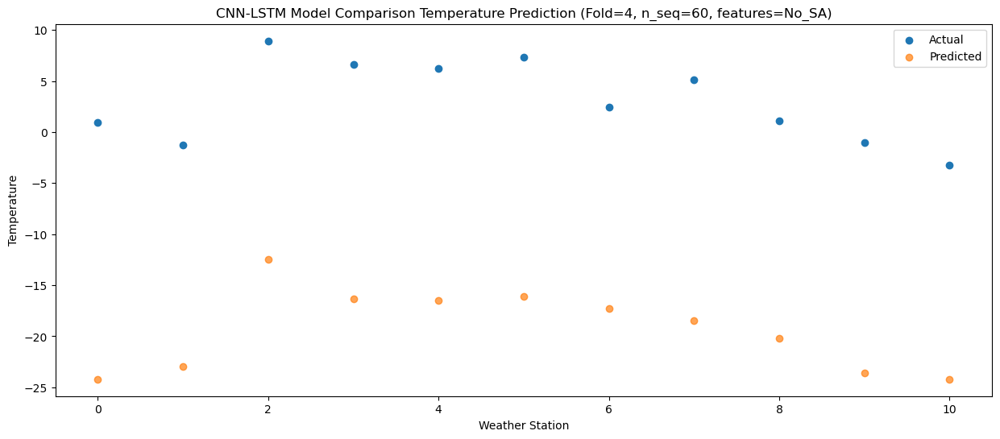

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.48 -26.272067
1                 1   -3.38 -25.002675
2                 2    6.38 -14.512436
3                 3    3.58 -18.402316
4                 4    3.12 -18.582337
5                 5    4.50 -18.202560
6                 6    0.23 -19.332506
7                 7    2.25 -20.572190
8                 8   -0.83 -22.252025
9                 9   -3.02 -25.631941
10               10   -3.88 -26.272136


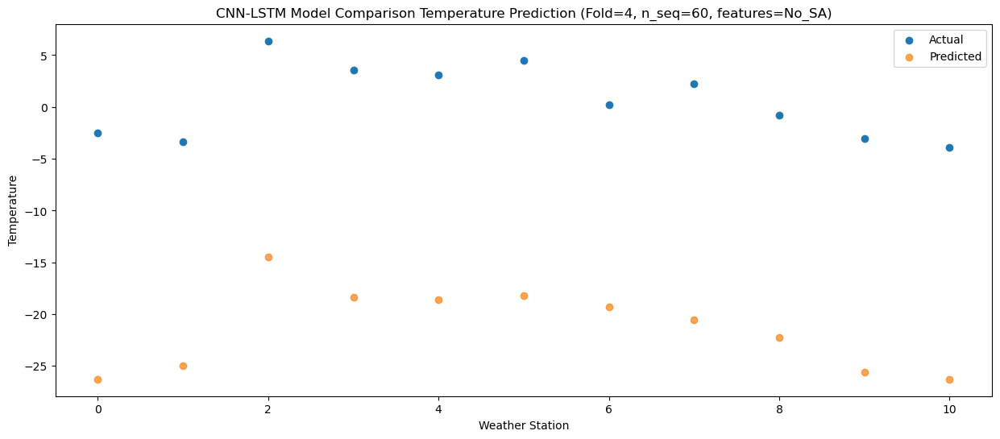

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -11.07 -30.825515
1                 1   -4.80 -29.556125
2                 2    2.19 -19.065887
3                 3   -1.94 -22.955766
4                 4   -2.23 -23.135785
5                 5    0.25 -22.756010
6                 6   -2.21 -23.885957
7                 7   -4.91 -25.125641
8                 8   -7.11 -26.805475
9                 9  -10.60 -30.185390
10               10   -9.65 -30.825586


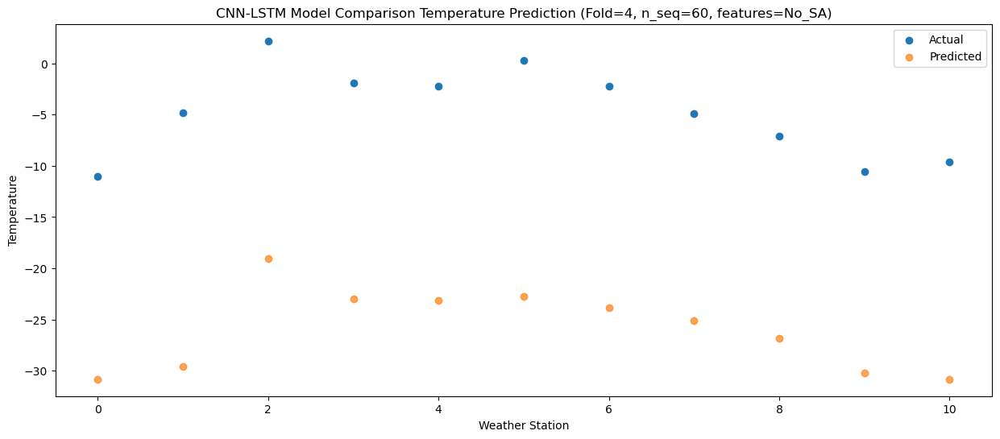

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.04 -27.029700
1                 1   -5.07 -25.760355
2                 2    8.51 -15.270107
3                 3    6.47 -19.159976
4                 4    6.09 -19.339996
5                 5    7.07 -18.960232
6                 6    1.20 -20.090176
7                 7    5.00 -21.329842
8                 8   -0.77 -23.009660
9                 9   -2.83 -26.389567
10               10   -6.17 -27.029781


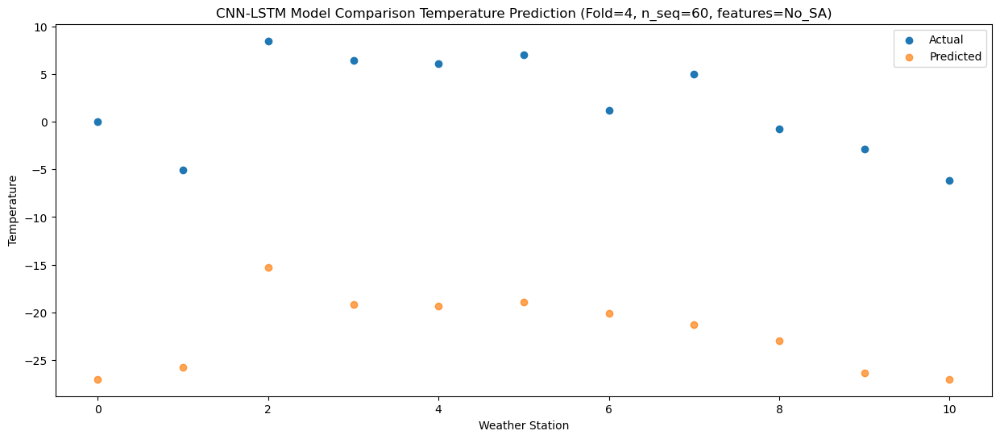

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.57 -24.373651
1                 1   -0.17 -23.104283
2                 2   10.74 -12.614052
3                 3    8.88 -16.503921
4                 4    8.66 -16.683939
5                 5    9.67 -16.304167
6                 6    4.99 -17.434109
7                 7    7.43 -18.673785
8                 8    3.67 -20.353602
9                 9    1.32 -23.733520
10               10   -2.82 -24.373724


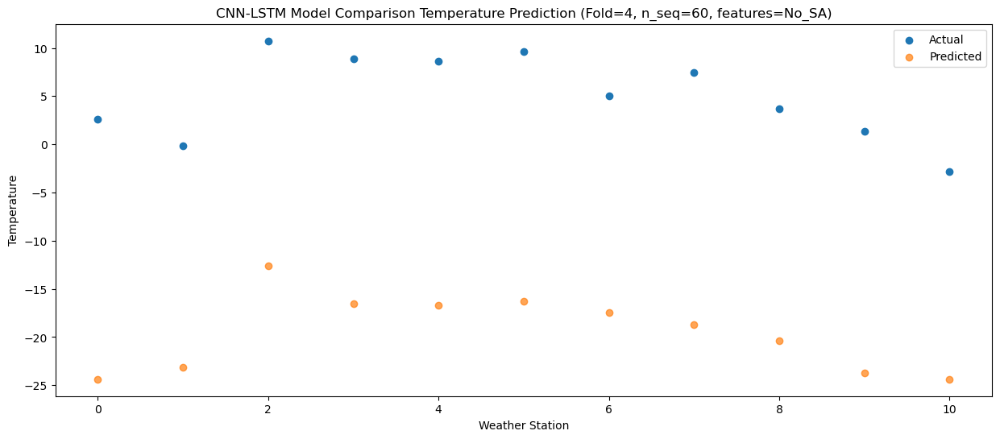

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    7.19 -20.602692
1                 1    0.88 -19.333336
2                 2   14.56  -8.843098
3                 3   12.73 -12.732971
4                 4   12.71 -12.912988
5                 5   14.63 -12.533215
6                 6    9.22 -13.663157
7                 7   11.57 -14.902835
8                 8    8.25 -16.582647
9                 9    5.81 -19.962566
10               10    2.90 -20.602771


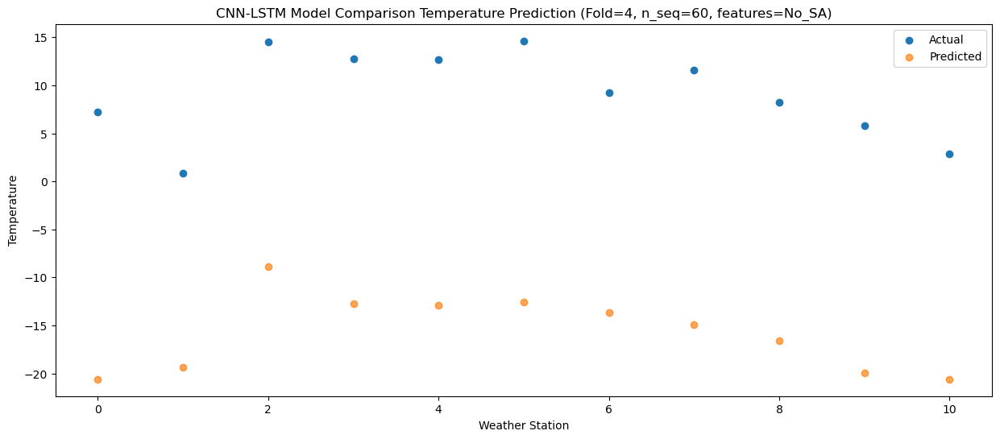

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   12.20 -16.228225
1                 1    6.33 -14.958825
2                 2   20.08  -4.468603
3                 3   17.49  -8.358495
4                 4   17.51  -8.538513
5                 5   19.92  -8.158720
6                 6   13.29  -9.288650
7                 7   16.22 -10.528355
8                 8   14.85 -12.208172
9                 9   12.84 -15.588102
10               10    9.00 -16.228290


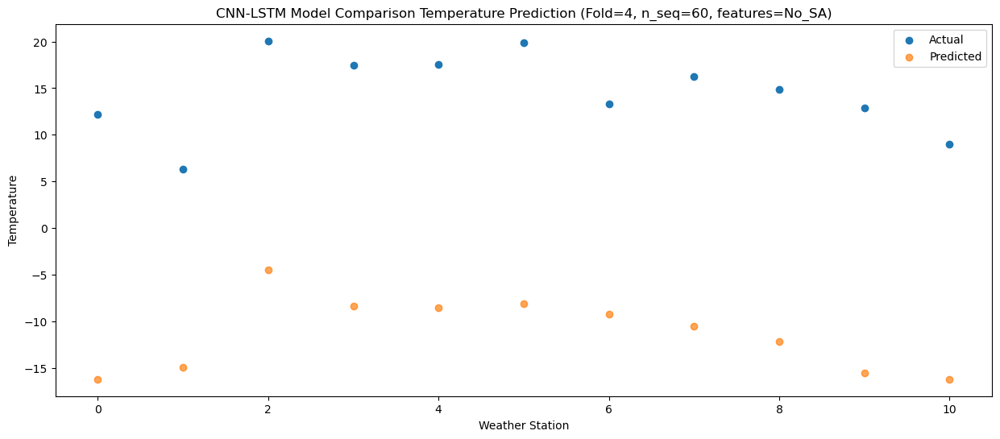

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.39 -11.762963
1                 1    6.98 -10.493597
2                 2   22.71  -0.003360
3                 3   21.52  -3.893249
4                 4   21.96  -4.073267
5                 5   23.93  -3.693477
6                 6   16.71  -4.823412
7                 7   19.94  -6.063105
8                 8   18.21  -7.742920
9                 9   16.81 -11.122840
10               10   12.16 -11.763044


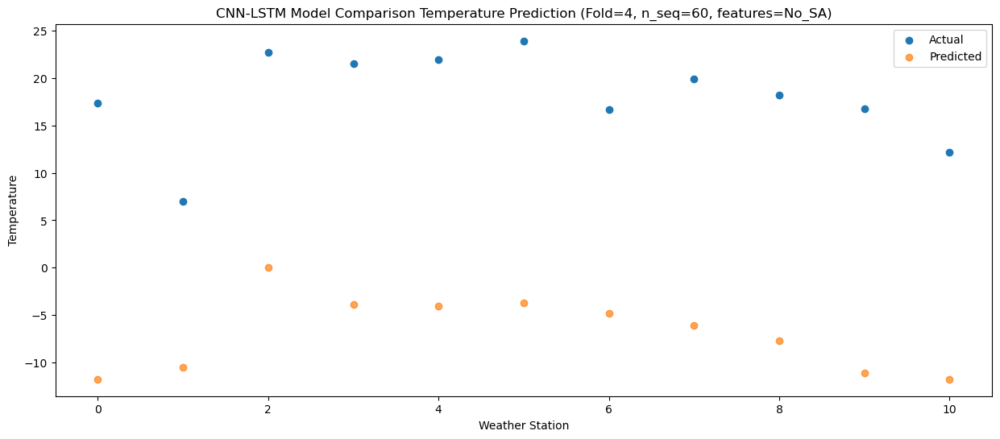

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.15 -10.684350
1                 1    7.67  -9.414968
2                 2   23.73   1.075261
3                 3   22.42  -2.814632
4                 4   22.67  -2.994652
5                 5   22.76  -2.614856
6                 6   18.17  -3.744781
7                 7   20.24  -4.984488
8                 8   18.22  -6.664303
9                 9   15.84 -10.044227
10               10   13.68 -10.684425


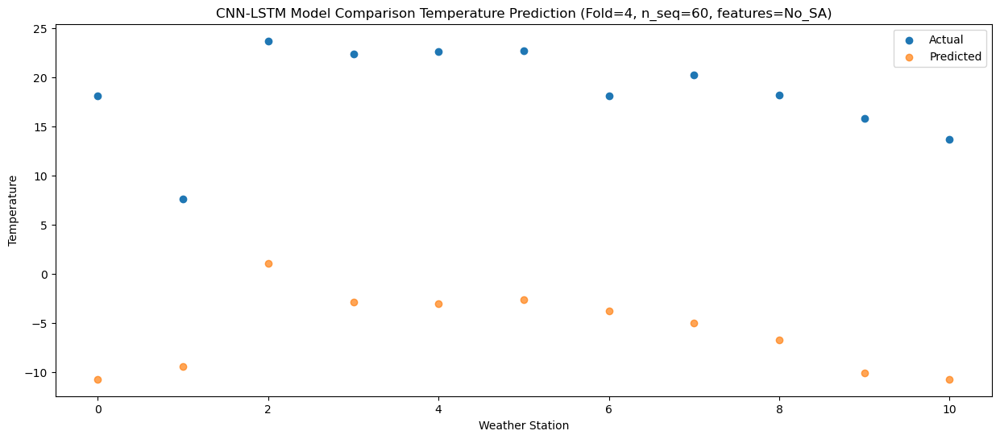

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   16.66 -12.038252
1                 1    7.37 -10.768878
2                 2   24.30  -0.278645
3                 3   24.17  -4.168537
4                 4   24.63  -4.348558
5                 5   25.22  -3.968767
6                 6   17.01  -5.098687
7                 7   20.68  -6.338389
8                 8   18.14  -8.018203
9                 9   15.50 -11.398129
10               10   12.54 -12.038323


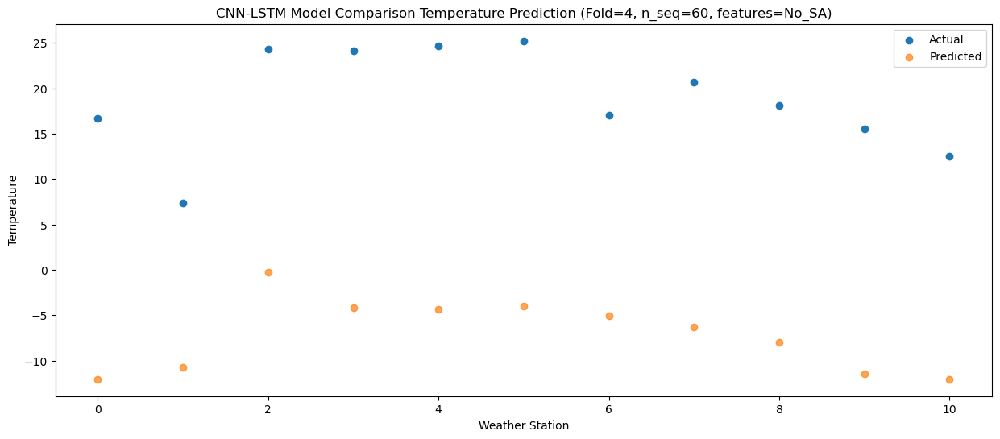

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.23 -16.014735
1                 1    6.50 -14.745386
2                 2   20.69  -4.255141
3                 3   18.78  -8.145029
4                 4   18.62  -8.325051
5                 5   18.77  -7.945267
6                 6   14.57  -9.075186
7                 7   16.54 -10.314878
8                 8   15.53 -11.994686
9                 9   12.27 -15.374604
10               10   10.27 -16.014807


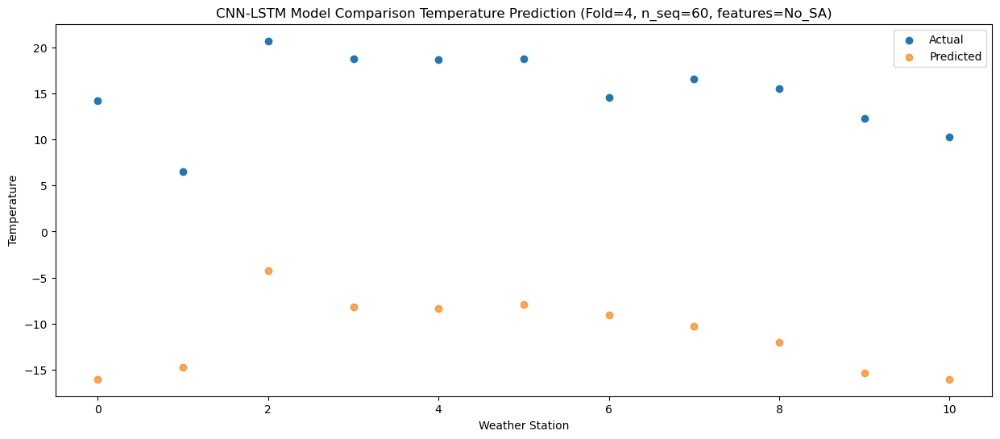

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   10.10 -21.503423
1                 1    2.73 -20.234088
2                 2   16.55  -9.743837
3                 3   16.03 -13.633722
4                 4   16.20 -13.813746
5                 5   17.06 -13.433965
6                 6    8.95 -14.563883
7                 7   12.86 -15.803567
8                 8    9.60 -17.483372
9                 9    7.20 -20.863292
10               10    3.80 -21.503496


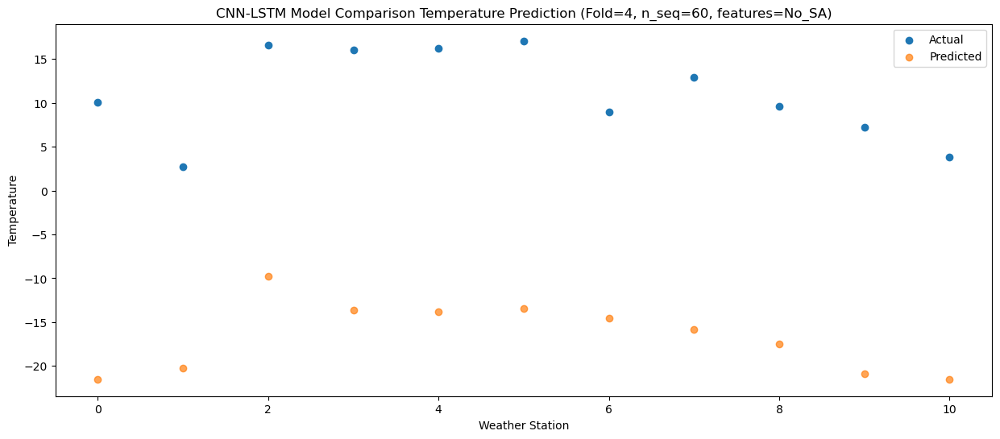

f, t:
[[ -2.86  -2.38   6.75   4.23   3.65   5.12   0.86   2.01  -2.64  -4.88
   -6.79]
 [ -4.52  -2.56   6.81   2.58   1.87   3.48   0.51   1.2   -3.46  -5.2
   -7.57]
 [ -7.48  -4.02   6.62   2.82   2.49   2.75   0.34  -0.45  -4.39  -7.64
   -8.77]
 [ -6.37  -2.47   6.88   2.49   2.11   1.99   0.81   0.12  -5.22  -7.89
   -9.58]
 [  1.16   1.6   14.68   9.95   9.99   9.55   6.42   7.05   1.6   -0.29
   -3.42]
 [  3.59   3.28  13.73  10.61  10.68  12.52   7.69   8.63   4.59   2.82
   -2.04]
 [  8.66   4.68  17.61  15.74  16.33  19.09  10.48  12.73  10.17   8.7
    4.7 ]
 [ 17.91   6.44  21.7   20.7   21.04  22.42  15.07  19.08  17.46  16.43
   11.19]
 [ 18.72   6.76  23.27  22.56  23.48  25.25  18.11  21.62  19.5   17.64
   14.63]
 [ 16.62   6.61  22.44  22.31  22.8   24.63  16.91  19.63  17.3   15.04
   12.22]
 [ 11.78   6.03  20.34  16.53  16.5   16.9   13.11  16.05  13.54  11.14
    8.23]
 [  3.73   4.53  15.    10.8   10.75  12.94   9.29   9.12   6.7    3.8
    2.07]
 [  1.54   1.

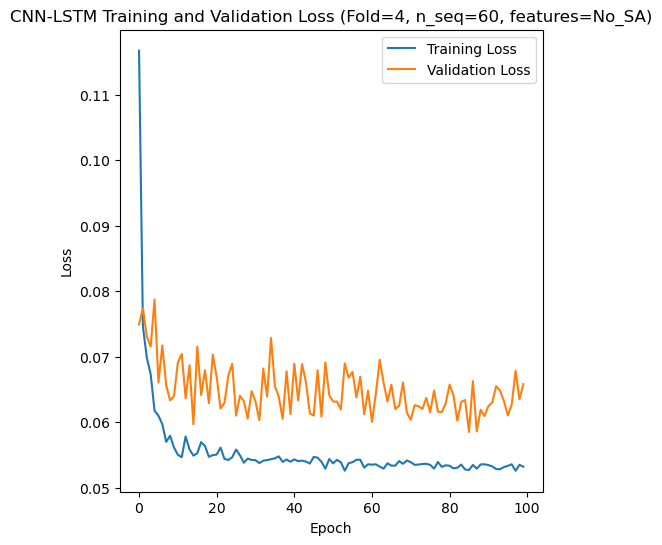

[[2.7018977411540916], [4.876928099167838], [5.720731861900921], [5.700408284172566], [16.221040987242983]]
[[array(2.70189774)], [array(4.8769281)], [array(5.72073186)], [array(5.70040828)], [array(16.22104099)]]
[[2.1767485900300025], [3.9789106063219646], [4.735775816342594], [4.639124483981817], [14.182506174365454]]
[[1.1750523726490285], [2.11108484385514], [1.9951115380031554], [2.8866504389410266], [5.621739017458197]]
[[0.8827166620103224], [0.6317601383543192], [0.5399236003310254], [0.6299673956191684], [-2.172609154845208]]
[[array(-0.24781118)], [array(-0.14949698)], [array(0.03808337)], [array(1.49159387)], [array(2.75796669)]]
[[array(0.9197831)], [array(0.83130745)], [array(0.83219751)], [array(0.80103754)], [array(0.45040587)]]
[-2.98 -3.45 -3.72 ... 12.54 10.27  3.8 ]
[ -3.62794491  -5.81340691  -6.21081596 ... -12.03832278 -16.01480732
 -21.50349579]
Accuracy Results:
RMSE for each fold:
[[2.7018977411540916], [4.876928099167838], [5.720731861900921], [5.700408284172

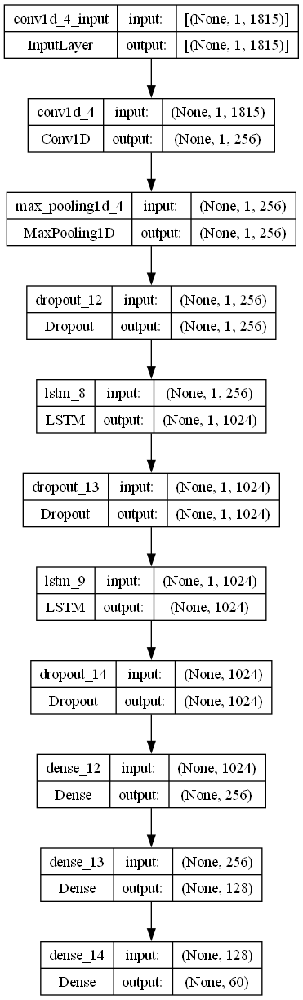

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 256
    lr = 0.0014335369627198127
    optimizer = Adam(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 1024
    dropout_rate = 0.11945020126222661

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a CNN-LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # Plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # Plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_CV_S60_No_SA.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)